# Preliminaries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import time
import seaborn as sns

pd.set_option('display.max_columns', None)

In [2]:
dataset = pd.read_csv('data/df_cluster_Cao_3.csv')
# dataset.drop(columns=['Unnamed: 0'])

In [3]:
dataset = pd.read_csv('data/df_cluster_Cao_3.csv').drop(columns=['Unnamed: 0'])
dataset.loc[dataset['basicMonthlySalary'] < 100, 'basicMonthlySalary'] *= 1000
dataset
# dataset = dataset.drop('Unnamed: 0', axis=1)

# cols_to_drop = [
#     'id', 'fullName', 'firstName', 'middleName', 'lastName', 'mobileNumber',
#     'dateEntry', 'mobilePrefix', 'address', 'occupation'
# ]
cols_to_drop = [
    'id', 'fullName', 'firstName', 'lastName', 'address', 'dateEntry', 'occupation'
]

dataset = dataset.drop(cols_to_drop, axis=1)

boolean_columns = [col for col in dataset.columns if dataset[col].dtype == bool]
dataset[boolean_columns] = dataset[boolean_columns].apply(lambda x: x.astype('int64'))

columns_to_move = ['lastFirstName', 'age', 'gender', 'province', 'job']
columns_remaining = [col for col in dataset.columns if col not in columns_to_move]

new_column_order = columns_to_move + columns_remaining
dataset = dataset[new_column_order]
dataset.insert(0, 'userId', dataset.pop('userId'))

def map_ageing_class(row):
    found_in_hdmf = row['foundInHDMF']
    home_ownership_class = row['home_ownership_class']

    if home_ownership_class == 0:
        return np.nan
    elif found_in_hdmf in [' Current', 'FP', '01 mos', '02 mos', '03 mos']:
        return 0
    elif found_in_hdmf in ['04 mos', '05 mos']:
        return 1

# One-hot encoding of categorical columns
# dataset = pd.get_dummies(dataset, columns=['gender'], prefix='gender', drop_first='True')
# dataset = pd.get_dummies(dataset, columns=['province'], prefix='province')
# dataset = pd.get_dummies(dataset, columns=['job'], prefix='job')

dataset['home_ownership_class'] = ((dataset['foundInOS'] != 'False') |
                                   (dataset['foundInHDMF'] != 'False')).astype('int64')



# dataset['ageing_class'] = dataset['home_ownership_class'].astype('int64')
# dataset['ageing_class'] = dataset.apply(map_ageing_class, axis=1)

cols_to_drop = ['foundInOS', 'foundInHDMF']
dataset = dataset.drop(cols_to_drop, axis=1)

dataset = dataset[dataset['cluster'] == 1].drop(columns=['cluster'])
dataset

,userId,lastFirstName,age,gender,province,job,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanOthers,payInsurance,loanSSS,payFamilySupport,loanPagIbig,loanGSIS,loanPersonal,houseHasPensioner,houseHasPrivateEmployee,houseHasBusiness,houseHasFreelancer,houseHasGovtEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class
2,1105,"TEMILLOSO, DENNIS",40,MALE,METRO MANILA,SERVICE AND SALES,20000,2,0,3,30000.0,3000,500,300,200,50,50,500,100,100,50,500,100,200,500,0,200,0,100,100,100,200,200,200,0,0,0,0,0,0,0,0,0,0,1000,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0
4,2081,"LEGASPI, MANNY",39,MALE,METRO MANILA,CLERICAL SUPPORT,19800,2,0,0,25000.0,5000,2000,1000,1500,0,0,1000,500,1500,0,0,1000,300,1900,0,1000,0,1000,1000,1500,1500,500,1600,0,0,0,0,0,0,0,0,0,0,10000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,3382,"GARDON, JOSEFINO",39,MALE,METRO MANILA,SERVICE AND SALES,17342,2,3,6,28182.0,6000,1000,500,100,0,1000,1000,500,500,0,500,500,200,2000,0,0,0,500,500,100,500,150,0,0,0,0,0,1500,0,0,0,0,0,500,0,0,1,0,1,0,0,0,1,0,1,0,0,1,0,0
7,3511,"SALUBRE, EDDIE",52,MALE,UNKNOWN,SERVICE AND SALES,28684,2,2,6,36000.0,6000,1800,1000,0,0,2000,500,500,0,200,0,200,500,1000,3000,0,0,0,0,70,200,500,0,0,0,0,0,400,500,0,0,0,0,7000,0,1,1,0,1,0,1,0,0,1,0,1,0,1,0,0
9,4090,"MILLARES, LEONORA",42,FEMALE,ISABELA,SERVICE AND SALES,40000,3,2,4,43000.0,5000,1500,1000,500,0,0,1500,3500,1000,0,1500,500,300,500,2600,0,0,1500,1000,200,1000,100,1200,0,0,0,0,0,0,0,0,0,0,12000,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1061,12845,"BANAL, JOYCE",33,FEMALE,METRO MANILA,CLERICAL SUPPORT,57000,3,2,2,50000.0,7000,2000,2500,500,2000,2000,0,0,0,0,2000,2000,500,1000,6500,0,0,2000,1000,500,1000,300,300,0,0,0,0,0,0,0,0,0,0,6000,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0
1063,12848,"BUGARIN, JUN JUN",31,MALE,BULACAN,SERVICE AND SALES,46000,1,0,0,80000.0,1500,1000,1000,500,0,1000,1500,1000,450,500,500,500,300,450,0,0,0,500,0,400,500,0,1500,0,0,0,0,0,250,0,0,0,0,5000,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
1064,12849,"FERERR, JHENNYLYN",29,FEMALE,METRO MANILA,ASSOCIATE PROFESSIONAL,25000,3,2,4,40000.0,4000,1500,1000,0,100,600,0,0,200,300,1500,0,500,1500,0,0,0,500,500,0,0,0,1299,0,0,0,0,0,0,0,0,0,0,1200,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0
1068,12854,"BURGOS, LIEZEL",48,FEMALE,ILOILO,SERVICE AND SALES,51000,2,0,5,51000.0,5000,3000,1500,2000,0,0,15000,9000,0,0,1000,1000,300,800,0,0,0,500,500,300,500,300,800,0,0,0,0,0,0,0,0,0,0,1000,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0


# HO_T01

In [4]:
ho_t01 = dataset.copy()
ho_t01_num = ho_t01.drop(columns=['gender', 'province', 'job'])
ho_t01

,userId,lastFirstName,age,gender,province,job,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanOthers,payInsurance,loanSSS,payFamilySupport,loanPagIbig,loanGSIS,loanPersonal,houseHasPensioner,houseHasPrivateEmployee,houseHasBusiness,houseHasFreelancer,houseHasGovtEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class
2,1105,"TEMILLOSO, DENNIS",40,MALE,METRO MANILA,SERVICE AND SALES,20000,2,0,3,30000.0,3000,500,300,200,50,50,500,100,100,50,500,100,200,500,0,200,0,100,100,100,200,200,200,0,0,0,0,0,0,0,0,0,0,1000,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0
4,2081,"LEGASPI, MANNY",39,MALE,METRO MANILA,CLERICAL SUPPORT,19800,2,0,0,25000.0,5000,2000,1000,1500,0,0,1000,500,1500,0,0,1000,300,1900,0,1000,0,1000,1000,1500,1500,500,1600,0,0,0,0,0,0,0,0,0,0,10000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,3382,"GARDON, JOSEFINO",39,MALE,METRO MANILA,SERVICE AND SALES,17342,2,3,6,28182.0,6000,1000,500,100,0,1000,1000,500,500,0,500,500,200,2000,0,0,0,500,500,100,500,150,0,0,0,0,0,1500,0,0,0,0,0,500,0,0,1,0,1,0,0,0,1,0,1,0,0,1,0,0
7,3511,"SALUBRE, EDDIE",52,MALE,UNKNOWN,SERVICE AND SALES,28684,2,2,6,36000.0,6000,1800,1000,0,0,2000,500,500,0,200,0,200,500,1000,3000,0,0,0,0,70,200,500,0,0,0,0,0,400,500,0,0,0,0,7000,0,1,1,0,1,0,1,0,0,1,0,1,0,1,0,0
9,4090,"MILLARES, LEONORA",42,FEMALE,ISABELA,SERVICE AND SALES,40000,3,2,4,43000.0,5000,1500,1000,500,0,0,1500,3500,1000,0,1500,500,300,500,2600,0,0,1500,1000,200,1000,100,1200,0,0,0,0,0,0,0,0,0,0,12000,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1061,12845,"BANAL, JOYCE",33,FEMALE,METRO MANILA,CLERICAL SUPPORT,57000,3,2,2,50000.0,7000,2000,2500,500,2000,2000,0,0,0,0,2000,2000,500,1000,6500,0,0,2000,1000,500,1000,300,300,0,0,0,0,0,0,0,0,0,0,6000,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0
1063,12848,"BUGARIN, JUN JUN",31,MALE,BULACAN,SERVICE AND SALES,46000,1,0,0,80000.0,1500,1000,1000,500,0,1000,1500,1000,450,500,500,500,300,450,0,0,0,500,0,400,500,0,1500,0,0,0,0,0,250,0,0,0,0,5000,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
1064,12849,"FERERR, JHENNYLYN",29,FEMALE,METRO MANILA,ASSOCIATE PROFESSIONAL,25000,3,2,4,40000.0,4000,1500,1000,0,100,600,0,0,200,300,1500,0,500,1500,0,0,0,500,500,0,0,0,1299,0,0,0,0,0,0,0,0,0,0,1200,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0
1068,12854,"BURGOS, LIEZEL",48,FEMALE,ILOILO,SERVICE AND SALES,51000,2,0,5,51000.0,5000,3000,1500,2000,0,0,15000,9000,0,0,1000,1000,300,800,0,0,0,500,500,300,500,300,800,0,0,0,0,0,0,0,0,0,0,1000,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0


# Outlier Analysis

In [5]:
from sklearn.covariance import EllipticEnvelope
from sklearn.mixture import GaussianMixture
from sklearn.neighbors import LocalOutlierFactor
from sklearn.svm import OneClassSVM
from sklearn.ensemble import IsolationForest

def plot_hist_ee(df, bins=1_000, xlim=None):
    df_X = df.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
    df_names = df.copy()[['userId', 'lastFirstName']]
    n_samples = df.shape[0]
    
#     scaler = StandardScaler()
#     scaled_data = scaler.fit_transform(df_X)
    scaled_data = df_X

    model = EllipticEnvelope(random_state=0)
    model.fit(scaled_data)
    
    model_scores = model.score_samples(scaled_data)
    
    plt.hist(model_scores, bins=bins)
    plt.xlabel('Elliptic Envelope scores')
    plt.ylabel('Frequency')
    plt.title(f'Elliptic Envelope score histogram')
    if xlim is not None:
        plt.xlim(xlim, 0)
    plt.show()

    return model_scores

def plot_ee(df, scores, threshold):
    model_scores = scores

    outlier_mask = model_scores < threshold
    plt.scatter(df.iloc[outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='purple',
                label='Predicted Outliers')
    plt.scatter(df.iloc[~outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[~outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='yellow',
                label='Predicted Inliers')
    plt.xlabel('Basic Monthly Salary')
    plt.ylabel('Monthly Family Income')
    plt.title(f'Elliptic Envelope, Threshold = {threshold}')
    plt.legend()
    plt.show()

    df2 = df.copy()
    df2['pred_outlier'] = (model_scores.reshape(-1, 1) < threshold)

    print('Number of predicted outliers:',
          df2[df2['pred_outlier'] == True].shape[0])
    display(df2[df2['pred_outlier'] == True])

def plot_hist_gmm(df, n_components, covariance_type='full', bins=1_000, xlim=None):
    df_X = df.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
    df_names = df.copy()[['userId', 'lastFirstName']]
    n_samples = df.shape[0]
    
#     scaler = StandardScaler()
#     scaled_data = scaler.fit_transform(df_X)
    scaled_data = df_X

    model = GaussianMixture(n_components=n_components,
                            covariance_type=covariance_type,
                            random_state=0)
    model.fit(scaled_data)
    
    model_scores = model.score_samples(scaled_data)
    
    plt.hist(model_scores, bins=bins)
    plt.xlabel(f'{n_components}-component Gaussian Mixture Model scores')
    plt.ylabel('Frequency')
    plt.title(f'{n_components}-component Gaussian Mixture Model score histogram')
    if xlim is not None:
        plt.xlim(xlim, 0)
    plt.show()

    return model_scores

def plot_gmm(df, n_components, scores, threshold):
    model_scores = scores

    outlier_mask = model_scores < threshold
    plt.scatter(df.iloc[outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='purple',
                label='Predicted Outliers')
    plt.scatter(df.iloc[~outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[~outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='yellow',
                label='Predicted Inliers')
    plt.xlabel('Basic Monthly Salary')
    plt.ylabel('Monthly Family Income')
    plt.title(f'{n_components}-component Gaussian Mixture Model, Threshold = {threshold}')
    plt.legend()
    plt.show()

    df2 = df.copy()
    df2['pred_outlier'] = (model_scores.reshape(-1, 1) < threshold)

    print('Number of predicted outliers:',
          df2[df2['pred_outlier'] == True].shape[0])
    display(df2[df2['pred_outlier'] == True])

def plot_hist_lof(df, n_neighbors=20, bins=1_000, xlim=None):
    df_X = df.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
    df_names = df.copy()[['userId', 'lastFirstName']]
    n_samples = df.shape[0]
    
#     scaler = StandardScaler()
#     scaled_data = scaler.fit_transform(df_X)
    scaled_data = df_X

    model = LocalOutlierFactor(n_neighbors=n_neighbors)
    model.fit(scaled_data)
    
#     model_scores = model.score_samples(scaled_data)
    model_scores = model.negative_outlier_factor_
    
    plt.hist(model_scores, bins=bins)
    plt.xlabel(f'{n_neighbors}-neighbor Local Outlier Factor (LOF) scores')
    plt.ylabel('Frequency')
    plt.title(f'{n_neighbors}-neighbor Local Outlier Factor (LOF) score histogram')
    if xlim is not None:
        plt.xlim(xlim, 0)
    plt.show()

    return model_scores

def plot_lof(df, n_neighbors, scores, threshold):
    model_scores = scores

    outlier_mask = model_scores < threshold
    plt.scatter(df.iloc[outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='purple',
                label='Predicted Outliers')
    plt.scatter(df.iloc[~outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[~outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='yellow',
                label='Predicted Inliers')
    plt.xlabel('Basic Monthly Salary')
    plt.ylabel('Monthly Family Income')
    plt.title(f'{n_neighbors}-neighbor Local Outlier Factor (LOF), Threshold = {threshold}')
    plt.legend()
    plt.show()

    df2 = df.copy()
    df2['pred_outlier'] = (model_scores.reshape(-1, 1) < threshold)

    print('Number of predicted outliers:',
          df2[df2['pred_outlier'] == True].shape[0])
    display(df2[df2['pred_outlier'] == True])

def plot_hist_ocsvm(df, kernel='rbf', bins=1_000, xlim=None):
    df_X = df.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
    df_names = df.copy()[['userId', 'lastFirstName']]
    n_samples = df.shape[0]
    
#     scaler = StandardScaler()
#     scaled_data = scaler.fit_transform(df_X)
    scaled_data = df_X

    model = OneClassSVM(kernel=kernel, degree=4)
    model.fit(scaled_data)
    
    model_scores = model.score_samples(scaled_data)
    
    plt.hist(model_scores, bins=bins)
    plt.xlabel(f'{kernel}-kernel One-Class SVM (OCSVM) scores')
    plt.ylabel('Frequency')
    plt.title(f'{kernel}-kernel One-Class SVM (OCSVM) score histogram')
    if xlim is not None:
        plt.xlim(xlim, 0)
    plt.show()

    return model_scores

def plot_hist_ocsvm2(df, kernel='rbf', bins=1_000, xlim=None):
    df_X = df.copy().drop(['userId', 'lastFirstName', 'ageing_class'], axis=1)
    df_names = df.copy()[['userId', 'lastFirstName']]
    n_samples = df.shape[0]
    
#     scaler = StandardScaler()
#     scaled_data = scaler.fit_transform(df_X)
    scaled_data = df_X

    model = OneClassSVM(kernel=kernel, degree=4)
    model.fit(scaled_data)
    
    model_scores = model.score_samples(scaled_data)
    
    plt.hist(model_scores, bins=bins)
    plt.xlabel(f'{kernel}-kernel One-Class SVM (OCSVM) scores')
    plt.ylabel('Frequency')
    plt.title(f'{kernel}-kernel One-Class SVM (OCSVM) score histogram')
    if xlim is not None:
        plt.xlim(xlim, 0)
    plt.show()

    return model_scores

def plot_ocsvm(df, kernel, scores, threshold):
    model_scores = scores

    outlier_mask = model_scores < threshold
    plt.scatter(df.iloc[outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='purple',
                label='Predicted Outliers')
    plt.scatter(df.iloc[~outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[~outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='yellow',
                label='Predicted Inliers')
    plt.xlabel('Basic Monthly Salary')
    plt.ylabel('Monthly Family Income')
    plt.title(f'{kernel}-kernel One-Class SVM (OCSVM), Threshold = {threshold}')
    plt.legend()
    plt.show()

    df2 = df.copy()
    df2['pred_outlier'] = (model_scores.reshape(-1, 1) < threshold)

    print('Number of predicted outliers:',
          df2[df2['pred_outlier'] == True].shape[0])
    display(df2[df2['pred_outlier'] == True])

    return list(df2[df2['pred_outlier'] == True].index)

def plot_hist_if(df, n_estimators=100, bins=1_000, xlim=None):
    df_X = df.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
    df_names = df.copy()[['userId', 'lastFirstName']]
    n_samples = df.shape[0]
    
#     scaler = StandardScaler()
#     scaled_data = scaler.fit_transform(df_X)
    scaled_data = df_X

    model = IsolationForest(n_estimators=n_estimators, random_state=0)
    model.fit(scaled_data)
    
    model_scores = model.score_samples(scaled_data)
    
    plt.hist(model_scores, bins=bins)
    plt.xlabel(f'{n_estimators}-estimator Isolation Forest (IF) scores')
    plt.ylabel('Frequency')
    plt.title(f'{n_estimators}-estimator Isolation Forest (IF) score histogram')
    if xlim is not None:
        plt.xlim(xlim, 0)
    plt.show()

    return model_scores

def plot_if(df, n_estimators, scores, threshold):
    model_scores = scores

    outlier_mask = model_scores < threshold
    plt.scatter(df.iloc[outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='purple',
                label='Predicted Outliers')
    plt.scatter(df.iloc[~outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[~outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='yellow',
                label='Predicted Inliers')
    plt.xlabel('Basic Monthly Salary')
    plt.ylabel('Monthly Family Income')
    plt.title(f'{n_estimators}-estimator Isolation Forest (IF), Threshold = {threshold}')
    plt.legend()
    plt.show()

    df2 = df.copy()
    df2['pred_outlier'] = (model_scores.reshape(-1, 1) < threshold)

    print('Number of predicted outliers:',
          df2[df2['pred_outlier'] == True].shape[0])
    display(df2[df2['pred_outlier'] == True])

    return list(df2[df2['pred_outlier'] == True].index)

## Elliptic Envelope

In [6]:
# scores = plot_hist_ee(ho_t01_num, bins=10_000, xlim=-1e8)

In [25]:
# for i in np.arange(-1e11, 1, 2e10):
#     plot_ee(ho_t01, scores, i)

## Gaussian Mixture Model (GMM)

### 1-component GMM

In [7]:
# k = 1

# scores = plot_hist_gmm(ho_t01_num, k, covariance_type='full',
#                        bins=1_000)

In [8]:
# for i in np.arange(-600, -150, 30):
#     plot_gmm(ho_t01, k, scores, i)

## Local Outlier Factor

## One-Class SVM

## Isolation Forest

In [9]:
# k = 'rbf'

# scores = plot_hist_ocsvm(ho_t01_num, kernel=k,
#                          bins=1_000)

# ho_t01_outliers = plot_ocsvm(ho_t01_num, k, scores, 360)
# print(ho_t01_outliers)

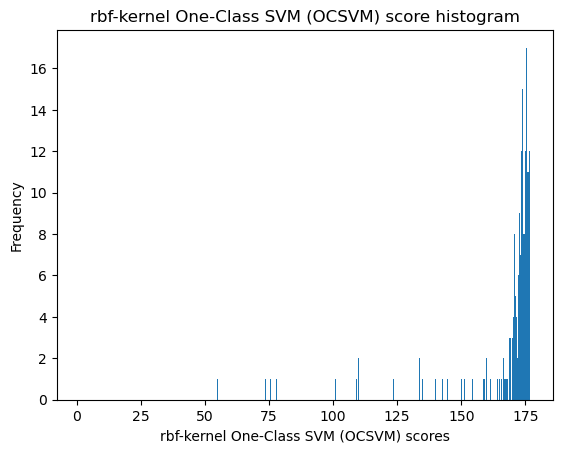

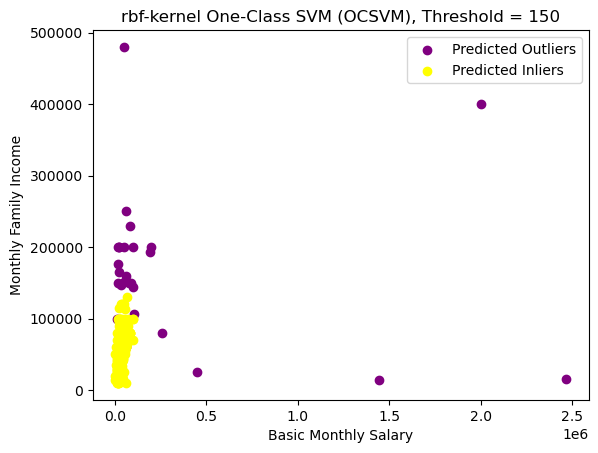

Number of predicted outliers: 35


,userId,lastFirstName,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanOthers,payInsurance,loanSSS,payFamilySupport,loanPagIbig,loanGSIS,loanPersonal,houseHasPensioner,houseHasPrivateEmployee,houseHasBusiness,houseHasFreelancer,houseHasGovtEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class,pred_outlier
24,8342,"VALDEZ, MOSES",28,50000,3,4,8,200000.0,10000,10000,10000,4000,0,0,0,0,0,2100,10000,1000,2000,2000,0,1000,0,2000,2000,2000,1000,599,1899,0,0,0,0,0,0,0,0,0,0,10000,0,1,0,1,0,0,0,0,1,0,0,0,0,1,0,0,True
41,9717,"LIMBO, JOHN ORVILLE",40,50000,2,4,3,50000.0,5000,2000,1000,1000,500,2000,0,0,0,0,10000,10000,500,1500,0,2000,0,1000,500,500,500,1000,0,0,0,0,0,0,0,0,0,0,0,100000,1,0,0,0,0,0,0,0,0,1,0,1,1,1,0,0,True
50,9989,"BITAS, SHARRAH",23,37266,3,2,4,50000.0,6000,2000,2000,2500,0,0,0,0,0,0,5000,1000,300,2500,0,0,0,0,0,500,500,100,1500,0,0,0,0,0,0,0,0,0,0,200000,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,True
70,10503,"CASTRO, GLENDA",46,200000,3,1,5,200000.0,5000,1000,500,1000,500,1000,1000,500,500,500,1000,0,1000,1000,2000,0,0,0,100,500,500,500,1000,0,0,0,0,0,0,0,0,0,0,5000,0,0,1,0,1,0,0,0,0,1,0,0,0,1,0,1,True
82,10531,"MELENDREZ, SALOME",53,60000,3,2,2,60000.0,10000,5000,5000,0,0,5000,0,0,0,0,10000,2000,500,2000,0,1000,0,5000,2000,2000,5000,500,2000,0,0,0,0,0,0,0,0,0,0,100000,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,0,True
161,10678,"BALLECER, DINO",37,18000,2,1,3,177000.0,25000,5000,3000,5000,0,0,13000,0,0,3000,4000,2000,200,4500,10500,1000,0,2000,2000,1500,1000,1000,599,0,0,0,0,1700,0,0,0,0,0,20000,1,1,0,1,0,0,0,0,0,0,0,0,1,1,0,0,True
184,10724,"GARCIA, GLENDA",34,16000,2,0,3,50000.0,2000,200,100,120,20,50,200,20,300,100,1000,200,450,600,2678,100,200,200,400,200,300,90,50,0,0,0,0,0,0,0,0,0,0,100000,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,True
200,10764,"SANTOS, JOHN CARLO",27,60000,3,1,5,65000.0,5000,1000,500,500,0,0,0,0,0,0,20000,5000,500,6000,0,1000,300,300,300,300,300,0,1625,0,0,0,0,0,0,0,0,0,0,200000,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,True
253,11201,"ABALOS, GLYNN",36,80000,3,2,2,230000.0,13000,2000,1000,3640,0,0,0,0,0,0,0,0,2275,3900,57200,0,0,3000,0,0,0,1300,1625,0,0,0,0,0,0,0,0,0,0,50000,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,1,True
320,11298,"TANA, MARK ANTONIO",38,106613,3,2,5,106000.0,8000,5000,3000,1000,0,0,5000,1000,2000,1000,5000,5000,600,5000,5000,1000,0,500,0,1000,500,100,1500,0,0,0,0,0,0,0,0,0,0,1000,0,0,0,0,0,0,0,0,0,1,0,0,1,1,0,0,True


[24, 41, 50, 70, 82, 161, 184, 200, 253, 320, 325, 339, 380, 391, 399, 405, 417, 515, 556, 563, 621, 671, 692, 695, 718, 773, 830, 912, 929, 940, 984, 1009, 1037, 1046, 1069]


In [7]:
k = 'rbf'

scores = plot_hist_ocsvm(ho_t01_num, kernel=k,
                         bins=1_000)

ho_t01_outliers = plot_ocsvm(ho_t01_num, k, scores, 150)
print(ho_t01_outliers)

# EDA on Dataset

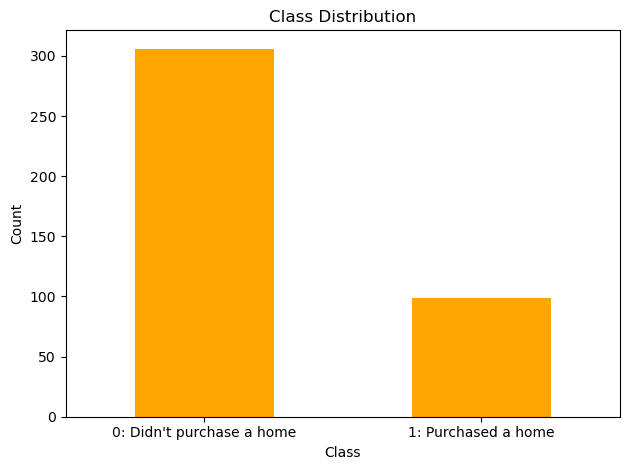

In [8]:
df = ho_t01
class_counts = df['home_ownership_class'].value_counts()
class_counts = class_counts.rename({0: "0: Didn't purchase a home",
                                    1: "1: Purchased a home"})

# Plot
# plt.figure(figsize=(10, 6))
class_counts.plot(kind='bar', color='orange')
plt.title('Class Distribution')
plt.xlabel('Class')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()


In [10]:
pd.__version__

'1.5.3'

# HO_T01: Original

In [21]:
# ho_t01

# HO_T02: OHE Original, VarThresh

In [9]:
ho_t02 = ho_t01.copy()
ho_t02 = pd.get_dummies(ho_t02, columns=['gender'], prefix='gender', drop_first='True')
ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

In [10]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t02_X = ho_t02.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t02_y = ho_t02.copy()[['home_ownership_class']]
# ho_t02_y

In [11]:
from sklearn.feature_selection import VarianceThreshold

In [12]:
df = ho_t02_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t02_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 38
Removed columns: ['gambling', 'loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_AGUSAN DEL NORTE', 'province_AKLAN', 'province_ALBAY', 'province_BATAAN', 'province_BATANGAS', 'province_BULACAN', 'province_CEBU', 'province_COTABATO', 'province_FOREIGN COUNTRY', 'province_ILOILO', 'province_ISABELA', 'province_LAGUNA', 'province_LEYTE', 'province_MARINDUQUE', 'province_NEGROS OCCIDENTAL', 'province_NUEVA ECIJA', 'province_PANGASINAN', 'province_RIZAL', 'province_UNKNOWN', 'province_ZAMBOANGA DEL NORTE', 'job_ARMED FORCES', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'job_ELEMENTARY OCCUPATION', 'job_MACHINE OPERATOR', 'job_MANAGER', 'job_NONE', 'job_PROFESIONAL', 'job_UNKNOWN']


In [13]:
ho_t02_X_f02 = ho_t02.copy().drop(columns=filtered_out_columns)
# ho_t02_X_f02 = ho_t02_X_f02.copy().drop(columns=cols_to_drop)
ho_t02_X_f02

ho_t02 = ho_t02_X_f02.copy()

In [14]:
ho_t02.shape

(405, 54)

# HO_T03: OHE, VarThresh, Removed correlated features

In [15]:
ho_t03 = ho_t01.copy()
ho_t03 = pd.get_dummies(ho_t03, columns=['gender'], prefix='gender', drop_first='True')
ho_t03 = pd.get_dummies(ho_t03, columns=['province'], prefix='province')
ho_t03 = pd.get_dummies(ho_t03, columns=['job'], prefix='job')
# ho_t02

In [16]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t03_X = ho_t03.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t03_y = ho_t03.copy()[['home_ownership_class']]
# ho_t02_y

In [17]:
df = ho_t03_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t03_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 38
Removed columns: ['gambling', 'loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_AGUSAN DEL NORTE', 'province_AKLAN', 'province_ALBAY', 'province_BATAAN', 'province_BATANGAS', 'province_BULACAN', 'province_CEBU', 'province_COTABATO', 'province_FOREIGN COUNTRY', 'province_ILOILO', 'province_ISABELA', 'province_LAGUNA', 'province_LEYTE', 'province_MARINDUQUE', 'province_NEGROS OCCIDENTAL', 'province_NUEVA ECIJA', 'province_PANGASINAN', 'province_RIZAL', 'province_UNKNOWN', 'province_ZAMBOANGA DEL NORTE', 'job_ARMED FORCES', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'job_ELEMENTARY OCCUPATION', 'job_MACHINE OPERATOR', 'job_MANAGER', 'job_NONE', 'job_PROFESIONAL', 'job_UNKNOWN']


In [20]:
ho_t03_X_f02 = ho_t03_X_f01.copy()
# cols_to_drop = [
#     'smallLottery', 'otherVices', 'alcohol', 'cinema', 'dineOut', 'personalCare', 'hygiene', 'smoking'
# ]
# ho_t03_X_f02 = ho_t03_X_f01.drop(columns=cols_to_drop)

# Calculate the correlation matrix
correlation_matrix = ho_t03_X_f02.corr()

# Find pairs of columns where the correlation is greater than 0.8
# This will ignore the diagonal which will always be 1 (self correlation)
to_drop = set()
for i in range(len(correlation_matrix)):
    for j in range(i+1, len(correlation_matrix)):
        if correlation_matrix.iloc[i, j] >= 0.9:
            colname = correlation_matrix.columns[j]  # Getting the column name
            to_drop.add(colname)
            print(correlation_matrix.columns[i], "|", colname, "| Correlation:",
                  correlation_matrix.iloc[i, j])

print("\nAfter dropping correlated features:")
ho_t03_X_f02
# ho_t02_X_f02 = ho_t02.copy().drop(columns=cols_to_drop)


After dropping correlated features:


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES
0,40.0,20000.0,2.0,0.0,3.0,30000.0,3000.0,500.0,300.0,200.0,50.0,50.0,500.0,100.0,100.0,50.0,500.0,100.0,200.0,500.0,0.0,200.0,0.0,100.0,100.0,100.0,200.0,200.0,200.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1000.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0
1,39.0,19800.0,2.0,0.0,0.0,25000.0,5000.0,2000.0,1000.0,1500.0,0.0,0.0,1000.0,500.0,1500.0,0.0,0.0,1000.0,300.0,1900.0,0.0,1000.0,0.0,1000.0,1000.0,1500.0,1500.0,500.0,1600.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10000.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
2,39.0,17342.0,2.0,3.0,6.0,28182.0,6000.0,1000.0,500.0,100.0,0.0,1000.0,1000.0,500.0,500.0,0.0,500.0,500.0,200.0,2000.0,0.0,0.0,0.0,500.0,500.0,100.0,500.0,150.0,0.0,0.0,0.0,0.0,0.0,1500.0,0.0,0.0,0.0,0.0,500.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0
3,52.0,28684.0,2.0,2.0,6.0,36000.0,6000.0,1800.0,1000.0,0.0,0.0,2000.0,500.0,500.0,0.0,200.0,0.0,200.0,500.0,1000.0,3000.0,0.0,0.0,0.0,0.0,70.0,200.0,500.0,0.0,0.0,0.0,0.0,0.0,400.0,500.0,0.0,0.0,0.0,7000.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0
4,42.0,40000.0,3.0,2.0,4.0,43000.0,5000.0,1500.0,1000.0,500.0,0.0,0.0,1500.0,3500.0,1000.0,0.0,1500.0,500.0,300.0,500.0,2600.0,0.0,0.0,1500.0,1000.0,200.0,1000.0,100.0,1200.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12000.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
400,33.0,57000.0,3.0,2.0,2.0,50000.0,7000.0,2000.0,2500.0,500.0,2000.0,2000.0,0.0,0.0,0.0,0.0,2000.0,2000.0,500.0,1000.0,6500.0,0.0,0.0,2000.0,1000.0,500.0,1000.0,300.0,300.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6000.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
401,31.0,46000.0,1.0,0.0,0.0,80000.0,1500.0,1000.0,1000.0,500.0,0.0,1000.0,1500.0,1000.0,450.0,500.0,500.0,500.0,300.0,450.0,0.0,0.0,0.0,500.0,0.0,400.0,500.0,0.0,1500.0,0.0,0.0,0.0,0.0,0.0,250.0,0.0,0.0,0.0,5000.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
402,29.0,25000.0,3.0,2.0,4.0,40000.0,4000.0,1500.0,1000.0,0.0,100.0,600.0,0.0,0.0,200.0,300.0,1500.0,0.0,500.0,1500.0,0.0,0.0,0.0,500.0,500.0,0.0,0.0,0.0,1299.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1200.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0
403,48.0,51000.0,2.0,0.0,5.0,51000.0,5000.0,3000.0,1500.0,2000.0,0.0,0.0,15000.0,9000.0,0.0,0.0,1000.0,1000.0,300.0,800.0,0.0,0.0,0.0,500.0,500.0,300.0,500.0,300.0,800.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1000.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [21]:
ho_t03_X_f02 = ho_t03.copy().drop(columns=filtered_out_columns)
ho_t03_X_f02 = ho_t03_X_f02.copy().drop(columns=cols_to_drop)
ho_t03_X_f02

ho_t03 = ho_t03_X_f02.copy()

KeyError: "['foundInOS', 'foundInHDMF'] not found in axis"

In [ ]:
ho_t03.shape

(55, 46)

# HO_T04: OHE, Removed Outliers, VarThresh

In [22]:
ho_t04 = ho_t01.copy().drop(ho_t01_outliers)

# ho_t04

In [23]:
ho_t04.shape

(370, 61)

In [24]:
print('BEFORE OUTLIER REMOVAL')
print('Number of data points:', len(ho_t01))
print(f"Number of positive class points: {(ho_t01['home_ownership_class'] == 1).sum()}, {(ho_t01['home_ownership_class'] == 1).sum() / len(ho_t01) :.1%}")
print(f"Number of negative class points: {(ho_t01['home_ownership_class'] == 0).sum()}, {(ho_t01['home_ownership_class'] == 0).sum() / len(ho_t01) :.1%}")

print('\nOUTLIERS REMOVED')
print('Number of outliers:', len(ho_t01.iloc[ho_t01_outliers]))
print(f"Number of positive class outliers: {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 1).sum()}, {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 1).sum() / len(ho_t01.iloc[ho_t01_outliers]) :.1%}")
print(f"Number of negative class outliers: {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 0).sum()}, {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 0).sum() / len(ho_t01.iloc[ho_t01_outliers]) :.1%}")

print('\nAFTER OUTLIER REMOVAL')
print('Number of data points:', len(ho_t04))
print(f"Number of positive class points: {(ho_t04['home_ownership_class'] == 1).sum()}, {(ho_t04['home_ownership_class'] == 1).sum() / len(ho_t04) :.1%}")
print(f"Number of negative class points: {(ho_t04['home_ownership_class'] == 0).sum()}, {(ho_t04['home_ownership_class'] == 0).sum() / len(ho_t04) :.1%}")

BEFORE OUTLIER REMOVAL
Number of data points: 405
Number of positive class points: 99, 24.4%
Number of negative class points: 306, 75.6%

OUTLIERS REMOVED


IndexError: positional indexers are out-of-bounds

In [25]:
ho_t04 = pd.get_dummies(ho_t04, columns=['gender'], prefix='gender', drop_first='True')
ho_t04 = pd.get_dummies(ho_t04, columns=['province'], prefix='province')
ho_t04 = pd.get_dummies(ho_t04, columns=['job'], prefix='job')
# ho_t02

In [26]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t04_X = ho_t04.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t04_y = ho_t04.copy()[['home_ownership_class']]
# ho_t02_y

In [27]:
df = ho_t04_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t04_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 36
Removed columns: ['gambling', 'loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_AGUSAN DEL NORTE', 'province_AKLAN', 'province_ALBAY', 'province_BATAAN', 'province_BATANGAS', 'province_BULACAN', 'province_COTABATO', 'province_FOREIGN COUNTRY', 'province_ILOILO', 'province_ISABELA', 'province_LAGUNA', 'province_MARINDUQUE', 'province_NEGROS OCCIDENTAL', 'province_NUEVA ECIJA', 'province_PANGASINAN', 'province_RIZAL', 'province_UNKNOWN', 'province_ZAMBOANGA DEL NORTE', 'job_ARMED FORCES', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'job_ELEMENTARY OCCUPATION', 'job_MACHINE OPERATOR', 'job_MANAGER', 'job_NONE', 'job_PROFESIONAL', 'job_UNKNOWN']


In [28]:
ho_t04_X_f02 = ho_t04_X_f01.copy()
# cols_to_drop = [
#     'smallLottery', 'otherVices', 'alcohol', 'cinema'
# ]
# ho_t04_X_f02 = ho_t04_X_f01.drop(columns=cols_to_drop)

# Calculate the correlation matrix
correlation_matrix = ho_t04_X_f02.corr()

# Find pairs of columns where the correlation is greater than 0.8
# This will ignore the diagonal which will always be 1 (self correlation)
to_drop = set()
for i in range(len(correlation_matrix)):
    for j in range(i+1, len(correlation_matrix)):
        if correlation_matrix.iloc[i, j] >= 0.9:
            colname = correlation_matrix.columns[j]  # Getting the column name
            to_drop.add(colname)
            print(correlation_matrix.columns[i], "|", colname, "| Correlation:",
                  correlation_matrix.iloc[i, j])

print("\nAfter dropping correlated features:")
ho_t04_X_f02
# ho_t02_X_f02 = ho_t02.copy().drop(columns=cols_to_drop)


After dropping correlated features:


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES
0,40.0,20000.0,2.0,0.0,3.0,30000.0,3000.0,500.0,300.0,200.0,50.0,50.0,500.0,100.0,100.0,50.0,500.0,100.0,200.0,500.0,0.0,200.0,0.0,100.0,100.0,100.0,200.0,200.0,200.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1000.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0
1,39.0,19800.0,2.0,0.0,0.0,25000.0,5000.0,2000.0,1000.0,1500.0,0.0,0.0,1000.0,500.0,1500.0,0.0,0.0,1000.0,300.0,1900.0,0.0,1000.0,0.0,1000.0,1000.0,1500.0,1500.0,500.0,1600.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10000.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
2,39.0,17342.0,2.0,3.0,6.0,28182.0,6000.0,1000.0,500.0,100.0,0.0,1000.0,1000.0,500.0,500.0,0.0,500.0,500.0,200.0,2000.0,0.0,0.0,0.0,500.0,500.0,100.0,500.0,150.0,0.0,0.0,0.0,0.0,0.0,1500.0,0.0,0.0,0.0,0.0,500.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0
3,52.0,28684.0,2.0,2.0,6.0,36000.0,6000.0,1800.0,1000.0,0.0,0.0,2000.0,500.0,500.0,0.0,200.0,0.0,200.0,500.0,1000.0,3000.0,0.0,0.0,0.0,0.0,70.0,200.0,500.0,0.0,0.0,0.0,0.0,0.0,400.0,500.0,0.0,0.0,0.0,7000.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0
4,42.0,40000.0,3.0,2.0,4.0,43000.0,5000.0,1500.0,1000.0,500.0,0.0,0.0,1500.0,3500.0,1000.0,0.0,1500.0,500.0,300.0,500.0,2600.0,0.0,0.0,1500.0,1000.0,200.0,1000.0,100.0,1200.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12000.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
365,31.0,25000.0,2.0,4.0,4.0,90000.0,5000.0,3000.0,3000.0,1000.0,0.0,2000.0,0.0,0.0,0.0,0.0,2000.0,3000.0,300.0,500.0,0.0,0.0,0.0,2000.0,1000.0,1000.0,1000.0,0.0,1500.0,0.0,0.0,0.0,0.0,2000.0,0.0,0.0,0.0,0.0,6000.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0
366,33.0,57000.0,3.0,2.0,2.0,50000.0,7000.0,2000.0,2500.0,500.0,2000.0,2000.0,0.0,0.0,0.0,0.0,2000.0,2000.0,500.0,1000.0,6500.0,0.0,0.0,2000.0,1000.0,500.0,1000.0,300.0,300.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6000.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
367,31.0,46000.0,1.0,0.0,0.0,80000.0,1500.0,1000.0,1000.0,500.0,0.0,1000.0,1500.0,1000.0,450.0,500.0,500.0,500.0,300.0,450.0,0.0,0.0,0.0,500.0,0.0,400.0,500.0,0.0,1500.0,0.0,0.0,0.0,0.0,0.0,250.0,0.0,0.0,0.0,5000.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
368,29.0,25000.0,3.0,2.0,4.0,40000.0,4000.0,1500.0,1000.0,0.0,100.0,600.0,0.0,0.0,200.0,300.0,1500.0,0.0,500.0,1500.0,0.0,0.0,0.0,500.0,500.0,0.0,0.0,0.0,1299.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1200.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0


In [29]:
ho_t04_X_f02 = ho_t04.copy().drop(columns=filtered_out_columns)
# ho_t04_X_f02 = ho_t04_X_f02.copy().drop(columns=cols_to_drop)
ho_t04_X_f02

ho_t04 = ho_t04_X_f02.copy()

# HO_T05: OHE, Removed Outliers, VarThresh, Removed highly correlated features

In [62]:
ho_t05 = ho_t01.copy().drop(ho_t01_outliers)

# ho_t05

In [46]:
print('BEFORE OUTLIER REMOVAL')
print('Number of data points:', len(ho_t01))
print(f"Number of positive class points: {(ho_t01['home_ownership_class'] == 1).sum()}, {(ho_t01['home_ownership_class'] == 1).sum() / len(ho_t01) :.1%}")
print(f"Number of negative class points: {(ho_t01['home_ownership_class'] == 0).sum()}, {(ho_t01['home_ownership_class'] == 0).sum() / len(ho_t01) :.1%}")

print('\nOUTLIERS REMOVED')
print('Number of outliers:', len(ho_t01.iloc[ho_t01_outliers]))
print(f"Number of positive class outliers: {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 1).sum()}, {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 1).sum() / len(ho_t01.iloc[ho_t01_outliers]) :.1%}")
print(f"Number of negative class outliers: {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 0).sum()}, {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 0).sum() / len(ho_t01.iloc[ho_t01_outliers]) :.1%}")

print('\nAFTER OUTLIER REMOVAL')
print('Number of data points:', len(ho_t05))
print(f"Number of positive class points: {(ho_t05['home_ownership_class'] == 1).sum()}, {(ho_t05['home_ownership_class'] == 1).sum() / len(ho_t05) :.1%}")
print(f"Number of negative class points: {(ho_t05['home_ownership_class'] == 0).sum()}, {(ho_t05['home_ownership_class'] == 0).sum() / len(ho_t05) :.1%}")

BEFORE OUTLIER REMOVAL
Number of data points: 55
Number of positive class points: 13, 23.6%
Number of negative class points: 42, 76.4%

OUTLIERS REMOVED


IndexError: positional indexers are out-of-bounds

In [63]:
ho_t05 = pd.get_dummies(ho_t05, columns=['gender'], prefix='gender', drop_first='True')
ho_t05 = pd.get_dummies(ho_t05, columns=['province'], prefix='province')
ho_t05 = pd.get_dummies(ho_t05, columns=['job'], prefix='job')
# ho_t02

In [64]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t05_X = ho_t05.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t05_y = ho_t05.copy()[['home_ownership_class']]
# ho_t02_y

In [65]:
df = ho_t05_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t05_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 21
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_BULACAN', 'province_CAMARINES SUR', 'province_CEBU', 'province_FOREIGN COUNTRY', 'province_RIZAL', 'province_UNKNOWN', 'job_ARMED FORCES', 'job_ASSOCIATE PROFESSIONAL', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'job_ELEMENTARY OCCUPATION', 'job_MACHINE OPERATOR', 'job_NONE', 'job_PROFESIONAL']


In [66]:
ho_t05_X_f02 = ho_t05_X_f01.copy()
cols_to_drop = [
    'smallLottery', 'otherVices', 'alcohol', 'cinema', 'smoking', 'dineOut', 'personalCare', 'tuition', 'informalLenders'
]
ho_t05_X_f02 = ho_t05_X_f01.drop(columns=cols_to_drop)

# Calculate the correlation matrix
correlation_matrix = ho_t05_X_f02.corr()

# Find pairs of columns where the correlation is greater than 0.8
# This will ignore the diagonal which will always be 1 (self correlation)
to_drop = set()
for i in range(len(correlation_matrix)):
    for j in range(i+1, len(correlation_matrix)):
        if correlation_matrix.iloc[i, j] >= 0.9:
            colname = correlation_matrix.columns[j]  # Getting the column name
            to_drop.add(colname)
            print(correlation_matrix.columns[i], "|", colname, "| Correlation:",
                  correlation_matrix.iloc[i, j])

print("\nAfter dropping correlated features:")
ho_t05_X_f02
# ho_t02_X_f02 = ho_t02.copy().drop(columns=cols_to_drop)


After dropping correlated features:


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,leisure,clothing,mobileLoad,internet,vehicleLoan,companyLoan,privateLoans,governmentLoans,gambling,savings,loanSSS,payFamilySupport,loanPagIbig,loanPersonal,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_SERVICE AND SALES
0,40.0,30000.0,3.0,1.0,3.0,30000.0,3000.0,2000.0,1000.0,1500.0,1000.0,1500.0,500.0,300.0,200.0,100.0,100.0,500.0,600.0,4600.0,500.0,500.0,100.0,50.0,1000.0,1200.0,1000.0,1000.0,1000.0,0.0,15000.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0
1,26.0,25000.0,1.0,5.0,3.0,25000.0,7000.0,1500.0,1500.0,400.0,0.0,0.0,200.0,300.0,500.0,1235.0,1411.0,600.0,600.0,2500.0,0.0,0.0,500.0,500.0,0.0,0.0,0.0,0.0,0.0,500.0,500.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
2,40.0,19000.0,3.0,1.0,9.0,24000.0,10000.0,2000.0,1000.0,1500.0,300.0,1500.0,1800.0,1500.0,500.0,1000.0,500.0,280.0,1500.0,3000.0,500.0,250.0,1000.0,600.0,0.0,2500.0,3000.0,500.0,3000.0,0.0,5000.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
3,30.0,33000.0,3.0,3.0,5.0,50000.0,3500.0,150.0,100.0,50.0,30.0,100.0,100.0,100.0,100.0,3000.0,1500.0,500.0,2000.0,1500.0,1500.0,500.0,500.0,300.0,300.0,100.0,100.0,100.0,100.0,100.0,500.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0
4,25.0,18500.0,2.0,2.0,2.0,50000.0,2000.0,1000.0,500.0,500.0,1.0,1.0,1.0,1.0,1.0,500.0,500.0,150.0,300.0,2000.0,500.0,1.0,500.0,300.0,1399.0,1.0,1.0,1.0,1.0,1.0,2500.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0
5,30.0,17000.0,2.0,1.0,2.0,17000.0,5000.0,1000.0,1000.0,500.0,500.0,500.0,1000.0,2000.0,500.0,5000.0,1000.0,500.0,500.0,2000.0,2000.0,500.0,1000.0,360.0,100.0,1000.0,1000.0,1000.0,1000.0,100.0,2000.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0
6,38.0,45000.0,3.0,3.0,6.0,45000.0,10000.0,2000.0,1000.0,100.0,200.0,500.0,300.0,500.0,100.0,1000.0,1000.0,300.0,2500.0,4000.0,500.0,500.0,1000.0,100.0,1700.0,100.0,100.0,100.0,100.0,100.0,3000.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0
7,34.0,16200.0,3.0,2.0,3.0,16200.0,5000.0,500.0,500.0,300.0,50.0,500.0,100.0,2.0,1.0,500.0,100.0,100.0,200.0,1500.0,500.0,200.0,400.0,100.0,500.0,1.0,1.0,1.0,11.0,1.0,3000.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0
8,35.0,80000.0,3.0,6.0,4.0,100000.0,5000.0,5000.0,5000.0,1000.0,1000.0,2000.0,5000.0,2000.0,5000.0,5000.0,5000.0,2000.0,2000.0,4000.0,4000.0,1000.0,4000.0,2000.0,2000.0,2000.0,2000.0,1000.0,1000.0,1000.0,4000.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0
9,52.0,11300.0,1.0,1.0,4.0,11300.0,3000.0,500.0,200.0,1000.0,1.0,1.0,500.0,1.0,1.0,1.0,1.0,300.0,400.0,2500.0,1.0,1.0,1.0,100.0,300.0,1.0,1.0,1.0,400.0,1.0,2000.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0


In [67]:
ho_t05_X_f02 = ho_t05.copy().drop(columns=filtered_out_columns)
ho_t05_X_f02 = ho_t05_X_f02.copy().drop(columns=cols_to_drop)
ho_t05_X_f02

ho_t05 = ho_t05_X_f02.copy()
ho_t05.shape

(47, 46)

# HO_T06: OHE, Removed Outliers, VarThresh, Removed highly correlated features via VIF

In [30]:
ho_t06 = ho_t01.copy().drop(ho_t01_outliers)

# ho_t05

In [31]:
print('BEFORE OUTLIER REMOVAL')
print('Number of data points:', len(ho_t01))
print(f"Number of positive class points: {(ho_t01['home_ownership_class'] == 1).sum()}, {(ho_t01['home_ownership_class'] == 1).sum() / len(ho_t01) :.1%}")
print(f"Number of negative class points: {(ho_t01['home_ownership_class'] == 0).sum()}, {(ho_t01['home_ownership_class'] == 0).sum() / len(ho_t01) :.1%}")

print('\nOUTLIERS REMOVED')
print('Number of outliers:', len(ho_t01.iloc[ho_t01_outliers]))
print(f"Number of positive class outliers: {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 1).sum()}, {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 1).sum() / len(ho_t01.iloc[ho_t01_outliers]) :.1%}")
print(f"Number of negative class outliers: {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 0).sum()}, {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 0).sum() / len(ho_t01.iloc[ho_t01_outliers]) :.1%}")

print('\nAFTER OUTLIER REMOVAL')
print('Number of data points:', len(ho_t06))
print(f"Number of positive class points: {(ho_t06['home_ownership_class'] == 1).sum()}, {(ho_t06['home_ownership_class'] == 1).sum() / len(ho_t06) :.1%}")
print(f"Number of negative class points: {(ho_t06['home_ownership_class'] == 0).sum()}, {(ho_t06['home_ownership_class'] == 0).sum() / len(ho_t06) :.1%}")

BEFORE OUTLIER REMOVAL
Number of data points: 405
Number of positive class points: 99, 24.4%
Number of negative class points: 306, 75.6%

OUTLIERS REMOVED


IndexError: positional indexers are out-of-bounds

In [32]:
ho_t06 = pd.get_dummies(ho_t06, columns=['gender'], prefix='gender', drop_first='True')
ho_t06 = pd.get_dummies(ho_t06, columns=['province'], prefix='province')
ho_t06 = pd.get_dummies(ho_t06, columns=['job'], prefix='job')
# ho_t02

In [33]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t06_X = ho_t06.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t06_y = ho_t06.copy()[['home_ownership_class']]
# ho_t02_y

In [34]:
df = ho_t06_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t06_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 36
Removed columns: ['gambling', 'loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_AGUSAN DEL NORTE', 'province_AKLAN', 'province_ALBAY', 'province_BATAAN', 'province_BATANGAS', 'province_BULACAN', 'province_COTABATO', 'province_FOREIGN COUNTRY', 'province_ILOILO', 'province_ISABELA', 'province_LAGUNA', 'province_MARINDUQUE', 'province_NEGROS OCCIDENTAL', 'province_NUEVA ECIJA', 'province_PANGASINAN', 'province_RIZAL', 'province_UNKNOWN', 'province_ZAMBOANGA DEL NORTE', 'job_ARMED FORCES', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'job_ELEMENTARY OCCUPATION', 'job_MACHINE OPERATOR', 'job_MANAGER', 'job_NONE', 'job_PROFESIONAL', 'job_UNKNOWN']


In [35]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

# calculate VIF for each feature
df = ho_t06_X_f01
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(df.values, i) for i in range(df.shape[1])]
vif["features"] = df.columns
vif_sorted = vif.sort_values(by="VIF Factor", ascending=False)
# vif_sorted

In [36]:
# Identify columns to be removed
columns_to_remove = vif_sorted[vif_sorted['VIF Factor'] > 10]['features'].to_list()
columns_to_remove

['age',
 'houseOnlyFamily',
 'preferredNetDisposableIncomeId',
 'basicMonthlySalary']

In [37]:
ho_t06_X_f02 = ho_t06.copy().drop(columns=filtered_out_columns)
ho_t06_X_f02 = ho_t06_X_f02.copy().drop(columns=columns_to_remove)
ho_t06_X_f02

ho_t06 = ho_t06_X_f02.copy()

# HO_T07 (discarded): OHE, VarThresh, Removed highly correlated features via VIF

In [204]:
ho_t07 = ho_t01.copy()

# ho_t05

In [205]:
ho_t07 = pd.get_dummies(ho_t07, columns=['gender'], prefix='gender', drop_first='True')
ho_t07 = pd.get_dummies(ho_t07, columns=['province'], prefix='province')
ho_t07 = pd.get_dummies(ho_t07, columns=['job'], prefix='job')
# ho_t02

In [206]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t07_X = ho_t07.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t07_y = ho_t07.copy()[['home_ownership_class']]
# ho_t02_y

In [207]:
df = ho_t07_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t07_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 50
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_AGUSAN DEL NORTE', 'province_AKLAN', 'province_ALBAY', 'province_BATAAN', 'province_BATANGAS', 'province_BULACAN', 'province_CAGAYAN', 'province_CAMARINES SUR', 'province_CEBU', 'province_COTABATO', 'province_DAVAO DEL SUR', 'province_EASTERN SAMAR', 'province_FOREIGN COUNTRY', 'province_ILOCOS NORTE', 'province_ILOILO', 'province_ISABELA', 'province_LAGUNA', 'province_LEYTE', 'province_MARINDUQUE', 'province_MISAMIS OCCIDENTAL', 'province_NEGROS OCCIDENTAL', 'province_NUEVA ECIJA', 'province_ORIENTAL MINDORO', 'province_PANGASINAN', 'province_QUEZON', 'province_QUIRINO', 'province_RIZAL', 'province_ROMBLON', 'province_SOUTH COTABATO', 'province_TARLAC', 'province_UNKNOWN', 'province_ZAMBOANGA DEL NORTE', 'job_AGRICULTURAL', 'job_ARMED FORCES', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'jo

In [208]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

# calculate VIF for each feature
df = ho_t07_X_f01
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(df.values, i) for i in range(df.shape[1])]
vif["features"] = df.columns
vif_sorted = vif.sort_values(by="VIF Factor", ascending=False)
# vif_sorted

In [209]:
# Identify columns to be removed
columns_to_remove = vif_sorted[vif_sorted['VIF Factor'] > 10]['features'].to_list()
columns_to_remove

['smallLottery',
 'gambling',
 'otherVices',
 'age',
 'houseOnlyFamily',
 'preferredNetDisposableIncomeId']

In [ ]:
ho_t07_X_f02 = ho_t07.copy().drop(columns=filtered_out_columns)
ho_t07_X_f02 = ho_t07_X_f02.copy().drop(columns=columns_to_remove)
ho_t07_X_f02

ho_t07 = ho_t07_X_f02.copy()

# HO_T07: OHE, VarThresh, Added new features (retained only those won't be removed by VIF)

In [60]:
df = ho_t01.copy()

# df['monthlyFamilyIncome - basicMonthlySalary'] = df['monthlyFamilyIncome'] - df['basicMonthlySalary']
df['monthlyVices'] = (
    df['smoking'] + df['alcohol'] + df['gambling'] +
    df['smallLottery'] + df['otherVices']
)
df['monthlyUtilityBills'] = (
    df['water'] + df['electricity'] + df['rent'] +
    df['internet'] + df['mobileLoad']
)
df['totalMonthlyExpenses'] = (
    df['food'] + df['hygiene'] + df['houseCleaning'] +
    df['fare'] + df['parking'] + df['gasoline'] +
    df['tuition'] + df['allowance'] + df['uniform'] +
    df['otherEducation'] + df['emergency'] + df['medicine'] +
    df['repair'] + df['cinema'] + df['dineOut'] +
    df['leisure'] + df['personalCare'] + df['clothing'] +
    df['vehicleLoan'] + df['monthlyUtilityBills'] +
    df['informalLenders'] + df['companyLoan'] + df['privateLoans'] +
    df['governmentLoans'] + df['monthlyVices']
)
# df['monthlyFamilyIncome - totalMonthlyExpenses'] = df['monthlyFamilyIncome'] - df['totalMonthlyExpenses']
# df['basicMonthlySalary - totalMonthlyExpenses'] = df['basicMonthlySalary'] - df['totalMonthlyExpenses']
# df['monthlyFamilyIncome / workingFamilyCount'] = np.where(
#     df['workingFamilyCount'] == 0,
#     df['monthlyFamilyIncome'],
#     df['monthlyFamilyIncome'] / df['workingFamilyCount']
# )
# df['monthlyFamilyIncome / residentsCount'] = np.where(
#     df['residentsCount'] == 0,
#     df['monthlyFamilyIncome'],
#     df['monthlyFamilyIncome'] / df['residentsCount']
# )
df['basicMonthlySalary / monthlyFamilyIncome'] = np.where(
    df['monthlyFamilyIncome'] == 0,
    0,
    df['basicMonthlySalary'] / df['monthlyFamilyIncome']
)
df['totalMonthlyExpenses / basicMonthlySalary'] = np.where(
    df['basicMonthlySalary'] == 0,
    0,
    df['totalMonthlyExpenses'] / df['basicMonthlySalary']
)
df['totalMonthlyExpenses / monthlyFamilyIncome'] = np.where(
    df['monthlyFamilyIncome'] == 0,
    0,
    df['totalMonthlyExpenses'] / df['monthlyFamilyIncome']
)
# df['monthlyVices / basicMonthlySalary'] = np.where(
#     df['basicMonthlySalary'] == 0,
#     0,
#     df['monthlyVices'] / df['basicMonthlySalary']
# )

ho_t07 = df.copy()

In [61]:
ho_t07 = pd.get_dummies(ho_t07, columns=['gender'], prefix='gender', drop_first='True')
ho_t07 = pd.get_dummies(ho_t07, columns=['province'], prefix='province')
ho_t07 = pd.get_dummies(ho_t07, columns=['job'], prefix='job')
# ho_t02

In [62]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t07_X = ho_t07.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t07_y = ho_t07.copy()[['home_ownership_class']]
# ho_t02_y

In [63]:
df = ho_t07_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t07_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 50
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_AGUSAN DEL NORTE', 'province_AKLAN', 'province_ALBAY', 'province_BATAAN', 'province_BATANGAS', 'province_BULACAN', 'province_CAGAYAN', 'province_CAMARINES SUR', 'province_CEBU', 'province_COTABATO', 'province_DAVAO DEL SUR', 'province_EASTERN SAMAR', 'province_FOREIGN COUNTRY', 'province_ILOCOS NORTE', 'province_ILOILO', 'province_ISABELA', 'province_LAGUNA', 'province_LEYTE', 'province_MARINDUQUE', 'province_MISAMIS OCCIDENTAL', 'province_NEGROS OCCIDENTAL', 'province_NUEVA ECIJA', 'province_ORIENTAL MINDORO', 'province_PANGASINAN', 'province_QUEZON', 'province_QUIRINO', 'province_RIZAL', 'province_ROMBLON', 'province_SOUTH COTABATO', 'province_TARLAC', 'province_UNKNOWN', 'province_ZAMBOANGA DEL NORTE', 'job_AGRICULTURAL', 'job_ARMED FORCES', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'jo

In [64]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

# calculate VIF for each feature
df = ho_t07_X_f01
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(df.values, i) for i in range(df.shape[1])]
vif["features"] = df.columns
vif_sorted = vif.sort_values(by="VIF Factor", ascending=False)
# vif_sorted

divide by zero encountered in scalar divide


In [65]:
# Identify columns to be removed
columns_to_remove = vif_sorted[vif_sorted['VIF Factor'] > 10]['features'].to_list()
columns_to_remove

['vehicleLoan',
 'gambling',
 'rent',
 'repair',
 'cinema',
 'dineOut',
 'leisure',
 'personalCare',
 'clothing',
 'mobileLoad',
 'internet',
 'smallLottery',
 'informalLenders',
 'companyLoan',
 'privateLoans',
 'governmentLoans',
 'smoking',
 'electricity',
 'water',
 'medicine',
 'houseCleaning',
 'totalMonthlyExpenses',
 'monthlyUtilityBills',
 'monthlyVices',
 'otherVices',
 'food',
 'hygiene',
 'fare',
 'emergency',
 'parking',
 'gasoline',
 'tuition',
 'allowance',
 'uniform',
 'otherEducation',
 'alcohol',
 'age',
 'houseOnlyFamily',
 'preferredNetDisposableIncomeId']

# HO_T08: Dropped cat features, VarThresh

In [66]:
ho_t08 = ho_t01.copy().drop(columns=['gender', 'province', 'job'])

# ho_t05

In [67]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t08_X = ho_t08.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t08_y = ho_t08.copy()[['home_ownership_class']]
# ho_t02_y

In [68]:
df = ho_t08_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t08_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 8
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee']


In [69]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

# calculate VIF for each feature
df = ho_t08_X_f01
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(df.values, i) for i in range(df.shape[1])]
vif["features"] = df.columns
vif_sorted = vif.sort_values(by="VIF Factor", ascending=False)
# vif_sorted

In [70]:
# Identify columns to be removed
columns_to_remove = vif_sorted[vif_sorted['VIF Factor'] > 10]['features'].to_list()
columns_to_remove

['smallLottery',
 'gambling',
 'otherVices',
 'age',
 'houseOnlyFamily',
 'preferredNetDisposableIncomeId']

In [71]:
ho_t08 = ho_t08.copy().drop(columns=filtered_out_columns)
# ho_t08_X_f02 = ho_t08_X_f02.copy().drop(columns=columns_to_remove)
ho_t08

ho_t08 = ho_t08.copy()

In [72]:
ho_t08

,userId,lastFirstName,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class
0,370,"IBALI, HOWARD",24,19000,2,3,3,40000.0,1000,500,200,200,0,0,0,50,0,0,500,450,0,0,0,0,0,0,0,0,0,50,0,0,0,0,0,0,0,0,0,0,0,2000,0,0,0,1,1,0,1,1
1,1025,"PATALINGHOG, KIMBERLY",26,15000,3,2,4,30000.0,5000,3000,2000,2000,0,0,0,0,0,0,2000,0,200,200,1000,500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2000,1,1,1,1,0,1,0,0
2,1105,"TEMILLOSO, DENNIS",40,20000,2,0,3,30000.0,3000,500,300,200,50,50,500,100,100,50,500,100,200,500,0,200,0,100,100,100,200,200,200,0,0,0,0,0,0,0,0,0,0,1000,0,0,0,1,0,0,1,0
3,1719,"OSCARES, ELMER",32,21200,2,0,5,12000.0,2000,500,200,392,0,0,0,0,0,0,100,0,200,200,3000,0,0,0,0,100,200,400,0,0,0,0,0,876,0,0,0,0,0,500,1,0,0,1,0,1,0,1
4,2081,"LEGASPI, MANNY",39,19800,2,0,0,25000.0,5000,2000,1000,1500,0,0,1000,500,1500,0,0,1000,300,1900,0,1000,0,1000,1000,1500,1500,500,1600,0,0,0,0,0,0,0,0,0,0,10000,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1065,12850,"LIPANGO, ARVIN",34,19000,2,2,4,19000.0,5000,1000,1000,1,1,1,1000,500,1,1000,1000,500,200,1500,5000,1000,1,1,1,1,1,500,1,1,1,1,1,1,1,1,1,1,1,2000,0,0,0,1,0,1,0,0
1066,12852,"TEJADA, JERIC",27,20000,2,1,1,20000.0,5000,500,400,280,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,200,0,0,0,0,0,1672,0,0,0,0,0,500,1,0,1,1,0,0,0,0
1067,12853,"RAMOS, RHEALYN",27,13962,1,2,4,40000.0,4,2,1,3,1,1,0,0,0,0,30000,1000,150,1000,2000,500,0,1000,0,0,0,300,0,0,0,500,0,0,0,0,0,0,0,2000,0,0,0,1,0,1,0,0
1068,12854,"BURGOS, LIEZEL",48,51000,2,0,5,51000.0,5000,3000,1500,2000,0,0,15000,9000,0,0,1000,1000,300,800,0,0,0,500,500,300,500,300,800,0,0,0,0,0,0,0,0,0,0,1000,0,0,0,0,1,0,0,0


# Functions for Classification Modeling and Others

In [38]:
def adjust_data_types(df):
    for col in df.columns:
        unique_vals = df[col].unique()
        if df[col].dtypes == 'object':
            None
#         elif (set(unique_vals) == {0, 1}) or col == 'userId':
#             df[col] = df[col].astype('int64')
#         else:
#             df[col] = df[col].astype('float64')
        elif (set(unique_vals) != {0, 1}):
            df[col] = df[col].astype('float64')
        else:
            df[col] = df[col].astype('int64')
    return df

In [39]:
# ho_t02.info()

In [40]:
ho_t02['userId'] = ho_t02['userId'].astype('str')
ho_t02 = adjust_data_types(ho_t02)
ho_t02.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 405 entries, 2 to 1069
Data columns (total 54 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   userId                          405 non-null    object 
 1   lastFirstName                   405 non-null    object 
 2   age                             405 non-null    float64
 3   basicMonthlySalary              405 non-null    float64
 4   preferredNetDisposableIncomeId  405 non-null    float64
 5   workingFamilyCount              405 non-null    float64
 6   residentsCount                  405 non-null    float64
 7   monthlyFamilyIncome             405 non-null    float64
 8   food                            405 non-null    float64
 9   hygiene                         405 non-null    float64
 10  houseCleaning                   405 non-null    float64
 11  fare                            405 non-null    float64
 12  parking                         405

In [41]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler, PowerTransformer, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline

from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import SGDClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier, AdaBoostClassifier
from lightgbm import LGBMClassifier
from xgboost.sklearn import XGBClassifier

from sklearn.feature_selection import RFE, RFECV, VarianceThreshold

from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, make_scorer, confusion_matrix, roc_curve
from sklearn.model_selection import GridSearchCV, StratifiedKFold, permutation_test_score
from sklearn.base import clone


from imblearn.metrics import geometric_mean_score
import shap

from imblearn.over_sampling import SMOTE, ADASYN, SMOTENC, RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler

from imblearn.pipeline import Pipeline
# from sklearn.pipeline import Pipeline

import dice_ml

from catboost import CatBoostClassifier

Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
UserConfigValidationException will be deprecated from dice_ml.utils. Please import UserConfigValidationException from raiutils.exceptions.


In [42]:
def specificity_score(y_true, y_pred):
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
    specificity = tn / (tn + fp)
    return specificity

specificity_scorer = make_scorer(specificity_score)

def npv_score(y_true, y_pred):
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
    npv = tn / (tn + fn)
    return npv

npv_scorer = make_scorer(npv_score)

g_mean_scorer = make_scorer(geometric_mean_score)


skf = StratifiedKFold(10, shuffle=True, random_state=0)

# def get_cat_cols(df):
#     one_hot_encoded_columns = []

#     for idx, column in enumerate(df.columns):
#         if df[column].nunique() == 2 and set(df[column].unique()) == {0, 1}:
#             one_hot_encoded_columns.append(idx)

#     return one_hot_encoded_columns

def get_cat_cols(df):
    return df.select_dtypes(include=['object']).columns.tolist()

# get_cat_cols(ho_t02)
# cat_cols = get_cat_cols(ho_t02)
# num_cols = [col for col in ho_t02.columns if col not in cat_cols]
# cat_cols, num_cols

In [43]:
from sklearn.decomposition import PCA

from imblearn.over_sampling import SMOTE, ADASYN, SMOTENC, RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler, EditedNearestNeighbours, TomekLinks
from imblearn.combine import SMOTEENN, SMOTETomek


from sklearn.base import BaseEstimator, TransformerMixin

class DropCategoricalFeatures(BaseEstimator, TransformerMixin):
    def __init__(self):
        pass

    def fit(self, X, y=None):
        return self

    def transform(self, X, y=None):
        # Assuming X is a DataFrame
        non_categorical_cols = X.select_dtypes(exclude=['object']).columns.tolist()
        return X[non_categorical_cols]


def knn_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]
    
    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', KNeighborsClassifier())
    ])

    param_grid = {
#         'scaler': [StandardScaler(),
#                    MinMaxScaler(),
#                    RobustScaler()
#                   ],
#         'resampling': [SMOTE(random_state=random_state),
#                        SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
#                        ADASYN(random_state=random_state),
# #                        RandomOverSampler(random_state=random_state),
#                        RandomUnderSampler(random_state=random_state)],
#         'scaler': [RobustScaler(),
#                    PowerTransformer()],
#         'resampling': [SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
        'resampling': [
            SMOTE(random_state=random_state),
            ADASYN(random_state=random_state),
#             SMOTEENN(random_state=random_state),
#             SMOTETomek(random_state=random_state),
            EditedNearestNeighbours(),
#             TomekLinks(),
            RandomOverSampler(random_state=random_state),
            RandomUnderSampler(random_state=random_state)
        ],
        'classifier__n_neighbors': list(range(1, 16)),
        'classifier__metric': ['euclidean', 'cosine', 'hamming', 'braycurtis',
                               'chebyshev', 'canberra', 'cityblock', 'sqeuclidean'
                              ]
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

#         y_hat = modified_estimator.predict_proba(X_test)[:, 1]

#         fpr, tpr, thresholds = roc_curve(y_test, y_hat)
#         gmeans = np.sqrt(tpr * (1-fpr))
#         ix = np.argmax(gmeans)
#         print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

#         plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
#         plt.plot(fpr, tpr, marker='.', label='Original')
#         plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

#         plt.xlabel('False Positive Rate')
#         plt.ylabel('True Positive Rate')
#         plt.legend()

#         plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def svm_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', SVC(random_state=random_state, max_iter=1000,
                           verbose=True))
    ])

    param_grid = {
#         'scaler': [StandardScaler(),
#                    MinMaxScaler(),
#                    RobustScaler()
#         ],
        'resampling': [SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
        'classifier__C': list(np.logspace(-6, 6, num=13)),
        'classifier__probability': [True, False],
        'classifier__kernel': ['linear', 'poly', 'rbf', 'sigmoid']
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = end_time - start_time

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def logreg_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
#         ('drop_categorical', None),
#         ('encoder', None),
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', LogisticRegression(random_state=random_state, max_iter=1000))
    ])

    param_grid = {
#         'drop_categorical': [None, DropCategoricalFeatures()]
#         'encoder': [None, OneHotEncoder(sparse_output=False)],
#         'scaler': [
#             StandardScaler(),
#             MinMaxScaler(),
#             RobustScaler()
#         ],
        'resampling': [SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
        'classifier__C': list(np.logspace(-6, 6, num=13)),
        'classifier__penalty': ['l2', None],
        'classifier__solver': ['liblinear', 'lbfgs', 'newton-cholesky']
#         'classifier__penalty': ['l1', l2', 'elasticnet', 'None']
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = end_time - start_time

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df



def dt_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    cat_cols = get_cat_cols(X_train)
    num_cols = [col for col in X_train.columns if col not in cat_cols]


    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', DecisionTreeClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [
#             StandardScaler(), 
#             RobustScaler(),
#             MinMaxScaler()
#         ],
        'resampling': [
            SMOTE(random_state=random_state),
            ADASYN(random_state=random_state),
            SMOTEENN(random_state=random_state),
            SMOTETomek(random_state=random_state),
            EditedNearestNeighbours(),
            TomekLinks(),
            RandomOverSampler(random_state=random_state),
            RandomUnderSampler(random_state=random_state)
        ],
#         'classifier__max_depth': [3],
# #         'classifier__min_samples_split': [1],
#         'classifier__min_samples_leaf': [1],
#         'classifier__max_depth': [2, 5],
#         'classifier__min_samples_split': [3],
#         'classifier__min_samples_leaf': [3],
# #         'classifier__max_features': ['auto', 'sqrt', 'log2', None],
#         'classifier__criterion': ["entropy", "log_loss"]
#         'classifier__max_depth': [2, 3],
#         'classifier__min_samples_split': [1],
#         'classifier__min_samples_leaf': [2, 3],
        'classifier__max_depth': [2, 3, 5],
        'classifier__min_samples_split': [2, 3],
        'classifier__min_samples_leaf': [1, 2, 3],
        'classifier__max_features': ['auto', 'sqrt', 'log2', None],
        'classifier__criterion': ["gini", "entropy", "log_loss"]
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
#                                cv=10, scoring=scorer,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

from sklearn.decomposition import TruncatedSVD

def rf_class2(df, scorer, label_col, random_state=0):
#     df_majority = df[df.home_ownership_class == 0]
#     df_minority = df[df.home_ownership_class == 1]

# #     display(df_majority)
# #     display(df_minority)
# #     print(len(df_majority), len(df_minority))
#     # Randomly downsample majority class
#     df_majority_downsampled = df_majority.sample(frac=0.2,
#                                                  random_state=random_state)
#     df = pd.concat([df_majority_downsampled, df_minority], axis=0)

    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)

#     n_components = X_scaled.shape[1]  # Maximum number of components
#     svd = TruncatedSVD(n_components=n_components)
#     X_svd = svd.fit_transform(X_scaled)

#     # Step 3: Find number of components that explain at least 90% variance
#     cum_variance = np.cumsum(svd.explained_variance_ratio_)
#     num_components = np.argmax(cum_variance >= 0.90) + 1  # +1 because Python indexing starts from 0
#     X_selected = X_svd[:, :num_components]

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

#     X_resampled, y_resampled = RandomOverSampler(random_state=random_state).fit_resample(X_train, y_train)
#     class_counts_original = np.bincount(y_train.astype(int))
#     class_counts_resampled = np.bincount(y_resampled.astype(int))

    # Assuming 0 is the majority class, calculate its upweight factor
#     majority_class_original = class_counts_original[0]
#     majority_class_resampled = class_counts_resampled[0]
#     upweight_factor = majority_class_original / majority_class_resampled

#     minority_class_original = class_counts_original[1]
#     minority_class_resampled = class_counts_resampled[1]
#     downweight_factor = minority_class_original / minority_class_resampled

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', RandomForestClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [
#             StandardScaler(),
#             MinMaxScaler(),
#             RobustScaler()
#         ],
#         'resampling': [SMOTE(random_state=random_state),
#                        SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
#                        ADASYN(random_state=random_state),
# #                        RandomOverSampler(random_state=random_state),
#                        RandomUnderSampler(random_state=random_state)],
#         'scaler': [RobustScaler(),
#                    PowerTransformer()],
#         'resampling': [SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
        'resampling': [
            SMOTE(random_state=random_state),
            ADASYN(random_state=random_state),
#             SMOTEENN(random_state=random_state),
#             SMOTETomek(random_state=random_state),
            EditedNearestNeighbours(),
#             TomekLinks(),
            RandomOverSampler(random_state=random_state),
            RandomUnderSampler(random_state=random_state)
        ],
        'classifier__n_estimators': [200, 300],
        'classifier__max_depth': [2, 3],
        'classifier__min_samples_split': [2, 3],
        'classifier__min_samples_leaf': [2, 3],
        'classifier__oob_score': [True, False],
        'classifier__criterion': ["gini", "entropy", "log_loss"]

#         'classifier__n_estimators': [200, 250],
#         'classifier__max_depth': [2, 3],
#         'classifier__min_samples_split': [3, 4],
#         'classifier__min_samples_leaf': [3, 4],
#         'classifier__oob_score': [True, False],
#         'classifier__criterion': ["gini", "entropy", "log_loss"]
    }
#         'classifier__n_estimators': [200, 250, 300],
# #         'classifier__max_depth': [2, 3, 4],
#         'classifier__max_depth': [2],
#         'classifier__class_weight': [{0: 263/807, 1:1}],
#         'classifier__oob_score': [True],
# #         'classifier__class_weight': [{0: 1, 1:807/263}],
#         'classifier__min_samples_split': [3, 4],
#         'classifier__min_samples_leaf': [3, 4],
#         'classifier__criterion': ["gini", "entropy", "log_loss"]
#     }
    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
#                                cv=10, scoring=scorer,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

        modified_estimator = clone(best_estimator)
#         modified_estimator = best_estimator
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def gbm_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', GradientBoostingClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [StandardScaler(),
#                    MinMaxScaler(),
#                    RobustScaler()
#                   ],
        'resampling': [
            SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
#         'classifier__n_estimators': [200],
#         'classifier__max_depth': [None],
#         'classifier__min_samples_leaf': [3],
#         'classifier__min_samples_split': [5],
#         'classifier__learning_rate': [0.1]
        'classifier__n_estimators': [200, 250],
        'classifier__max_depth': [2, 3],
        'classifier__min_samples_leaf': [2, 3],
        'classifier__min_samples_split': [2, 3],
        'classifier__learning_rate': [0.1]
    }
#         'loss': ['log_loss', 'deviance', 'exponential']
#         'min_samples_leaf': [1, 2, 3],
#         'min_samples_split': [2, 3, 5],

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def lgbm_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     plt.figure(figsize=(10, 6))
#     plt.plot(range(1, len(explained_var_ratio)+1), cumulative_explained_var, marker='o', linestyle='--')
#     plt.title('Cumulative Explained Variance Plot')
#     plt.xlabel('Number of Components')
#     plt.ylabel('Cumulative Explained Variance')
#     plt.grid(True)
#     plt.show()

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', LGBMClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [StandardScaler(),
#                    MinMaxScaler(),
#                    RobustScaler()
#                   ],
#         'resampling': [SMOTE(random_state=random_state),
#                        SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
#                        ADASYN(random_state=random_state),
# #                        RandomOverSampler(random_state=random_state),
#                        RandomUnderSampler(random_state=random_state)],
#         'scaler': [RobustScaler(),
#                    PowerTransformer()],
#         'resampling': [SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
        'resampling': [SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
#         'classifier__n_estimators': [400, 450],
#         'classifier__learning_rate': [0.01],
#         'classifier__num_leaves': [20, 25],
#         'classifier__min_child_samples': [40, 45],
#         'classifier__class_weight': [{0: 263/807, 1:1}, {0: 1, 1:807/263}],
#         'classifier__class_weight': [{0: 1, 1:807/263}],
#         'classifier__max_depth': [2, 3],
#         'classifier__boosting_type': ['gbdt', 'dart', 'goss']

        'classifier__n_estimators': [200, 300, 400],
        'classifier__learning_rate': [0.1, 0.01],
#         'classifier__num_leaves': [20, 25],
#         'classifier__min_child_samples': [40, 45],
#         'classifier__class_weight': [{0: 263/807, 1:1}, {0: 1, 1:807/263}],
#         'classifier__class_weight': [{0: 1, 1:807/263}],
        'classifier__max_depth': [2, 3],
        'classifier__boosting_type': ['gbdt', 'dart', 'goss']
    }
#         'classifier__num_leaves': [20, 31, 40],
#         'classifier__min_child_samples': [10, 20, 30],
#         'classifier__max_depth': [-1, 5, 10],

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def xgb_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', XGBClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [
#             StandardScaler(),
#             MinMaxScaler(),
#             RobustScaler()
#         ],
#         'resampling': [SMOTE(random_state=random_state),
#                        SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
#                        ADASYN(random_state=random_state),
# #                        RandomOverSampler(random_state=random_state),
#                        RandomUnderSampler(random_state=random_state)],
#         'scaler': [RobustScaler(),
#                    PowerTransformer()],
#         'resampling': [SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
        'resampling': [SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
# #         'classifier__n_estimators': [200, 250],
#         'classifier__learning_rate': [2, 3],
# #         'classifier__max_depth': [2, 3],
#         'classifier__max_leaves': [5],
#         'classifier__grow_policy': ['depthwise', 'lossguide']
        'classifier__n_estimators': [200, 250],
        'classifier__learning_rate': [0.01, 0.1, 1],
        'classifier__max_depth': [None, 2, 3],
        'classifier__max_leaves': [10, 20, 30],
        'classifier__grow_policy': ['depthwise', 'lossguide']
    }
#         'classifier__max_depth': [None, 5, 10],
#         'classifier__max_leaves': [0, 10, 20],

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def adaboost_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    cat_cols = get_cat_cols(X_train)
    num_cols = [col for col in X_train.columns if col not in cat_cols]

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', AdaBoostClassifier(
            random_state=random_state))
    ])

    param_grid = {
#         'scaler': [
#             StandardScaler(),
#             MinMaxScaler(),
#             RobustScaler()
#         ],
        'resampling': [
            SMOTE(random_state=random_state),
            ADASYN(random_state=random_state),
#             SMOTEENN(random_state=random_state),
#             SMOTETomek(random_state=random_state),
            EditedNearestNeighbours(),
#             TomekLinks(),
            RandomOverSampler(random_state=random_state),
            RandomUnderSampler(random_state=random_state)],
        'classifier__n_estimators': [200, 300],
        'classifier__estimator': [DecisionTreeClassifier(
            random_state=random_state,
#             criterion='entropy', max_depth=3,
#             min_samples_leaf=2, min_samples_split=2
        ),
                                  RandomForestClassifier(
            random_state=random_state,
#             max_depth=3, min_samples_leaf=2,
#             min_samples_split=2, n_estimators=250,
#             oob_score=True
                                                        )],
#         'classifier__learning_rate': [0.01, 0.1, 1],
        'classifier__algorithm': ['SAMME', 'SAMME.R']
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)
        
        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]


        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

from sklearn.linear_model import RidgeClassifier

def ridge_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    cat_cols = get_cat_cols(X_train)
    num_cols = [col for col in X_train.columns if col not in cat_cols]
    
    cat_transformer = Pipeline([
        ('onehot', OneHotEncoder(handle_unknown='ignore'))
    ])
    
    num_transformer = Pipeline([
        ('variance_threshold', VarianceThreshold(threshold=0.15))
    ])
    
    preprocessor = ColumnTransformer(
        transformers = [
            ('num', num_transformer, num_cols),
            ('cat', cat_transformer, cat_cols)
        ],
        remainder='passthrough'
    )

    preprocessor_num = ColumnTransformer(
        transformers = [
            ('num', num_transformer, num_cols)
        ],
        remainder='drop'
    )

    preprocessor_drop_cat = ColumnTransformer(
        transformers = [
            ('num', 'passthrough', num_cols)
        ],
        remainder='drop'
    )

    pipeline = Pipeline([
#         ('preprocessor', None),
        ('preprocessor', preprocessor_drop_cat),
#         ('scaler', None),
        ('resampling', None),
        ('var_threshold', VarianceThreshold(threshold=0.15)),
        ('classifier', RidgeClassifier(max_iter=1000, random_state=random_state))
    ])

    param_grid = {
#         'preprocessor': [
#             preprocessor_drop_cat,
#             preprocessor,
#             preprocessor_num            
#         ],
        'resampling': [ADASYN(random_state=random_state),
                       SMOTEENN(random_state=random_state),
                       SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
                       TomekLinks(),
                       RandomUnderSampler(random_state=random_state)],
        'classifier__alpha': [0.01, 0.1, 1, 10, 100, 1000],
        'classifier__solver': ['auto', 'svd', 'cholesky', 'lsqr', 'sag', 'saga'],
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=10, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

        modified_estimator = clone(best_estimator)
        if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
            isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
            modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
        modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)
        
        end_time = time.time()
        elapsed_time = (end_time - start_time) / 60

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def catboost_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', CatBoostClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [StandardScaler(),
#                    MinMaxScaler(),
#                    RobustScaler()
#                   ],
        'resampling': [
            SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
#         'classifier__n_estimators': [200],
#         'classifier__max_depth': [None],
#         'classifier__min_samples_leaf': [3],
#         'classifier__min_samples_split': [5],
#         'classifier__learning_rate': [0.1]
#         'classifier__n_estimators': [200, 250],
#         'classifier__max_depth': [2, 3],
#         'classifier__min_samples_leaf': [2, 3],
#         'classifier__min_samples_split': [2, 3],
#         'classifier__learning_rate': [0.1]
    }
#         'loss': ['log_loss', 'deviance', 'exponential']
#         'min_samples_leaf': [1, 2, 3],
#         'min_samples_split': [2, 3, 5],

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

# HO-T02 runs

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits



4320 fits failed out of a total of 17280.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2503 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1145, in wrapper
    estimator._validate_params()
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 638, in _

Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 2, 'classifier__max_features': 'log2', 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.453982683982684
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 DecisionTreeClassifier(criterion='entropy', max_depth=2,
                                        max_features='log2', random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 25.30024218559265 secs
Run 1 - Random State: 0
Test G-mean: 0.47809144373375745
Best Threshold=0.562500, G-Mean=0.478


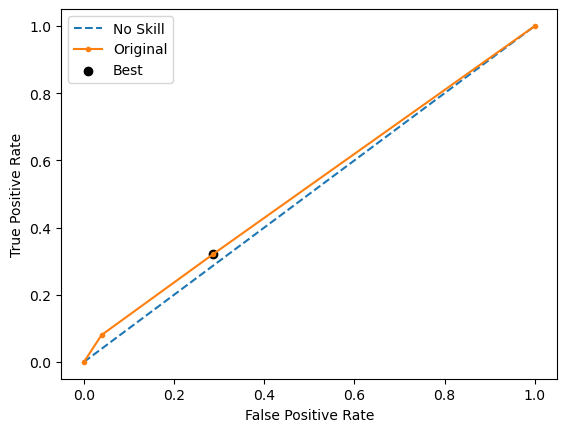

Run 2 - Random State: 1
Test G-mean: 0.30832602073930615
Best Threshold=1.000000, G-Mean=0.318


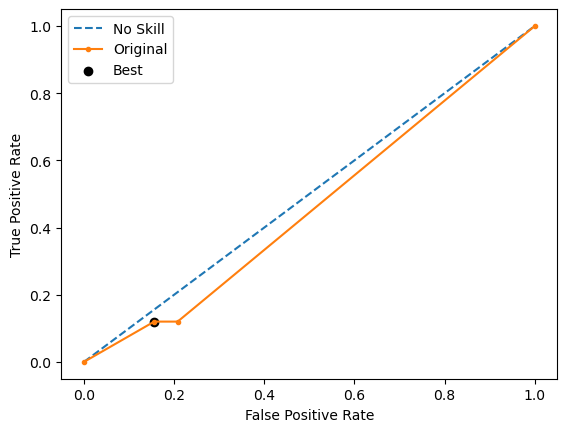

Run 3 - Random State: 2
Test G-mean: 0.42026584041934295
Best Threshold=0.733333, G-Mean=0.420


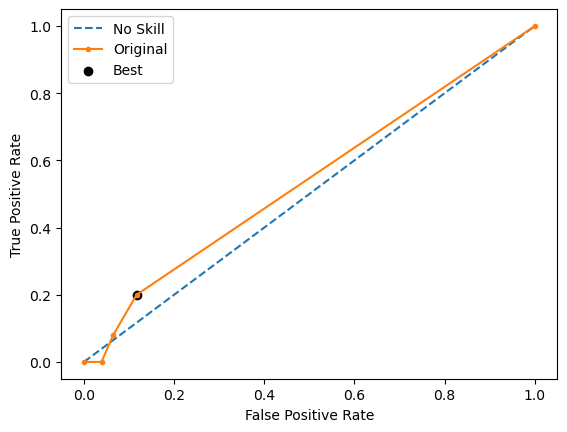

Run 4 - Random State: 3
Test G-mean: 0.19606518926509736
Best Threshold=1.000000, G-Mean=0.196


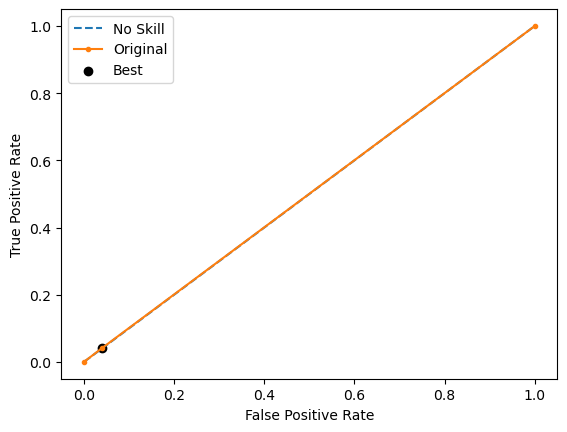

Run 5 - Random State: 4
Test G-mean: 0.19606518926509736
Best Threshold=0.500000, G-Mean=0.539


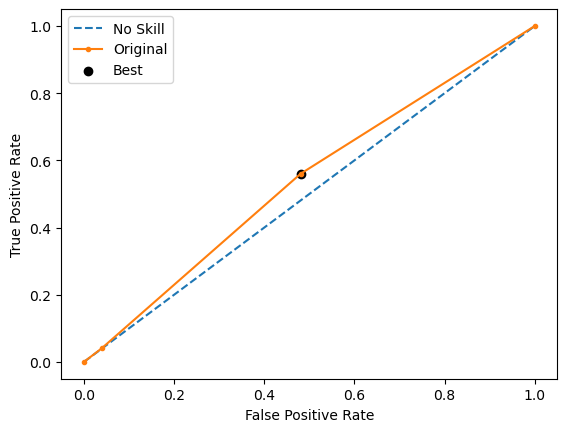

Ave Test G-mean: 0.31976273668452027
Stdev Test G-mean: 0.12835674727394347
Ave Test Specificity: 0.8623376623376624
Ave Test Recall: 0.14400000000000002
Ave Test NPV: 0.7563520004569918
Ave Test Accuracy: 0.6862745098039216
Ave Test Precision: 0.2563408521303258
Ave Test F1-Score: 0.16432280363314847
Ave Runtime: 0.015622806549072266


In [44]:
ho_t02_dt_gs, ho_t02_dt_be, ho_t02_dt_model_info, ho_t02_dt_metrics_df = dt_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits
Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 200, 'classifier__oob_score': True, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.40857142857142853
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 RandomForestClassifier(max_depth=2, min_samples_leaf=2,
                                        n_estimators=200, oob_score=True,
                                        random_state=0))])
Mean Train Score (G-mean) 0.5914739166922305
Std Train Score (G-mean) 0.04057019564675946
GridSearchCV Runtime: 141.28612112998962 secs
Run 1 - Random State: 0
Test G-mean: 0.5638457926792377
Best Threshold=0.419474, G-Mean=0.684


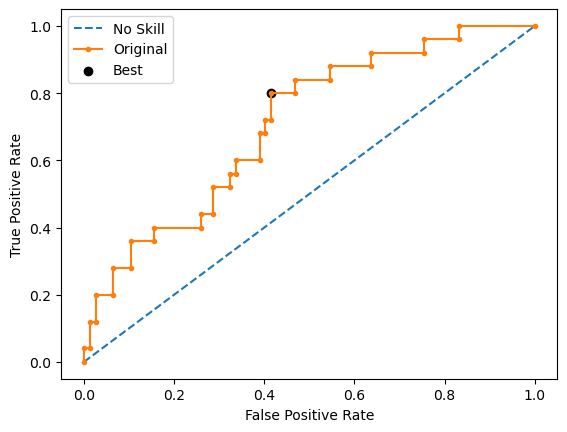

Run 2 - Random State: 1
Test G-mean: 0.41403933560541256
Best Threshold=0.458158, G-Mean=0.637


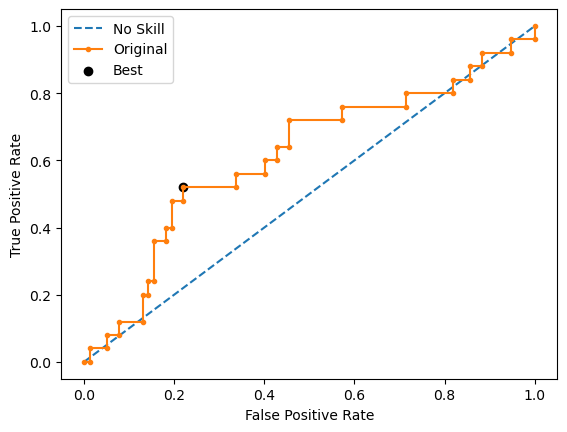

Run 3 - Random State: 2
Test G-mean: 0.3182745690417337
Best Threshold=0.411168, G-Mean=0.599


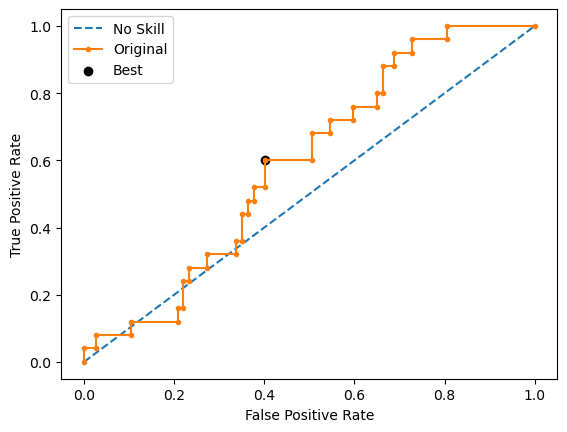

Run 4 - Random State: 3
Test G-mean: 0.33729250475845707
Best Threshold=0.370322, G-Mean=0.636


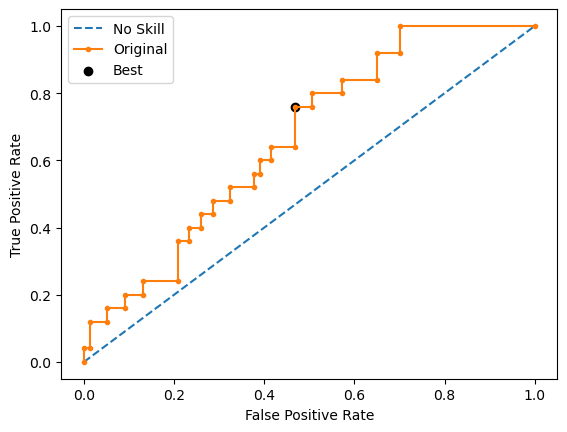

Run 5 - Random State: 4
Test G-mean: 0.5675190940205643
Best Threshold=0.481098, G-Mean=0.586


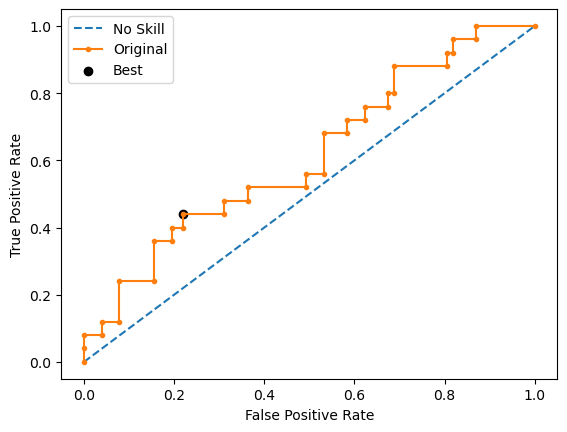

Ave Test G-mean: 0.440194259221081
Stdev Test G-mean: 0.12004017789632458
Ave Test Specificity: 0.8675324675324674
Ave Test Recall: 0.24000000000000005
Ave Test NPV: 0.7795415929193839
Ave Test Accuracy: 0.7137254901960784
Ave Test Precision: 0.3682142857142857
Ave Test F1-Score: 0.2800014180374362
Ave Runtime: 0.23814153671264648


In [45]:
ho_t02_rf_gs, ho_t02_rf_be, ho_t02_rf_model_info, ho_t02_rf_metrics_df = rf_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits


Best Hyperparameters: {'classifier__C': 1e-06, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs', 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.3812698412698413
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 LogisticRegression(C=1e-06, max_iter=1000, random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 18.671886920928955 secs
Run 1 - Random State: 0
Test G-mean: 0.5162300906509678
Best Threshold=0.456432, G-Mean=0.539



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\linear_mod

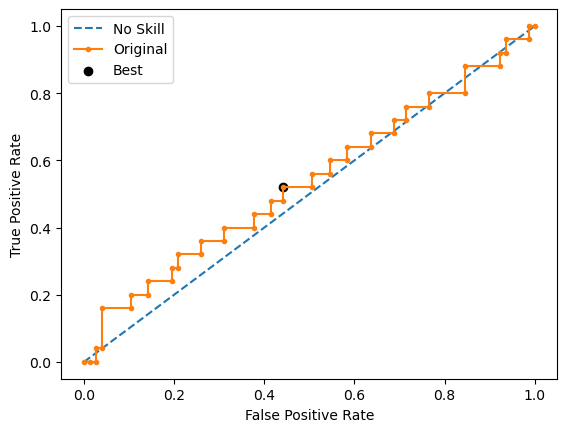

Run 2 - Random State: 1
Test G-mean: 0.44312936752559784
Best Threshold=0.434130, G-Mean=0.565


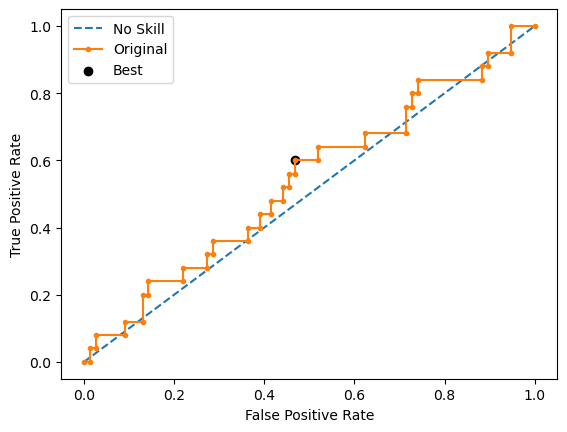

Run 3 - Random State: 2
Test G-mean: 0.5034942834893893
Best Threshold=0.452091, G-Mean=0.547


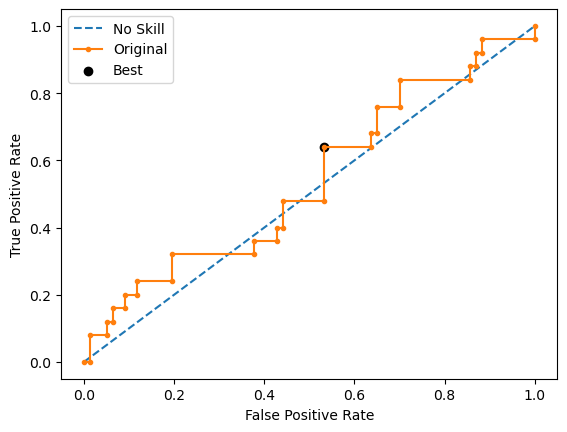

Run 4 - Random State: 3
Test G-mean: 0.35893059054804566
Best Threshold=0.460498, G-Mean=0.612


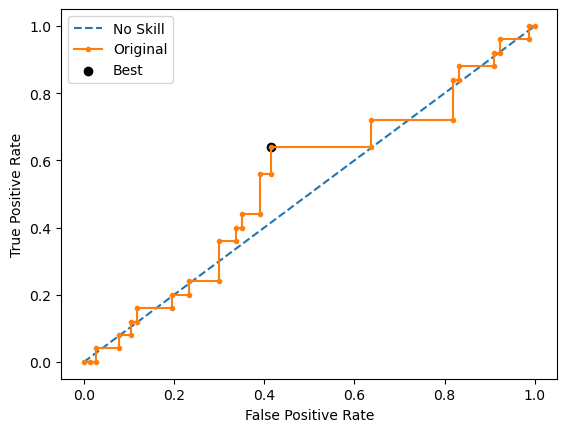

Run 5 - Random State: 4
Test G-mean: 0.5489068238769685
Best Threshold=0.524870, G-Mean=0.568


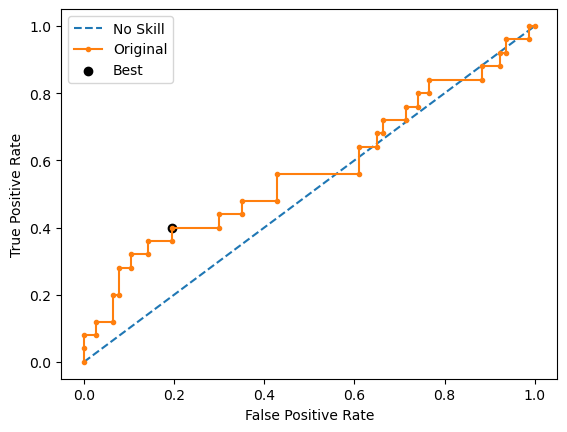

Ave Test G-mean: 0.47413823121819376
Stdev Test G-mean: 0.07493029257236242
Ave Test Specificity: 0.7818181818181819
Ave Test Recall: 0.296
Ave Test NPV: 0.774534876507753
Ave Test Accuracy: 0.6627450980392157
Ave Test Precision: 0.2998064125831821
Ave Test F1-Score: 0.29574383288669004
Ave Runtime: 0.03007330894470215


In [46]:
ho_t02_logreg_gs, ho_t02_logreg_be, ho_t02_logreg_model_info, ho_t02_logreg_metrics_df = logreg_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits


[LibSVM]Best Hyperparameters: {'classifier__C': 100.0, 'classifier__kernel': 'poly', 'classifier__probability': True, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.5
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 SVC(C=100.0, kernel='poly', max_iter=1000, probability=True,
                     random_state=0, verbose=True))])
Mean Train Score (G-mean) 0.3763228765577794
Std Train Score (G-mean) 0.08733215473347586
GridSearchCV Runtime: 15.30063009262085 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.2753981769078289
Best Threshold=0.407663, G-Mean=0.575


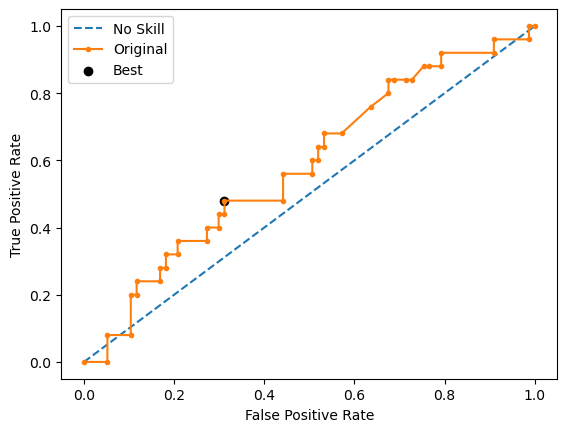

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.47042395910359547
Best Threshold=0.460674, G-Mean=0.566


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


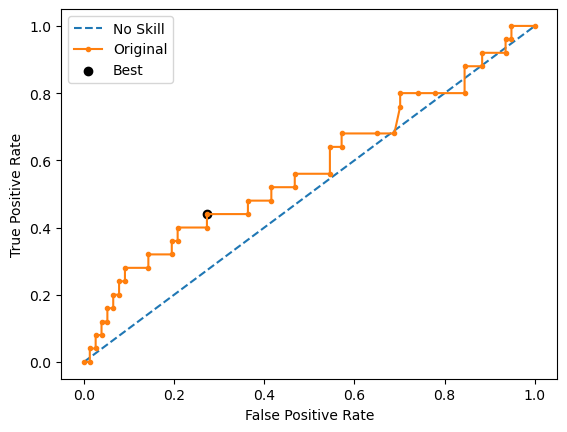

[LibSVM]Run 3 - Random State: 2
Test G-mean: 0.19473591841793833
Best Threshold=0.397695, G-Mean=0.486


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


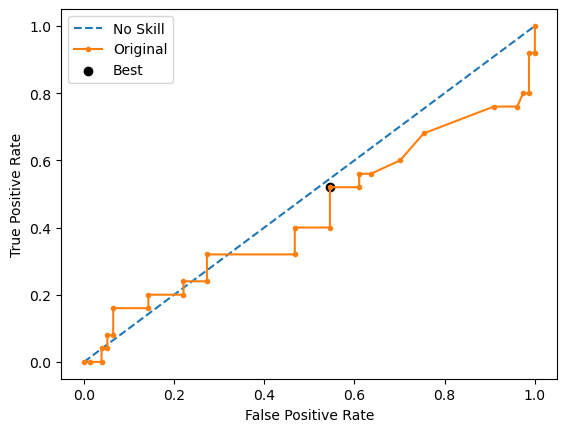

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.19606518926509736
Best Threshold=0.397822, G-Mean=0.618


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


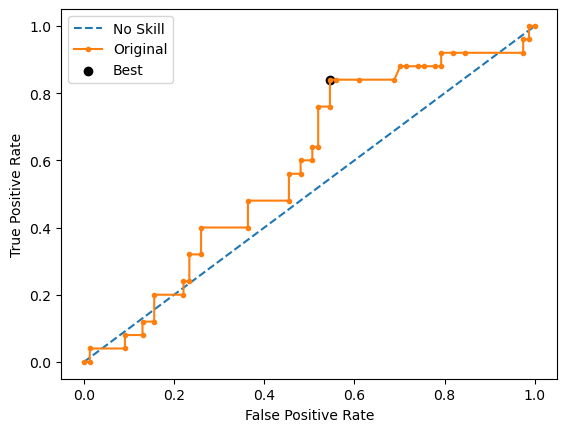

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.3867950227321825
Best Threshold=0.426576, G-Mean=0.626


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


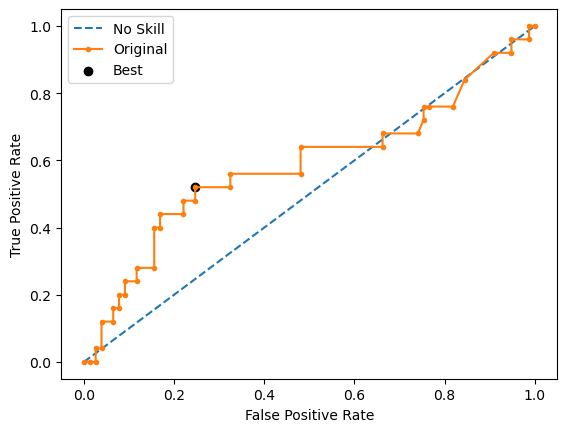

Ave Test G-mean: 0.30468365328532854
Stdev Test G-mean: 0.12140453062016639
Ave Test Specificity: 0.9428571428571428
Ave Test Recall: 0.11199999999999999
Ave Test NPV: 0.7662356928693216
Ave Test Accuracy: 0.7392156862745098
Ave Test Precision: 0.3455555555555555
Ave Test F1-Score: 0.16485657678878907
Ave Runtime: 0.019758939743041992


In [47]:
ho_t02_svm_gs, ho_t02_svm_be, ho_t02_svm_model_info, ho_t02_svm_metrics_df = svm_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

In [48]:
ho_t02_knn_gs, ho_t02_knn_be, ho_t02_knn_model_info, ho_t02_knn_metrics_df = knn_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
Best Hyperparameters: {'classifier__metric': 'canberra', 'classifier__n_neighbors': 10, 'resampling': SMOTE(random_state=0)}
Best Validation Score (G-mean): 0.5833333333333333
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', SMOTE(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='canberra', n_neighbors=10))])
Mean Train Score (G-mean) 0.5134853378396008
Std Train Score (G-mean) 0.031037116830592133
GridSearchCV Runtime: 14.34611177444458 secs
Run 1 - Random State: 0
Test G-mean: 0.19204977709728507
Run 2 - Random State: 1
Test G-mean: 0.27914526311954124
Run 3 - Random State: 2
Test G-mean: 0.2753981769078289
Run 4 - Random State: 3
Test G-mean: 0.1973855084879307
Run 5 - Random State: 4
Test G-mean: 0.3813850356982369
Ave Test G-mean: 0.26507275226216453
Stdev Test G-mean: 0.0770504949785215
Ave Test Specificity: 0.9454545454545455
Ave

Fitting 10 folds for each of 80 candidates, totalling 800 fits
Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 200, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.3435714285714286
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 GradientBoostingClassifier(max_depth=2, min_samples_leaf=2,
                                            n_estimators=200,
                                            random_state=0))])
Mean Train Score (G-mean) 0.8106852719887628
Std Train Score (G-mean) 0.014051182890469199
GridSearchCV Runtime: 37.47545266151428 secs
Run 1 - Random State: 0
Test G-mean: 0.3703280399090206
Best Threshold=0.241868, G-Mean=0.547


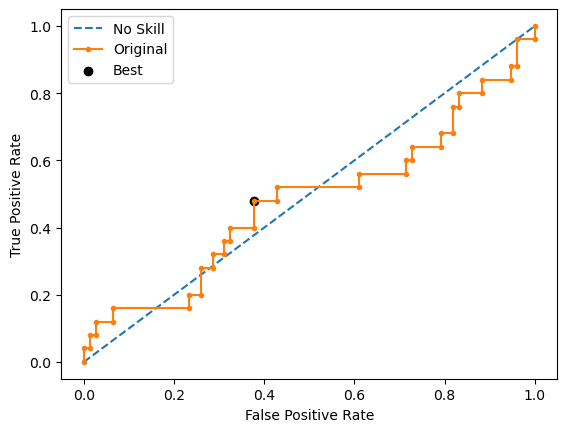

Run 2 - Random State: 1
Test G-mean: 0.45010821209727175
Best Threshold=0.319739, G-Mean=0.566


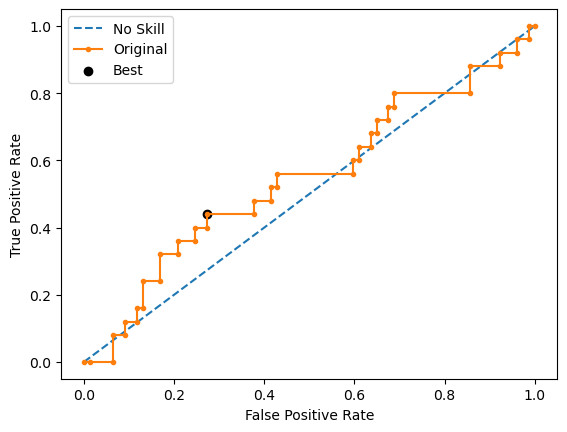

Run 3 - Random State: 2
Test G-mean: 0.4569804906461203
Best Threshold=0.209958, G-Mean=0.628


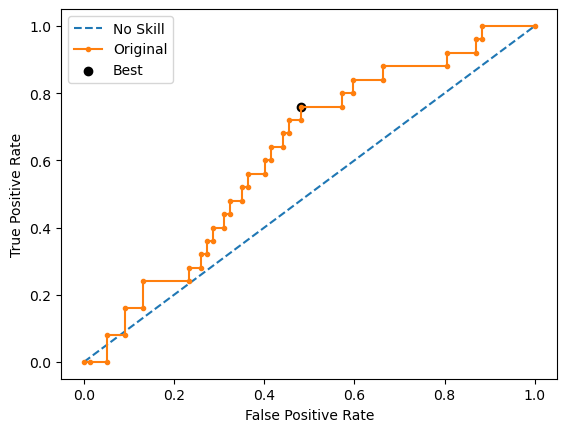

Run 4 - Random State: 3
Test G-mean: 0.3703280399090206
Best Threshold=0.159042, G-Mean=0.556


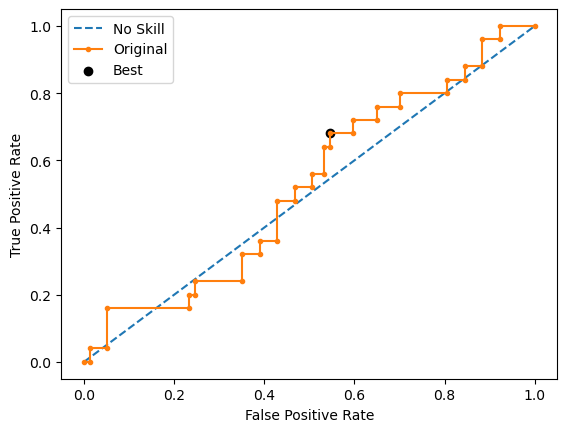

Run 5 - Random State: 4
Test G-mean: 0.5076045091036305
Best Threshold=0.226158, G-Mean=0.578


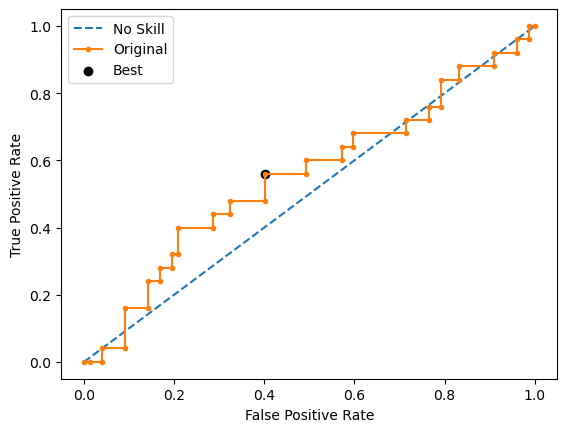

Ave Test G-mean: 0.43106985833301276
Stdev Test G-mean: 0.05972961903529316
Ave Test Specificity: 0.8467532467532468
Ave Test Recall: 0.22400000000000003
Ave Test NPV: 0.7709861594288014
Ave Test Accuracy: 0.6941176470588235
Ave Test Precision: 0.3178985507246377
Ave Test F1-Score: 0.2610172055208924
Ave Runtime: 0.6386206150054932


In [49]:
ho_t02_gbm_gs, ho_t02_gbm_be, ho_t02_gbm_model_info, ho_t02_gbm_metrics_df = gbm_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 2, 'classifier__max_leaves': 10, 'classifier__n_estimators': 200, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.39166666666666666
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importance_type=None,
           

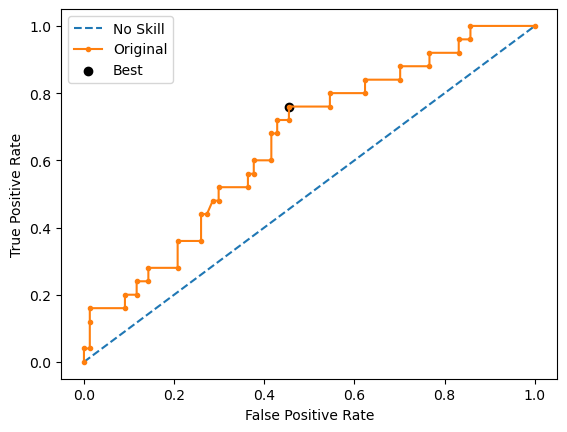

Run 2 - Random State: 1
Test G-mean: 0.5470107670062622
Best Threshold=0.435473, G-Mean=0.671


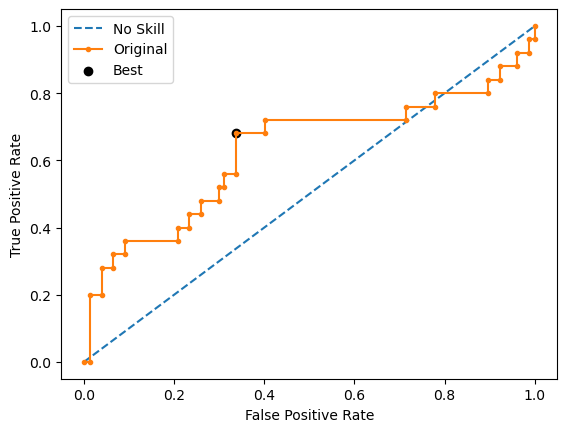

Run 3 - Random State: 2
Test G-mean: 0.4324499820938683
Best Threshold=0.403599, G-Mean=0.564


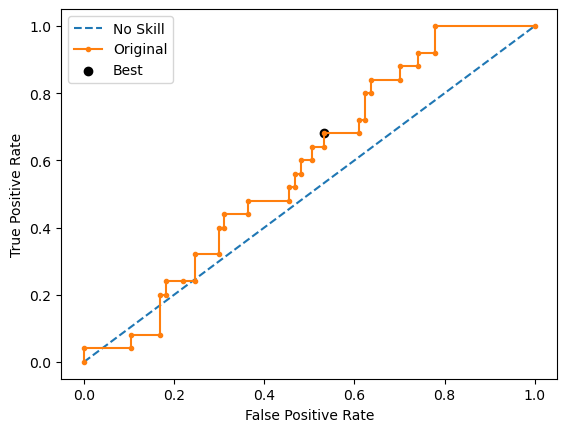

Run 4 - Random State: 3
Test G-mean: 0.47863442113047944
Best Threshold=0.405959, G-Mean=0.625


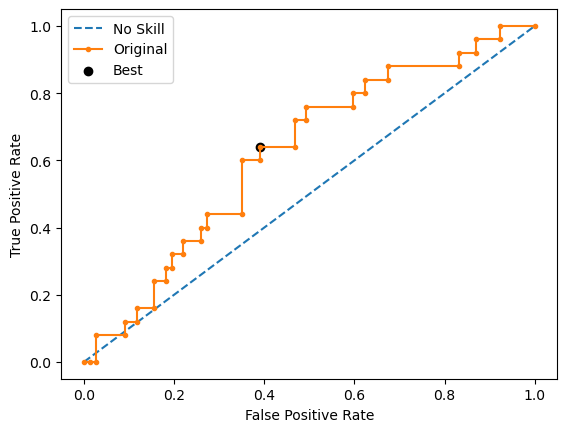

Run 5 - Random State: 4
Test G-mean: 0.46709936649691386
Best Threshold=0.447289, G-Mean=0.604


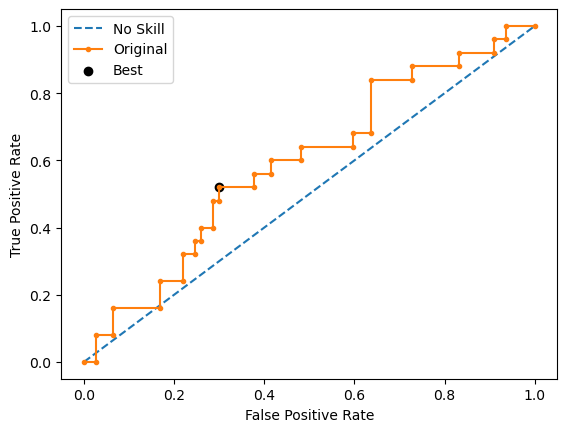

Ave Test G-mean: 0.46239791189194124
Stdev Test G-mean: 0.059282667169135286
Ave Test Specificity: 0.8285714285714286
Ave Test Recall: 0.264
Ave Test NPV: 0.776139153256344
Ave Test Accuracy: 0.6901960784313725
Ave Test Precision: 0.347880983750549
Ave Test F1-Score: 0.29166699057051126
Ave Runtime: 0.09829621315002442


In [50]:
ho_t02_xgb_gs, ho_t02_xgb_be, ho_t02_xgb_model_info, ho_t02_xgb_metrics_df = xgb_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits


Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.4333333333333334
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.8205827410255037
Std Train Score (G-mean) 0.013240469778193547
GridSearchCV Runtime: 4.256834268569946 secs
Run 1 - Random State: 0
Test G-mean: 0.3418817293789138
Best Threshold=0.880797, G-Mean=0.342


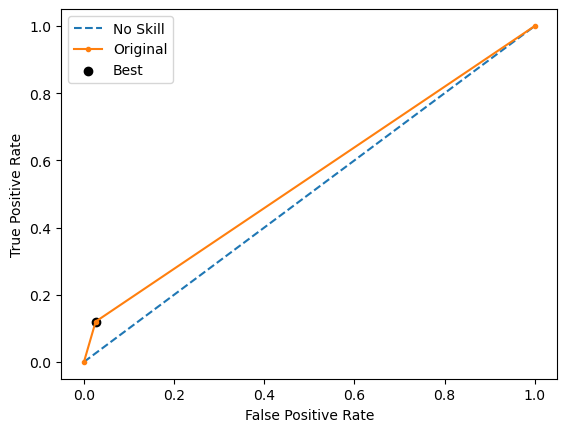

Run 2 - Random State: 1
Test G-mean: 0.4264014327112209
Best Threshold=0.880797, G-Mean=0.426


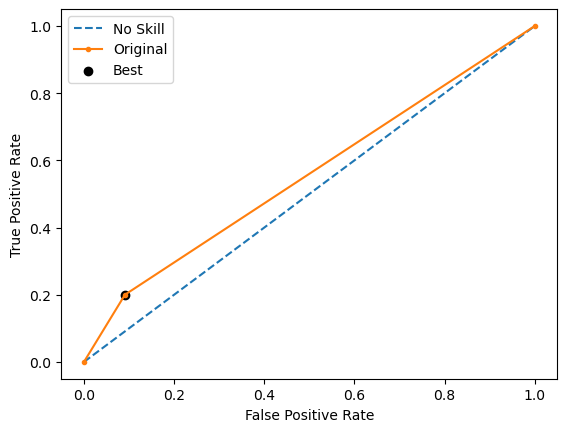

Run 3 - Random State: 2
Test G-mean: 0.46709936649691375
Best Threshold=0.880797, G-Mean=0.467


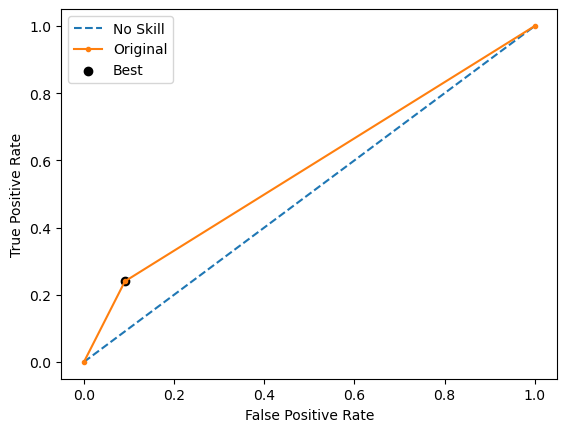

Run 4 - Random State: 3
Test G-mean: 0.3326399715147755
Best Threshold=0.880797, G-Mean=0.333


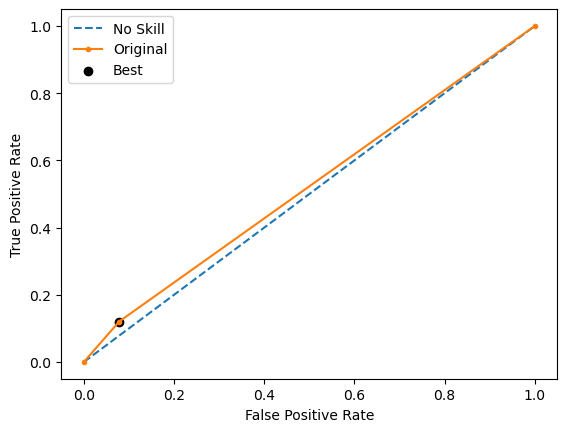

Run 5 - Random State: 4
Test G-mean: 0.40771775315010045
Best Threshold=0.880797, G-Mean=0.408


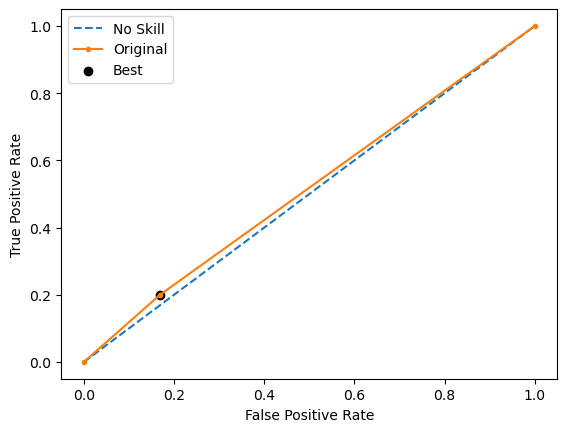

Ave Test G-mean: 0.39514805065038483
Stdev Test G-mean: 0.057132136539425164
Ave Test Specificity: 0.9090909090909092
Ave Test Recall: 0.17600000000000002
Ave Test NPV: 0.7725672260237675
Ave Test Accuracy: 0.7294117647058824
Ave Test Precision: 0.4178632478632479
Ave Test F1-Score: 0.23901769434493172
Ave Runtime: 0.230546236038208


In [51]:
ho_t02_adaboost_gs, ho_t02_adaboost_be, ho_t02_adaboost_model_info, ho_t02_adaboost_metrics_df = adaboost_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 229, number of negative: 229
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002037 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2055
[LightGBM] [Info] Number of data points in the train set: 458, number of used features: 49
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with 

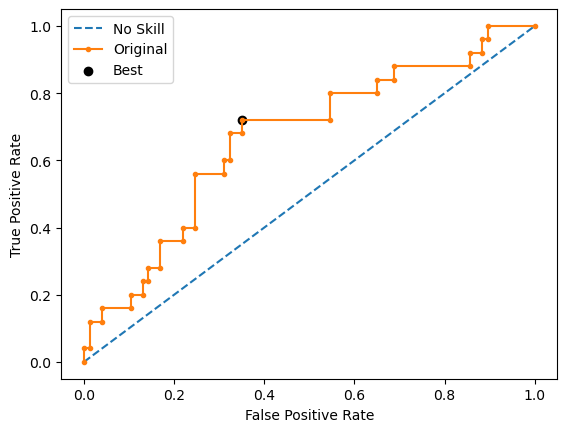

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 229, number of negative: 229
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000888 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2032
[LightGBM] [Info] Number of data points in the train set: 458, number of used features: 48
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further sp

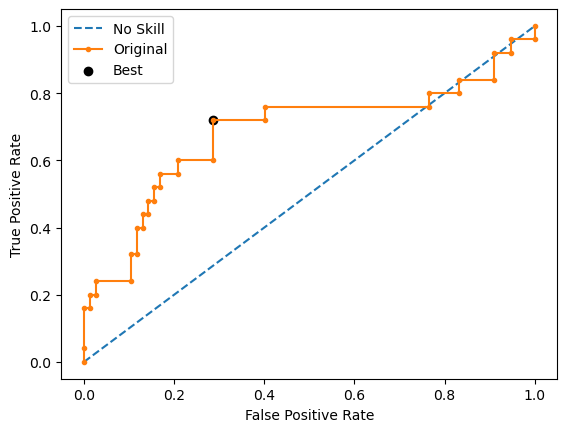

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 229, number of negative: 229
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000483 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2067
[LightGBM] [Info] Number of data points in the train set: 458, number of used features: 48
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further sp

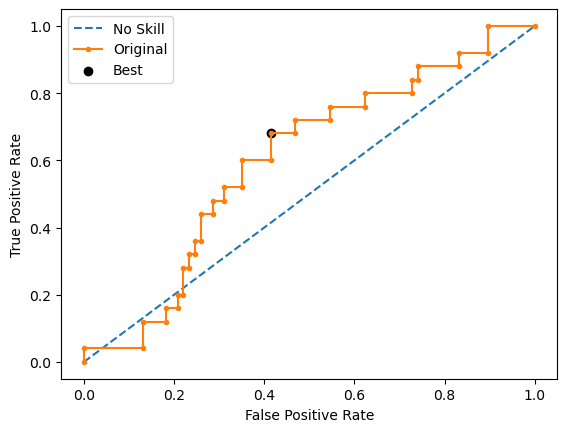

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 229, number of negative: 229
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000592 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2111
[LightGBM] [Info] Number of data points in the train set: 458, number of used features: 49
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further sp

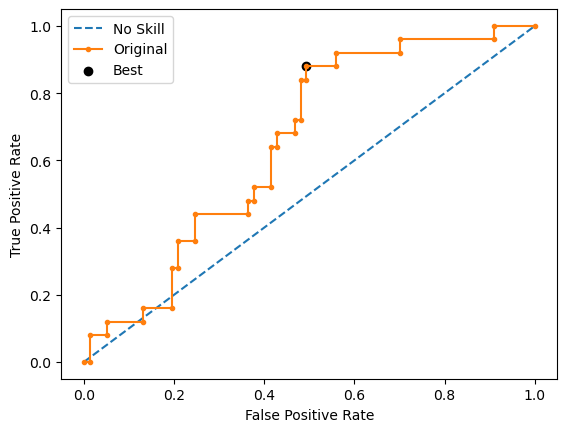

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 229, number of negative: 229
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000440 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2023
[LightGBM] [Info] Number of data points in the train set: 458, number of used features: 49
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further sp

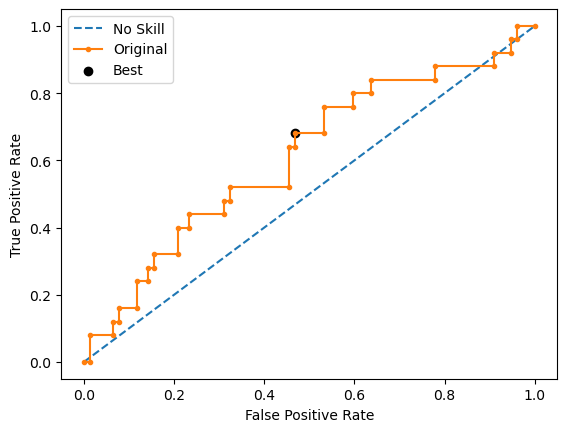

Ave Test G-mean: 0.4833117584287166
Stdev Test G-mean: 0.11548530439130654
Ave Test Specificity: 0.8233766233766234
Ave Test Recall: 0.296
Ave Test NPV: 0.7835198450339261
Ave Test Accuracy: 0.6941176470588235
Ave Test Precision: 0.34548539222452257
Ave Test F1-Score: 0.31614722548407714
Ave Runtime: 0.07952942848205566


In [52]:
ho_t02_lgbm_gs, ho_t02_lgbm_be, ho_t02_lgbm_model_info, ho_t02_lgbm_metrics_df = lgbm_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
Learning rate set to 0.007415
0:	learn: 0.6897733	total: 154ms	remaining: 2m 33s
1:	learn: 0.6874309	total: 156ms	remaining: 1m 17s
2:	learn: 0.6847050	total: 158ms	remaining: 52.5s
3:	learn: 0.6815782	total: 160ms	remaining: 39.8s
4:	learn: 0.6791156	total: 162ms	remaining: 32.2s
5:	learn: 0.6758852	total: 164ms	remaining: 27.2s
6:	learn: 0.6725587	total: 167ms	remaining: 23.6s
7:	learn: 0.6697851	total: 169ms	remaining: 20.9s
8:	learn: 0.6674670	total: 170ms	remaining: 18.8s
9:	learn: 0.6640779	total: 173ms	remaining: 17.1s
10:	learn: 0.6613497	total: 175ms	remaining: 15.7s
11:	learn: 0.6583770	total: 177ms	remaining: 14.6s
12:	learn: 0.6553921	total: 179ms	remaining: 13.6s
13:	learn: 0.6520336	total: 182ms	remaining: 12.8s
14:	learn: 0.6493374	total: 185ms	remaining: 12.1s
15:	learn: 0.6471907	total: 187ms	remaining: 11.5s
16:	learn: 0.6453141	total: 190ms	remaining: 11s
17:	learn: 0.6427433	total: 192ms	remaining: 10.5s
1

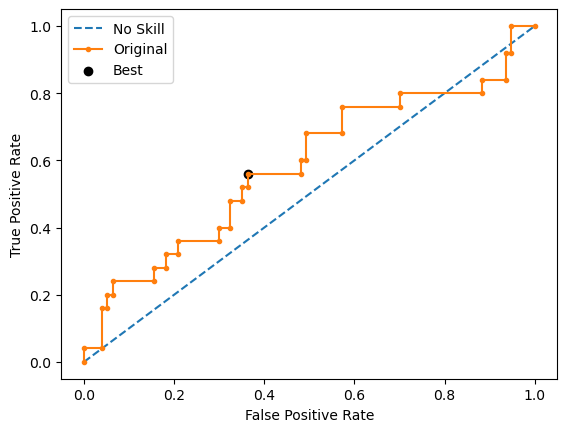

Learning rate set to 0.007422
0:	learn: 0.6901724	total: 4.87ms	remaining: 4.87s
1:	learn: 0.6866172	total: 7.58ms	remaining: 3.78s
2:	learn: 0.6833960	total: 10.6ms	remaining: 3.52s
3:	learn: 0.6807502	total: 13.4ms	remaining: 3.35s
4:	learn: 0.6781139	total: 16.4ms	remaining: 3.27s
5:	learn: 0.6762716	total: 19.2ms	remaining: 3.18s
6:	learn: 0.6733690	total: 21.6ms	remaining: 3.07s
7:	learn: 0.6714359	total: 24.1ms	remaining: 2.99s
8:	learn: 0.6689466	total: 26.1ms	remaining: 2.88s
9:	learn: 0.6658667	total: 28.3ms	remaining: 2.8s
10:	learn: 0.6627351	total: 30ms	remaining: 2.69s
11:	learn: 0.6599311	total: 31.9ms	remaining: 2.62s
12:	learn: 0.6563776	total: 33.8ms	remaining: 2.57s
13:	learn: 0.6538474	total: 35.9ms	remaining: 2.53s
14:	learn: 0.6508216	total: 37.6ms	remaining: 2.46s
15:	learn: 0.6481697	total: 39.5ms	remaining: 2.43s
16:	learn: 0.6454243	total: 41.3ms	remaining: 2.39s
17:	learn: 0.6421306	total: 43.2ms	remaining: 2.36s
18:	learn: 0.6390228	total: 45ms	remaining: 2.3

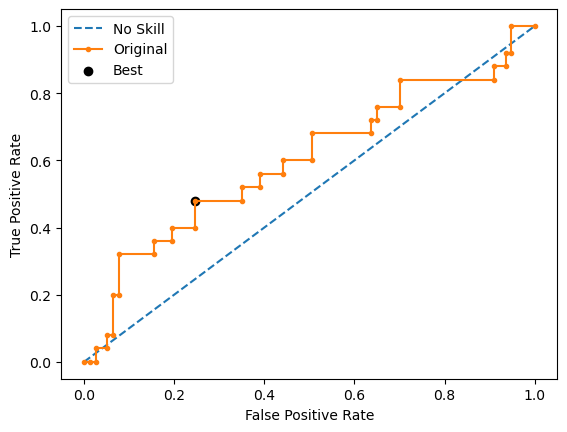

Learning rate set to 0.007409
0:	learn: 0.6893787	total: 3.91ms	remaining: 3.91s
1:	learn: 0.6863253	total: 7.51ms	remaining: 3.75s
2:	learn: 0.6835162	total: 11.3ms	remaining: 3.76s
3:	learn: 0.6799134	total: 14.4ms	remaining: 3.59s
4:	learn: 0.6773108	total: 17.4ms	remaining: 3.46s
5:	learn: 0.6740138	total: 19.9ms	remaining: 3.3s
6:	learn: 0.6714872	total: 21.7ms	remaining: 3.08s
7:	learn: 0.6682186	total: 25.3ms	remaining: 3.14s
8:	learn: 0.6645177	total: 28.4ms	remaining: 3.13s
9:	learn: 0.6615379	total: 31.1ms	remaining: 3.08s
10:	learn: 0.6581571	total: 33.1ms	remaining: 2.97s
11:	learn: 0.6553590	total: 35.7ms	remaining: 2.94s
12:	learn: 0.6530353	total: 38ms	remaining: 2.88s
13:	learn: 0.6512996	total: 40.7ms	remaining: 2.87s
14:	learn: 0.6484658	total: 43.8ms	remaining: 2.87s
15:	learn: 0.6455331	total: 46.3ms	remaining: 2.85s
16:	learn: 0.6418797	total: 49.2ms	remaining: 2.84s
17:	learn: 0.6390304	total: 51.3ms	remaining: 2.8s
18:	learn: 0.6369735	total: 53.9ms	remaining: 2.

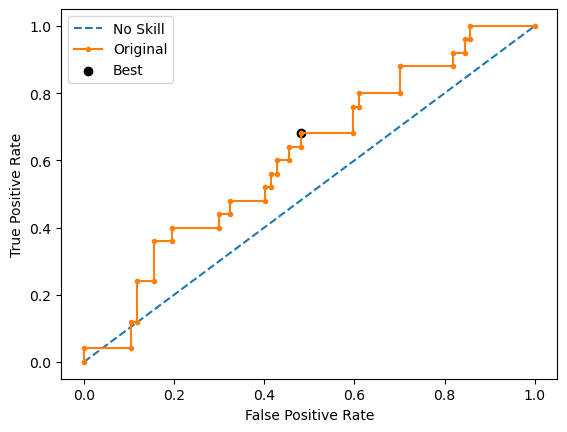

Learning rate set to 0.007429
0:	learn: 0.6890101	total: 4.54ms	remaining: 4.54s
1:	learn: 0.6863117	total: 8.28ms	remaining: 4.13s
2:	learn: 0.6839573	total: 11.9ms	remaining: 3.95s
3:	learn: 0.6810943	total: 16.1ms	remaining: 4s
4:	learn: 0.6779251	total: 20.7ms	remaining: 4.12s
5:	learn: 0.6755151	total: 24ms	remaining: 3.97s
6:	learn: 0.6732531	total: 28.5ms	remaining: 4.04s
7:	learn: 0.6702819	total: 32.1ms	remaining: 3.98s
8:	learn: 0.6677981	total: 34.7ms	remaining: 3.82s
9:	learn: 0.6648345	total: 37.6ms	remaining: 3.72s
10:	learn: 0.6612896	total: 40.3ms	remaining: 3.62s
11:	learn: 0.6587127	total: 42.3ms	remaining: 3.48s
12:	learn: 0.6561111	total: 45.2ms	remaining: 3.43s
13:	learn: 0.6536512	total: 47.7ms	remaining: 3.36s
14:	learn: 0.6508003	total: 49.8ms	remaining: 3.27s
15:	learn: 0.6473868	total: 53.2ms	remaining: 3.27s
16:	learn: 0.6443431	total: 56.5ms	remaining: 3.27s
17:	learn: 0.6422459	total: 58.8ms	remaining: 3.21s
18:	learn: 0.6393341	total: 61.3ms	remaining: 3.1

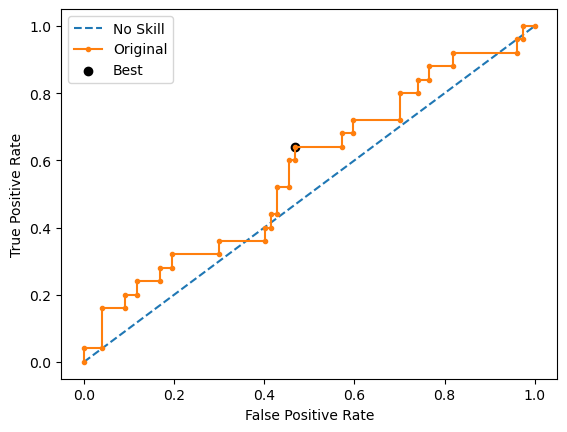

Learning rate set to 0.007422
0:	learn: 0.6898481	total: 3.7ms	remaining: 3.69s
1:	learn: 0.6856622	total: 6.73ms	remaining: 3.36s
2:	learn: 0.6825227	total: 12.4ms	remaining: 4.14s
3:	learn: 0.6792397	total: 16.7ms	remaining: 4.15s
4:	learn: 0.6761021	total: 20.7ms	remaining: 4.12s
5:	learn: 0.6733930	total: 24.1ms	remaining: 4s
6:	learn: 0.6697788	total: 26.1ms	remaining: 3.71s
7:	learn: 0.6667736	total: 29.2ms	remaining: 3.62s
8:	learn: 0.6631862	total: 32.8ms	remaining: 3.61s
9:	learn: 0.6593208	total: 35.6ms	remaining: 3.53s
10:	learn: 0.6559233	total: 38ms	remaining: 3.42s
11:	learn: 0.6528152	total: 40.9ms	remaining: 3.37s
12:	learn: 0.6496924	total: 42.5ms	remaining: 3.23s
13:	learn: 0.6471180	total: 46ms	remaining: 3.24s
14:	learn: 0.6444690	total: 48.3ms	remaining: 3.17s
15:	learn: 0.6411977	total: 51.3ms	remaining: 3.15s
16:	learn: 0.6390001	total: 53.9ms	remaining: 3.12s
17:	learn: 0.6349467	total: 56.3ms	remaining: 3.07s
18:	learn: 0.6323838	total: 59.1ms	remaining: 3.05s


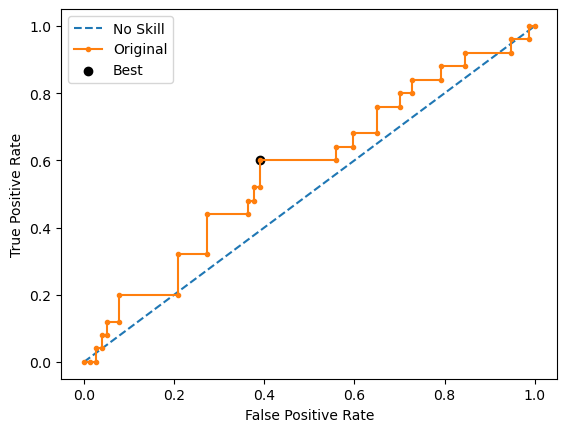

Ave Test G-mean: 0.408820135257709
Stdev Test G-mean: 0.09281750261832734
Ave Test Specificity: 0.903896103896104
Ave Test Recall: 0.192
Ave Test NPV: 0.7750119820978828
Ave Test Accuracy: 0.7294117647058824
Ave Test Precision: 0.4012276612276612
Ave Test F1-Score: 0.25677847148651384
Ave Runtime: 2.1252085685729982


In [53]:
ho_t02_catboost_gs, ho_t02_catboost_be, ho_t02_catboost_model_info, ho_t02_catboost_metrics_df = catboost_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

In [54]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost', 'catboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost', 'CatBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t02_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t02_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t02_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall', 'Average Test Precision', 'Average Test F1-score',
    'Average Test Accuracy'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall,Average Test Precision,Average Test F1-score,Average Test Accuracy
6,LightGBM,0.483312,0.115485,0.439524,0.690166,0.823377,0.296,0.345485,0.316147,0.694118
2,Logistic Regression,0.474138,0.074930,0.381270,NaN,0.781818,0.296,0.299806,0.295744,0.662745
7,Extreme Gradient Boosting (XGBoost),0.462398,0.059283,0.391667,0.778563,0.828571,0.264,0.347881,0.291667,0.690196
4,Random Forest,0.440194,0.120040,0.408571,0.591474,0.867532,0.240,0.368214,0.280001,0.713725
5,Gradient Boosting Machine (GBM),0.431070,0.059730,0.343571,0.810685,0.846753,0.224,0.317899,0.261017,0.694118
9,CatBoost,0.408820,0.092818,0.441667,0.832755,0.903896,0.192,0.401228,0.256778,0.729412
8,AdaBoost,0.395148,0.057132,0.433333,0.820583,0.909091,0.176,0.417863,0.239018,0.729412
3,Decision Tree,0.319763,0.128357,0.453983,NaN,0.862338,0.144,0.256341,0.164323,0.686275
1,SVM Classifier,0.304684,0.121405,0.500000,0.376323,0.942857,0.112,0.345556,0.164857,0.739216
0,k-Nearest Neighbors,0.265073,0.077050,0.583333,0.513485,0.945455,0.080,0.334632,0.124623,0.733333


In [55]:
best_scores_models = {
    'Best Score': [],
    'Best Model': []
}

indices = [
    'Highest Test Accuracy',
    'Highest Test G-mean',
    'Highest Test Recall',
    'Highest Test Precision',
    'Highest Test Specificity',
    'Highest Test F1-score'
]

# Corresponding column names in your original dataframe
columns = [
    'Average Test Accuracy',
    'Average Test G-mean',
    'Average Test Recall',
    'Average Test Precision',
    'Average Test Specificity',
    'Average Test F1-score'
]

df = ho_t02_summ
# Finding the best model for each metric
for col in columns:
    best_score = df[col].max()
    best_model = df.loc[df[col] == best_score, 'Classifier model'].values[0]
    
    best_scores_models['Best Score'].append(best_score)
    best_scores_models['Best Model'].append(best_model)

# Creating the new dataframe
best_df = pd.DataFrame(best_scores_models, index=indices)

# Displaying the new dataframe
best_df

,Best Score,Best Model
Highest Test Accuracy,0.739216,SVM Classifier
Highest Test G-mean,0.483312,LightGBM
Highest Test Recall,0.296000,Logistic Regression
Highest Test Precision,0.417863,AdaBoost
Highest Test Specificity,0.945455,k-Nearest Neighbors
Highest Test F1-score,0.316147,LightGBM


# HO-T03 Runs

In [95]:
ho_t03.shape, ho_t02.shape

((55, 46), (55, 54))

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits



4320 fits failed out of a total of 17280.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1988 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1145, in wrapper
    estimator._validate_params()
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 638, in _

Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 2, 'classifier__max_features': 'sqrt', 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.38333333333333336
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 DecisionTreeClassifier(max_depth=2, max_features='sqrt',
                                        random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 68.17767214775085 secs
Run 1 - Random State: 0
Test G-mean: 0.0
Best Threshold=inf, G-Mean=0.000


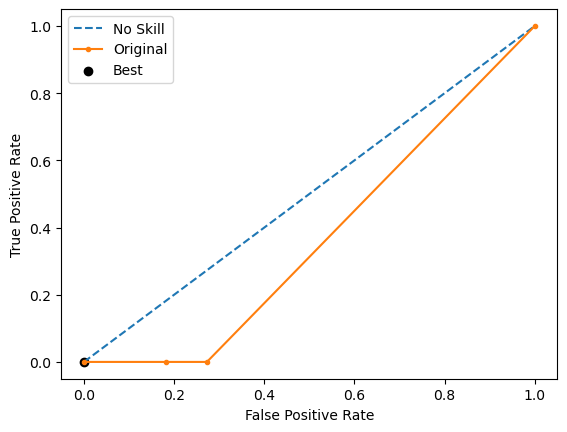

Run 2 - Random State: 1
Test G-mean: 0.4264014327112209
Best Threshold=1.000000, G-Mean=0.550


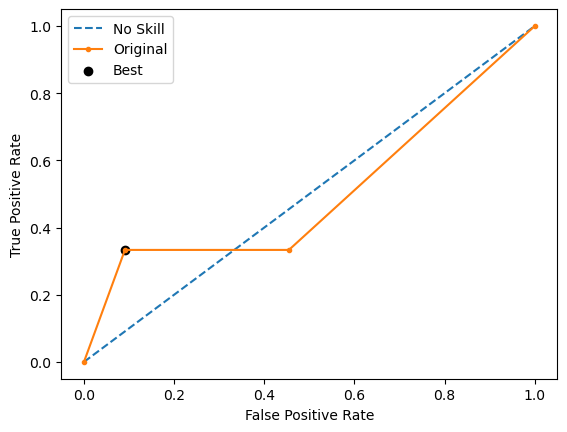

Run 3 - Random State: 2
Test G-mean: 0.7385489458759964
Best Threshold=1.000000, G-Mean=0.739


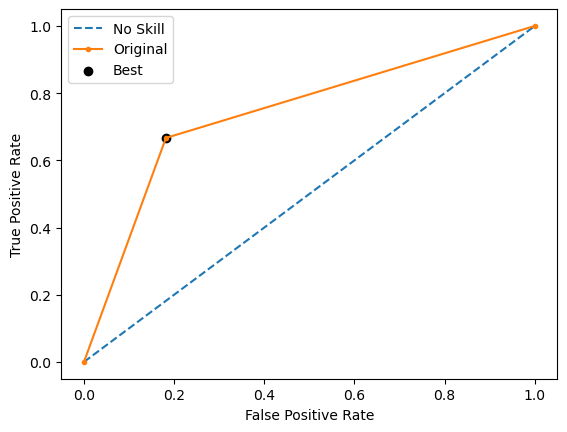

Run 4 - Random State: 3
Test G-mean: 0.6513389472789296
Best Threshold=0.666667, G-Mean=0.651


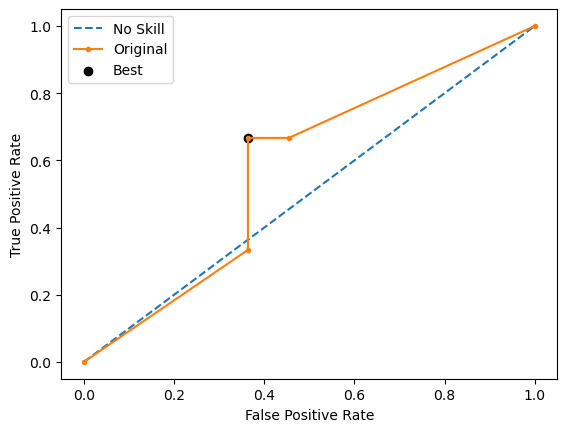

Run 5 - Random State: 4
Test G-mean: 0.0
Best Threshold=inf, G-Mean=0.000


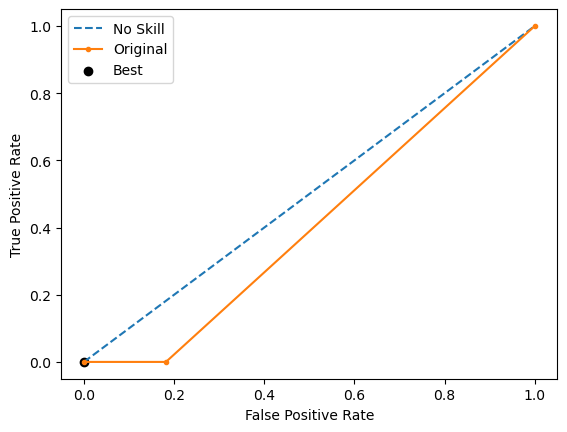

Ave Test G-mean: 0.36325786517322933
Stdev Test G-mean: 0.35061865625779637
Ave Test Specificity: 0.7272727272727273
Ave Test Recall: 0.3333333333333333
Ave Test NPV: 0.805
Ave Test Accuracy: 0.6428571428571428
Ave Test Precision: 0.2
Ave Test F1-Score: 0.24761904761904763
Ave Runtime: 0.01420130729675293


In [96]:
ho_t03_dt_gs, ho_t03_dt_be, ho_t03_dt_model_info, ho_t03_dt_metrics_df = dt_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits
Best Hyperparameters: {'classifier__C': 1.0, 'classifier__penalty': 'l2', 'classifier__solver': 'liblinear', 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.2833333333333333
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 LogisticRegression(max_iter=1000, random_state=0,
                                    solver='liblinear'))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 14.720220804214478 secs
Run 1 - Random State: 0
Test G-mean: 0.6513389472789296
Best Threshold=0.691551, G-Mean=0.651



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\linear_mod

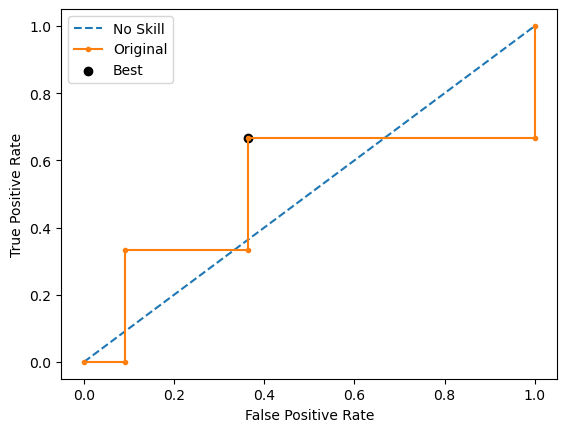

Run 2 - Random State: 1
Test G-mean: 0.6030226891555271
Best Threshold=0.837924, G-Mean=0.651


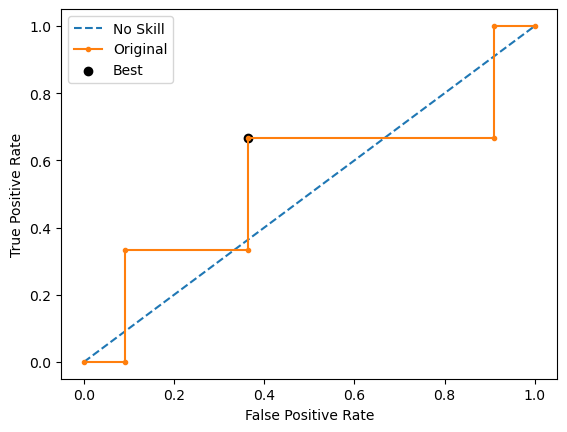

Run 3 - Random State: 2
Test G-mean: 0.7977240352174656
Best Threshold=0.783223, G-Mean=0.905


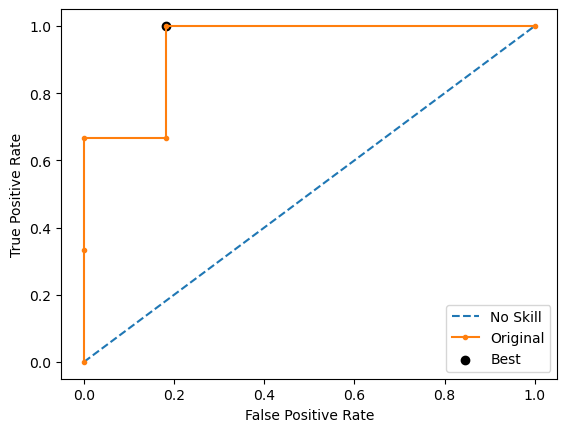

Run 4 - Random State: 3
Test G-mean: 0.4264014327112209
Best Threshold=0.793009, G-Mean=0.798


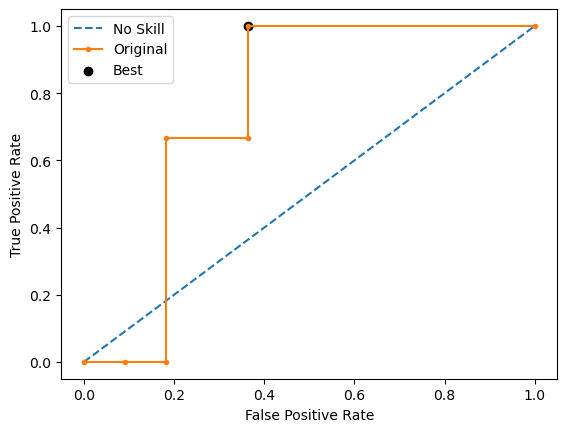

Run 5 - Random State: 4
Test G-mean: 0.4264014327112209
Best Threshold=0.575175, G-Mean=0.492


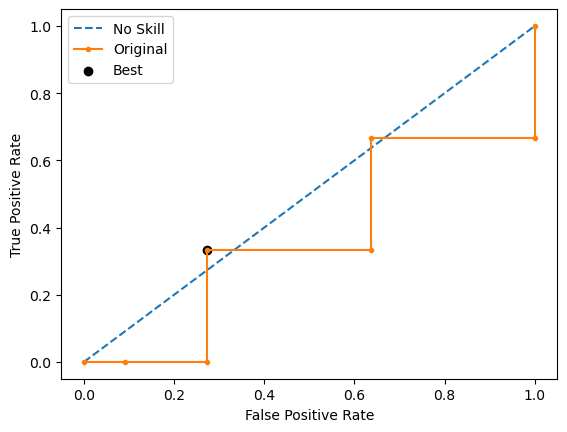

Ave Test G-mean: 0.5809777074148729
Stdev Test G-mean: 0.1582745283625731
Ave Test Specificity: 0.509090909090909
Ave Test Recall: 0.7333333333333333
Ave Test NPV: 0.8964285714285716
Ave Test Accuracy: 0.5571428571428572
Ave Test Precision: 0.29285714285714287
Ave Test F1-Score: 0.4133333333333334
Ave Runtime: 0.01726555824279785


In [97]:
ho_t03_logreg_gs, ho_t03_logreg_be, ho_t03_logreg_model_info, ho_t03_logreg_metrics_df = logreg_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]Best Hyperparameters: {'classifier__C': 100.0, 'classifier__kernel': 'sigmoid', 'classifier__probability': True, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.4333333333333333
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 SVC(C=100.0, kernel='sigmoid', max_iter=1000, probability=True,
                     random_state=0, verbose=True))])
Mean Train Score (G-mean) 0.6566357885288227
Std Train Score (G-mean) 0.10517315456734432
GridSearchCV Runtime: 19.54076075553894 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.6513389472789296
Best Threshold=0.336934, G-Mean=0.696


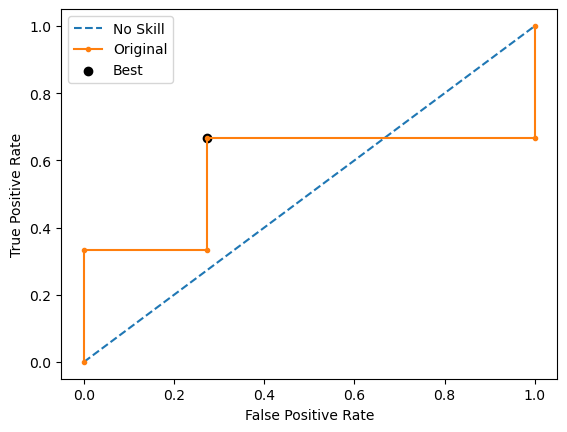

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.5222329678670935
Best Threshold=0.374077, G-Mean=0.651


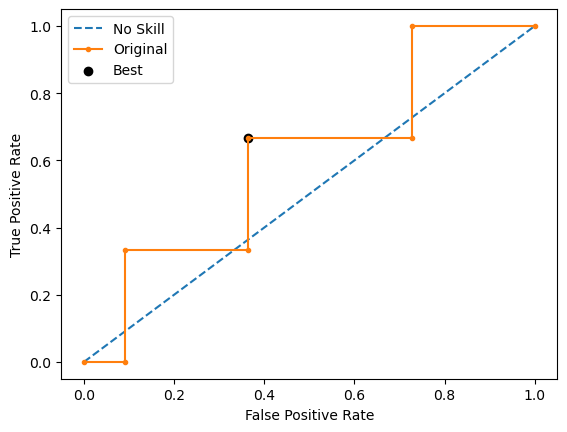

[LibSVM]Run 3 - Random State: 2
Test G-mean: 0.6030226891555271
Best Threshold=0.997059, G-Mean=0.778


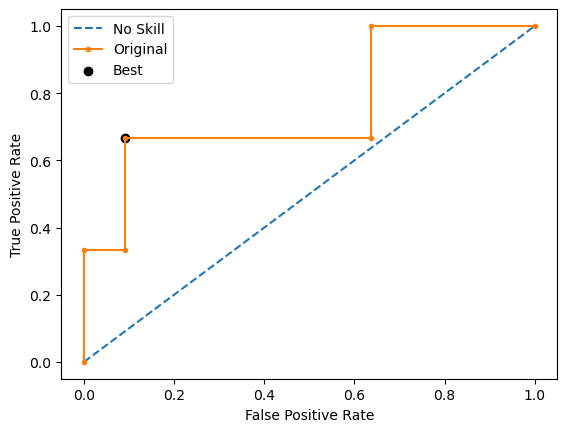

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.7385489458759964
Best Threshold=0.415028, G-Mean=0.853


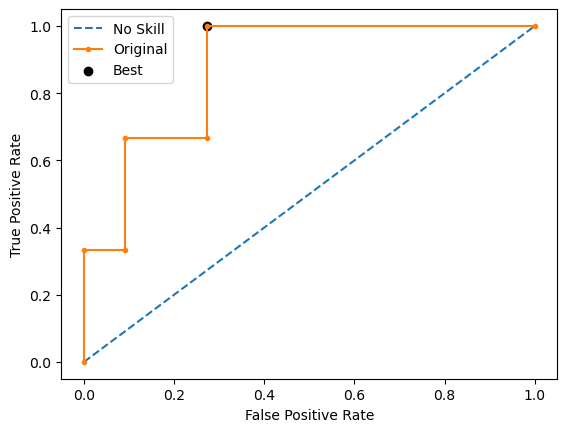

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.5504818825631803
Best Threshold=0.341787, G-Mean=0.674


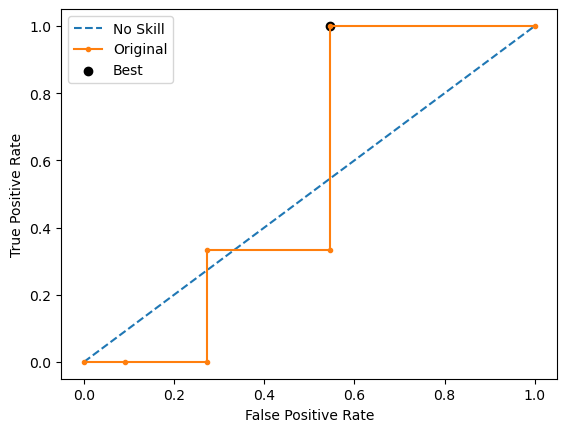

Ave Test G-mean: 0.6131250865481455
Stdev Test G-mean: 0.0858473213291409
Ave Test Specificity: 0.6
Ave Test Recall: 0.6666666666666666
Ave Test NPV: 0.8767316017316018
Ave Test Accuracy: 0.6142857142857143
Ave Test Precision: 0.31547619047619047
Ave Test F1-Score: 0.41737373737373734
Ave Runtime: 0.01660184860229492


In [98]:
ho_t03_svm_gs, ho_t03_svm_be, ho_t03_svm_model_info, ho_t03_svm_metrics_df = svm_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

In [99]:
ho_t03_knn_gs, ho_t03_knn_be, ho_t03_knn_model_info, ho_t03_knn_metrics_df = knn_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
Best Hyperparameters: {'classifier__metric': 'hamming', 'classifier__n_neighbors': 11, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.55
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='hamming', n_neighbors=11))])
Mean Train Score (G-mean) 0.514642065841189
Std Train Score (G-mean) 0.12645101883028814
GridSearchCV Runtime: 26.562851905822754 secs
Run 1 - Random State: 0
Test G-mean: 0.4605661864718383
Run 2 - Random State: 1
Test G-mean: 0.4923659639173309
Run 3 - Random State: 2
Test G-mean: 0.6963106238227913
Run 4 - Random State: 3
Test G-mean: 0.7385489458759964
Run 5 - Random State: 4
Test G-mean: 0.6513389472789296
Ave Test G-mean: 0.6078261334733772
Stdev Test G-mean: 0.12432604958829989
Ave Test Specificity: 0.7090909090909

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.01, 'classifier__max_depth': None, 'classifier__max_leaves': 10, 'classifier__n_estimators': 250, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.3
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importance_type=None,
                        

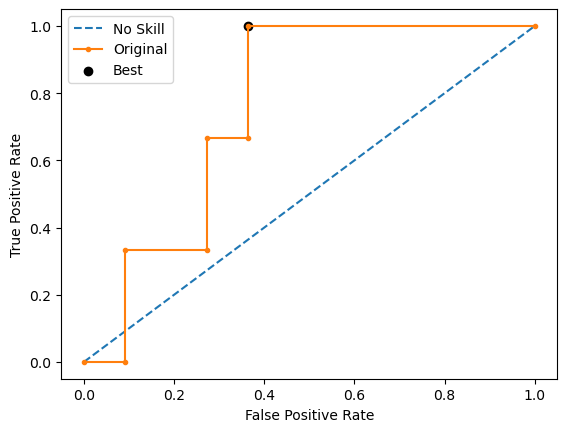

Run 2 - Random State: 1
Test G-mean: 0.5222329678670935
Best Threshold=0.261446, G-Mean=0.651


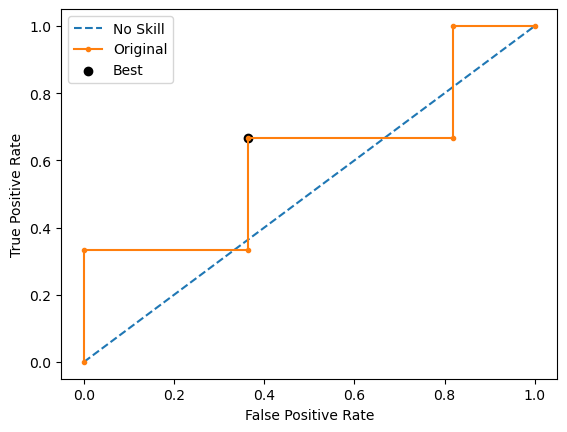

Run 3 - Random State: 2
Test G-mean: 0.5504818825631802
Best Threshold=0.203865, G-Mean=0.739


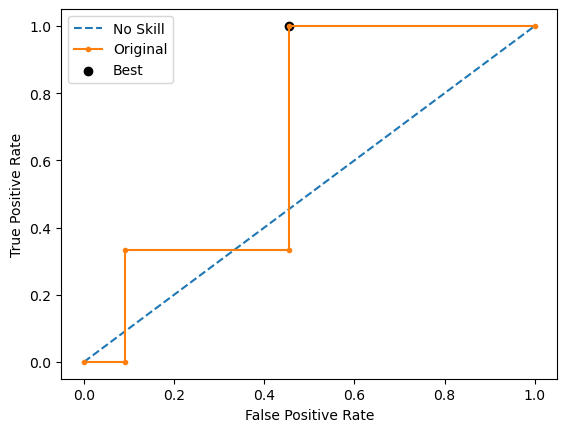

Run 4 - Random State: 3
Test G-mean: 0.6963106238227913
Best Threshold=0.502441, G-Mean=0.696


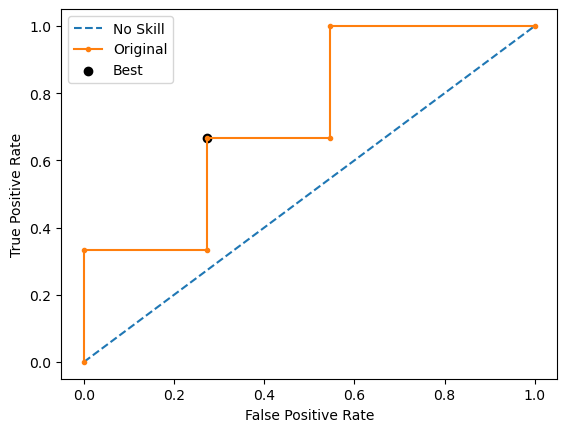

Run 5 - Random State: 4
Test G-mean: 0.6030226891555271
Best Threshold=0.888030, G-Mean=0.816


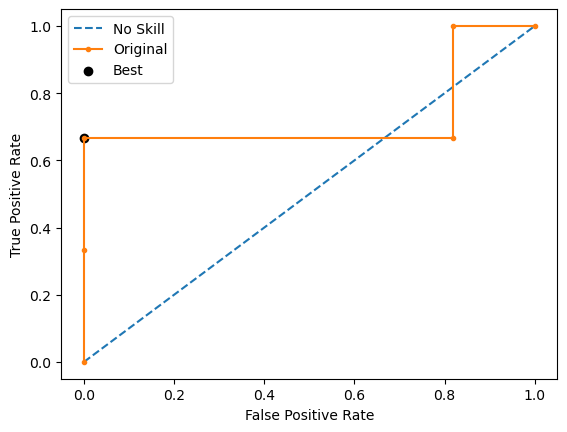

Ave Test G-mean: 0.5728828254651845
Stdev Test G-mean: 0.08014519340203824
Ave Test Specificity: 0.7454545454545454
Ave Test Recall: 0.4666666666666666
Ave Test NPV: 0.8395093795093794
Ave Test Accuracy: 0.6857142857142857
Ave Test Precision: 0.3538095238095238
Ave Test F1-Score: 0.38380952380952377
Ave Runtime: 0.08953008651733399


In [100]:
ho_t03_xgb_gs, ho_t03_xgb_be, ho_t03_xgb_model_info, ho_t03_xgb_metrics_df = xgb_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
[LightGBM] [Info] Number of positive: 30, number of negative: 31
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000618 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 547
[LightGBM] [Info] Number of data points in the train set: 61, number of used features: 42
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491803 -> initscore=-0.032790
[LightGBM] [Info] Start training from score -0.032790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

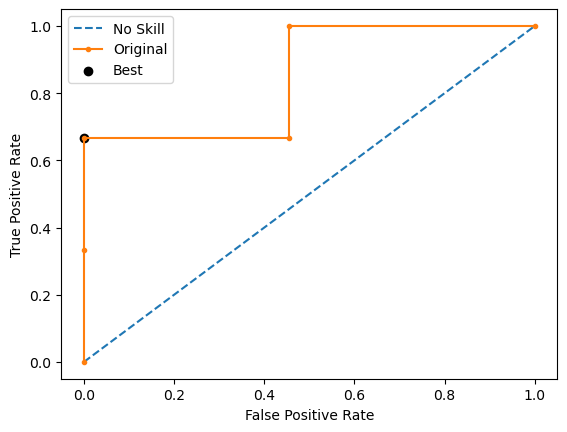

[LightGBM] [Info] Number of positive: 34, number of negative: 31
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000138 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 593
[LightGBM] [Info] Number of data points in the train set: 65, number of used features: 42
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.523077 -> initscore=0.092373
[LightGBM] [Info] Start training from score 0.092373
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

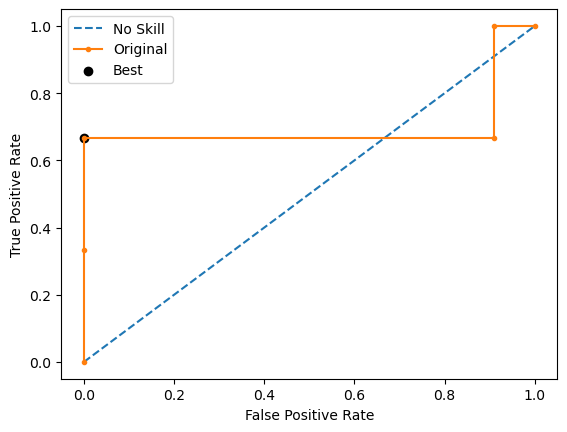

[LightGBM] [Info] Number of positive: 29, number of negative: 31
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000124 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 538
[LightGBM] [Info] Number of data points in the train set: 60, number of used features: 42
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483333 -> initscore=-0.066691
[LightGBM] [Info] Start training from score -0.066691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

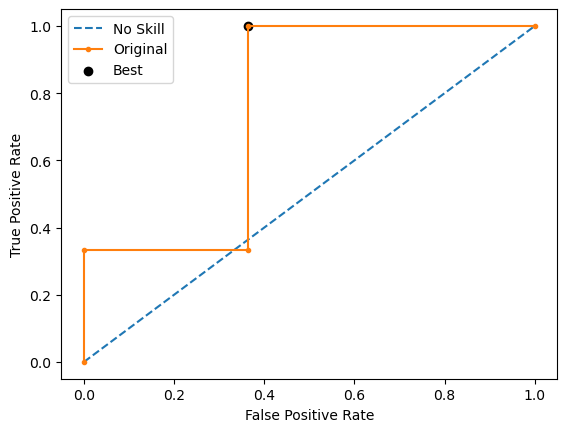

[LightGBM] [Info] Number of positive: 28, number of negative: 31
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000251 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 59, number of used features: 42
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.474576 -> initscore=-0.101783
[LightGBM] [Info] Start training from score -0.101783
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

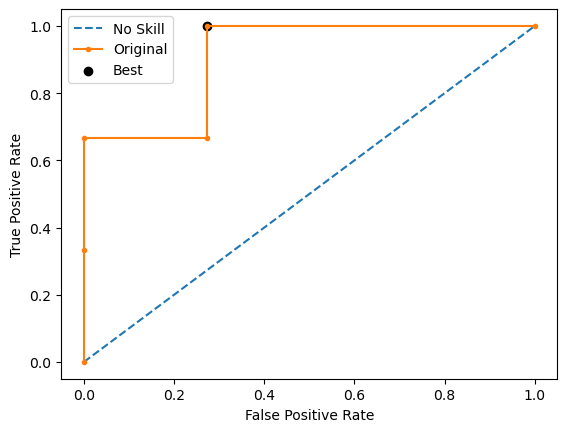

[LightGBM] [Info] Number of positive: 29, number of negative: 31
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000272 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 539
[LightGBM] [Info] Number of data points in the train set: 60, number of used features: 42
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483333 -> initscore=-0.066691
[LightGBM] [Info] Start training from score -0.066691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

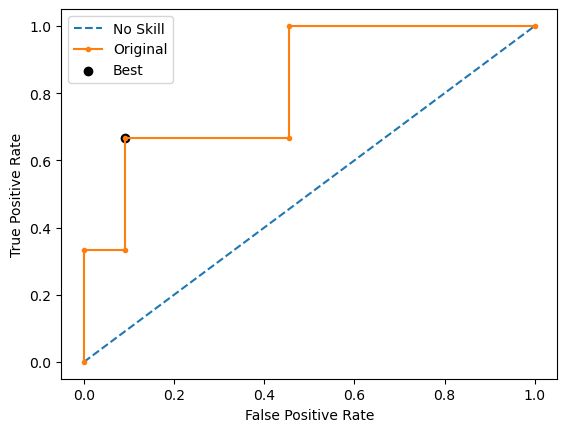

Ave Test G-mean: 0.6684076737225303
Stdev Test G-mean: 0.157709576340112
Ave Test Specificity: 0.8
Ave Test Recall: 0.5999999999999999
Ave Test NPV: 0.8839926739926739
Ave Test Accuracy: 0.7571428571428571
Ave Test Precision: 0.6071428571428571
Ave Test F1-Score: 0.5304761904761904
Ave Runtime: 0.06070342063903809


In [101]:
ho_t03_lgbm_gs, ho_t03_lgbm_be, ho_t03_lgbm_model_info, ho_t03_lgbm_metrics_df = lgbm_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits
Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 250, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.4666666666666666
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 GradientBoostingClassifier(min_samples_leaf=3,
                                            n_estimators=250,
                                            random_state=0))])
Mean Train Score (G-mean) 0.8373805026243109
Std Train Score (G-mean) 0.028981406721918335
GridSearchCV Runtime: 21.550211191177368 secs
Run 1 - Random State: 0
Test G-mean: 0.4923659639173309
Best Threshold=0.000000, G-Mean=0.674


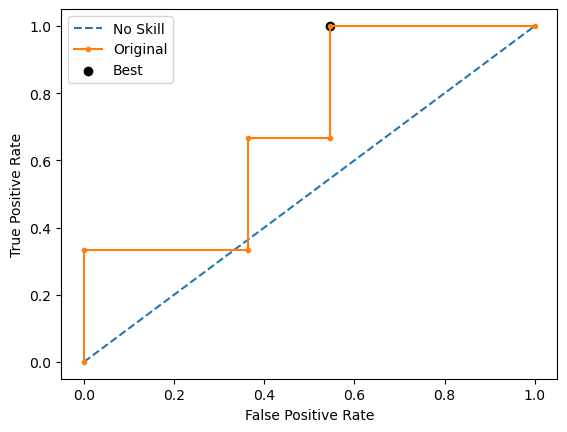

Run 2 - Random State: 1
Test G-mean: 0.6030226891555271
Best Threshold=1.000000, G-Mean=0.778


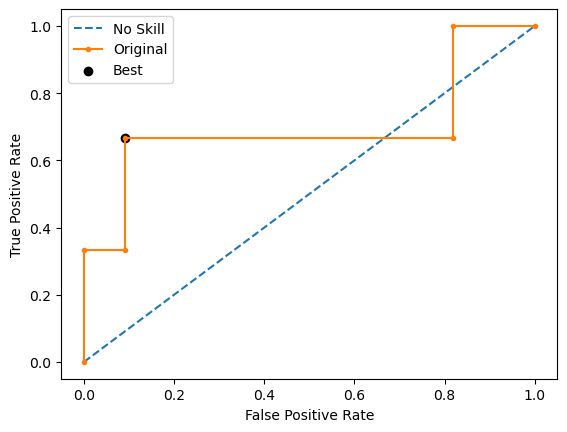

Run 3 - Random State: 2
Test G-mean: 0.4264014327112209
Best Threshold=0.000000, G-Mean=0.674


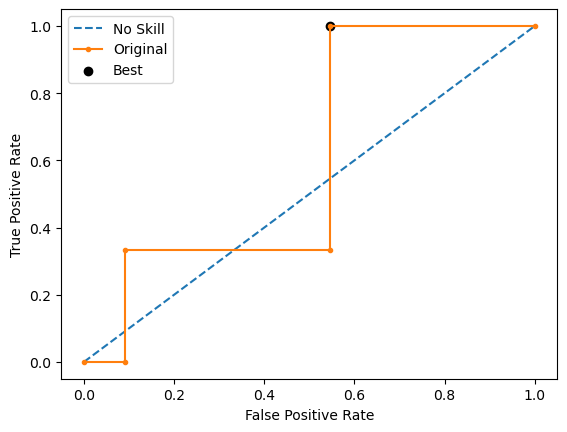

Run 4 - Random State: 3
Test G-mean: 0.34815531191139565
Best Threshold=1.000000, G-Mean=0.348


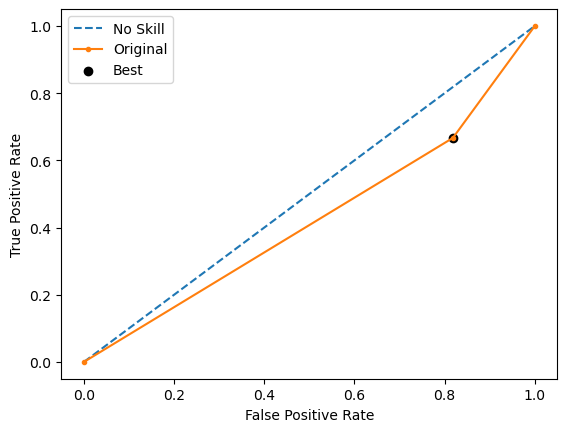

Run 5 - Random State: 4
Test G-mean: 0.4605661864718383
Best Threshold=0.008865, G-Mean=0.798


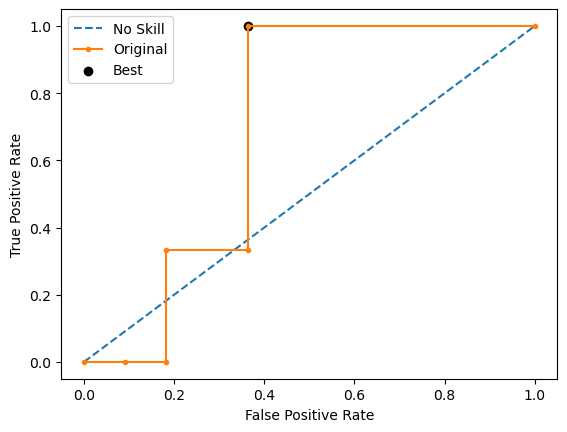

Ave Test G-mean: 0.46610231683346254
Stdev Test G-mean: 0.09348164582488026
Ave Test Specificity: 0.5272727272727272
Ave Test Recall: 0.4666666666666667
Ave Test NPV: 0.7703174603174603
Ave Test Accuracy: 0.5142857142857142
Ave Test Precision: 0.21683982683982683
Ave Test F1-Score: 0.2887301587301587
Ave Runtime: 0.18311104774475098


In [102]:
ho_t03_gbm_gs, ho_t03_gbm_be, ho_t03_gbm_model_info, ho_t03_gbm_metrics_df = gbm_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits


Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.225
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.8546791625557105
Std Train Score (G-mean) 0.03432306533333543
GridSearchCV Runtime: 5.5918169021606445 secs
Run 1 - Random State: 0
Test G-mean: 0.0
Best Threshold=inf, G-Mean=0.000


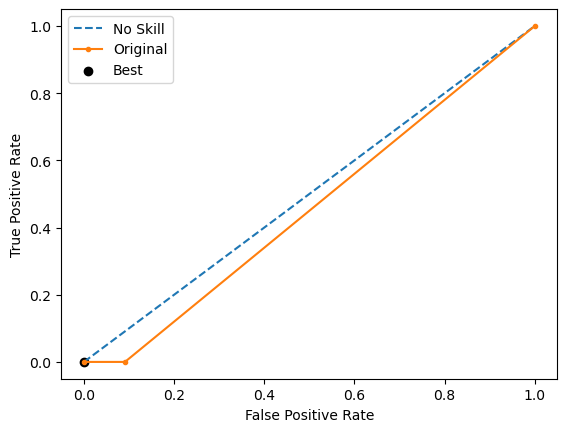

Run 2 - Random State: 1
Test G-mean: 0.6030226891555271
Best Threshold=0.880797, G-Mean=0.603


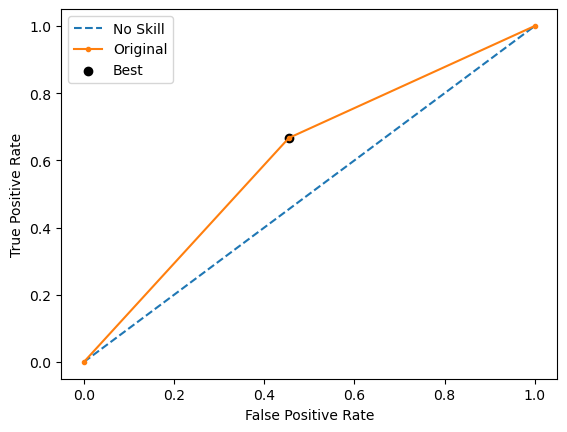

Run 3 - Random State: 2
Test G-mean: 0.0
Best Threshold=inf, G-Mean=0.000


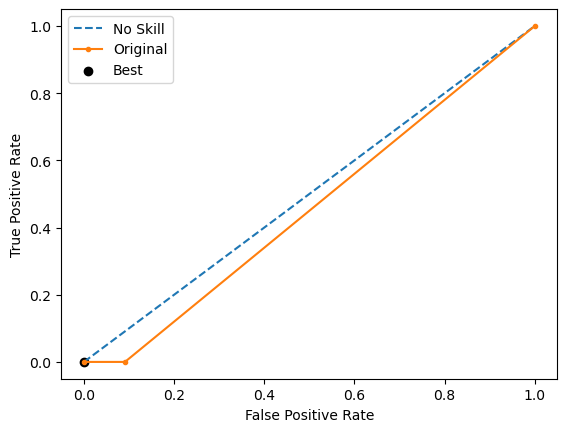

Run 4 - Random State: 3
Test G-mean: 0.6513389472789296
Best Threshold=0.880797, G-Mean=0.651


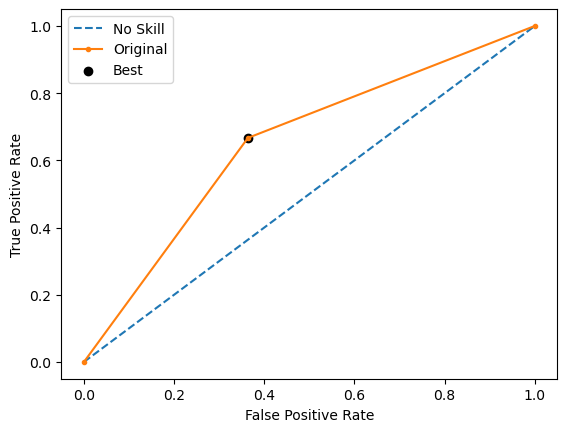

Run 5 - Random State: 4
Test G-mean: 0.4923659639173309
Best Threshold=0.880797, G-Mean=0.492


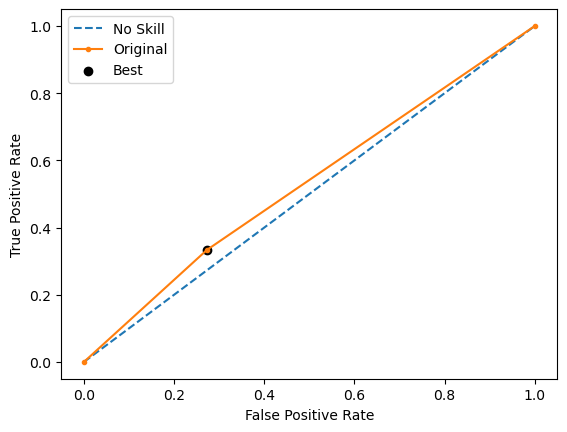

Ave Test G-mean: 0.3493455200703576
Stdev Test G-mean: 0.3240723562481407
Ave Test Specificity: 0.7454545454545455
Ave Test Recall: 0.3333333333333333
Ave Test NPV: 0.8141208791208792
Ave Test Accuracy: 0.6571428571428571
Ave Test Precision: 0.1738095238095238
Ave Test F1-Score: 0.22603174603174603
Ave Runtime: 0.10955100059509278


In [103]:
ho_t03_adaboost_gs, ho_t03_adaboost_be, ho_t03_adaboost_model_info, ho_t03_adaboost_metrics_df = adaboost_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits


Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.3583333333333333
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 RandomForestClassifier(max_depth=2, min_samples_leaf=2,
                                        n_estimators=300, oob_score=True,
                                        random_state=0))])
Mean Train Score (G-mean) 0.8058149967972917
Std Train Score (G-mean) 0.0733202469396461
GridSearchCV Runtime: 177.04920172691345 secs
Run 1 - Random State: 0
Test G-mean: 0.4605661864718383
Best Threshold=0.377928, G-Mean=0.522


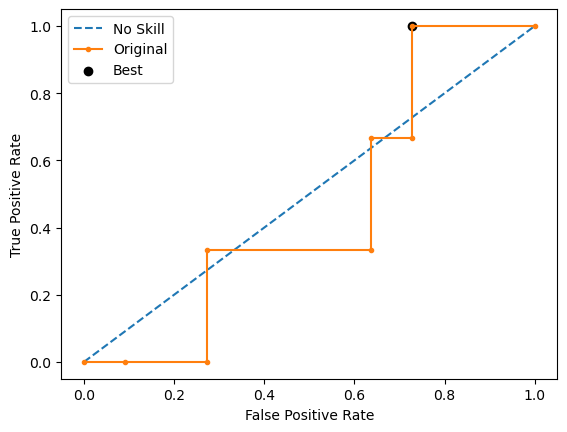

Run 2 - Random State: 1
Test G-mean: 0.6030226891555271
Best Threshold=0.577563, G-Mean=0.739


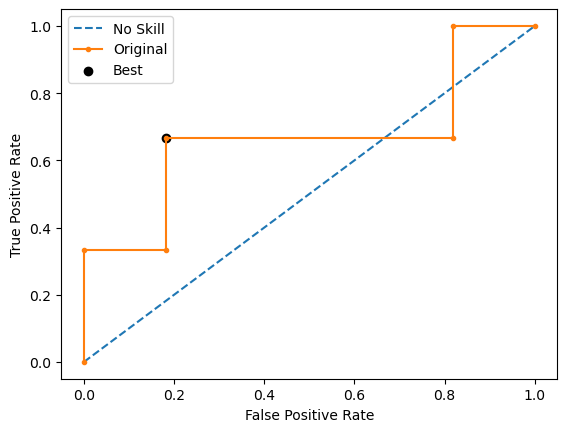

Run 3 - Random State: 2
Test G-mean: 0.7977240352174656
Best Threshold=0.732587, G-Mean=0.816


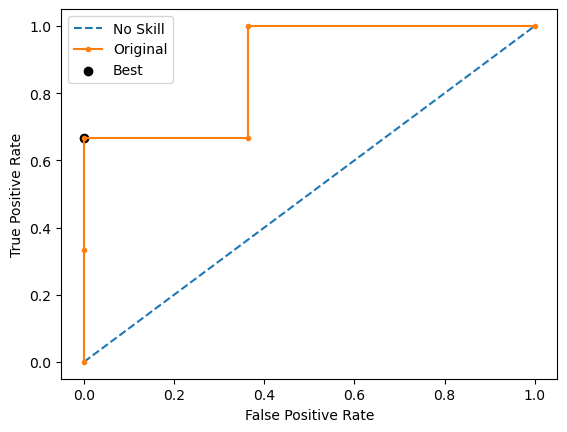

Run 4 - Random State: 3
Test G-mean: 0.6030226891555271
Best Threshold=0.564490, G-Mean=0.696


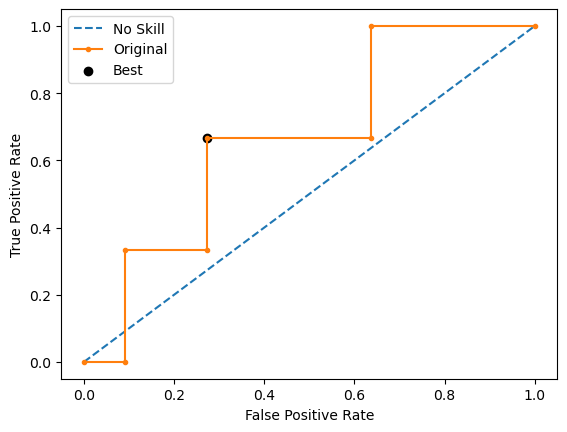

Run 5 - Random State: 4
Test G-mean: 0.4264014327112209
Best Threshold=0.630269, G-Mean=0.696


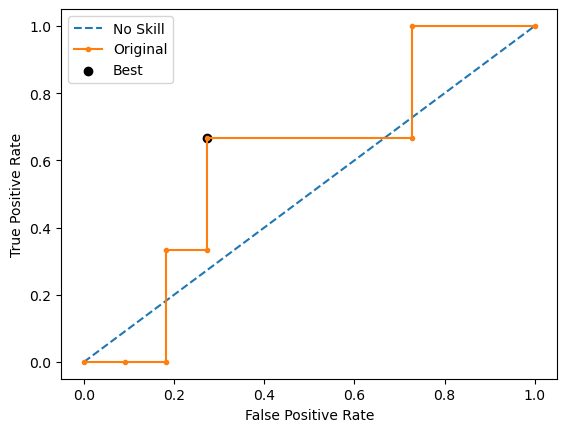

Ave Test G-mean: 0.5781474065423158
Stdev Test G-mean: 0.14688740510823953
Ave Test Specificity: 0.5272727272727271
Ave Test Recall: 0.6666666666666666
Ave Test NPV: 0.8484126984126984
Ave Test Accuracy: 0.5571428571428572
Ave Test Precision: 0.27999999999999997
Ave Test F1-Score: 0.3915384615384615
Ave Runtime: 0.253458833694458


In [104]:
ho_t03_rf_gs, ho_t03_rf_be, ho_t03_rf_model_info, ho_t03_rf_metrics_df = rf_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
Learning rate set to 0.002305
0:	learn: 0.6916715	total: 1.73ms	remaining: 1.73s
1:	learn: 0.6900191	total: 3.57ms	remaining: 1.78s
2:	learn: 0.6886443	total: 5.31ms	remaining: 1.76s
3:	learn: 0.6872971	total: 6.92ms	remaining: 1.72s
4:	learn: 0.6856407	total: 8.57ms	remaining: 1.71s
5:	learn: 0.6844940	total: 10.1ms	remaining: 1.68s
6:	learn: 0.6832165	total: 11.7ms	remaining: 1.67s
7:	learn: 0.6812552	total: 13.3ms	remaining: 1.65s
8:	learn: 0.6798412	total: 14.9ms	remaining: 1.64s
9:	learn: 0.6783400	total: 16.7ms	remaining: 1.65s
10:	learn: 0.6763548	total: 18.5ms	remaining: 1.66s
11:	learn: 0.6748565	total: 20.4ms	remaining: 1.68s
12:	learn: 0.6730659	total: 22.5ms	remaining: 1.71s
13:	learn: 0.6719607	total: 24.6ms	remaining: 1.73s
14:	learn: 0.6694594	total: 26.7ms	remaining: 1.75s
15:	learn: 0.6679210	total: 28.7ms	remaining: 1.76s
16:	learn: 0.6662449	total: 30.3ms	remaining: 1.75s
17:	learn: 0.6649128	total: 32.1ms	

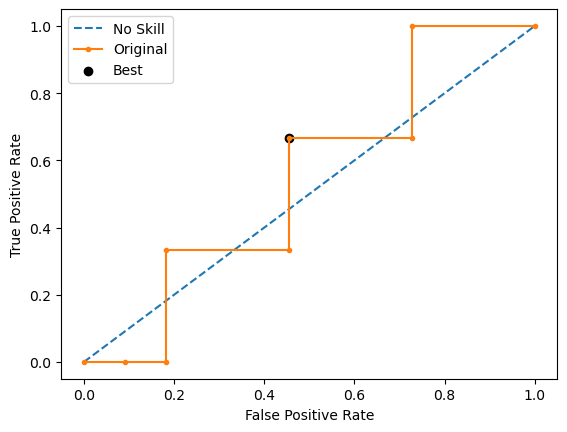

Learning rate set to 0.002204
0:	learn: 0.6917777	total: 1.74ms	remaining: 1.74s
1:	learn: 0.6901206	total: 4.49ms	remaining: 2.24s
2:	learn: 0.6885364	total: 5.81ms	remaining: 1.93s
3:	learn: 0.6869355	total: 8.06ms	remaining: 2.01s
4:	learn: 0.6852751	total: 9.78ms	remaining: 1.95s
5:	learn: 0.6831191	total: 10.8ms	remaining: 1.79s
6:	learn: 0.6814668	total: 12.1ms	remaining: 1.71s
7:	learn: 0.6801750	total: 13.3ms	remaining: 1.65s
8:	learn: 0.6792562	total: 14.3ms	remaining: 1.57s
9:	learn: 0.6780137	total: 15.5ms	remaining: 1.53s
10:	learn: 0.6759500	total: 16.7ms	remaining: 1.5s
11:	learn: 0.6743924	total: 18.4ms	remaining: 1.52s
12:	learn: 0.6732993	total: 20.3ms	remaining: 1.54s
13:	learn: 0.6715537	total: 21.8ms	remaining: 1.53s
14:	learn: 0.6702427	total: 23.2ms	remaining: 1.52s
15:	learn: 0.6688485	total: 24.5ms	remaining: 1.5s
16:	learn: 0.6673415	total: 25.8ms	remaining: 1.49s
17:	learn: 0.6654835	total: 27ms	remaining: 1.47s
18:	learn: 0.6639531	total: 28.5ms	remaining: 1.

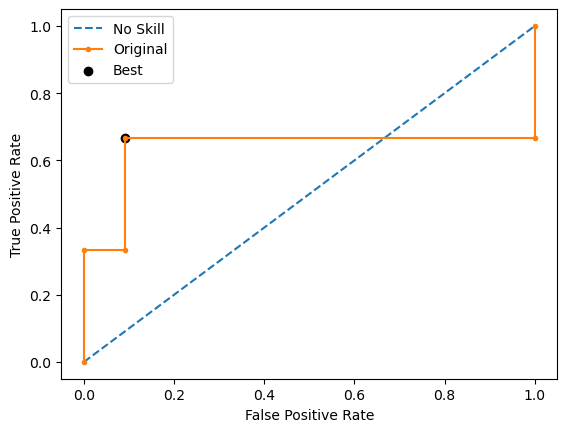

Learning rate set to 0.002168
0:	learn: 0.6917654	total: 1.57ms	remaining: 1.57s
1:	learn: 0.6903474	total: 2.95ms	remaining: 1.47s
2:	learn: 0.6891957	total: 4.49ms	remaining: 1.49s
3:	learn: 0.6870757	total: 5.94ms	remaining: 1.48s
4:	learn: 0.6857293	total: 7.28ms	remaining: 1.45s
5:	learn: 0.6846506	total: 8.89ms	remaining: 1.47s
6:	learn: 0.6831796	total: 10.3ms	remaining: 1.46s
7:	learn: 0.6815227	total: 11.7ms	remaining: 1.45s
8:	learn: 0.6799372	total: 13.4ms	remaining: 1.47s
9:	learn: 0.6784348	total: 15ms	remaining: 1.48s
10:	learn: 0.6766143	total: 16.9ms	remaining: 1.52s
11:	learn: 0.6753789	total: 18.4ms	remaining: 1.51s
12:	learn: 0.6742388	total: 19.7ms	remaining: 1.5s
13:	learn: 0.6730417	total: 20.8ms	remaining: 1.47s
14:	learn: 0.6718177	total: 22ms	remaining: 1.44s
15:	learn: 0.6706486	total: 23.1ms	remaining: 1.42s
16:	learn: 0.6691271	total: 24.2ms	remaining: 1.4s
17:	learn: 0.6677967	total: 25.4ms	remaining: 1.39s
18:	learn: 0.6660851	total: 26.6ms	remaining: 1.38

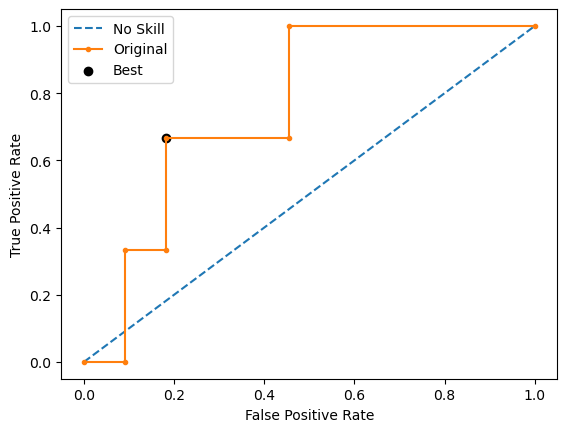

Learning rate set to 0.002095
0:	learn: 0.6916885	total: 1.86ms	remaining: 1.86s
1:	learn: 0.6902321	total: 3.45ms	remaining: 1.72s
2:	learn: 0.6887253	total: 4.91ms	remaining: 1.63s
3:	learn: 0.6880609	total: 7.41ms	remaining: 1.84s
4:	learn: 0.6863680	total: 9.49ms	remaining: 1.89s
5:	learn: 0.6850581	total: 11.1ms	remaining: 1.83s
6:	learn: 0.6828218	total: 12.6ms	remaining: 1.79s
7:	learn: 0.6815543	total: 14.2ms	remaining: 1.76s
8:	learn: 0.6803872	total: 15.4ms	remaining: 1.69s
9:	learn: 0.6790409	total: 16.7ms	remaining: 1.65s
10:	learn: 0.6777012	total: 18ms	remaining: 1.62s
11:	learn: 0.6761279	total: 19.3ms	remaining: 1.59s
12:	learn: 0.6742767	total: 20.7ms	remaining: 1.57s
13:	learn: 0.6728180	total: 22.1ms	remaining: 1.56s
14:	learn: 0.6714805	total: 23.4ms	remaining: 1.54s
15:	learn: 0.6701857	total: 24.7ms	remaining: 1.52s
16:	learn: 0.6692890	total: 26.1ms	remaining: 1.51s
17:	learn: 0.6681976	total: 27.4ms	remaining: 1.5s
18:	learn: 0.6673079	total: 28.7ms	remaining: 1

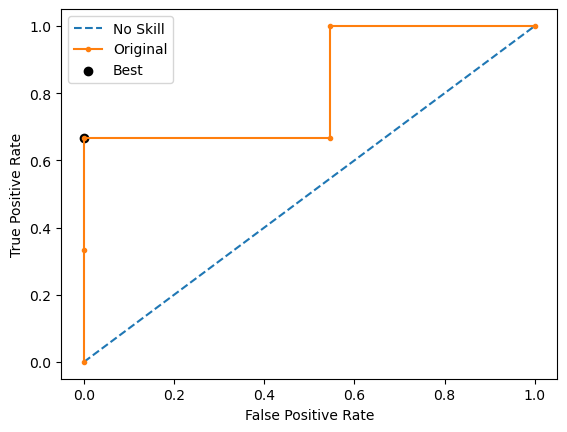

Learning rate set to 0.002305
0:	learn: 0.6918860	total: 1.51ms	remaining: 1.51s
1:	learn: 0.6904485	total: 2.99ms	remaining: 1.49s
2:	learn: 0.6888633	total: 4.64ms	remaining: 1.54s
3:	learn: 0.6877060	total: 6.45ms	remaining: 1.6s
4:	learn: 0.6856986	total: 7.95ms	remaining: 1.58s
5:	learn: 0.6841350	total: 9.19ms	remaining: 1.52s
6:	learn: 0.6821701	total: 10.8ms	remaining: 1.54s
7:	learn: 0.6804357	total: 12.5ms	remaining: 1.55s
8:	learn: 0.6790280	total: 14ms	remaining: 1.54s
9:	learn: 0.6771619	total: 15.5ms	remaining: 1.53s
10:	learn: 0.6751744	total: 17.2ms	remaining: 1.55s
11:	learn: 0.6727984	total: 18.9ms	remaining: 1.56s
12:	learn: 0.6711822	total: 20.6ms	remaining: 1.56s
13:	learn: 0.6692562	total: 21.6ms	remaining: 1.52s
14:	learn: 0.6679197	total: 22.8ms	remaining: 1.5s
15:	learn: 0.6665030	total: 24ms	remaining: 1.48s
16:	learn: 0.6642187	total: 25.3ms	remaining: 1.46s
17:	learn: 0.6630306	total: 26.6ms	remaining: 1.45s
18:	learn: 0.6618472	total: 27.8ms	remaining: 1.43

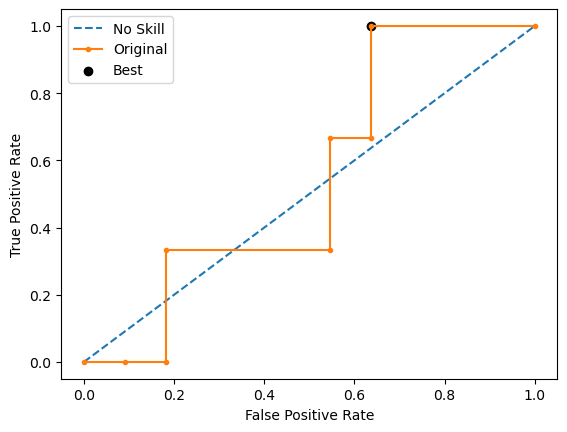

Ave Test G-mean: 0.5909937415005061
Stdev Test G-mean: 0.10187096668697179
Ave Test Specificity: 0.7818181818181819
Ave Test Recall: 0.4666666666666667
Ave Test NPV: 0.8453030303030303
Ave Test Accuracy: 0.7142857142857142
Ave Test Precision: 0.3833333333333333
Ave Test F1-Score: 0.40698412698412706
Ave Runtime: 1.6560128688812257


In [105]:
ho_t03_catboost_gs, ho_t03_catboost_be, ho_t03_catboost_model_info, ho_t03_catboost_metrics_df = catboost_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

In [106]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost', 'catboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost', 'CatBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t03_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t03_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t03_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall', 'Average Test Precision', 'Average Test F1-score',
    'Average Test Accuracy'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall,Average Test Precision,Average Test F1-score,Average Test Accuracy
6,LightGBM,0.668408,0.157710,0.350000,0.428111,0.800000,0.600000,0.607143,0.530476,0.757143
1,SVM Classifier,0.613125,0.085847,0.433333,0.656636,0.600000,0.666667,0.315476,0.417374,0.614286
0,k-Nearest Neighbors,0.607826,0.124326,0.550000,0.514642,0.709091,0.533333,0.336667,0.410317,0.671429
9,CatBoost,0.590994,0.101871,0.283333,0.890266,0.781818,0.466667,0.383333,0.406984,0.714286
2,Logistic Regression,0.580978,0.158275,0.283333,NaN,0.509091,0.733333,0.292857,0.413333,0.557143
4,Random Forest,0.578147,0.146887,0.358333,0.805815,0.527273,0.666667,0.280000,0.391538,0.557143
7,Extreme Gradient Boosting (XGBoost),0.572883,0.080145,0.300000,0.838975,0.745455,0.466667,0.353810,0.383810,0.685714
5,Gradient Boosting Machine (GBM),0.466102,0.093482,0.466667,0.837381,0.527273,0.466667,0.216840,0.288730,0.514286
3,Decision Tree,0.363258,0.350619,0.383333,NaN,0.727273,0.333333,0.200000,0.247619,0.642857
8,AdaBoost,0.349346,0.324072,0.225000,0.854679,0.745455,0.333333,0.173810,0.226032,0.657143


In [107]:
best_scores_models = {
    'Best Score': [],
    'Best Model': []
}

indices = [
    'Highest Test Accuracy',
    'Highest Test G-mean',
    'Highest Test Recall',
    'Highest Test Precision',
    'Highest Test Specificity',
    'Highest Test F1-score'
]

# Corresponding column names in your original dataframe
columns = [
    'Average Test Accuracy',
    'Average Test G-mean',
    'Average Test Recall',
    'Average Test Precision',
    'Average Test Specificity',
    'Average Test F1-score'
]

df = ho_t03_summ
# Finding the best model for each metric
for col in columns:
    best_score = df[col].max()
    best_model = df.loc[df[col] == best_score, 'Classifier model'].values[0]
    
    best_scores_models['Best Score'].append(best_score)
    best_scores_models['Best Model'].append(best_model)

# Creating the new dataframe
best_df = pd.DataFrame(best_scores_models, index=indices)

# Displaying the new dataframe
best_df

,Best Score,Best Model
Highest Test Accuracy,0.757143,LightGBM
Highest Test G-mean,0.668408,LightGBM
Highest Test Recall,0.733333,Logistic Regression
Highest Test Precision,0.607143,LightGBM
Highest Test Specificity,0.800000,LightGBM
Highest Test F1-score,0.530476,LightGBM


# HO-T04 Runs

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits



4320 fits failed out of a total of 17280.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1860 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1145, in wrapper
    estimator._validate_params()
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 638, in _

Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 3, 'classifier__max_features': None, 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.41528138528138525
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(max_depth=3, random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 98.81916642189026 secs
Run 1 - Random State: 0
Test G-mean: 0.5258978055864225
Best Threshold=0.644068, G-Mean=0.526


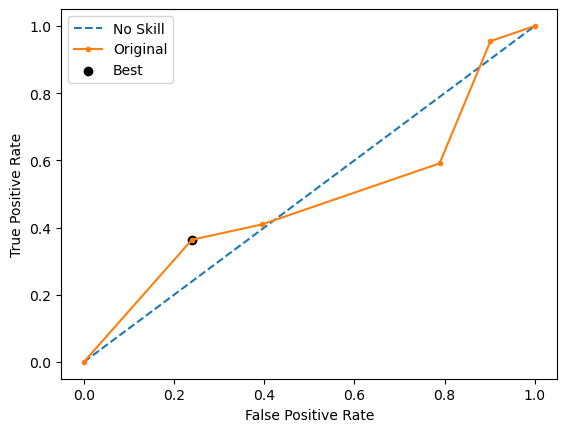

Run 2 - Random State: 1
Test G-mean: 0.38372792324524024
Best Threshold=0.410256, G-Mean=0.564


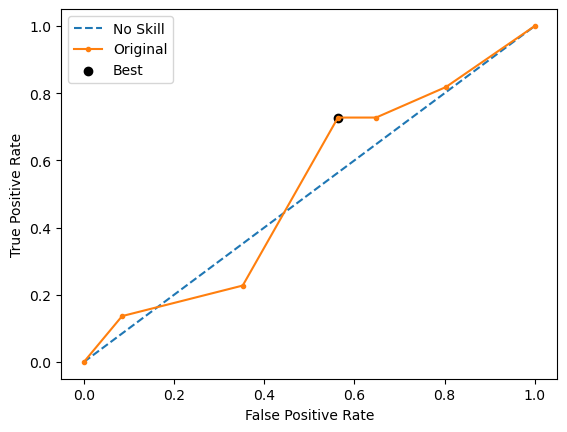

Run 3 - Random State: 2
Test G-mean: 0.6450838415369244
Best Threshold=0.622093, G-Mean=0.645


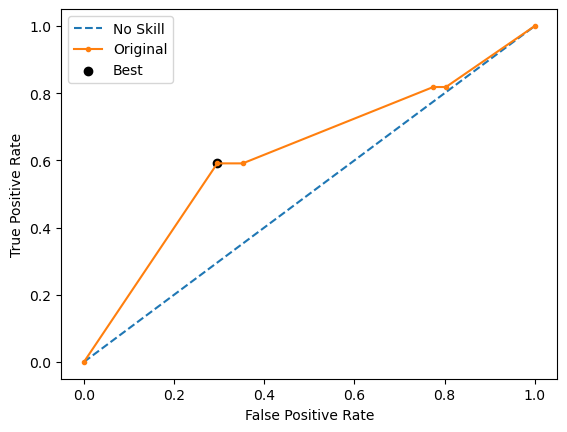

Run 4 - Random State: 3
Test G-mean: 0.4338435552981646
Best Threshold=0.096774, G-Mean=0.481


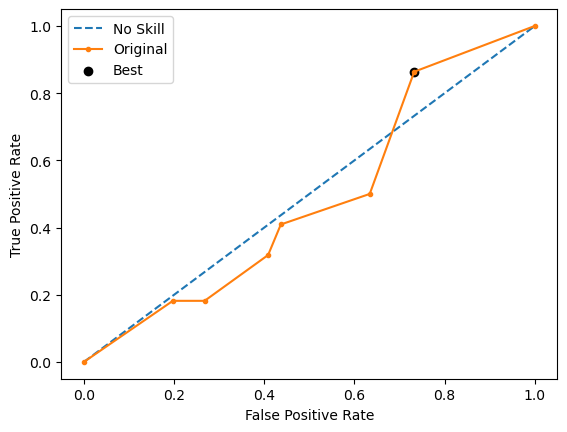

Run 5 - Random State: 4
Test G-mean: 0.4271514797864322
Best Threshold=0.395349, G-Mean=0.628


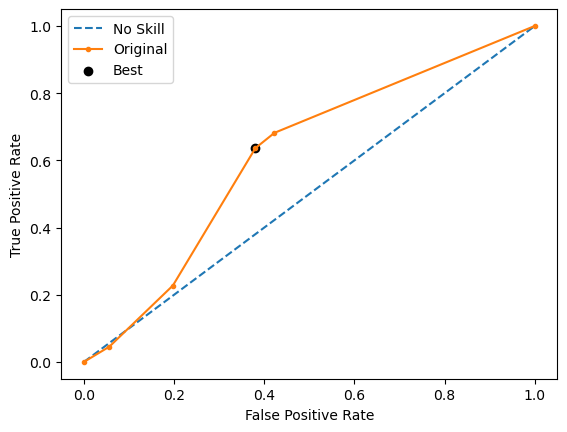

Ave Test G-mean: 0.4831409210906368
Stdev Test G-mean: 0.10428524896491978
Ave Test Specificity: 0.7014084507042254
Ave Test Recall: 0.34545454545454546
Ave Test NPV: 0.7757692759739252
Ave Test Accuracy: 0.6172043010752687
Ave Test Precision: 0.2653243894048848
Ave Test F1-Score: 0.2964601375755036
Ave Runtime: 0.03238711357116699


In [56]:
ho_t04_dt_gs, ho_t04_dt_be, ho_t04_dt_model_info, ho_t04_dt_metrics_df = dt_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\linear_mod

Best Hyperparameters: {'classifier__C': 0.001, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs', 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.3561111111111111
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 LogisticRegression(C=0.001, max_iter=1000, random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 48.05472493171692 secs
Run 1 - Random State: 0
Test G-mean: 0.4554408594323317
Best Threshold=0.290751, G-Mean=0.524


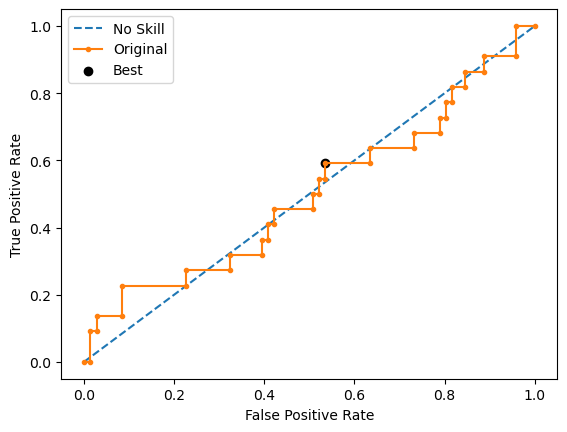

Run 2 - Random State: 1
Test G-mean: 0.27485300459649964
Best Threshold=0.307346, G-Mean=0.557


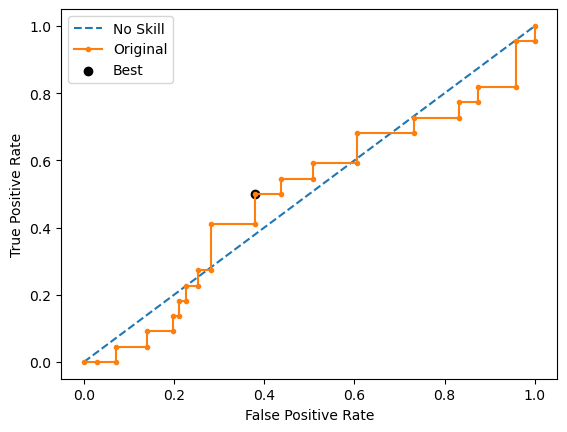

Run 3 - Random State: 2
Test G-mean: 0.5185422292677143
Best Threshold=0.368573, G-Mean=0.635


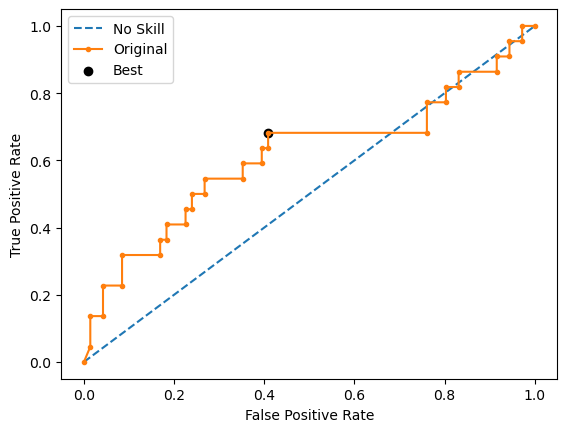

Run 4 - Random State: 3
Test G-mean: 0.38539269428625517
Best Threshold=0.321742, G-Mean=0.555


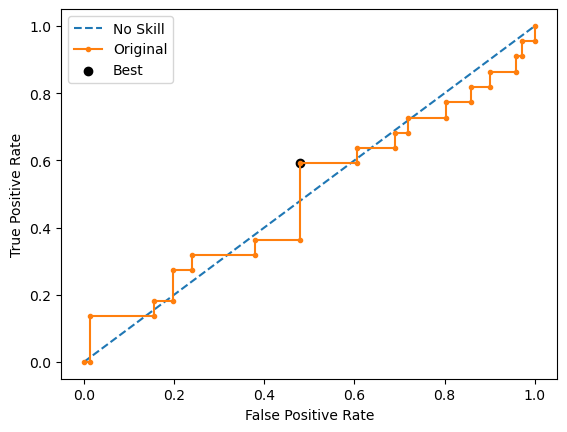

Run 5 - Random State: 4
Test G-mean: 0.4526207650762756
Best Threshold=0.424023, G-Mean=0.559


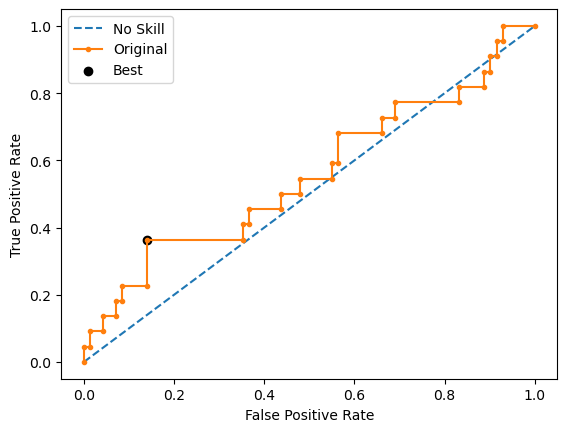

Ave Test G-mean: 0.41736991053181527
Stdev Test G-mean: 0.09254926905558154
Ave Test Specificity: 0.8309859154929576
Ave Test Recall: 0.2181818181818182
Ave Test NPV: 0.7743090731987023
Ave Test Accuracy: 0.686021505376344
Ave Test Precision: 0.28891527625542973
Ave Test F1-Score: 0.24540472599296131
Ave Runtime: 0.11865224838256835


In [57]:
ho_t04_logreg_gs, ho_t04_logreg_be, ho_t04_logreg_model_info, ho_t04_logreg_metrics_df = logreg_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]Best Hyperparameters: {'classifier__C': 1.0, 'classifier__kernel': 'rbf', 'classifier__probability': True, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.4666666666666666
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 SVC(max_iter=1000, probability=True, random_state=0,
                     verbose=True))])
Mean Train Score (G-mean) 0.3409580721216999
Std Train Score (G-mean) 0.07605265160664389
GridSearchCV Runtime: 40.20758533477783 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.41729572659146424
Best Threshold=0.436382, G-Mean=0.488


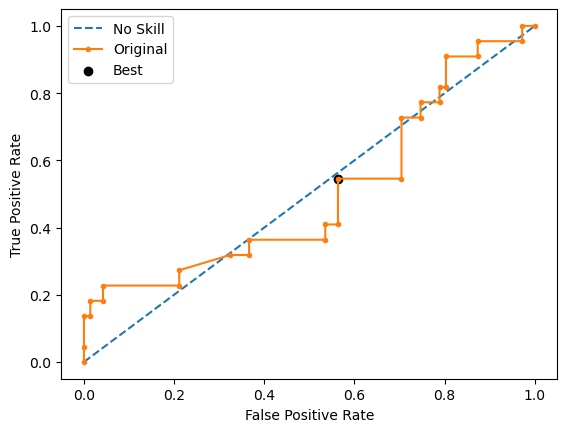

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.4016610836518252
Best Threshold=0.427020, G-Mean=0.544


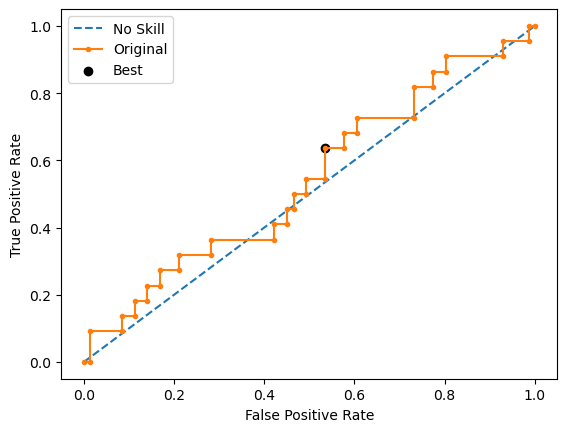

[LibSVM]Run 3 - Random State: 2
Test G-mean: 0.41421601124204527
Best Threshold=0.480646, G-Mean=0.668


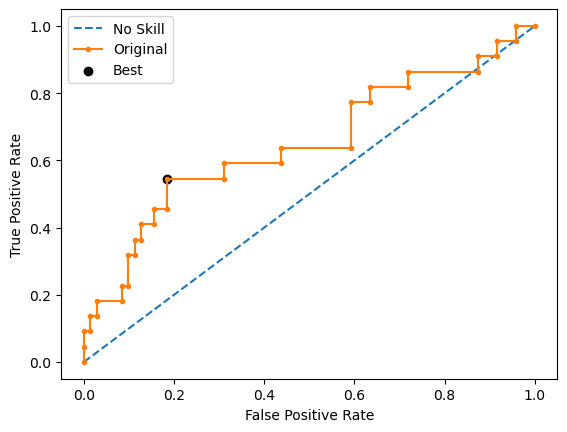

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.29507263803299183
Best Threshold=0.423143, G-Mean=0.540


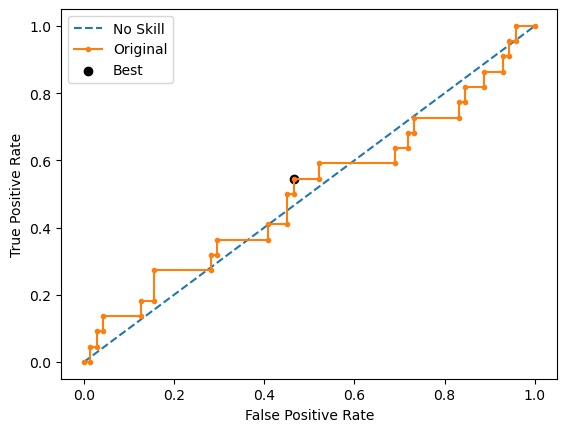

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.2993804956539035
Best Threshold=0.436421, G-Mean=0.549


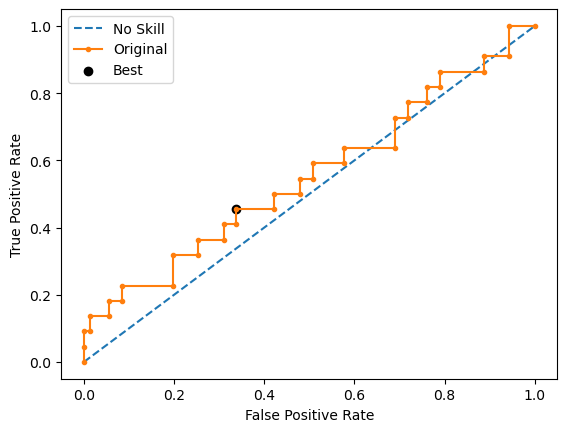

Ave Test G-mean: 0.365525191034446
Stdev Test G-mean: 0.06264078146665213
Ave Test Specificity: 0.9464788732394366
Ave Test Recall: 0.14545454545454545
Ave Test NPV: 0.781443159363816
Ave Test Accuracy: 0.756989247311828
Ave Test Precision: 0.4942857142857142
Ave Test F1-Score: 0.21719420028547817
Ave Runtime: 0.09304285049438477


In [58]:
ho_t04_svm_gs, ho_t04_svm_be, ho_t04_svm_model_info, ho_t04_svm_metrics_df = svm_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

In [59]:
ho_t04_knn_gs, ho_t04_knn_be, ho_t04_knn_model_info, ho_t04_knn_metrics_df = knn_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits


Best Hyperparameters: {'classifier__metric': 'canberra', 'classifier__n_neighbors': 9, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.4499999999999999
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='canberra', n_neighbors=9))])
Mean Train Score (G-mean) 0.5056907366342465
Std Train Score (G-mean) 0.03456371765893802
GridSearchCV Runtime: 43.01485538482666 secs
Run 1 - Random State: 0
Test G-mean: 0.3587215883898718
Run 2 - Random State: 1
Test G-mean: 0.29070094986690553
Run 3 - Random State: 2
Test G-mean: 0.2928949504252934
Run 4 - Random State: 3
Test G-mean: 0.20710800562102266
Run 5 - Random State: 4
Test G-mean: 0.29070094986690553
Ave Test G-mean: 0.28802528883399975
Stdev Test G-mean: 0.053813579655609414
Ave Test Specificity: 0.9380281690140844
Ave Test Recall: 0.09090909090909091
Ave Test NPV: 0.7690864134528

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.01, 'classifier__max_depth': None, 'classifier__max_leaves': 10, 'classifier__n_estimators': 200, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.2980050505050505
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importance_type=None,
   

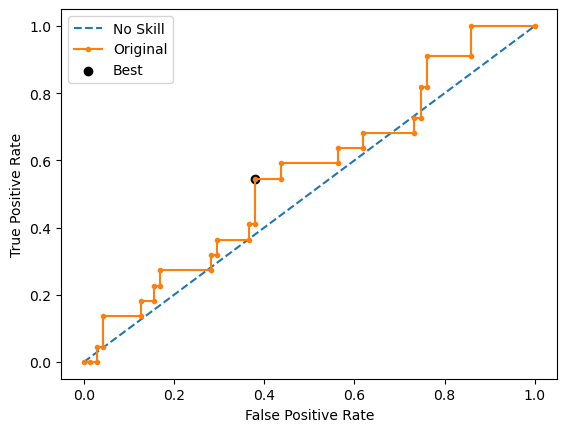

Run 2 - Random State: 1
Test G-mean: 0.48735613787213033
Best Threshold=0.443322, G-Mean=0.554


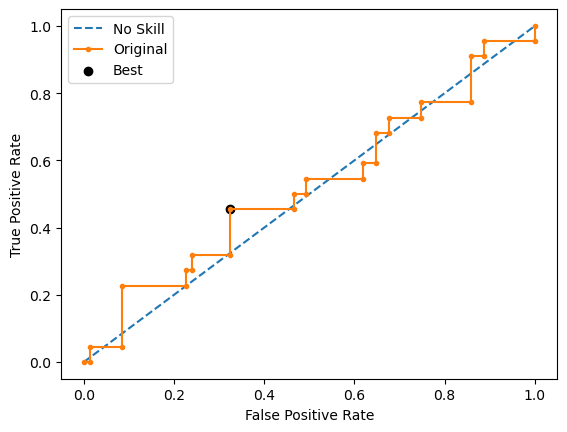

Run 3 - Random State: 2
Test G-mean: 0.6166698388447784
Best Threshold=0.501476, G-Mean=0.617


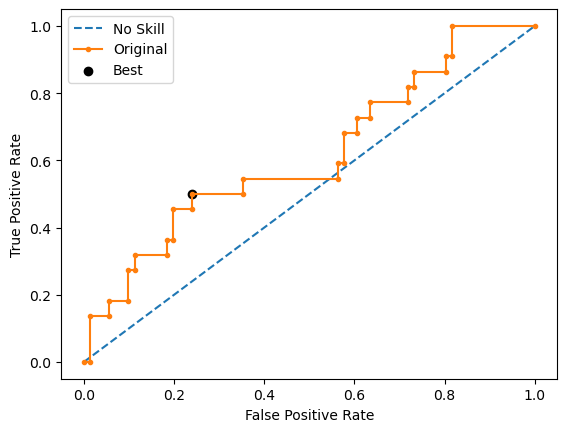

Run 4 - Random State: 3
Test G-mean: 0.5313476693377204
Best Threshold=0.314427, G-Mean=0.581


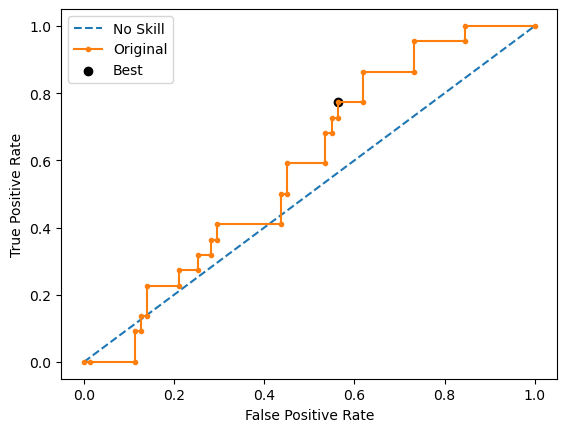

Run 5 - Random State: 4
Test G-mean: 0.5142028874627523
Best Threshold=0.390512, G-Mean=0.621


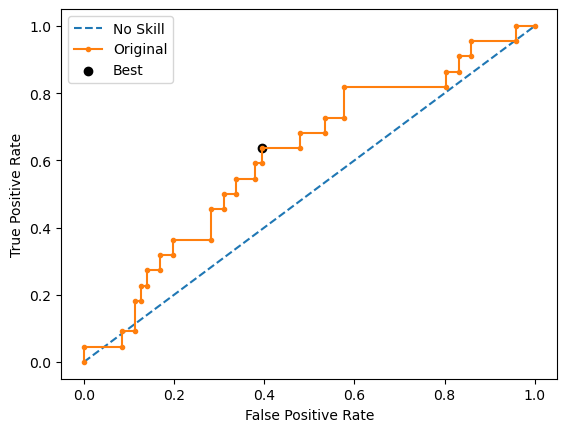

Ave Test G-mean: 0.5360642851903312
Stdev Test G-mean: 0.04847216214000878
Ave Test Specificity: 0.7295774647887324
Ave Test Recall: 0.4
Ave Test NPV: 0.7967030318263715
Ave Test Accuracy: 0.6516129032258065
Ave Test Precision: 0.3203742092808307
Ave Test F1-Score: 0.35158828948331394
Ave Runtime: 0.101585054397583


In [60]:
ho_t04_xgb_gs, ho_t04_xgb_be, ho_t04_xgb_model_info, ho_t04_xgb_metrics_df = xgb_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits


[LightGBM] [Info] Number of positive: 212, number of negative: 212
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001186 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1965
[LightGBM] [Info] Number of data points in the train set: 424, number of used features: 48
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

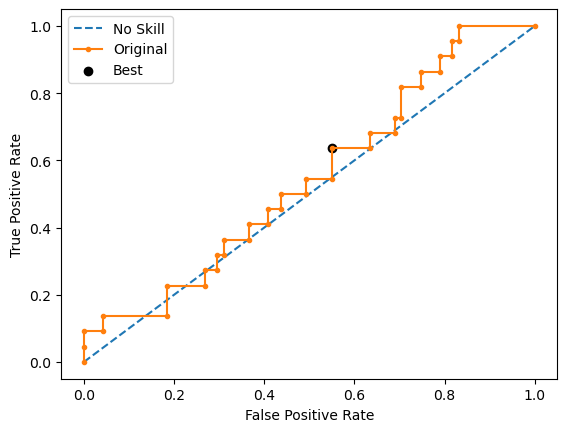

[LightGBM] [Info] Number of positive: 212, number of negative: 212
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000466 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1975
[LightGBM] [Info] Number of data points in the train set: 424, number of used features: 48
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

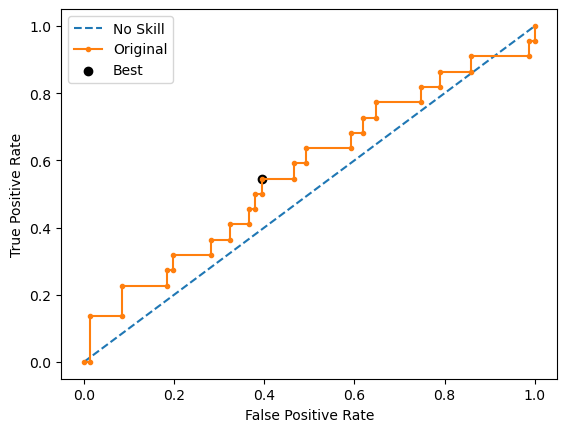

[LightGBM] [Info] Number of positive: 212, number of negative: 212
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000694 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1933
[LightGBM] [Info] Number of data points in the train set: 424, number of used features: 47
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

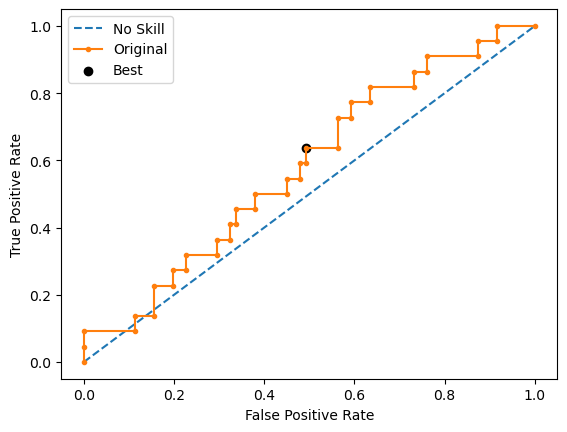

[LightGBM] [Info] Number of positive: 212, number of negative: 212
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000554 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1980
[LightGBM] [Info] Number of data points in the train set: 424, number of used features: 49
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

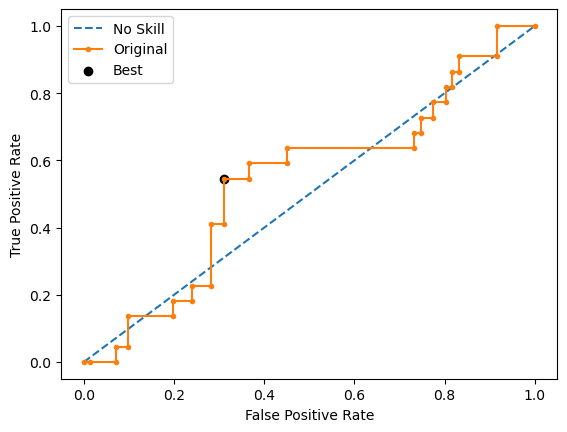

[LightGBM] [Info] Number of positive: 212, number of negative: 212
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000737 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1948
[LightGBM] [Info] Number of data points in the train set: 424, number of used features: 48
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

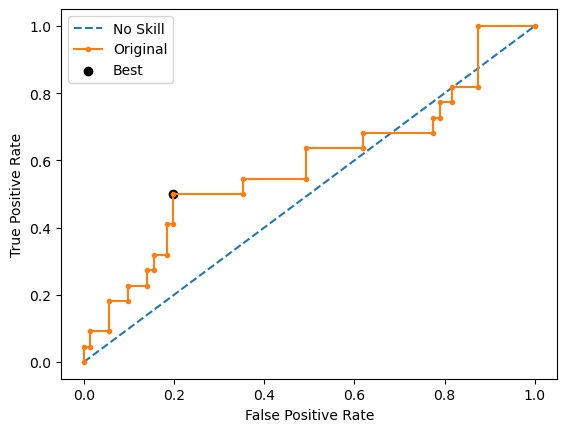

Ave Test G-mean: 0.34872567230086765
Stdev Test G-mean: 0.044241123565503075
Ave Test Specificity: 0.9014084507042253
Ave Test Recall: 0.13636363636363638
Ave Test NPV: 0.7710306706241665
Ave Test Accuracy: 0.7204301075268817
Ave Test Precision: 0.30454545454545456
Ave Test F1-Score: 0.18778678626875972
Ave Runtime: 0.06746253967285157


In [61]:
ho_t04_lgbm_gs, ho_t04_lgbm_be, ho_t04_lgbm_model_info, ho_t04_lgbm_metrics_df = lgbm_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits
Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.36666666666666664
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.8203921847763471
Std Train Score (G-mean) 0.012072122152804642
GridSearchCV Runtime: 8.317373275756836 secs
Run 1 - Random State: 0
Test G-mean: 0.29507263803299183
Best Threshold=0.880797, G-Mean=0.295


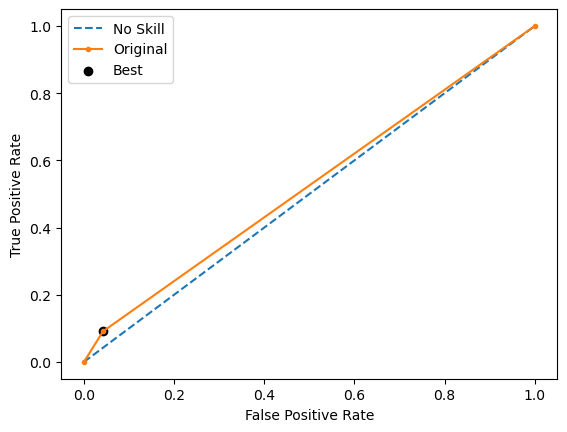

Run 2 - Random State: 1
Test G-mean: 0.42338795726372985
Best Threshold=0.880797, G-Mean=0.423


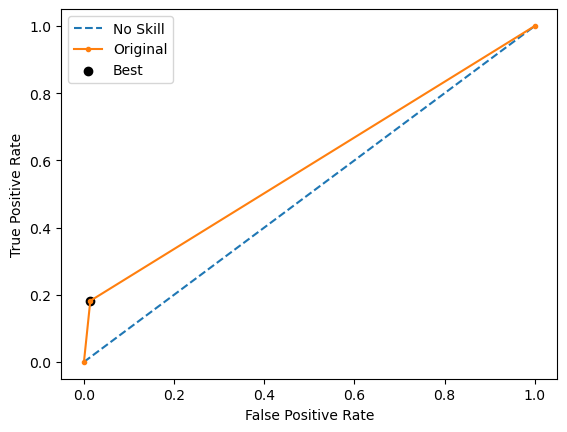

Run 3 - Random State: 2
Test G-mean: 0.29507263803299183
Best Threshold=0.880797, G-Mean=0.295


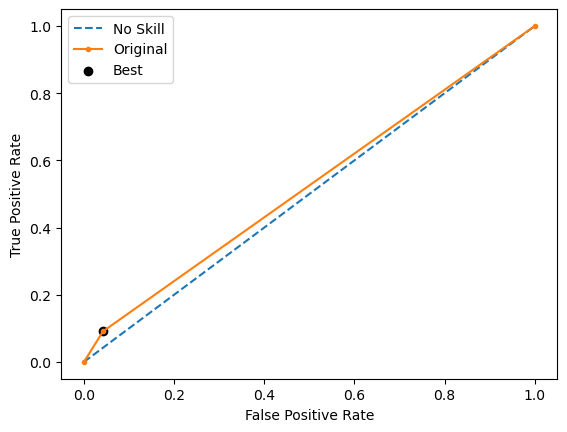

Run 4 - Random State: 3
Test G-mean: 0.29507263803299183
Best Threshold=0.880797, G-Mean=0.295


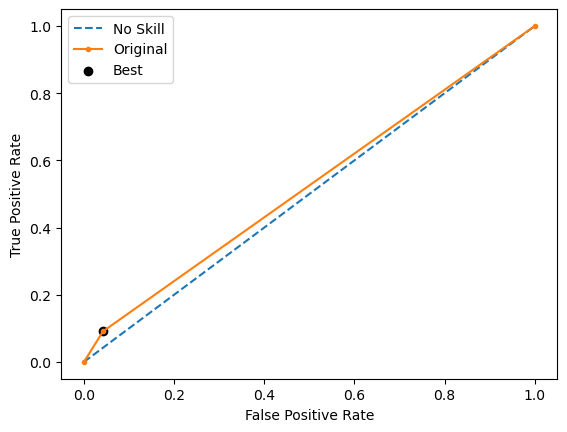

Run 5 - Random State: 4
Test G-mean: 0.29507263803299183
Best Threshold=0.880797, G-Mean=0.295


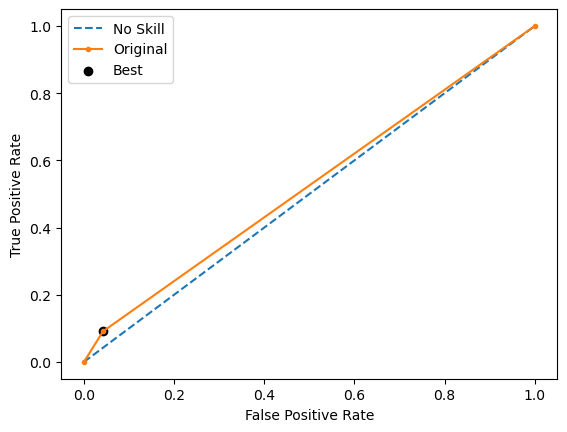

Ave Test G-mean: 0.3207357018791394
Stdev Test G-mean: 0.05738435527090324
Ave Test Specificity: 0.9633802816901408
Ave Test Recall: 0.1090909090909091
Ave Test NPV: 0.7772727272727271
Ave Test Accuracy: 0.7612903225806452
Ave Test Precision: 0.48
Ave Test F1-Score: 0.17777777777777776
Ave Runtime: 0.2756016731262207


In [62]:
ho_t04_adaboost_gs, ho_t04_adaboost_be, ho_t04_adaboost_model_info, ho_t04_adaboost_metrics_df = adaboost_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits


Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 200, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.3080158730158731
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 GradientBoostingClassifier(min_samples_leaf=3,
                                            n_estimators=200,
                                            random_state=0))])
Mean Train Score (G-mean) 0.808784129530471
Std Train Score (G-mean) 0.01267672606719326
GridSearchCV Runtime: 49.05640649795532 secs
Run 1 - Random State: 0
Test G-mean: 0.468604597593796
Best Threshold=0.141576, G-Mean=0.519


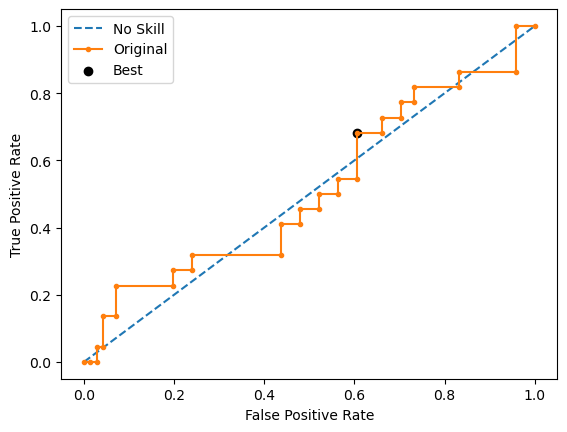

Run 2 - Random State: 1
Test G-mean: 0.557798856811926
Best Threshold=0.596420, G-Mean=0.573


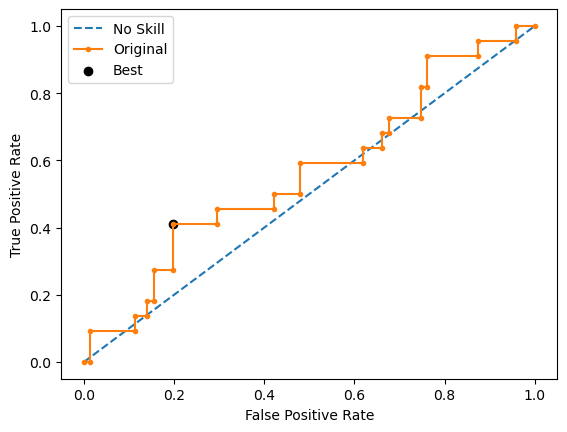

Run 3 - Random State: 2
Test G-mean: 0.5879716212546047
Best Threshold=0.550505, G-Mean=0.607


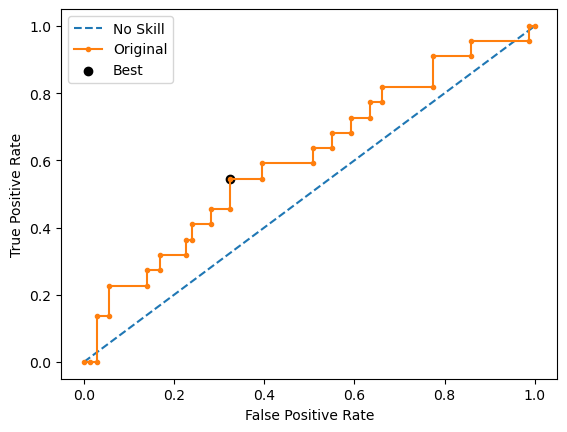

Run 4 - Random State: 3
Test G-mean: 0.4389779772752278
Best Threshold=0.390206, G-Mean=0.531


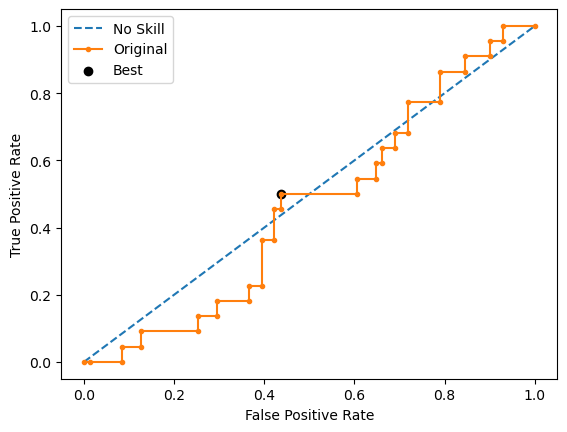

Run 5 - Random State: 4
Test G-mean: 0.44692719547346543
Best Threshold=0.155284, G-Mean=0.571


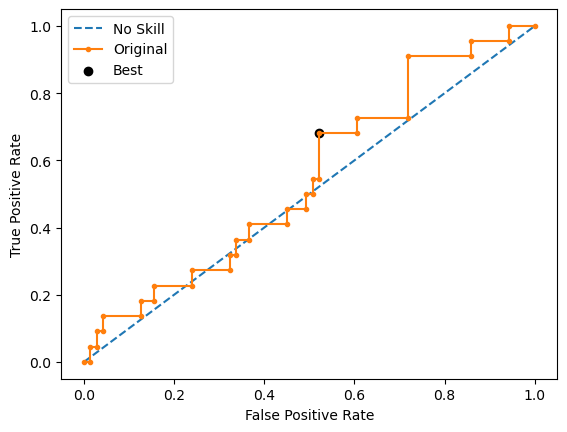

Ave Test G-mean: 0.5000560496818041
Stdev Test G-mean: 0.06820150184760748
Ave Test Specificity: 0.6845070422535211
Ave Test Recall: 0.3727272727272727
Ave Test NPV: 0.7791724320266636
Ave Test Accuracy: 0.610752688172043
Ave Test Precision: 0.26866452603657687
Ave Test F1-Score: 0.31008859758909163
Ave Runtime: 0.30923662185668943


In [63]:
ho_t04_gbm_gs, ho_t04_gbm_be, ho_t04_gbm_model_info, ho_t04_gbm_metrics_df = gbm_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits
Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.37857142857142856
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 RandomForestClassifier(max_depth=3, min_samples_leaf=3,
                                        n_estimators=300, oob_score=True,
                                        random_state=0))])
Mean Train Score (G-mean) 0.5788496983114855
Std Train Score (G-mean) 0.04337308795195086
GridSearchCV Runtime: 187.81563520431519 secs
Run 1 - Random State: 0
Test G-mean: 0.37868970131859025
Best Threshold=0.375318, G-Mean=0.590


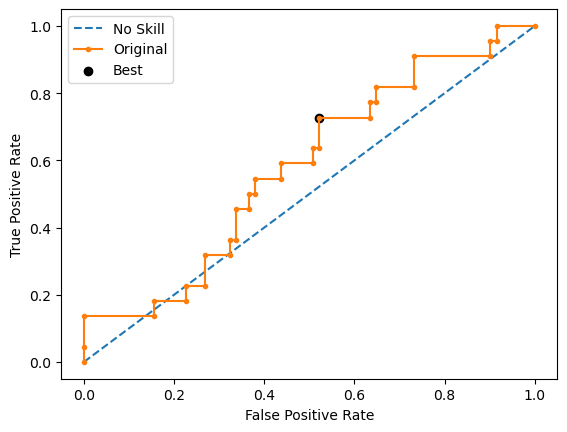

Run 2 - Random State: 1
Test G-mean: 0.2972343712407147
Best Threshold=0.354832, G-Mean=0.612


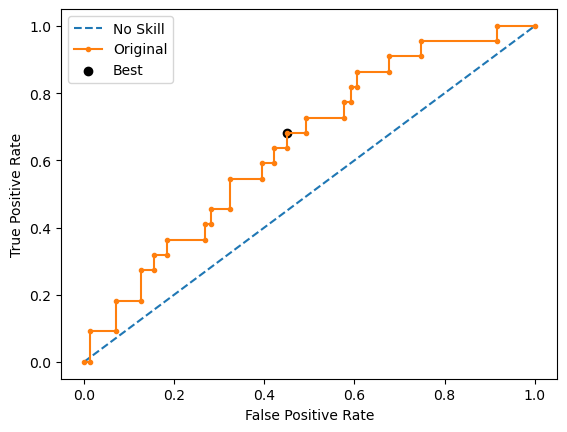

Run 3 - Random State: 2
Test G-mean: 0.5313476693377204
Best Threshold=0.433624, G-Mean=0.652


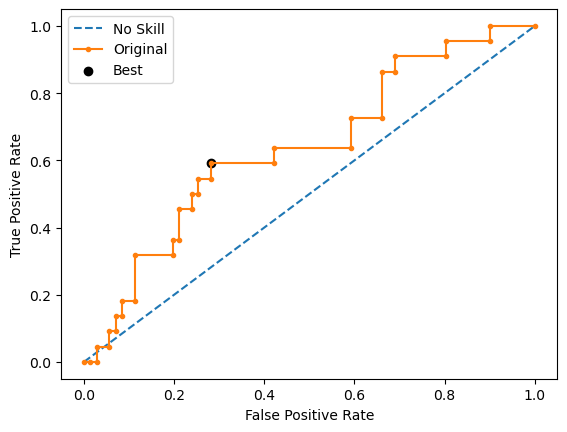

Run 4 - Random State: 3
Test G-mean: 0.2884902641726531
Best Threshold=0.353739, G-Mean=0.594


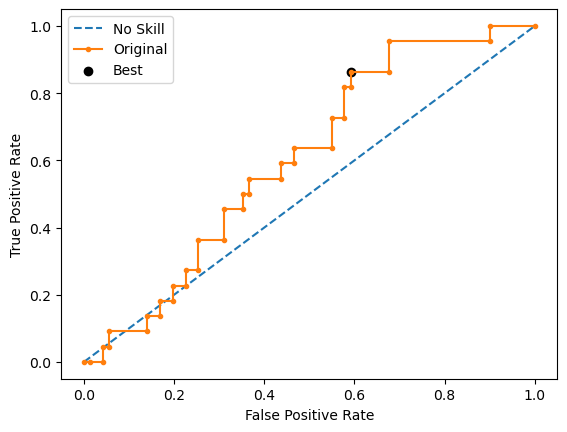

Run 5 - Random State: 4
Test G-mean: 0.20864786329573212
Best Threshold=0.329651, G-Mean=0.624


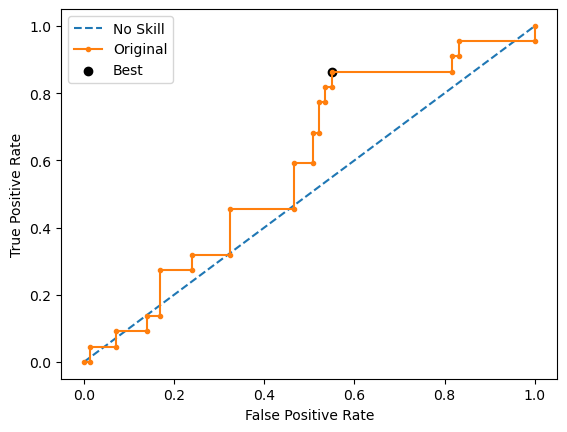

Ave Test G-mean: 0.3408819738730821
Stdev Test G-mean: 0.12231360294800825
Ave Test Specificity: 0.904225352112676
Ave Test Recall: 0.14545454545454545
Ave Test NPV: 0.773696157899727
Ave Test Accuracy: 0.724731182795699
Ave Test Precision: 0.33543859649122804
Ave Test F1-Score: 0.18752057874009093
Ave Runtime: 0.3448050022125244


In [64]:
ho_t04_rf_gs, ho_t04_rf_be, ho_t04_rf_model_info, ho_t04_rf_metrics_df = rf_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
Learning rate set to 0.007142
0:	learn: 0.6904935	total: 1.92ms	remaining: 1.92s
1:	learn: 0.6877739	total: 3.4ms	remaining: 1.7s
2:	learn: 0.6851891	total: 5.39ms	remaining: 1.79s
3:	learn: 0.6818814	total: 7.41ms	remaining: 1.84s
4:	learn: 0.6787307	total: 9.38ms	remaining: 1.87s
5:	learn: 0.6754213	total: 11.4ms	remaining: 1.88s
6:	learn: 0.6723475	total: 13.5ms	remaining: 1.91s
7:	learn: 0.6698775	total: 15.6ms	remaining: 1.93s
8:	learn: 0.6671969	total: 17.8ms	remaining: 1.96s
9:	learn: 0.6639214	total: 19.6ms	remaining: 1.94s
10:	learn: 0.6612110	total: 21.3ms	remaining: 1.91s
11:	learn: 0.6584435	total: 23.1ms	remaining: 1.9s
12:	learn: 0.6553699	total: 25.2ms	remaining: 1.91s
13:	learn: 0.6525131	total: 27.2ms	remaining: 1.92s
14:	learn: 0.6497939	total: 29.2ms	remaining: 1.91s
15:	learn: 0.6471533	total: 31.2ms	remaining: 1.92s
16:	learn: 0.6439684	total: 33.2ms	remaining: 1.92s
17:	learn: 0.6416324	total: 35.3ms	rem

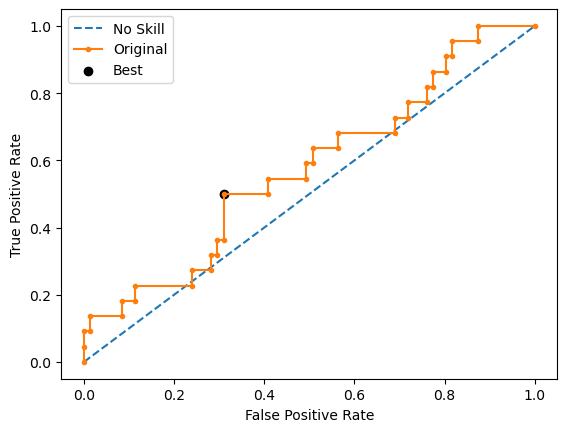

Learning rate set to 0.007142
0:	learn: 0.6904204	total: 4.59ms	remaining: 4.58s
1:	learn: 0.6871026	total: 9.02ms	remaining: 4.5s
2:	learn: 0.6841364	total: 14.7ms	remaining: 4.88s
3:	learn: 0.6814748	total: 17.2ms	remaining: 4.29s
4:	learn: 0.6781179	total: 19.6ms	remaining: 3.9s
5:	learn: 0.6740678	total: 22.4ms	remaining: 3.71s
6:	learn: 0.6706673	total: 25.2ms	remaining: 3.58s
7:	learn: 0.6683693	total: 27.3ms	remaining: 3.38s
8:	learn: 0.6661806	total: 29.7ms	remaining: 3.27s
9:	learn: 0.6622977	total: 32.9ms	remaining: 3.25s
10:	learn: 0.6593530	total: 35.4ms	remaining: 3.18s
11:	learn: 0.6567589	total: 37.5ms	remaining: 3.08s
12:	learn: 0.6535699	total: 40.2ms	remaining: 3.05s
13:	learn: 0.6503924	total: 42.4ms	remaining: 2.99s
14:	learn: 0.6476636	total: 45.1ms	remaining: 2.96s
15:	learn: 0.6443562	total: 48.2ms	remaining: 2.96s
16:	learn: 0.6419453	total: 49.8ms	remaining: 2.88s
17:	learn: 0.6382538	total: 51.4ms	remaining: 2.8s
18:	learn: 0.6352047	total: 53.8ms	remaining: 2

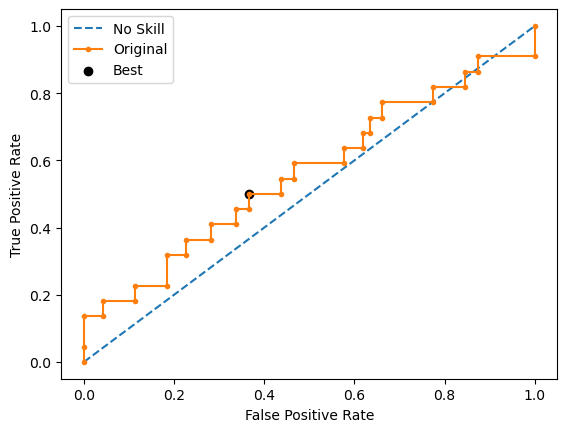

Learning rate set to 0.007142
0:	learn: 0.6892684	total: 3.97ms	remaining: 3.97s
1:	learn: 0.6859229	total: 7.95ms	remaining: 3.97s
2:	learn: 0.6829622	total: 12.3ms	remaining: 4.08s
3:	learn: 0.6795948	total: 14.5ms	remaining: 3.62s
4:	learn: 0.6758252	total: 17.4ms	remaining: 3.47s
5:	learn: 0.6731323	total: 20.6ms	remaining: 3.41s
6:	learn: 0.6708807	total: 23.1ms	remaining: 3.28s
7:	learn: 0.6680583	total: 26.4ms	remaining: 3.27s
8:	learn: 0.6650448	total: 29.3ms	remaining: 3.23s
9:	learn: 0.6623727	total: 31.8ms	remaining: 3.15s
10:	learn: 0.6585540	total: 34.8ms	remaining: 3.13s
11:	learn: 0.6547762	total: 36.6ms	remaining: 3.01s
12:	learn: 0.6520140	total: 39.5ms	remaining: 3s
13:	learn: 0.6488564	total: 42.8ms	remaining: 3.01s
14:	learn: 0.6463956	total: 44.5ms	remaining: 2.92s
15:	learn: 0.6443538	total: 46.4ms	remaining: 2.85s
16:	learn: 0.6421394	total: 49.1ms	remaining: 2.84s
17:	learn: 0.6393021	total: 51.6ms	remaining: 2.81s
18:	learn: 0.6372409	total: 53.6ms	remaining: 2

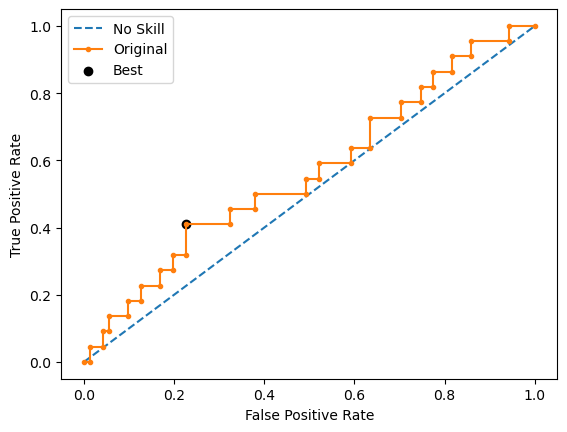

Learning rate set to 0.007142
0:	learn: 0.6900950	total: 5.2ms	remaining: 5.19s
1:	learn: 0.6857906	total: 9.73ms	remaining: 4.86s
2:	learn: 0.6827529	total: 15.4ms	remaining: 5.13s
3:	learn: 0.6793096	total: 19.5ms	remaining: 4.87s
4:	learn: 0.6754185	total: 23.8ms	remaining: 4.73s
5:	learn: 0.6721121	total: 27.1ms	remaining: 4.49s
6:	learn: 0.6690318	total: 30ms	remaining: 4.26s
7:	learn: 0.6657074	total: 31.8ms	remaining: 3.94s
8:	learn: 0.6626942	total: 34.5ms	remaining: 3.79s
9:	learn: 0.6589854	total: 37.3ms	remaining: 3.7s
10:	learn: 0.6557092	total: 41.1ms	remaining: 3.69s
11:	learn: 0.6529809	total: 43.9ms	remaining: 3.61s
12:	learn: 0.6496463	total: 46.7ms	remaining: 3.54s
13:	learn: 0.6460184	total: 49.2ms	remaining: 3.46s
14:	learn: 0.6431224	total: 51.6ms	remaining: 3.39s
15:	learn: 0.6405998	total: 53.8ms	remaining: 3.31s
16:	learn: 0.6369879	total: 57.2ms	remaining: 3.31s
17:	learn: 0.6336165	total: 59.8ms	remaining: 3.26s
18:	learn: 0.6305562	total: 62.7ms	remaining: 3.

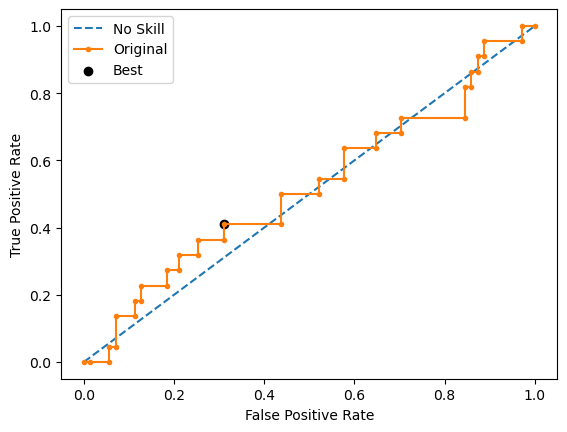

Learning rate set to 0.007142
0:	learn: 0.6897599	total: 4.7ms	remaining: 4.7s
1:	learn: 0.6865574	total: 9.2ms	remaining: 4.59s
2:	learn: 0.6840351	total: 14.1ms	remaining: 4.69s
3:	learn: 0.6809386	total: 18.9ms	remaining: 4.7s
4:	learn: 0.6781097	total: 22.7ms	remaining: 4.51s
5:	learn: 0.6760053	total: 27.7ms	remaining: 4.59s
6:	learn: 0.6730165	total: 31.3ms	remaining: 4.44s
7:	learn: 0.6695669	total: 33.7ms	remaining: 4.17s
8:	learn: 0.6672409	total: 35.9ms	remaining: 3.96s
9:	learn: 0.6641843	total: 39.9ms	remaining: 3.95s
10:	learn: 0.6615242	total: 43.1ms	remaining: 3.88s
11:	learn: 0.6590863	total: 46.1ms	remaining: 3.79s
12:	learn: 0.6567555	total: 49.2ms	remaining: 3.73s
13:	learn: 0.6541110	total: 53.4ms	remaining: 3.76s
14:	learn: 0.6513695	total: 58.4ms	remaining: 3.83s
15:	learn: 0.6481115	total: 63ms	remaining: 3.88s
16:	learn: 0.6457839	total: 65.9ms	remaining: 3.81s
17:	learn: 0.6428660	total: 68.7ms	remaining: 3.75s
18:	learn: 0.6394816	total: 71.1ms	remaining: 3.67

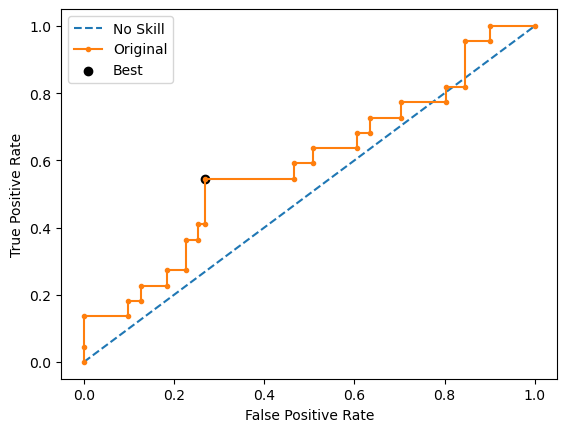

Ave Test G-mean: 0.3613576837908533
Stdev Test G-mean: 0.005293502967458834
Ave Test Specificity: 0.9577464788732396
Ave Test Recall: 0.13636363636363635
Ave Test NPV: 0.7815179842197626
Ave Test Accuracy: 0.7634408602150538
Ave Test Precision: 0.5664285714285715
Ave Test F1-Score: 0.21520306513409962
Ave Runtime: 2.0257042407989503


In [65]:
ho_t04_catboost_gs, ho_t04_catboost_be, ho_t04_catboost_model_info, ho_t04_catboost_metrics_df = catboost_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

In [66]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost', 'catboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost', 'CatBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t04_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t04_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t04_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall', 'Average Test Precision', 'Average Test F1-score',
    'Average Test Accuracy'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall,Average Test Precision,Average Test F1-score,Average Test Accuracy
7,Extreme Gradient Boosting (XGBoost),0.536064,0.048472,0.298005,0.764208,0.729577,0.400000,0.320374,0.351588,0.651613
5,Gradient Boosting Machine (GBM),0.500056,0.068202,0.308016,0.808784,0.684507,0.372727,0.268665,0.310089,0.610753
3,Decision Tree,0.483141,0.104285,0.415281,NaN,0.701408,0.345455,0.265324,0.296460,0.617204
2,Logistic Regression,0.417370,0.092549,0.356111,NaN,0.830986,0.218182,0.288915,0.245405,0.686022
1,SVM Classifier,0.365525,0.062641,0.466667,0.340958,0.946479,0.145455,0.494286,0.217194,0.756989
9,CatBoost,0.361358,0.005294,0.416667,0.836408,0.957746,0.136364,0.566429,0.215203,0.763441
6,LightGBM,0.348726,0.044241,0.303333,0.667047,0.901408,0.136364,0.304545,0.187787,0.720430
4,Random Forest,0.340882,0.122314,0.378571,0.578850,0.904225,0.145455,0.335439,0.187521,0.724731
8,AdaBoost,0.320736,0.057384,0.366667,0.820392,0.963380,0.109091,0.480000,0.177778,0.761290
0,k-Nearest Neighbors,0.288025,0.053814,0.450000,0.505691,0.938028,0.090909,0.306667,0.139938,0.737634


In [67]:
best_scores_models = {
    'Best Score': [],
    'Best Model': []
}

indices = [
    'Highest Test Accuracy',
    'Highest Test G-mean',
    'Highest Test Recall',
    'Highest Test Precision',
    'Highest Test Specificity',
    'Highest Test F1-score'
]

# Corresponding column names in your original dataframe
columns = [
    'Average Test Accuracy',
    'Average Test G-mean',
    'Average Test Recall',
    'Average Test Precision',
    'Average Test Specificity',
    'Average Test F1-score'
]

df = ho_t04_summ
# Finding the best model for each metric
for col in columns:
    best_score = df[col].max()
    best_model = df.loc[df[col] == best_score, 'Classifier model'].values[0]
    
    best_scores_models['Best Score'].append(best_score)
    best_scores_models['Best Model'].append(best_model)

# Creating the new dataframe
best_df = pd.DataFrame(best_scores_models, index=indices)

# Displaying the new dataframe
best_df

,Best Score,Best Model
Highest Test Accuracy,0.763441,CatBoost
Highest Test G-mean,0.536064,Extreme Gradient Boosting (XGBoost)
Highest Test Recall,0.400000,Extreme Gradient Boosting (XGBoost)
Highest Test Precision,0.566429,CatBoost
Highest Test Specificity,0.963380,AdaBoost
Highest Test F1-score,0.351588,Extreme Gradient Boosting (XGBoost)


# HO-T05 Runs

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits



4320 fits failed out of a total of 17280.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2220 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1145, in wrapper
    estimator._validate_params()
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 638, in _

Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 3, 'classifier__max_features': 'sqrt', 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5882193401183704
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(max_depth=3, max_features='sqrt',
                                        random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 152.04352164268494 secs
Run 1 - Random State: 0
Test G-mean: 0.5679618342470648
Best Threshold=0.638235, G-Mean=0.568


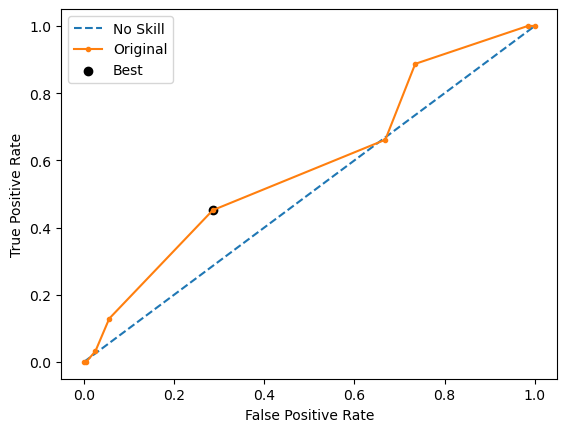

Run 2 - Random State: 1
Test G-mean: 0.6282912027221439
Best Threshold=0.560102, G-Mean=0.628


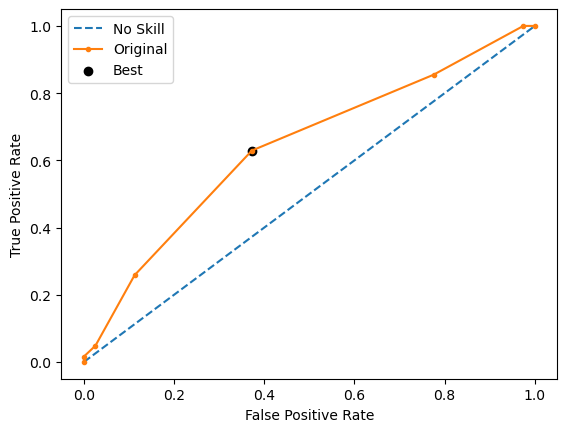

Run 3 - Random State: 2
Test G-mean: 0.6277015346403589
Best Threshold=0.572864, G-Mean=0.639


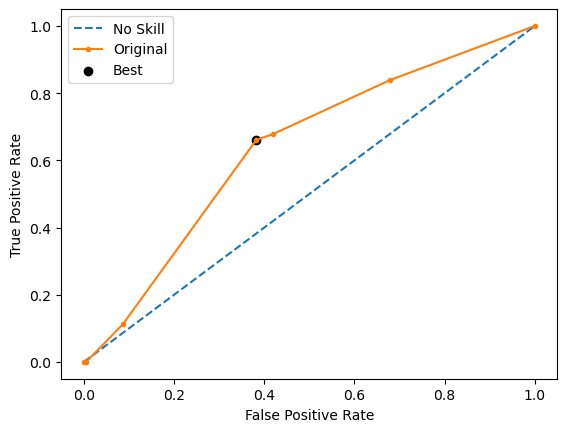

Run 4 - Random State: 3
Test G-mean: 0.5828354563599033
Best Threshold=0.559829, G-Mean=0.599


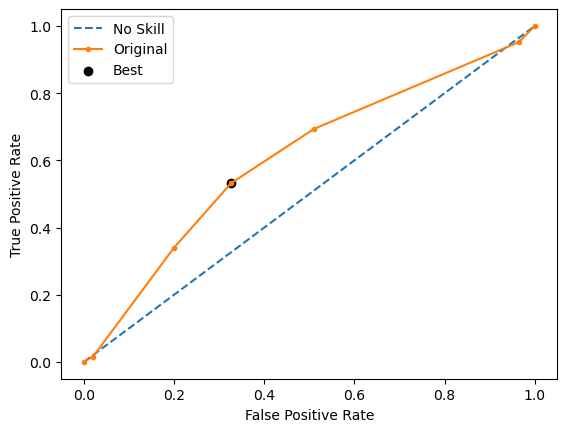

Run 5 - Random State: 4
Test G-mean: 0.5717884811269289
Best Threshold=0.600543, G-Mean=0.572


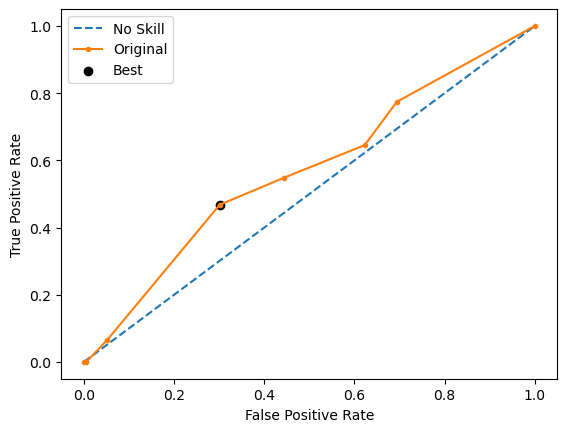

Ave Test G-mean: 0.5957157018192799
Stdev Test G-mean: 0.029970596168164648
Ave Test Specificity: 0.6224489795918368
Ave Test Recall: 0.5838709677419354
Ave Test NPV: 0.8276949369735256
Ave Test Accuracy: 0.6131782945736435
Ave Test Precision: 0.33010041034234583
Ave Test F1-Score: 0.41792585418380124
Ave Runtime: 0.02564659118652344


In [ ]:
ho_t05_dt_gs, ho_t05_dt_be, ho_t05_dt_model_info, ho_t05_dt_metrics_df = dt_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\linear_mod

Best Hyperparameters: {'classifier__C': 1e-06, 'classifier__penalty': None, 'classifier__solver': 'lbfgs', 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.5614600299693807
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 LogisticRegression(C=1e-06, max_iter=1000, penalty=None,
                                    random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 63.53556227684021 secs
Run 1 - Random State: 0
Test G-mean: 0.58184628163935
Best Threshold=0.510044, G-Mean=0.591


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


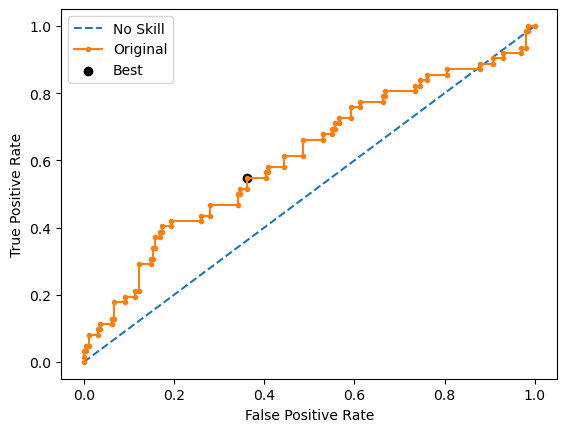

Setting penalty=None will ignore the C and l1_ratio parameters
lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Run 2 - Random State: 1
Test G-mean: 0.569192051803901
Best Threshold=0.541754, G-Mean=0.574


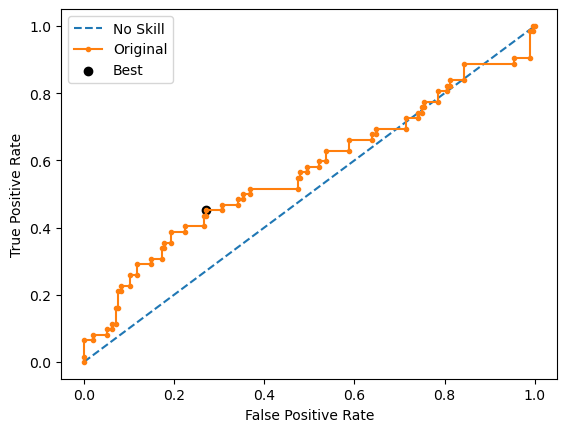

Setting penalty=None will ignore the C and l1_ratio parameters


Run 3 - Random State: 2
Test G-mean: 0.5636714267085828
Best Threshold=0.512322, G-Mean=0.580


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


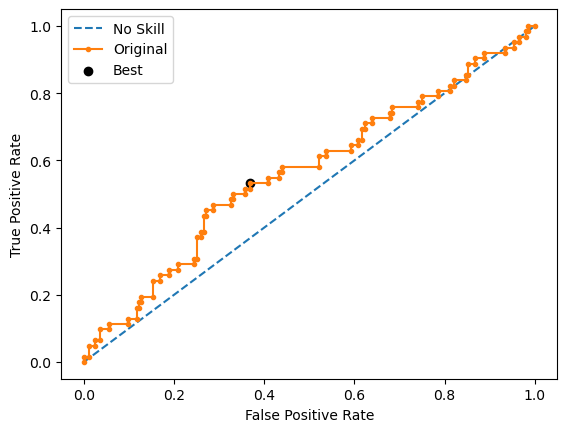

Setting penalty=None will ignore the C and l1_ratio parameters
lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Run 4 - Random State: 3
Test G-mean: 0.5951996915414691
Best Threshold=0.488220, G-Mean=0.610


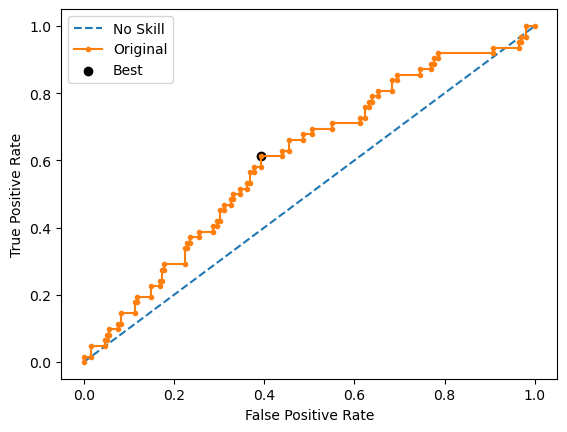

Setting penalty=None will ignore the C and l1_ratio parameters


Run 5 - Random State: 4
Test G-mean: 0.539273888233625
Best Threshold=0.489920, G-Mean=0.565


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


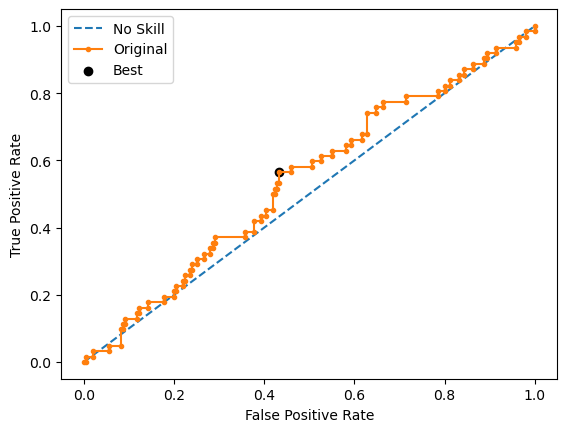

Ave Test G-mean: 0.5698366679853856
Stdev Test G-mean: 0.02097631414358341
Ave Test Specificity: 0.6142857142857143
Ave Test Recall: 0.5290322580645161
Ave Test NPV: 0.8046909529665209
Ave Test Accuracy: 0.5937984496124031
Ave Test Precision: 0.30299596398147177
Ave Test F1-Score: 0.3851475266183639
Ave Runtime: 0.63923659324646


In [ ]:
ho_t05_logreg_gs, ho_t05_logreg_be, ho_t05_logreg_model_info, ho_t05_logreg_metrics_df = logreg_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits


[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Best Hyperparameters: {'classifier__C': 100000.0, 'classifier__kernel': 'sigmoid', 'classifier__probability': True, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5429950763900592
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 SVC(C=100000.0, kernel='sigmoid', max_iter=1000,
                     probability=True, random_state=0, verbose=True))])
Mean Train Score (G-mean) 0.2872778417050305
Std Train Score (G-mean) 0.04560825876753685
GridSearchCV Runtime: 132.39731216430664 secs
[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 1 - Random State: 0
Test G-mean: 0.5034443575988877
Best Threshold=0.500000, G-Mean=0.346


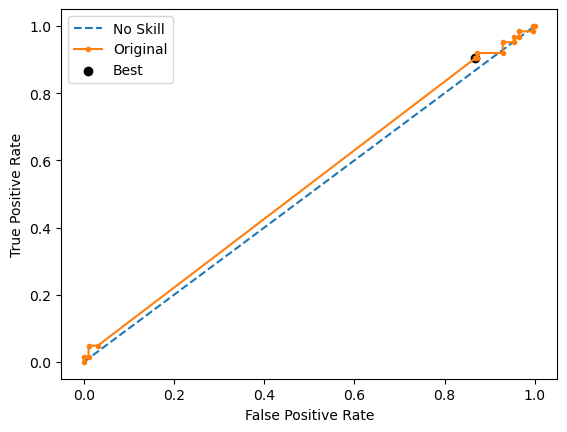

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 2 - Random State: 1
Test G-mean: 0.5263779371505743
Best Threshold=0.505006, G-Mean=0.305


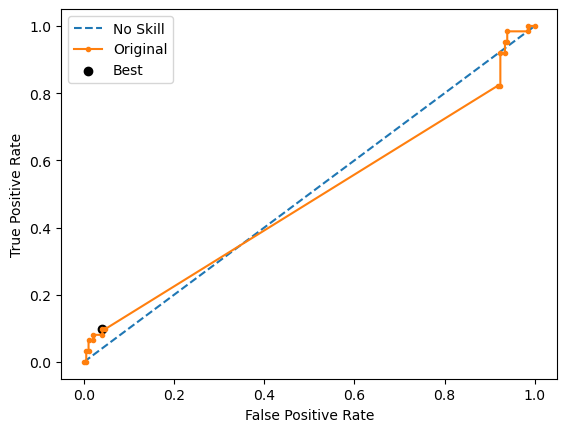

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 3 - Random State: 2
Test G-mean: 0.5284063760237141
Best Threshold=0.511266, G-Mean=0.443


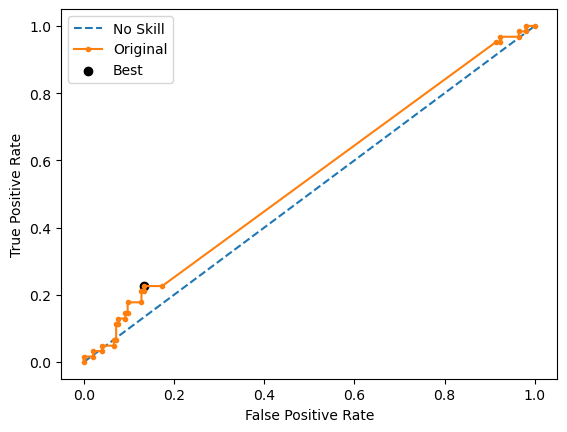

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 4 - Random State: 3
Test G-mean: 0.5497021756333007
Best Threshold=0.500000, G-Mean=0.396


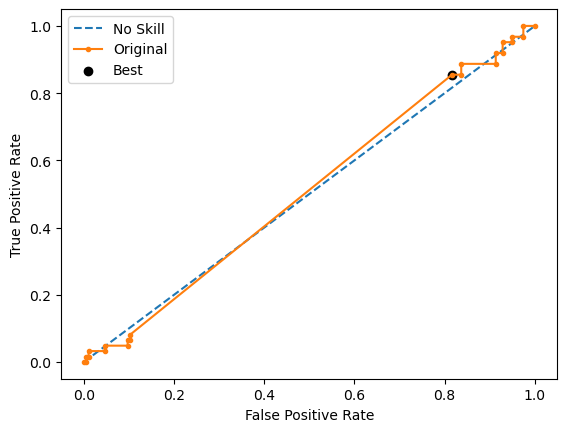

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 5 - Random State: 4
Test G-mean: 0.5562500231154435
Best Threshold=0.494494, G-Mean=0.143


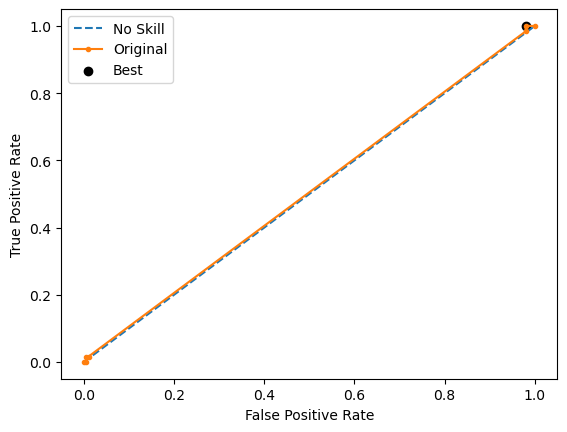

Ave Test G-mean: 0.5328361739043841
Stdev Test G-mean: 0.02096354661171347
Ave Test Specificity: 0.4897959183673469
Ave Test Recall: 0.5935483870967742
Ave Test NPV: 0.792879955744053
Ave Test Accuracy: 0.5147286821705427
Ave Test Precision: 0.2696568187294416
Ave Test F1-Score: 0.36899079871828794
Ave Runtime: 0.35968632698059083


In [ ]:
ho_t05_svm_gs, ho_t05_svm_be, ho_t05_svm_model_info, ho_t05_svm_metrics_df = svm_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t05_knn_gs, ho_t05_knn_be, ho_t05_knn_model_info, ho_t05_knn_metrics_df = knn_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits


Best Hyperparameters: {'classifier__metric': 'cosine', 'classifier__n_neighbors': 11, 'resampling': SMOTE(random_state=0)}
Best Validation Score (G-mean): 0.5582815646133021
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', SMOTE(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='cosine', n_neighbors=11))])
Mean Train Score (G-mean) 0.69379125155105
Std Train Score (G-mean) 0.014689486936425258
GridSearchCV Runtime: 112.72086524963379 secs
Run 1 - Random State: 0
Test G-mean: 0.4807006078538353
Run 2 - Random State: 1
Test G-mean: 0.47031708100177233
Run 3 - Random State: 2
Test G-mean: 0.5654206052395802
Run 4 - Random State: 3
Test G-mean: 0.5057275636779099
Run 5 - Random State: 4
Test G-mean: 0.5052391738356632
Ave Test G-mean: 0.5054810063217522
Stdev Test G-mean: 0.03688985153144814
Ave Test Specificity: 0.5306122448979591
Ave Test Recall: 0.4838709677419355
Ave Test NPV: 0.7645108496408456
Ave T

Fitting 10 folds for each of 540 candidates, totalling 5400 fits


Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.1, 'classifier__max_depth': None, 'classifier__max_leaves': 10, 'classifier__n_estimators': 250, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5903444676005928
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importance_type=None,
                               interaction_constrai

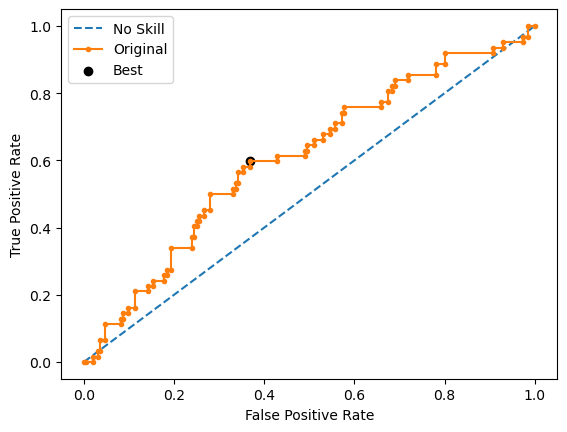

Run 2 - Random State: 1
Test G-mean: 0.6036426620632479
Best Threshold=0.397429, G-Mean=0.631


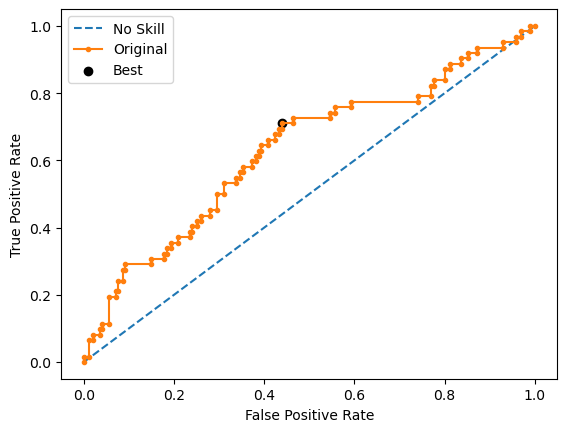

Run 3 - Random State: 2
Test G-mean: 0.5312021964706288
Best Threshold=0.382905, G-Mean=0.594


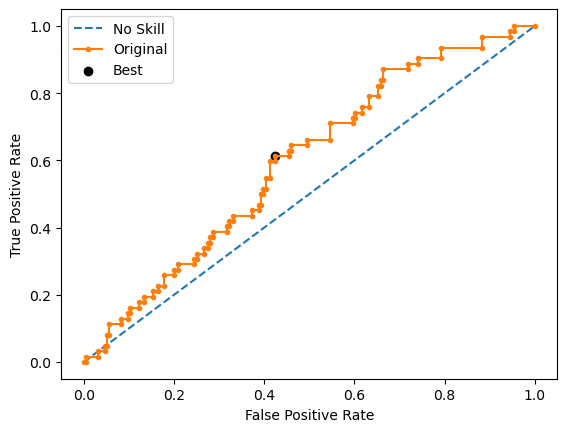

Run 4 - Random State: 3
Test G-mean: 0.5730104831718916
Best Threshold=0.642425, G-Mean=0.587


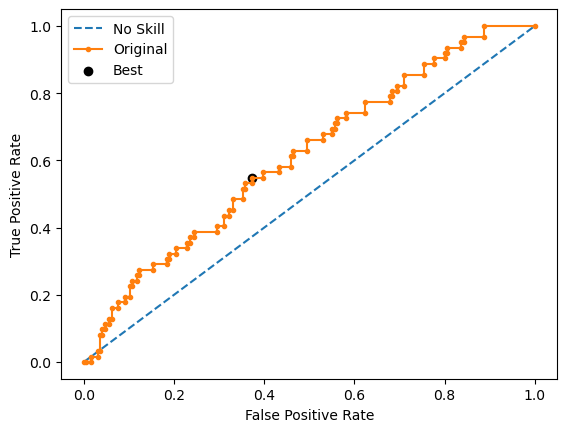

Run 5 - Random State: 4
Test G-mean: 0.5521667178180558
Best Threshold=0.666844, G-Mean=0.594


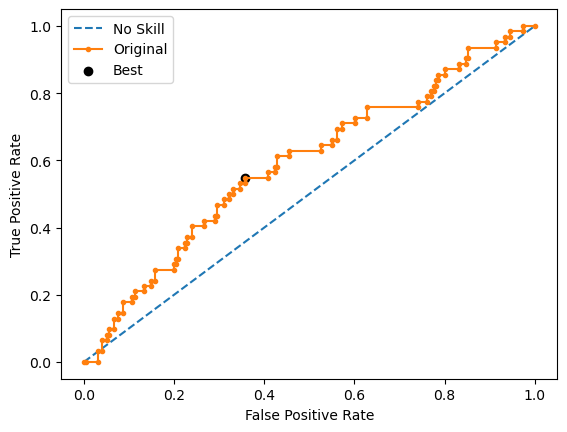

Ave Test G-mean: 0.5723916519163362
Stdev Test G-mean: 0.031446415182837424
Ave Test Specificity: 0.5806122448979592
Ave Test Recall: 0.5709677419354839
Ave Test NPV: 0.8109762192024684
Ave Test Accuracy: 0.5782945736434109
Ave Test Precision: 0.3018463409697703
Ave Test F1-Score: 0.3934647403911834
Ave Runtime: 0.3626582145690918


In [ ]:
ho_t05_xgb_gs, ho_t05_xgb_be, ho_t05_xgb_model_info, ho_t05_xgb_metrics_df = xgb_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits


[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002390 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 689
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 47
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positiv

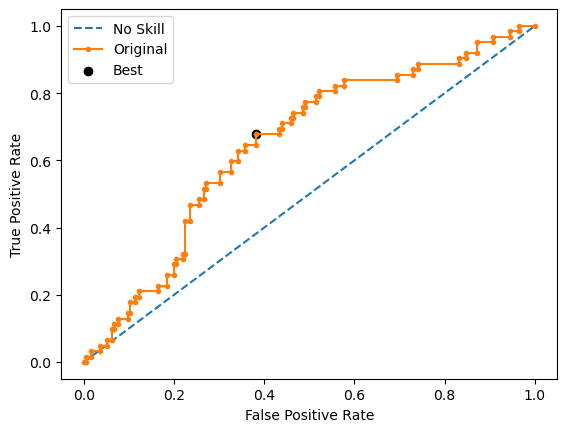

[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001117 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 700
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 47
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits w

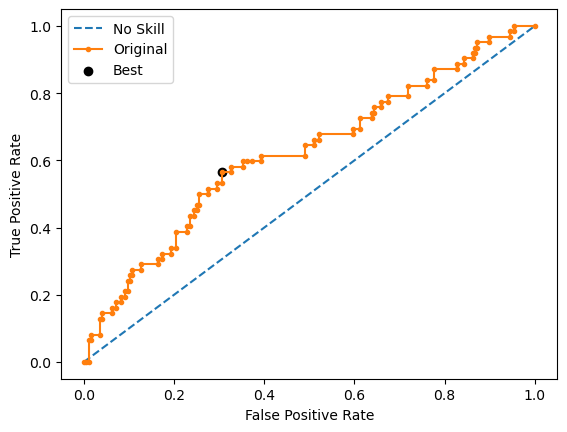

[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000888 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 693
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 47
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positiv

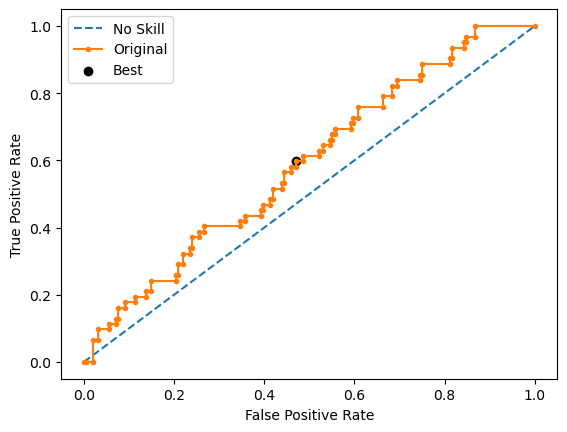

[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001462 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 693
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 48
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positiv

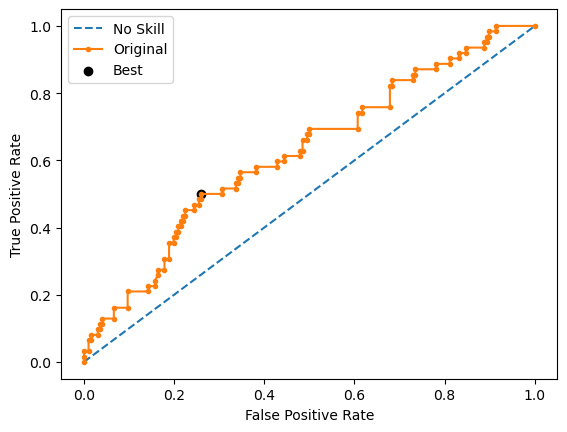

[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001052 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 684
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 47
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positiv

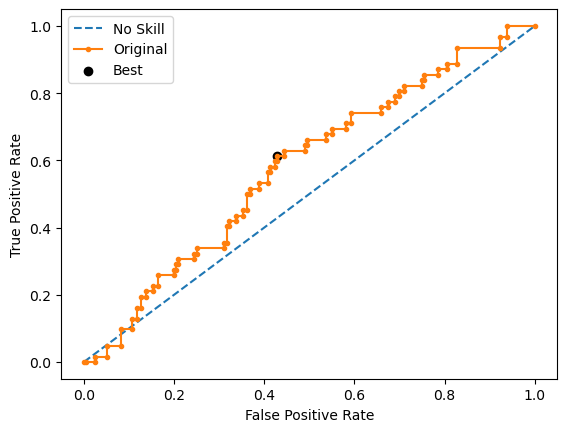

Ave Test G-mean: 0.5945713161869624
Stdev Test G-mean: 0.046127515612995135
Ave Test Specificity: 0.6244897959183674
Ave Test Recall: 0.5709677419354839
Ave Test NPV: 0.8222443176286957
Ave Test Accuracy: 0.6116279069767442
Ave Test Precision: 0.32455987922037877
Ave Test F1-Score: 0.4129134669771542
Ave Runtime: 0.21028051376342774


In [ ]:
ho_t05_lgbm_gs, ho_t05_lgbm_be, ho_t05_lgbm_model_info, ho_t05_lgbm_metrics_df = lgbm_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits


Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.587471696840875
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.9478261660647472
Std Train Score (G-mean) 0.005565821749660911
GridSearchCV Runtime: 15.005309343338013 secs
Run 1 - Random State: 0
Test G-mean: 0.6060915267313265
Best Threshold=0.880797, G-Mean=0.606


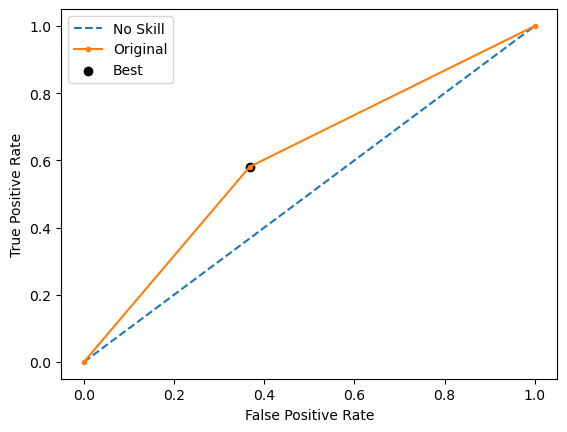

Run 2 - Random State: 1
Test G-mean: 0.6071767407189163
Best Threshold=0.880797, G-Mean=0.607


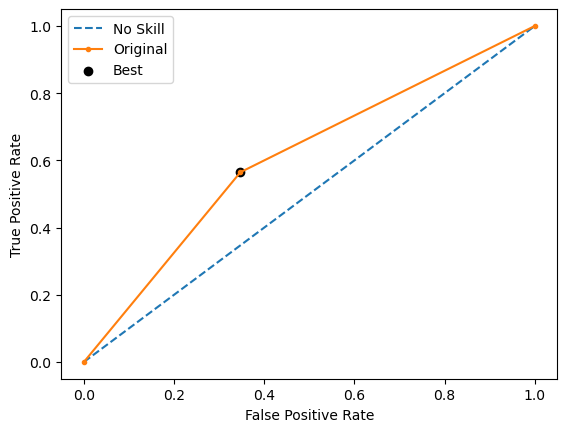

Run 3 - Random State: 2
Test G-mean: 0.5669467095138409
Best Threshold=0.880797, G-Mean=0.567


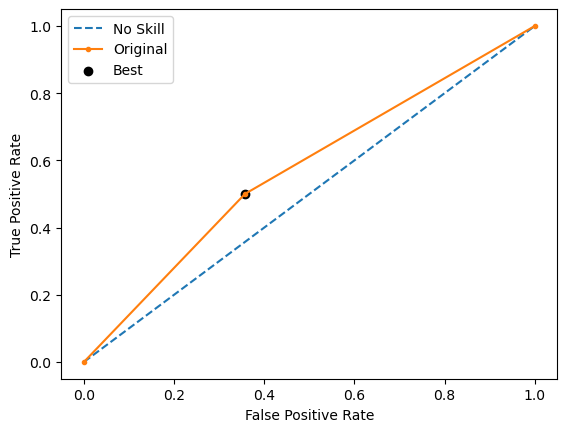

Run 4 - Random State: 3
Test G-mean: 0.5878963512522154
Best Threshold=0.880797, G-Mean=0.588


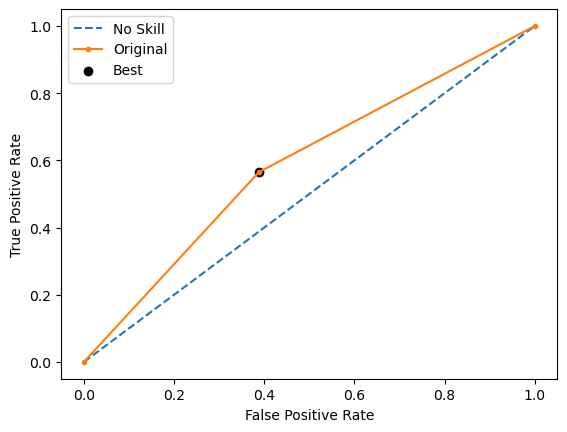

Run 5 - Random State: 4
Test G-mean: 0.5465494128601982
Best Threshold=0.880797, G-Mean=0.547


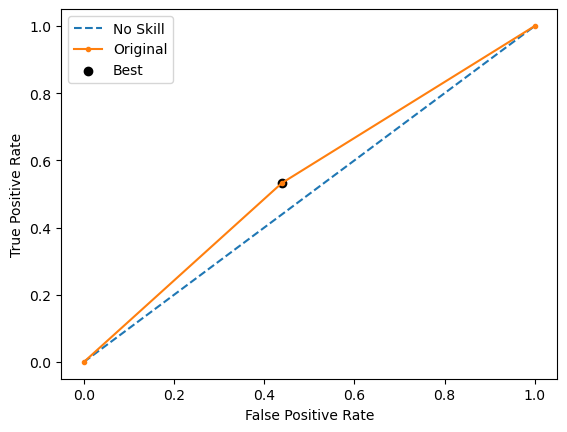

Ave Test G-mean: 0.5829321482152994
Stdev Test G-mean: 0.026115311950578902
Ave Test Specificity: 0.620408163265306
Ave Test Recall: 0.5483870967741936
Ave Test NPV: 0.8125428652134545
Ave Test Accuracy: 0.6031007751937985
Ave Test Precision: 0.3145392182660844
Ave Test F1-Score: 0.3994810191202375
Ave Runtime: 0.3101449489593506


In [ ]:
ho_t05_adaboost_gs, ho_t05_adaboost_be, ho_t05_adaboost_model_info, ho_t05_adaboost_metrics_df = adaboost_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits


Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5828116611563584
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 GradientBoostingClassifier(min_samples_leaf=2,
                                            n_estimators=200,
                                            random_state=0))])
Mean Train Score (G-mean) 0.8833761066250382
Std Train Score (G-mean) 0.010514679929685893
GridSearchCV Runtime: 149.15361618995667 secs
Run 1 - Random State: 0
Test G-mean: 0.5497021756333007
Best Threshold=0.591010, G-Mean=0.585


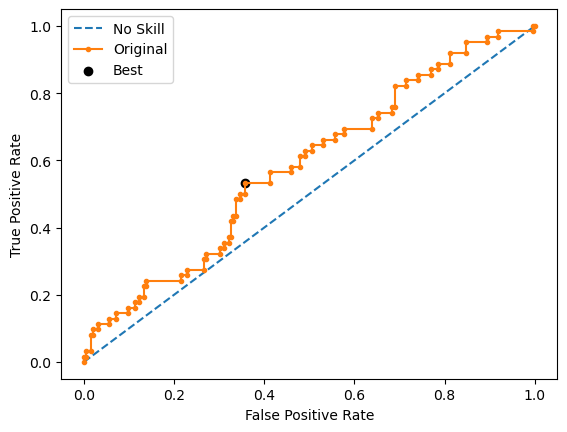

Run 2 - Random State: 1
Test G-mean: 0.5696978398265997
Best Threshold=0.678212, G-Mean=0.582


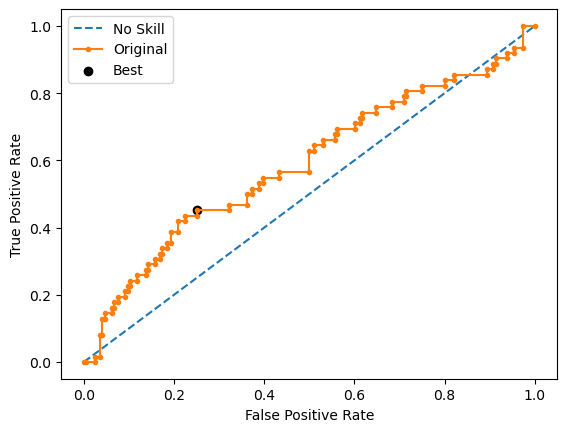

Run 3 - Random State: 2
Test G-mean: 0.5294176810178568
Best Threshold=0.504854, G-Mean=0.529


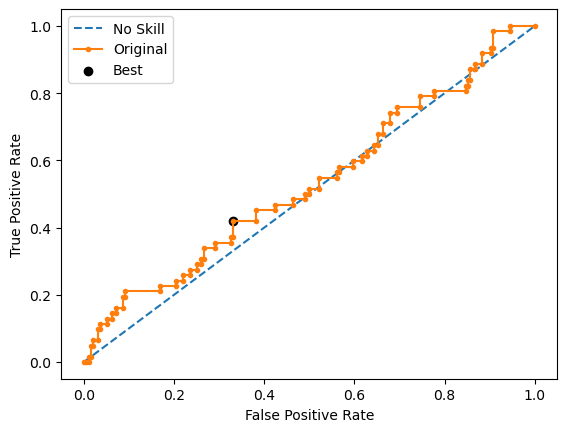

Run 4 - Random State: 3
Test G-mean: 0.5864949276826683
Best Threshold=0.529375, G-Mean=0.602


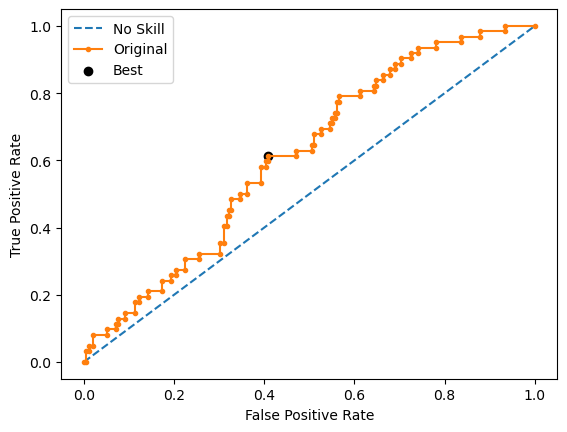

Run 5 - Random State: 4
Test G-mean: 0.56542060523958
Best Threshold=0.449592, G-Mean=0.579


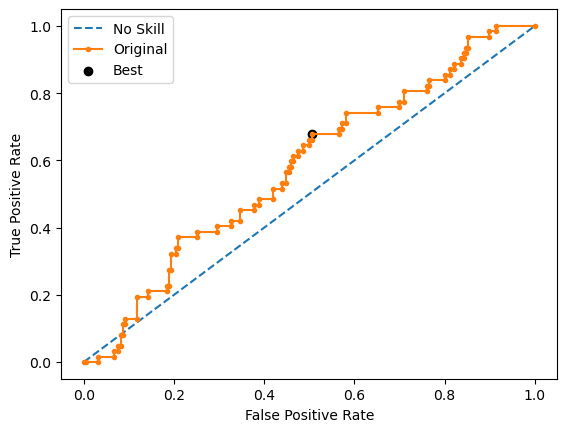

Ave Test G-mean: 0.5601466458800012
Stdev Test G-mean: 0.021602246106122304
Ave Test Specificity: 0.5755102040816327
Ave Test Recall: 0.5516129032258064
Ave Test NPV: 0.8030899046720947
Ave Test Accuracy: 0.5697674418604651
Ave Test Precision: 0.29127941791513523
Ave Test F1-Score: 0.3798617504315097
Ave Runtime: 0.6361113071441651


In [ ]:
ho_t05_gbm_gs, ho_t05_gbm_be, ho_t05_gbm_model_info, ho_t05_gbm_metrics_df = gbm_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits


Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.595930959178998
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 RandomForestClassifier(max_depth=2, min_samples_leaf=3,
                                        n_estimators=300, oob_score=True,
                                        random_state=0))])
Mean Train Score (G-mean) 0.6099318861568523
Std Train Score (G-mean) 0.024214352161286905
GridSearchCV Runtime: 344.96700978279114 secs
Run 1 - Random State: 0
Test G-mean: 0.6315571110069641
Best Threshold=0.495801, G-Mean=0.655


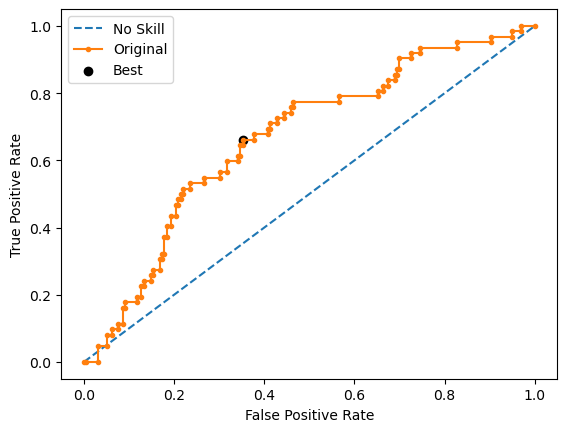

Run 2 - Random State: 1
Test G-mean: 0.5815633512644206
Best Threshold=0.493450, G-Mean=0.603


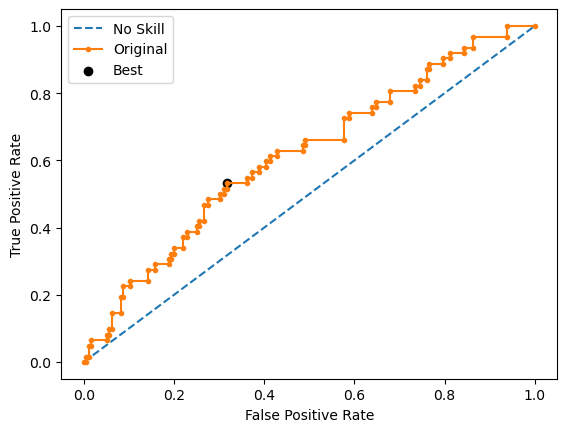

Run 3 - Random State: 2
Test G-mean: 0.5850901473955347
Best Threshold=0.492791, G-Mean=0.610


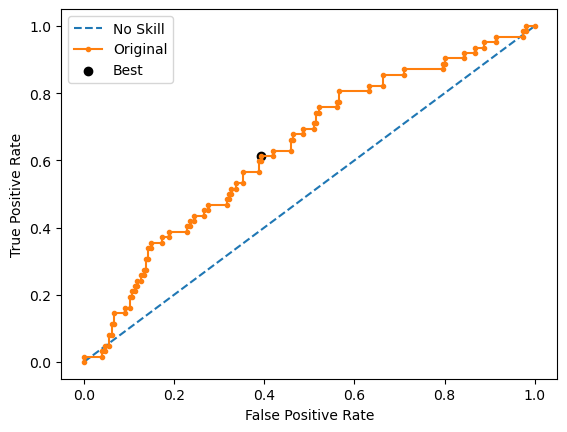

Run 4 - Random State: 3
Test G-mean: 0.601183822262458
Best Threshold=0.508115, G-Mean=0.617


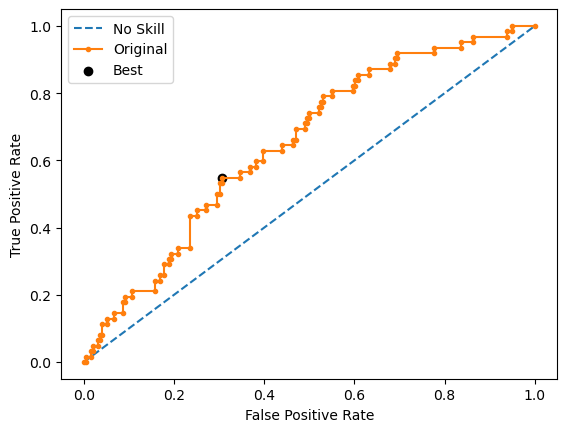

Run 5 - Random State: 4
Test G-mean: 0.5755181996745907
Best Threshold=0.505181, G-Mean=0.598


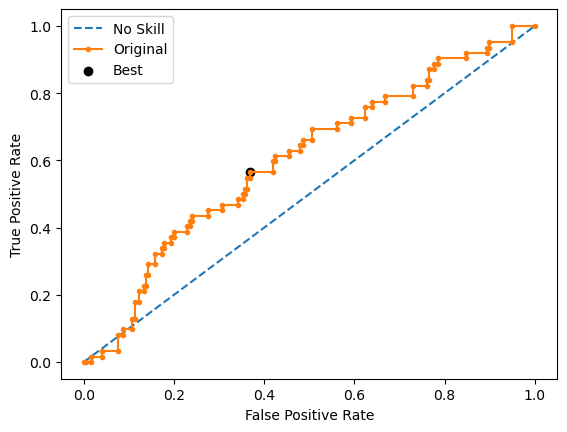

Ave Test G-mean: 0.5949825263207936
Stdev Test G-mean: 0.02254412200611578
Ave Test Specificity: 0.6479591836734695
Ave Test Recall: 0.5483870967741935
Ave Test NPV: 0.8194155913142911
Ave Test Accuracy: 0.624031007751938
Ave Test Precision: 0.3310702454346537
Ave Test F1-Score: 0.4120867167403376
Ave Runtime: 0.44906344413757326


In [ ]:
ho_t05_rf_gs, ho_t05_rf_be, ho_t05_rf_model_info, ho_t05_rf_metrics_df = rf_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits


Learning rate set to 0.006754
0:	learn: 0.6917977	total: 2.97ms	remaining: 2.96s
1:	learn: 0.6902348	total: 4.81ms	remaining: 2.4s
2:	learn: 0.6893033	total: 8.51ms	remaining: 2.83s
3:	learn: 0.6885068	total: 11.8ms	remaining: 2.94s
4:	learn: 0.6875450	total: 14.9ms	remaining: 2.96s
5:	learn: 0.6861445	total: 17.4ms	remaining: 2.88s
6:	learn: 0.6853292	total: 19.9ms	remaining: 2.82s
7:	learn: 0.6845619	total: 22.5ms	remaining: 2.79s
8:	learn: 0.6833746	total: 24.7ms	remaining: 2.71s
9:	learn: 0.6821821	total: 26.9ms	remaining: 2.66s
10:	learn: 0.6809110	total: 29.5ms	remaining: 2.65s
11:	learn: 0.6797924	total: 31.7ms	remaining: 2.61s
12:	learn: 0.6787607	total: 34ms	remaining: 2.58s
13:	learn: 0.6772935	total: 36.3ms	remaining: 2.56s
14:	learn: 0.6761927	total: 38.3ms	remaining: 2.51s
15:	learn: 0.6751500	total: 40.3ms	remaining: 2.48s
16:	learn: 0.6738294	total: 42.6ms	remaining: 2.46s
17:	learn: 0.6727370	total: 44.5ms	remaining: 2.43s
18:	learn: 0.6716259	total: 46.1ms	remaining: 2

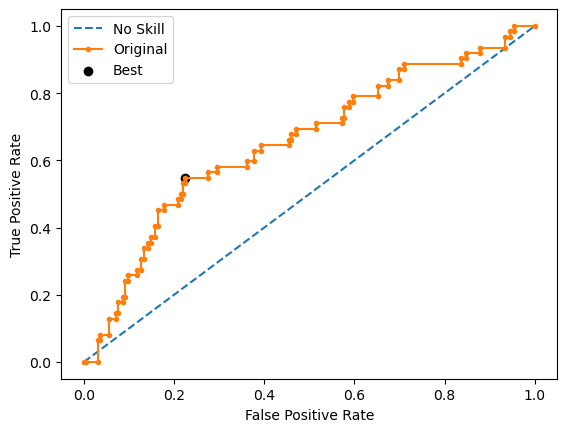

Learning rate set to 0.006754
0:	learn: 0.6914433	total: 3.87ms	remaining: 3.86s
1:	learn: 0.6900294	total: 8.45ms	remaining: 4.22s
2:	learn: 0.6886887	total: 13.2ms	remaining: 4.38s
3:	learn: 0.6876392	total: 18.1ms	remaining: 4.5s
4:	learn: 0.6864282	total: 23.2ms	remaining: 4.62s
5:	learn: 0.6847816	total: 28ms	remaining: 4.64s
6:	learn: 0.6831166	total: 32.2ms	remaining: 4.57s
7:	learn: 0.6815465	total: 35.1ms	remaining: 4.36s
8:	learn: 0.6804804	total: 40.8ms	remaining: 4.49s
9:	learn: 0.6788058	total: 44.6ms	remaining: 4.42s
10:	learn: 0.6772484	total: 48.2ms	remaining: 4.33s
11:	learn: 0.6750571	total: 51.9ms	remaining: 4.28s
12:	learn: 0.6733833	total: 55.6ms	remaining: 4.22s
13:	learn: 0.6724862	total: 62ms	remaining: 4.36s
14:	learn: 0.6709660	total: 66.7ms	remaining: 4.38s
15:	learn: 0.6693293	total: 71.6ms	remaining: 4.4s
16:	learn: 0.6678461	total: 74.4ms	remaining: 4.3s
17:	learn: 0.6666597	total: 78.4ms	remaining: 4.28s
18:	learn: 0.6654598	total: 83.2ms	remaining: 4.3s


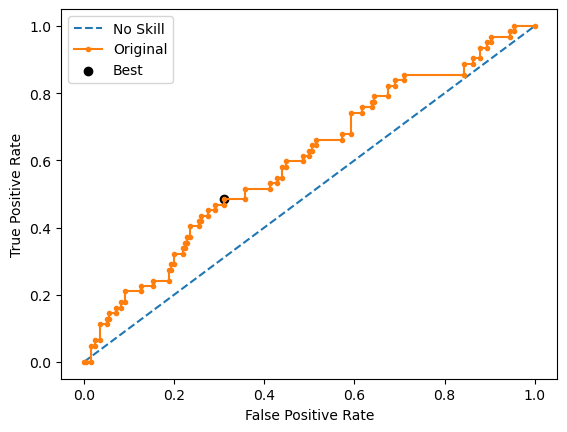

Learning rate set to 0.006754
0:	learn: 0.6924791	total: 4.21ms	remaining: 4.21s
1:	learn: 0.6909744	total: 8.97ms	remaining: 4.47s
2:	learn: 0.6900791	total: 14.7ms	remaining: 4.89s
3:	learn: 0.6893194	total: 19.4ms	remaining: 4.83s
4:	learn: 0.6887967	total: 24.8ms	remaining: 4.93s
5:	learn: 0.6876795	total: 28.9ms	remaining: 4.79s
6:	learn: 0.6867252	total: 32.1ms	remaining: 4.55s
7:	learn: 0.6860541	total: 34.2ms	remaining: 4.25s
8:	learn: 0.6852618	total: 37.6ms	remaining: 4.14s
9:	learn: 0.6844782	total: 40.2ms	remaining: 3.98s
10:	learn: 0.6835143	total: 42.7ms	remaining: 3.84s
11:	learn: 0.6824772	total: 45.5ms	remaining: 3.74s
12:	learn: 0.6815703	total: 47ms	remaining: 3.57s
13:	learn: 0.6808079	total: 48.7ms	remaining: 3.43s
14:	learn: 0.6800360	total: 50.8ms	remaining: 3.33s
15:	learn: 0.6792798	total: 53.2ms	remaining: 3.27s
16:	learn: 0.6781292	total: 55.2ms	remaining: 3.19s
17:	learn: 0.6772525	total: 56.7ms	remaining: 3.09s
18:	learn: 0.6764761	total: 58.6ms	remaining: 

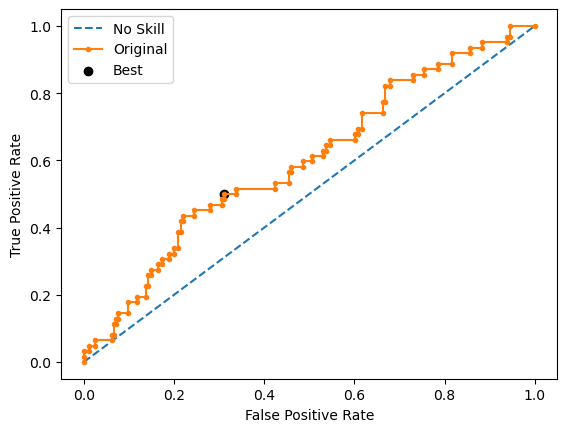

Learning rate set to 0.006754
0:	learn: 0.6922129	total: 3.1ms	remaining: 3.1s
1:	learn: 0.6912579	total: 7.15ms	remaining: 3.57s
2:	learn: 0.6903449	total: 10.5ms	remaining: 3.5s
3:	learn: 0.6887396	total: 13ms	remaining: 3.24s
4:	learn: 0.6879495	total: 16.7ms	remaining: 3.32s
5:	learn: 0.6867959	total: 20.9ms	remaining: 3.47s
6:	learn: 0.6852498	total: 25ms	remaining: 3.54s
7:	learn: 0.6835548	total: 28.3ms	remaining: 3.51s
8:	learn: 0.6825712	total: 31.6ms	remaining: 3.48s
9:	learn: 0.6809767	total: 34.9ms	remaining: 3.45s
10:	learn: 0.6797229	total: 38.2ms	remaining: 3.43s
11:	learn: 0.6781012	total: 42.5ms	remaining: 3.5s
12:	learn: 0.6770691	total: 46ms	remaining: 3.49s
13:	learn: 0.6766071	total: 47.9ms	remaining: 3.37s
14:	learn: 0.6753485	total: 51ms	remaining: 3.35s
15:	learn: 0.6736385	total: 54.2ms	remaining: 3.33s
16:	learn: 0.6718781	total: 56.7ms	remaining: 3.28s
17:	learn: 0.6708526	total: 59.1ms	remaining: 3.23s
18:	learn: 0.6693183	total: 61.9ms	remaining: 3.19s
19:	

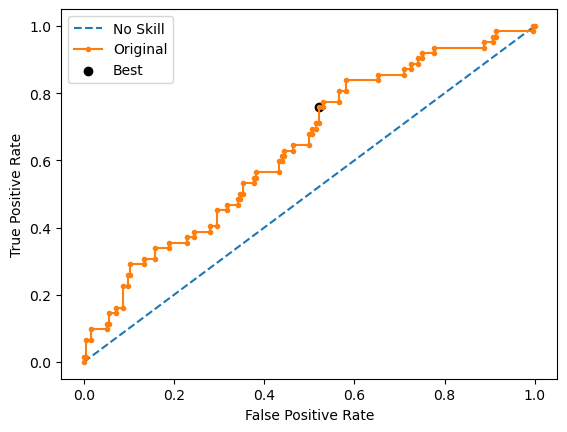

Learning rate set to 0.006754
0:	learn: 0.6914568	total: 5.25ms	remaining: 5.24s
1:	learn: 0.6902125	total: 10.8ms	remaining: 5.4s
2:	learn: 0.6887068	total: 16.3ms	remaining: 5.4s
3:	learn: 0.6874764	total: 22.1ms	remaining: 5.51s
4:	learn: 0.6860968	total: 27.5ms	remaining: 5.47s
5:	learn: 0.6846044	total: 32.7ms	remaining: 5.41s
6:	learn: 0.6838692	total: 36.6ms	remaining: 5.19s
7:	learn: 0.6832762	total: 40.2ms	remaining: 4.98s
8:	learn: 0.6825057	total: 44.1ms	remaining: 4.86s
9:	learn: 0.6814077	total: 46.7ms	remaining: 4.62s
10:	learn: 0.6804399	total: 50.4ms	remaining: 4.53s
11:	learn: 0.6791093	total: 53.6ms	remaining: 4.42s
12:	learn: 0.6777054	total: 55.3ms	remaining: 4.2s
13:	learn: 0.6770722	total: 56.9ms	remaining: 4.01s
14:	learn: 0.6761980	total: 59.6ms	remaining: 3.92s
15:	learn: 0.6749047	total: 62.4ms	remaining: 3.83s
16:	learn: 0.6739490	total: 65.4ms	remaining: 3.78s
17:	learn: 0.6730143	total: 67.6ms	remaining: 3.69s
18:	learn: 0.6711545	total: 70.1ms	remaining: 3

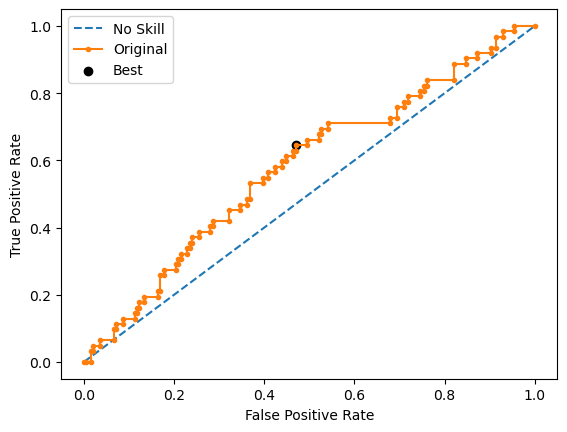

Ave Test G-mean: 0.5814443187899833
Stdev Test G-mean: 0.018374617350089432
Ave Test Specificity: 0.6091836734693877
Ave Test Recall: 0.5580645161290322
Ave Test NPV: 0.8136491858338042
Ave Test Accuracy: 0.5968992248062015
Ave Test Precision: 0.31170357468316395
Ave Test F1-Score: 0.39914401146298845
Ave Runtime: 1.5967380046844482


In [ ]:
ho_t05_catboost_gs, ho_t05_catboost_be, ho_t05_catboost_model_info, ho_t05_catboost_metrics_df = catboost_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

In [ ]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost', 'catboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost', 'CatBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t05_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t05_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t05_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall', 'Average Test Precision', 'Average Test F1-score',
    'Average Test Accuracy'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall,Average Test Precision,Average Test F1-score,Average Test Accuracy
3,Decision Tree,0.595716,0.029971,0.588219,NaN,0.622449,0.583871,0.330100,0.417926,0.613178
4,Random Forest,0.594983,0.022544,0.595931,0.609932,0.647959,0.548387,0.331070,0.412087,0.624031
6,LightGBM,0.594571,0.046128,0.611386,0.738260,0.624490,0.570968,0.324560,0.412913,0.611628
8,AdaBoost,0.582932,0.026115,0.587472,0.947826,0.620408,0.548387,0.314539,0.399481,0.603101
9,CatBoost,0.581444,0.018375,0.598435,0.947852,0.609184,0.558065,0.311704,0.399144,0.596899
7,Extreme Gradient Boosting (XGBoost),0.572392,0.031446,0.590344,0.851932,0.580612,0.570968,0.301846,0.393465,0.578295
2,Logistic Regression,0.569837,0.020976,0.561460,NaN,0.614286,0.529032,0.302996,0.385148,0.593798
5,Gradient Boosting Machine (GBM),0.560147,0.021602,0.582812,0.883376,0.575510,0.551613,0.291279,0.379862,0.569767
1,SVM Classifier,0.532836,0.020964,0.542995,0.287278,0.489796,0.593548,0.269657,0.368991,0.514729
0,k-Nearest Neighbors,0.505481,0.036890,0.558282,0.693791,0.530612,0.483871,0.246144,0.325966,0.519380


In [ ]:
best_scores_models = {
    'Best Score': [],
    'Best Model': []
}

indices = [
    'Highest Test Accuracy',
    'Highest Test G-mean',
    'Highest Test Recall',
    'Highest Test Precision',
    'Highest Test Specificity',
    'Highest Test F1-score'
]

# Corresponding column names in your original dataframe
columns = [
    'Average Test Accuracy',
    'Average Test G-mean',
    'Average Test Recall',
    'Average Test Precision',
    'Average Test Specificity',
    'Average Test F1-score'
]

df = ho_t05_summ
# Finding the best model for each metric
for col in columns:
    best_score = df[col].max()
    best_model = df.loc[df[col] == best_score, 'Classifier model'].values[0]
    
    best_scores_models['Best Score'].append(best_score)
    best_scores_models['Best Model'].append(best_model)

# Creating the new dataframe
best_df = pd.DataFrame(best_scores_models, index=indices)

# Displaying the new dataframe
best_df

,Best Score,Best Model
Highest Test Accuracy,0.624031,Random Forest
Highest Test G-mean,0.595716,Decision Tree
Highest Test Recall,0.593548,SVM Classifier
Highest Test Precision,0.331070,Random Forest
Highest Test Specificity,0.647959,Random Forest
Highest Test F1-score,0.417926,Decision Tree


# HO-T06 Runs

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits



4320 fits failed out of a total of 17280.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1872 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1145, in wrapper
    estimator._validate_params()
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 638, in _

Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 5, 'classifier__max_features': 'sqrt', 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.4067890442890443
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(criterion='entropy', max_depth=5,
                                        max_features='sqrt', min_samples_leaf=3,
                                        random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 83.79074025154114 secs
Run 1 - Random State: 0
Test G-mean: 0.5355481115357669
Best Threshold=0.467391, G-Mean=0.577


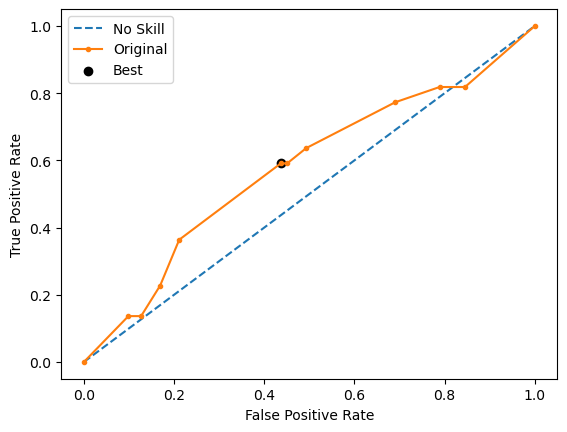

Run 2 - Random State: 1
Test G-mean: 0.4389779772752278
Best Threshold=0.217391, G-Mean=0.475


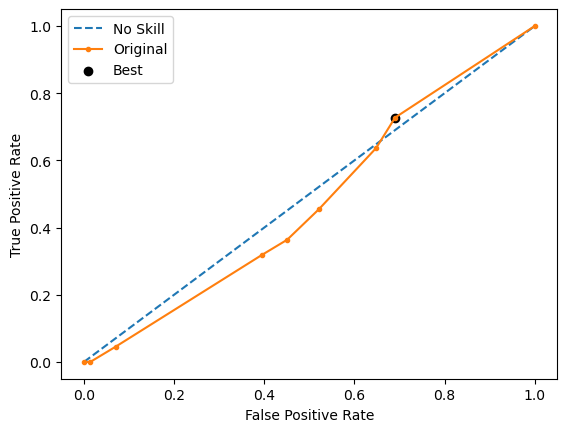

Run 3 - Random State: 2
Test G-mean: 0.407986844205563
Best Threshold=0.333333, G-Mean=0.524


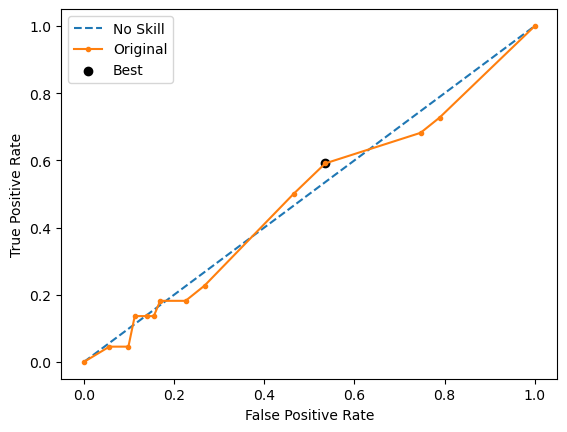

Run 4 - Random State: 3
Test G-mean: 0.41575872053437934
Best Threshold=0.500000, G-Mean=0.441


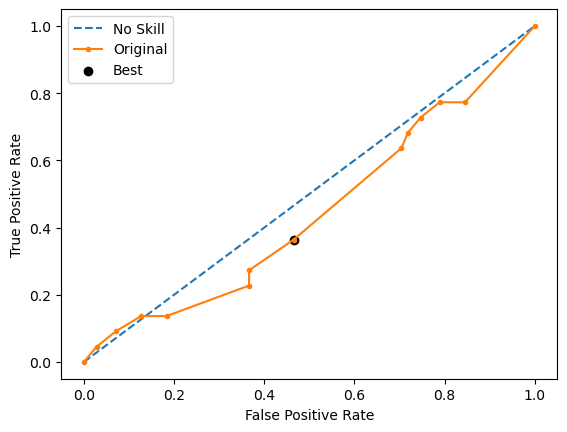

Run 5 - Random State: 4
Test G-mean: 0.48604073429140177
Best Threshold=0.580153, G-Mean=0.486


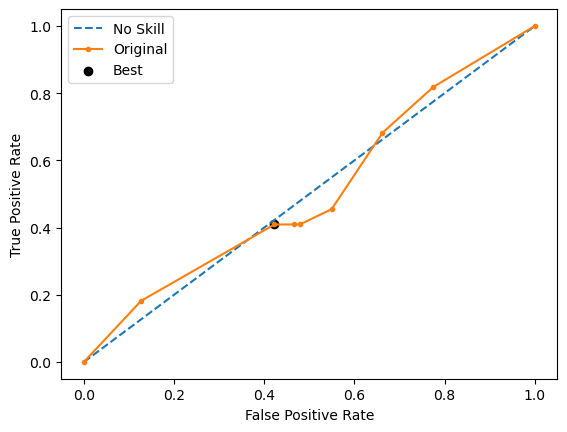

Ave Test G-mean: 0.4568624775684678
Stdev Test G-mean: 0.05348130838878799
Ave Test Specificity: 0.6676056338028169
Ave Test Recall: 0.31818181818181823
Ave Test NPV: 0.7583933352085342
Ave Test Accuracy: 0.5849462365591398
Ave Test Precision: 0.23488573021181716
Ave Test F1-Score: 0.2671730168852876
Ave Runtime: 0.03011016845703125


In [68]:
ho_t06_dt_gs, ho_t06_dt_be, ho_t06_dt_model_info, ho_t06_dt_metrics_df = dt_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits
Best Hyperparameters: {'classifier__C': 1e-06, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs', 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.35285714285714287
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 LogisticRegression(C=1e-06, max_iter=1000, random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 48.502315044403076 secs
Run 1 - Random State: 0
Test G-mean: 0.4800768184369166
Best Threshold=0.454170, G-Mean=0.496



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\linear_mod

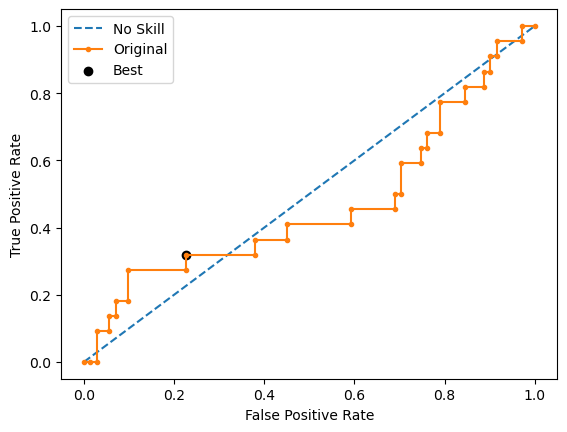

Run 2 - Random State: 1
Test G-mean: 0.3505985370576149
Best Threshold=0.312202, G-Mean=0.554


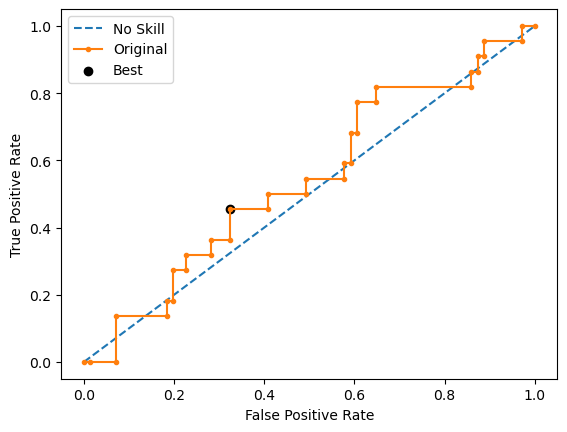

Run 3 - Random State: 2
Test G-mean: 0.5355481115357669
Best Threshold=0.392553, G-Mean=0.656


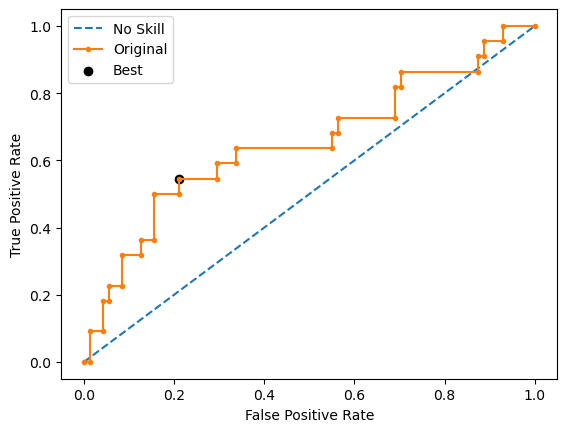

Run 4 - Random State: 3
Test G-mean: 0.35332697149186154
Best Threshold=0.318887, G-Mean=0.491


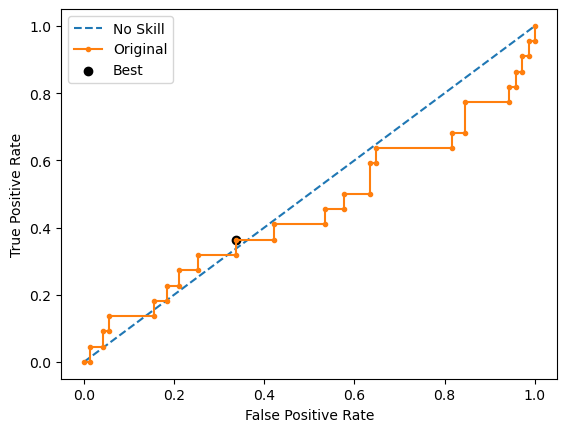

Run 5 - Random State: 4
Test G-mean: 0.41421601124204527
Best Threshold=0.309955, G-Mean=0.554


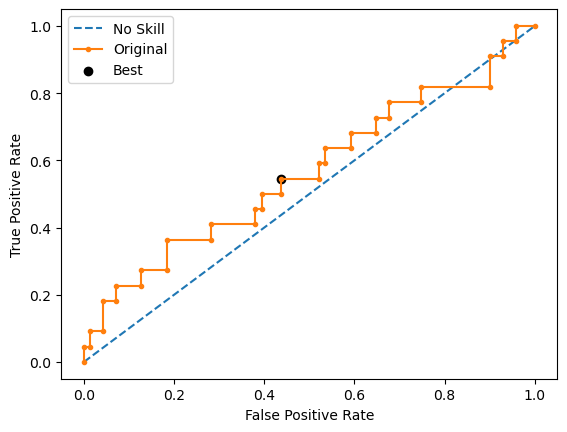

Ave Test G-mean: 0.426753289952841
Stdev Test G-mean: 0.08066577012895708
Ave Test Specificity: 0.9014084507042254
Ave Test Recall: 0.20909090909090908
Ave Test NPV: 0.7865458843531151
Ave Test Accuracy: 0.7376344086021506
Ave Test Precision: 0.3972549019607843
Ave Test F1-Score: 0.26885925006892747
Ave Runtime: 0.024979019165039064


In [69]:
ho_t06_logreg_gs, ho_t06_logreg_be, ho_t06_logreg_model_info, ho_t06_logreg_metrics_df = logreg_class2(ho_t06, 'precision',
                       'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]Best Hyperparameters: {'classifier__C': 1.0, 'classifier__kernel': 'rbf', 'classifier__probability': True, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.5166666666666666
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 SVC(max_iter=1000, probability=True, random_state=0,
                     verbose=True))])
Mean Train Score (G-mean) 0.3436160701884057
Std Train Score (G-mean) 0.07711909086691912
GridSearchCV Runtime: 42.20219683647156 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.2993804956539035
Best Threshold=0.490060, G-Mean=0.491


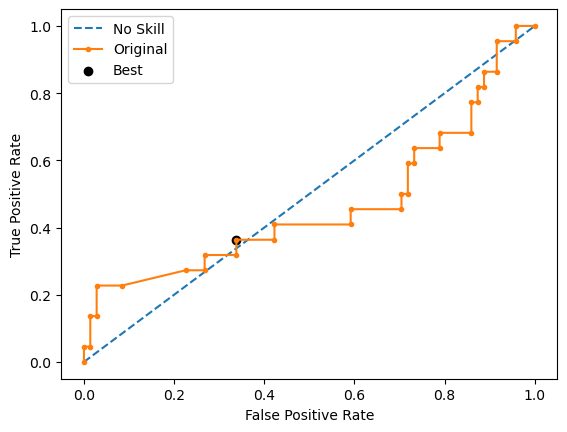

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.411113225896519
Best Threshold=0.416613, G-Mean=0.536


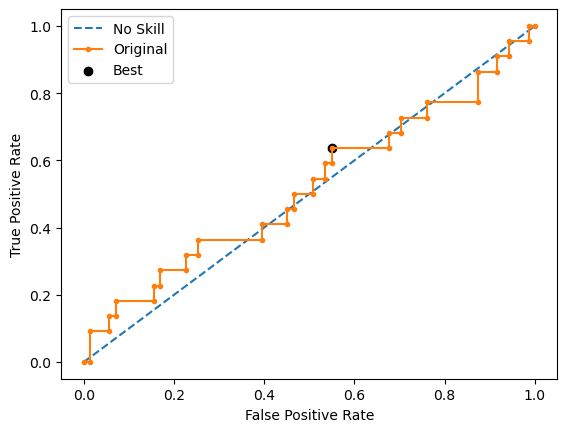

[LibSVM]Run 3 - Random State: 2
Test G-mean: 0.23189913476937812
Best Threshold=0.476160, G-Mean=0.588


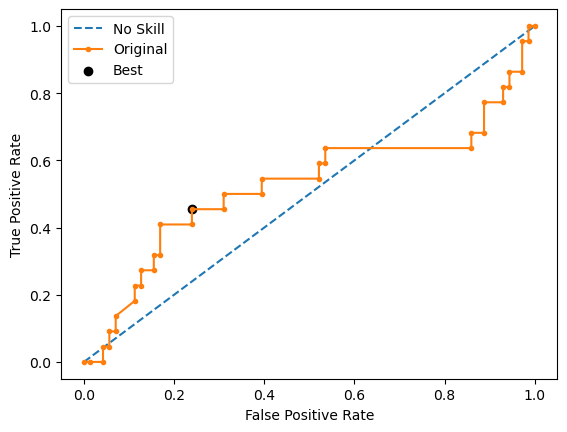

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.29507263803299183
Best Threshold=0.492268, G-Mean=0.547


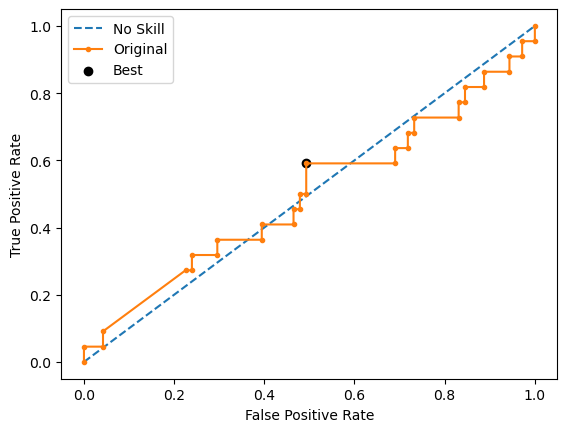

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.2993804956539035
Best Threshold=0.482047, G-Mean=0.516


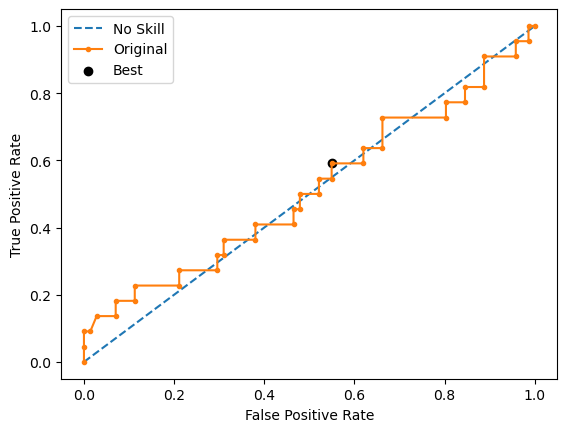

Ave Test G-mean: 0.3073691980013392
Stdev Test G-mean: 0.06468654783956063
Ave Test Specificity: 0.7830985915492958
Ave Test Recall: 0.2818181818181818
Ave Test NPV: 0.7827994227994228
Ave Test Accuracy: 0.664516129032258
Ave Test Precision: 0.48328282828282826
Ave Test F1-Score: 0.22160616921907242
Ave Runtime: 0.14009499549865723


In [70]:
ho_t06_svm_gs, ho_t06_svm_be, ho_t06_svm_model_info, ho_t06_svm_metrics_df = svm_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

In [71]:
ho_t06_knn_gs, ho_t06_knn_be, ho_t06_knn_model_info, ho_t06_knn_metrics_df = knn_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits


Best Hyperparameters: {'classifier__metric': 'cityblock', 'classifier__n_neighbors': 7, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.4228571428571429
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 KNeighborsClassifier(metric='cityblock', n_neighbors=7))])
Mean Train Score (G-mean) 0.508396527969335
Std Train Score (G-mean) 0.03655509365471232
GridSearchCV Runtime: 43.90171432495117 secs
Run 1 - Random State: 0
Test G-mean: 0.3919810808364031
Run 2 - Random State: 1
Test G-mean: 0.4233879572637298
Run 3 - Random State: 2
Test G-mean: 0.5420830501783404
Run 4 - Random State: 3
Test G-mean: 0.26050281332269654
Run 5 - Random State: 4
Test G-mean: 0.4308821312279307
Ave Test G-mean: 0.4097674065658201
Stdev Test G-mean: 0.1009146331342172
Ave Test Specificity: 0.7830985915492958
Ave Test Recall: 0.22727272727272724
Ave Test NPV: 0.76651795749

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.1, 'classifier__max_depth': None, 'classifier__max_leaves': 10, 'classifier__n_estimators': 200, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.33690476190476193
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importance_type=None,
         

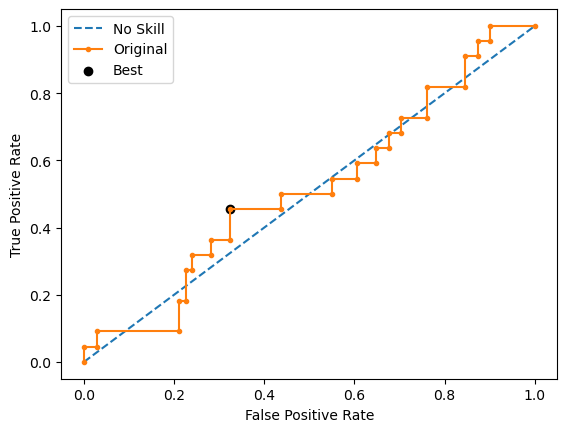

Run 2 - Random State: 1
Test G-mean: 0.4418851479682004
Best Threshold=0.101176, G-Mean=0.511


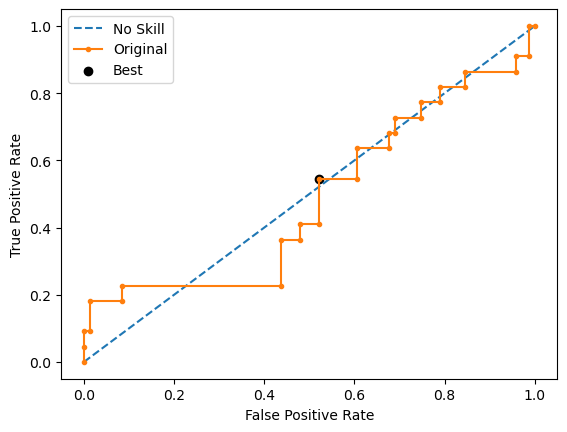

Run 3 - Random State: 2
Test G-mean: 0.43458075813283376
Best Threshold=0.095419, G-Mean=0.568


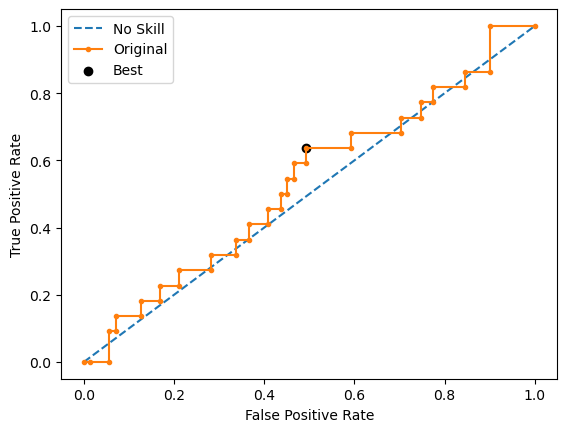

Run 4 - Random State: 3
Test G-mean: 0.404836319495406
Best Threshold=0.086641, G-Mean=0.555


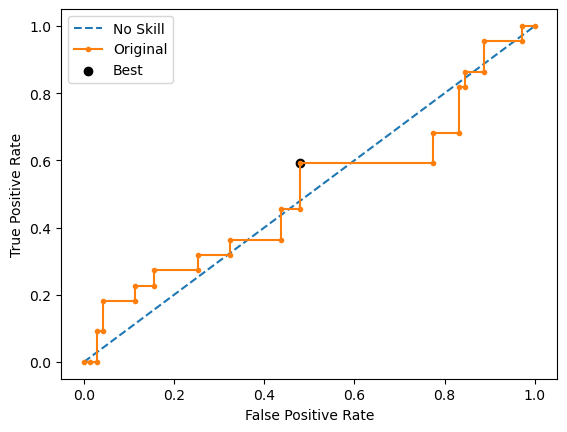

Run 5 - Random State: 4
Test G-mean: 0.35603449745815596
Best Threshold=0.082658, G-Mean=0.594


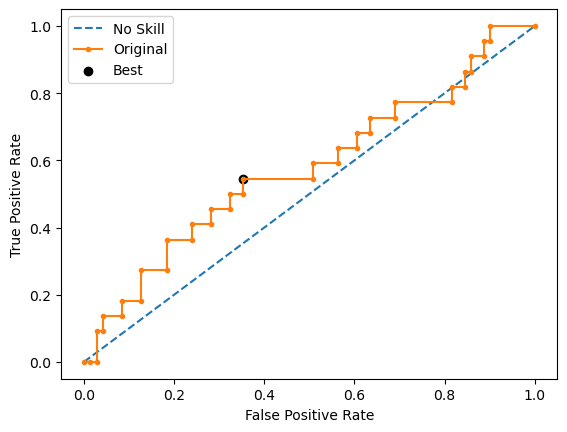

Ave Test G-mean: 0.383818175422564
Stdev Test G-mean: 0.06629361338505738
Ave Test Specificity: 0.8788732394366198
Ave Test Recall: 0.17272727272727273
Ave Test NPV: 0.7742846051227839
Ave Test Accuracy: 0.7118279569892474
Ave Test Precision: 0.30958110516934045
Ave Test F1-Score: 0.21806337806337805
Ave Runtime: 0.12399282455444335


In [72]:
ho_t06_xgb_gs, ho_t06_xgb_be, ho_t06_xgb_model_info, ho_t06_xgb_metrics_df = xgb_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 213, number of negative: 212
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001200 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1754
[LightGBM] [Info] Number of data points in the train set: 425, number of used features: 44
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.501176 -> initscore=0.004706
[LightGBM] [Info] Start training from score 

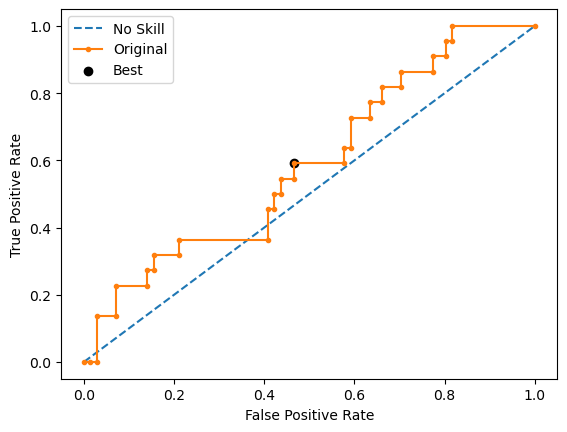

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 215, number of negative: 212
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000454 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1744
[LightGBM] [Info] Number of data points in the train set: 427, number of used features: 44
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.503513 -> initscore=0.014052
[LightGBM] [Info] Start training from score 0.014052
[LightGBM] [Warning] No further splits with positive gai

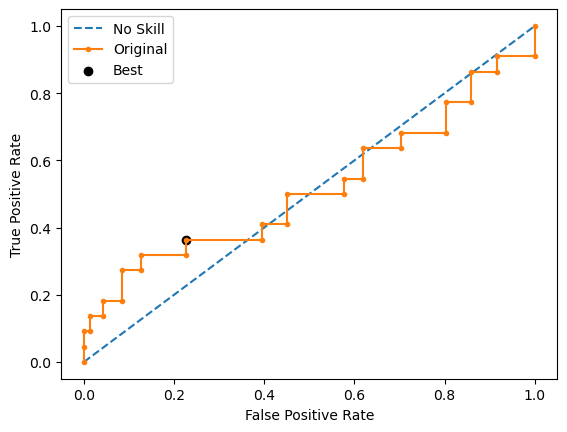

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 221, number of negative: 212
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000525 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1764
[LightGBM] [Info] Number of data points in the train set: 433, number of used features: 43
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.510393 -> initscore=0.041576
[LightGBM] [Info] Start training from score 0.041576
[LightGBM] [Warning] No further splits with positive gai

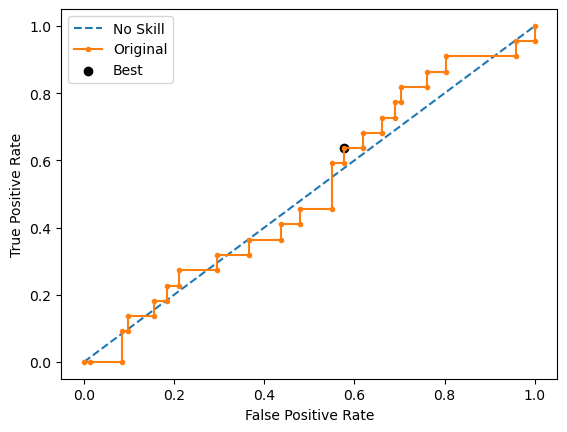

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 213, number of negative: 212
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000397 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1735
[LightGBM] [Info] Number of data points in the train set: 425, number of used features: 44
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.501176 -> initscore=0.004706
[LightGBM] [Info] Start training from score 0.004706
[LightGBM] [Warning] No further splits with positive gai

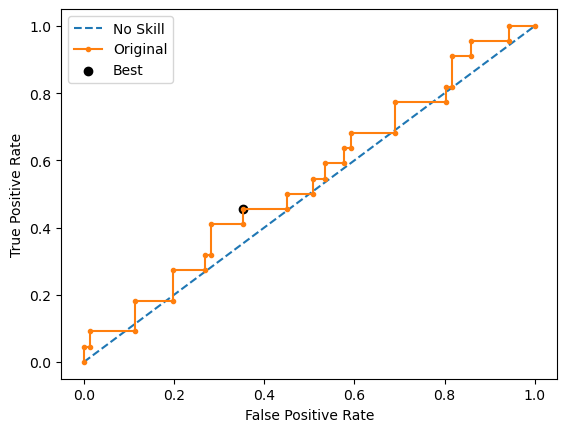

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 207, number of negative: 212
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000683 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1699
[LightGBM] [Info] Number of data points in the train set: 419, number of used features: 44
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.494033 -> initscore=-0.023867
[LightGBM] [Info] Start training from score -0.023867
[LightGBM] [Warning] No further splits with positive g

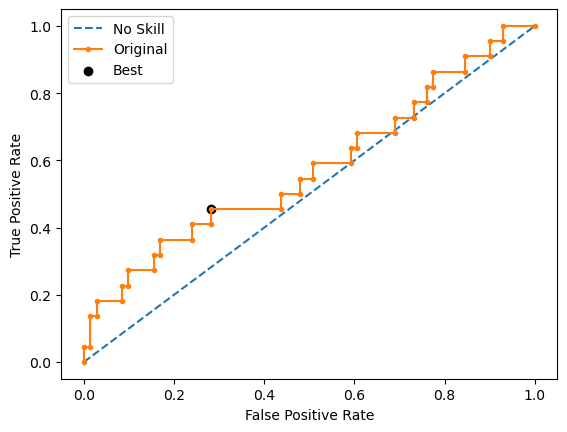

Ave Test G-mean: 0.46849306787832845
Stdev Test G-mean: 0.0503131299049562
Ave Test Specificity: 0.8450704225352113
Ave Test Recall: 0.2636363636363636
Ave Test NPV: 0.7871791705474219
Ave Test Accuracy: 0.70752688172043
Ave Test Precision: 0.36750000000000005
Ave Test F1-Score: 0.2984461152882205
Ave Runtime: 0.10479445457458496


In [73]:
ho_t06_lgbm_gs, ho_t06_lgbm_be, ho_t06_lgbm_model_info, ho_t06_lgbm_metrics_df = lgbm_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits
Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': DecisionTreeClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.3232936507936508
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=DecisionTreeClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.820307594045451
Std Train Score (G-mean) 0.01190134314439227
GridSearchCV Runtime: 9.419445991516113 secs
Run 1 - Random State: 0
Test G-mean: 0.468604597593796
Best Threshold=0.880797, G-Mean=0.469


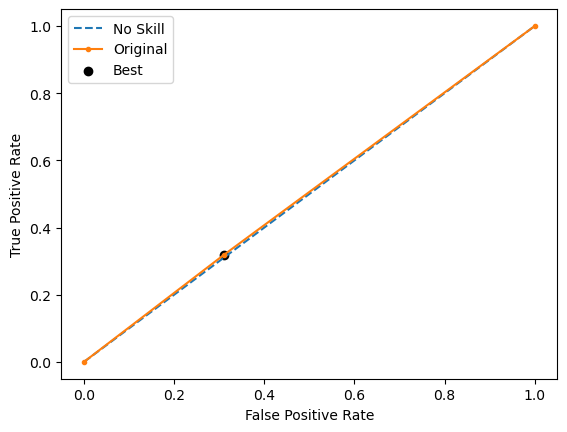

Run 2 - Random State: 1
Test G-mean: 0.5009593868751592
Best Threshold=0.880797, G-Mean=0.501


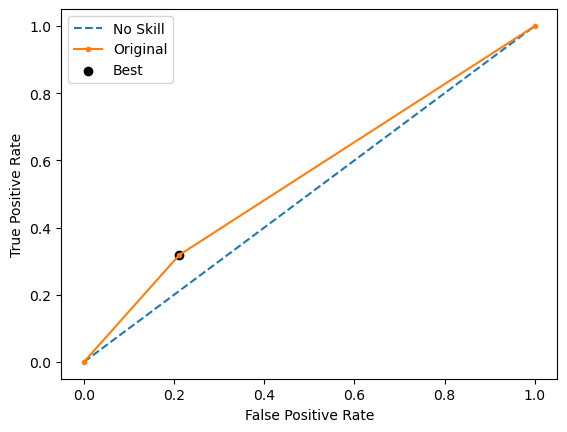

Run 3 - Random State: 2
Test G-mean: 0.6380989692001062
Best Threshold=0.880797, G-Mean=0.638


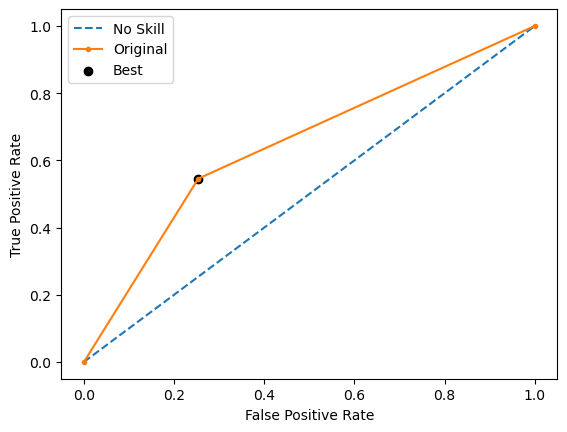

Run 4 - Random State: 3
Test G-mean: 0.40404484988306616
Best Threshold=0.880797, G-Mean=0.404


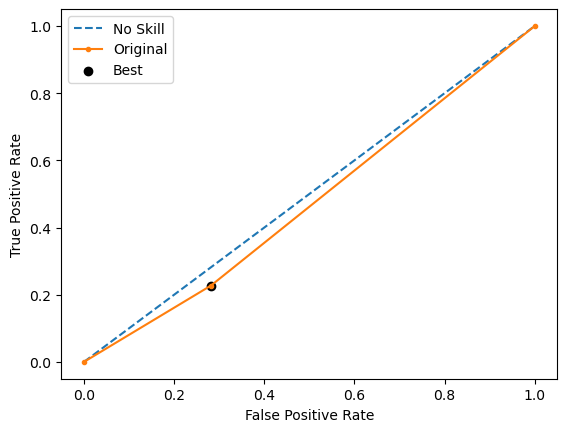

Run 5 - Random State: 4
Test G-mean: 0.4733621266482378
Best Threshold=0.880797, G-Mean=0.473


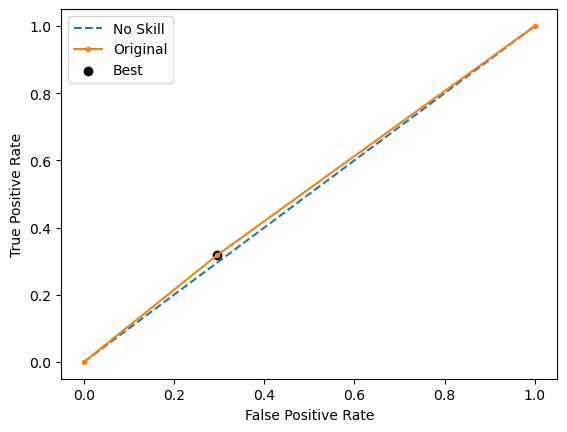

Ave Test G-mean: 0.4970139860400731
Stdev Test G-mean: 0.08650188255665167
Ave Test Specificity: 0.7295774647887323
Ave Test Recall: 0.3454545454545454
Ave Test NPV: 0.7829716009733615
Ave Test Accuracy: 0.6387096774193548
Ave Test Precision: 0.28191222570532914
Ave Test F1-Score: 0.30939920821773137
Ave Runtime: 0.034708595275878905


In [74]:
ho_t06_adaboost_gs, ho_t06_adaboost_be, ho_t06_adaboost_model_info, ho_t06_adaboost_metrics_df = adaboost_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits
Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': SMOTE(random_state=0)}
Best Validation Score (G-mean): 0.32591269841269843
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', SMOTE(random_state=0)),
                ('classifier',
                 RandomForestClassifier(max_depth=3, min_samples_leaf=2,
                                        n_estimators=300, oob_score=True,
                                        random_state=0))])
Mean Train Score (G-mean) 0.5644810639699774
Std Train Score (G-mean) 0.04137483754774697
GridSearchCV Runtime: 169.3568286895752 secs
Run 1 - Random State: 0
Test G-mean: 0.3542317795584802
Best Threshold=0.410382, G-Mean=0.491


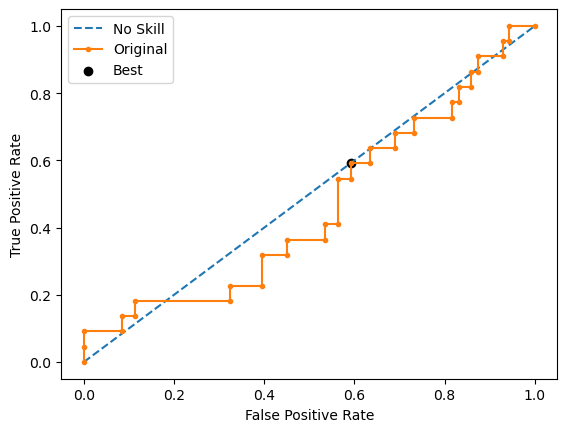

Run 2 - Random State: 1
Test G-mean: 0.44549243351898044
Best Threshold=0.418262, G-Mean=0.511


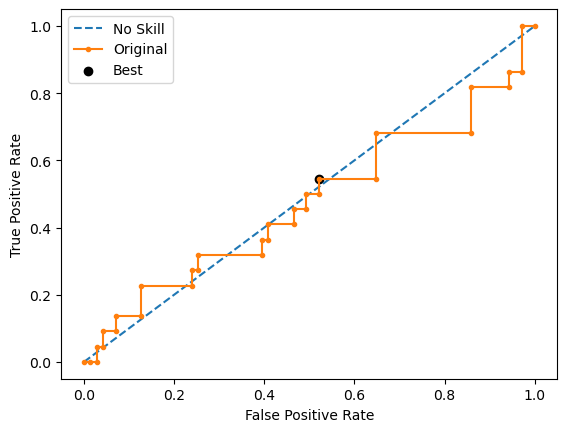

Run 3 - Random State: 2
Test G-mean: 0.39846054592409846
Best Threshold=0.444701, G-Mean=0.568


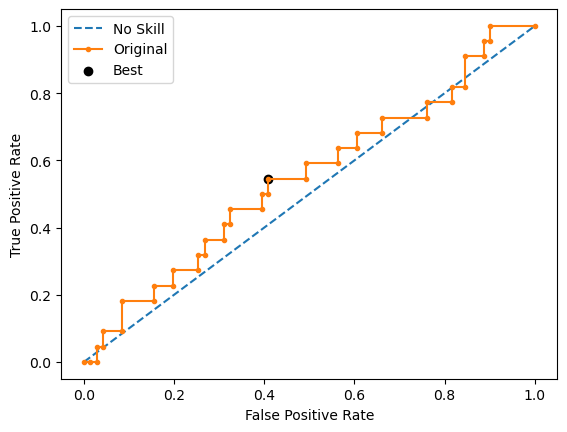

Run 4 - Random State: 3
Test G-mean: 0.4271514797864322
Best Threshold=0.449456, G-Mean=0.509


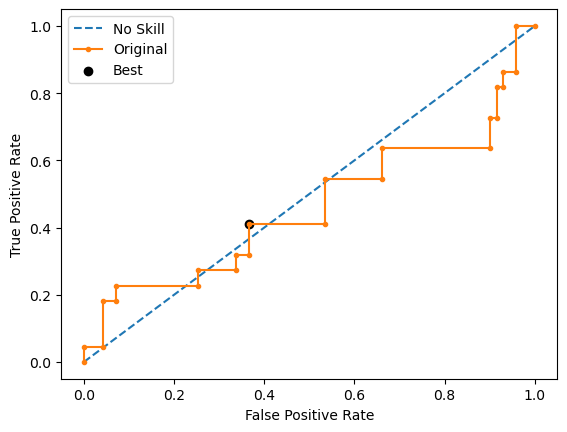

Run 5 - Random State: 4
Test G-mean: 0.3478487021540671
Best Threshold=0.379901, G-Mean=0.568


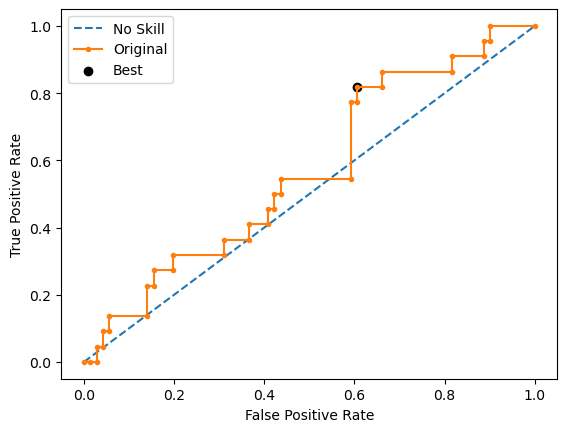

Ave Test G-mean: 0.39463698818841164
Stdev Test G-mean: 0.04324295512527526
Ave Test Specificity: 0.8253521126760563
Ave Test Recall: 0.1909090909090909
Ave Test NPV: 0.7659432726722935
Ave Test Accuracy: 0.675268817204301
Ave Test Precision: 0.2709132972290867
Ave Test F1-Score: 0.21974729877168903
Ave Runtime: 0.3751133918762207


In [75]:
ho_t06_rf_gs, ho_t06_rf_be, ho_t06_rf_model_info, ho_t06_rf_metrics_df = rf_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits
Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 200, 'resampling': SMOTE(random_state=0)}
Best Validation Score (G-mean): 0.2958333333333333
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', SMOTE(random_state=0)),
                ('classifier',
                 GradientBoostingClassifier(max_depth=2, min_samples_leaf=2,
                                            n_estimators=200,
                                            random_state=0))])
Mean Train Score (G-mean) 0.8054600107168577
Std Train Score (G-mean) 0.013800128955217289
GridSearchCV Runtime: 37.580371618270874 secs
Run 1 - Random State: 0
Test G-mean: 0.38870084675936434
Best Threshold=0.181998, G-Mean=0.474


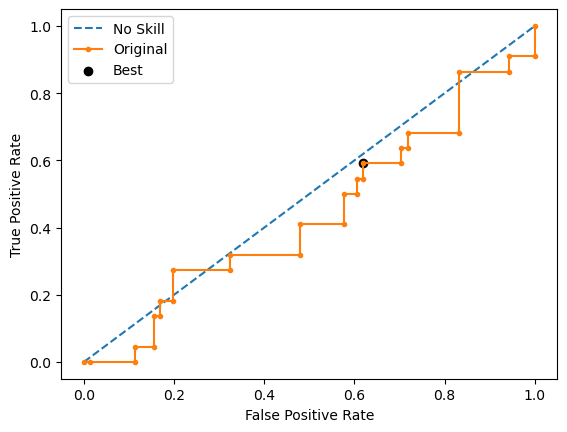

Run 2 - Random State: 1
Test G-mean: 0.4490707434808553
Best Threshold=0.399148, G-Mean=0.487


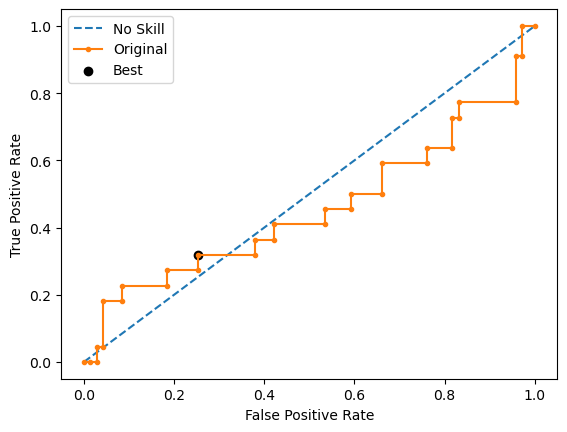

Run 3 - Random State: 2
Test G-mean: 0.3450769551760852
Best Threshold=0.188846, G-Mean=0.464


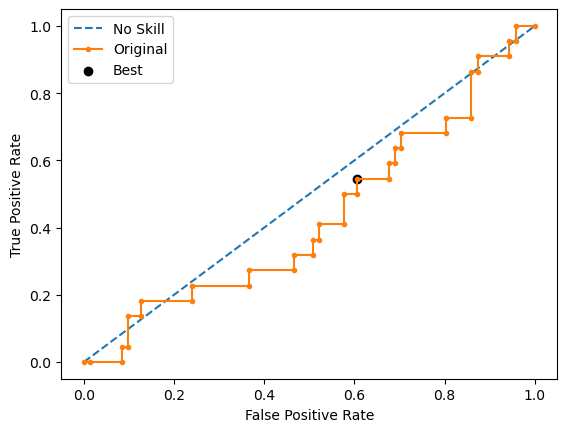

Run 4 - Random State: 3
Test G-mean: 0.33662480776613174
Best Threshold=0.185953, G-Mean=0.562


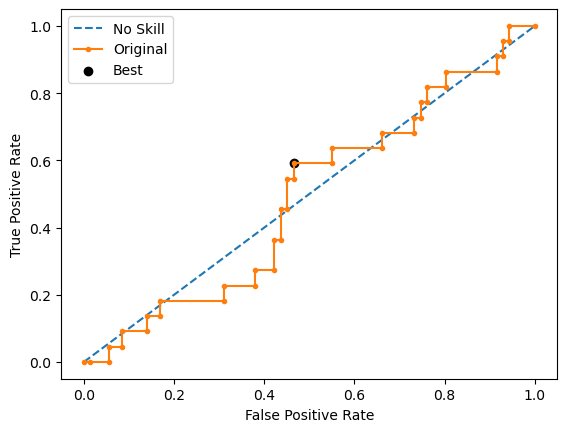

Run 5 - Random State: 4
Test G-mean: 0.2862625067858053
Best Threshold=0.120641, G-Mean=0.536


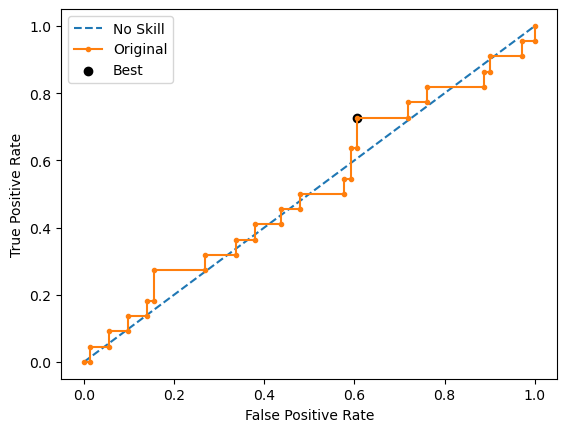

Ave Test G-mean: 0.36114717199364843
Stdev Test G-mean: 0.06114955174676684
Ave Test Specificity: 0.8647887323943662
Ave Test Recall: 0.15454545454545454
Ave Test NPV: 0.7674961766628433
Ave Test Accuracy: 0.696774193548387
Ave Test Precision: 0.26136752136752134
Ave Test F1-Score: 0.19278112199314634
Ave Runtime: 0.5352075576782227


In [76]:
ho_t06_gbm_gs, ho_t06_gbm_be, ho_t06_gbm_model_info, ho_t06_gbm_metrics_df = gbm_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
Learning rate set to 0.007149
0:	learn: 0.6909002	total: 2.21ms	remaining: 2.21s
1:	learn: 0.6880056	total: 3.96ms	remaining: 1.97s
2:	learn: 0.6850629	total: 5.72ms	remaining: 1.9s
3:	learn: 0.6817882	total: 7.57ms	remaining: 1.88s
4:	learn: 0.6789748	total: 9.54ms	remaining: 1.9s
5:	learn: 0.6759248	total: 11.5ms	remaining: 1.9s
6:	learn: 0.6729093	total: 13.4ms	remaining: 1.9s
7:	learn: 0.6700963	total: 15.2ms	remaining: 1.89s
8:	learn: 0.6676844	total: 17ms	remaining: 1.88s
9:	learn: 0.6652247	total: 18.9ms	remaining: 1.87s
10:	learn: 0.6628374	total: 20.7ms	remaining: 1.86s
11:	learn: 0.6604990	total: 22.3ms	remaining: 1.83s
12:	learn: 0.6578121	total: 24.1ms	remaining: 1.83s
13:	learn: 0.6557263	total: 34.2ms	remaining: 2.41s
14:	learn: 0.6531142	total: 36.1ms	remaining: 2.37s
15:	learn: 0.6507991	total: 37.9ms	remaining: 2.33s
16:	learn: 0.6480748	total: 39.7ms	remaining: 2.29s
17:	learn: 0.6456424	total: 41.6ms	remain

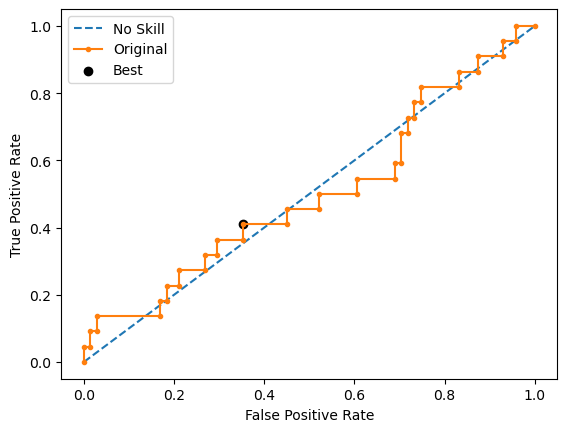

Learning rate set to 0.007164
0:	learn: 0.6900146	total: 2.44ms	remaining: 2.44s
1:	learn: 0.6876764	total: 4.82ms	remaining: 2.4s
2:	learn: 0.6847367	total: 7.25ms	remaining: 2.41s
3:	learn: 0.6813610	total: 9.18ms	remaining: 2.28s
4:	learn: 0.6786905	total: 11.1ms	remaining: 2.21s
5:	learn: 0.6758665	total: 12.8ms	remaining: 2.11s
6:	learn: 0.6734578	total: 14.6ms	remaining: 2.07s
7:	learn: 0.6706412	total: 16.2ms	remaining: 2s
8:	learn: 0.6685872	total: 17.9ms	remaining: 1.97s
9:	learn: 0.6653330	total: 19.5ms	remaining: 1.93s
10:	learn: 0.6627377	total: 21.7ms	remaining: 1.95s
11:	learn: 0.6601804	total: 23.8ms	remaining: 1.96s
12:	learn: 0.6574986	total: 25.6ms	remaining: 1.94s
13:	learn: 0.6554605	total: 27.5ms	remaining: 1.94s
14:	learn: 0.6532666	total: 29.1ms	remaining: 1.91s
15:	learn: 0.6509395	total: 31ms	remaining: 1.91s
16:	learn: 0.6484840	total: 32.9ms	remaining: 1.9s
17:	learn: 0.6459419	total: 34.6ms	remaining: 1.89s
18:	learn: 0.6437485	total: 37ms	remaining: 1.91s
1

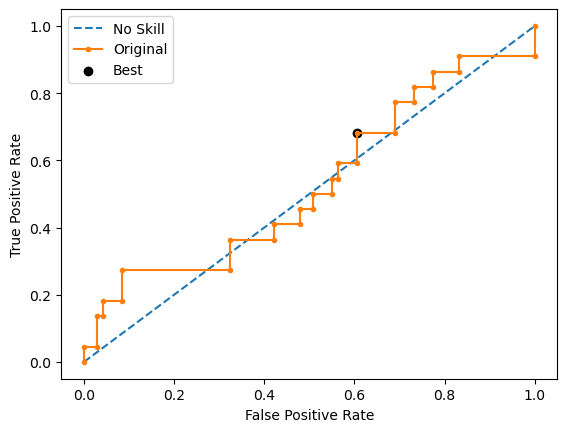

Learning rate set to 0.007206
0:	learn: 0.6912898	total: 2.6ms	remaining: 2.59s
1:	learn: 0.6885790	total: 4.14ms	remaining: 2.07s
2:	learn: 0.6857777	total: 5.64ms	remaining: 1.87s
3:	learn: 0.6831957	total: 7.36ms	remaining: 1.83s
4:	learn: 0.6804613	total: 8.86ms	remaining: 1.76s
5:	learn: 0.6774522	total: 10.3ms	remaining: 1.7s
6:	learn: 0.6751292	total: 11.7ms	remaining: 1.66s
7:	learn: 0.6729571	total: 13.1ms	remaining: 1.63s
8:	learn: 0.6702019	total: 14.7ms	remaining: 1.62s
9:	learn: 0.6674869	total: 16.2ms	remaining: 1.61s
10:	learn: 0.6648175	total: 18.1ms	remaining: 1.62s
11:	learn: 0.6628718	total: 19.6ms	remaining: 1.61s
12:	learn: 0.6608226	total: 21.9ms	remaining: 1.66s
13:	learn: 0.6583742	total: 24.2ms	remaining: 1.7s
14:	learn: 0.6565052	total: 26ms	remaining: 1.71s
15:	learn: 0.6548218	total: 27.8ms	remaining: 1.71s
16:	learn: 0.6521564	total: 29.6ms	remaining: 1.71s
17:	learn: 0.6494307	total: 31.4ms	remaining: 1.71s
18:	learn: 0.6470281	total: 33.3ms	remaining: 1.7

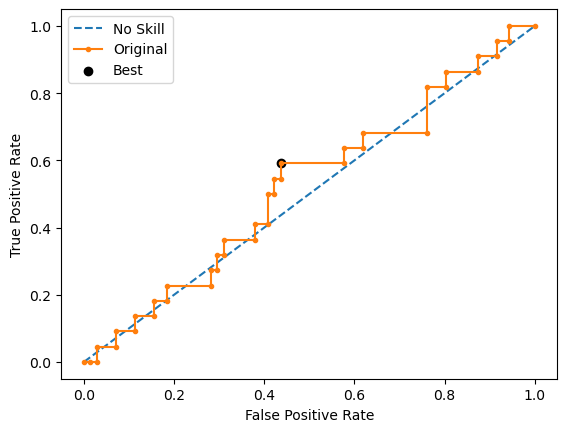

Learning rate set to 0.007149
0:	learn: 0.6902901	total: 1.86ms	remaining: 1.86s
1:	learn: 0.6870575	total: 3.26ms	remaining: 1.63s
2:	learn: 0.6840559	total: 4.55ms	remaining: 1.51s
3:	learn: 0.6808278	total: 6ms	remaining: 1.5s
4:	learn: 0.6781317	total: 7.7ms	remaining: 1.53s
5:	learn: 0.6757723	total: 9.31ms	remaining: 1.54s
6:	learn: 0.6732111	total: 10.9ms	remaining: 1.55s
7:	learn: 0.6710297	total: 13.1ms	remaining: 1.63s
8:	learn: 0.6674544	total: 14.9ms	remaining: 1.64s
9:	learn: 0.6643499	total: 16.7ms	remaining: 1.66s
10:	learn: 0.6609012	total: 18.2ms	remaining: 1.64s
11:	learn: 0.6579760	total: 20ms	remaining: 1.64s
12:	learn: 0.6554778	total: 21.3ms	remaining: 1.62s
13:	learn: 0.6532324	total: 22.8ms	remaining: 1.61s
14:	learn: 0.6507950	total: 24.6ms	remaining: 1.61s
15:	learn: 0.6483111	total: 26.3ms	remaining: 1.62s
16:	learn: 0.6452115	total: 27.9ms	remaining: 1.61s
17:	learn: 0.6418556	total: 30.3ms	remaining: 1.65s
18:	learn: 0.6386994	total: 32.7ms	remaining: 1.69s

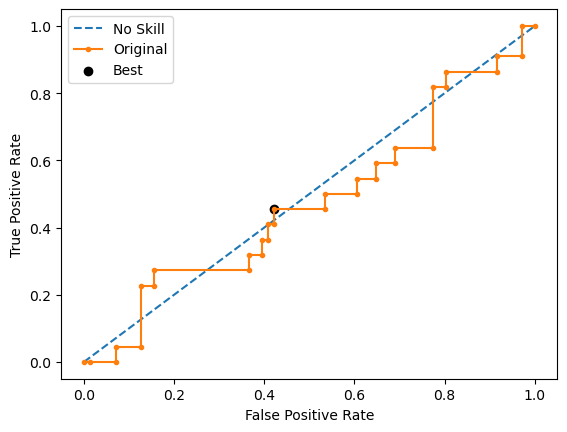

Learning rate set to 0.007106
0:	learn: 0.6905946	total: 1.85ms	remaining: 1.85s
1:	learn: 0.6883950	total: 4.3ms	remaining: 2.15s
2:	learn: 0.6850868	total: 5.94ms	remaining: 1.98s
3:	learn: 0.6822985	total: 7.39ms	remaining: 1.84s
4:	learn: 0.6792512	total: 8.69ms	remaining: 1.73s
5:	learn: 0.6762631	total: 10.5ms	remaining: 1.74s
6:	learn: 0.6743372	total: 12.4ms	remaining: 1.75s
7:	learn: 0.6716046	total: 14.3ms	remaining: 1.77s
8:	learn: 0.6684792	total: 16ms	remaining: 1.76s
9:	learn: 0.6659932	total: 17.8ms	remaining: 1.76s
10:	learn: 0.6635880	total: 20ms	remaining: 1.8s
11:	learn: 0.6615811	total: 21.4ms	remaining: 1.76s
12:	learn: 0.6598108	total: 23ms	remaining: 1.75s
13:	learn: 0.6574712	total: 24.5ms	remaining: 1.73s
14:	learn: 0.6557576	total: 26.2ms	remaining: 1.72s
15:	learn: 0.6529364	total: 27.9ms	remaining: 1.72s
16:	learn: 0.6504658	total: 30.3ms	remaining: 1.75s
17:	learn: 0.6473638	total: 32.5ms	remaining: 1.77s
18:	learn: 0.6444222	total: 34.6ms	remaining: 1.79s


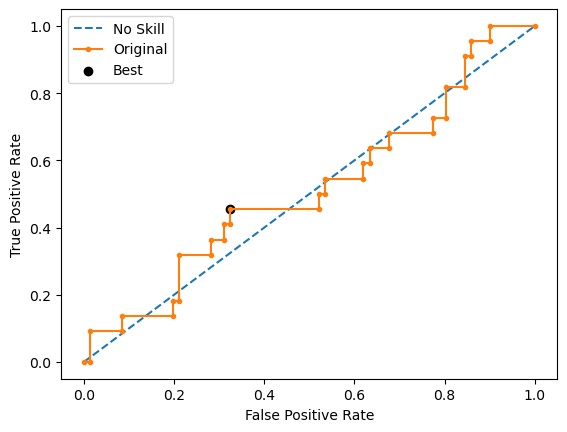

Ave Test G-mean: 0.3270466480938069
Stdev Test G-mean: 0.11075794242512844
Ave Test Specificity: 0.9154929577464788
Ave Test Recall: 0.12727272727272726
Ave Test NPV: 0.7721056412376882
Ave Test Accuracy: 0.729032258064516
Ave Test Precision: 0.33
Ave Test F1-Score: 0.17802413273001508
Ave Runtime: 1.920203399658203


In [77]:
ho_t06_catboost_gs, ho_t06_catboost_be, ho_t06_catboost_model_info, ho_t06_catboost_metrics_df = catboost_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

In [78]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost', 'catboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost', 'CatBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t06_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t06_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t06_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall', 'Average Test Precision', 'Average Test F1-score',
    'Average Test Accuracy'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall,Average Test Precision,Average Test F1-score,Average Test Accuracy
8,AdaBoost,0.497014,0.086502,0.323294,0.820308,0.729577,0.345455,0.281912,0.309399,0.638710
6,LightGBM,0.468493,0.050313,0.325000,0.659595,0.845070,0.263636,0.367500,0.298446,0.707527
3,Decision Tree,0.456862,0.053481,0.406789,NaN,0.667606,0.318182,0.234886,0.267173,0.584946
2,Logistic Regression,0.426753,0.080666,0.352857,NaN,0.901408,0.209091,0.397255,0.268859,0.737634
0,k-Nearest Neighbors,0.409767,0.100915,0.422857,0.508397,0.783099,0.227273,0.240958,0.230498,0.651613
4,Random Forest,0.394637,0.043243,0.325913,0.564481,0.825352,0.190909,0.270913,0.219747,0.675269
7,Extreme Gradient Boosting (XGBoost),0.383818,0.066294,0.336905,0.760099,0.878873,0.172727,0.309581,0.218063,0.711828
5,Gradient Boosting Machine (GBM),0.361147,0.061150,0.295833,0.805460,0.864789,0.154545,0.261368,0.192781,0.696774
9,CatBoost,0.327047,0.110758,0.275000,0.832459,0.915493,0.127273,0.330000,0.178024,0.729032
1,SVM Classifier,0.307369,0.064687,0.516667,0.343616,0.783099,0.281818,0.483283,0.221606,0.664516


In [79]:
best_scores_models = {
    'Best Score': [],
    'Best Model': []
}

indices = [
    'Highest Test Accuracy',
    'Highest Test G-mean',
    'Highest Test Recall',
    'Highest Test Precision',
    'Highest Test Specificity',
    'Highest Test F1-score'
]

# Corresponding column names in your original dataframe
columns = [
    'Average Test Accuracy',
    'Average Test G-mean',
    'Average Test Recall',
    'Average Test Precision',
    'Average Test Specificity',
    'Average Test F1-score'
]

df = ho_t06_summ
# Finding the best model for each metric
for col in columns:
    best_score = df[col].max()
    best_model = df.loc[df[col] == best_score, 'Classifier model'].values[0]
    
    best_scores_models['Best Score'].append(best_score)
    best_scores_models['Best Model'].append(best_model)

# Creating the new dataframe
best_df = pd.DataFrame(best_scores_models, index=indices)

# Displaying the new dataframe
best_df

,Best Score,Best Model
Highest Test Accuracy,0.737634,Logistic Regression
Highest Test G-mean,0.497014,AdaBoost
Highest Test Recall,0.345455,AdaBoost
Highest Test Precision,0.483283,SVM Classifier
Highest Test Specificity,0.915493,CatBoost
Highest Test F1-score,0.309399,AdaBoost


# HO-T06 Runs: StandardScaler

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits
Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 2, 'classifier__max_features': None, 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': RandomOverSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5861334092522169
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(criterion='entropy', max_depth=2,
                                        random_state=0))])
Mean Train Score (G-mean) 0.5045626356168336
Std Train Score (G-mean) 0.04940561535709203
GridSearchCV Runtime: 45.98888087272644 secs
Run 1 - Random State: 0
Test G-mean: 0.656661815518841
Best Threshold=0.534946, G-Mean=0.657


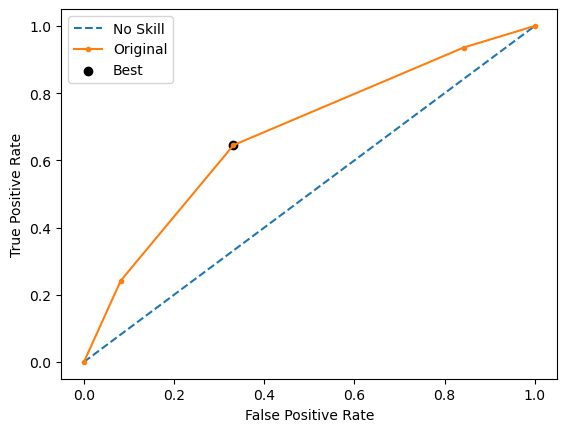

Run 2 - Random State: 1
Test G-mean: 0.6201838798020258
Best Threshold=0.544959, G-Mean=0.620


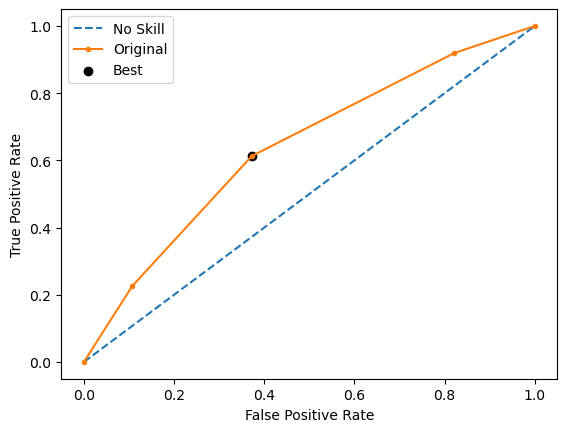

Run 3 - Random State: 2
Test G-mean: 0.6389409646336904
Best Threshold=0.544160, G-Mean=0.639


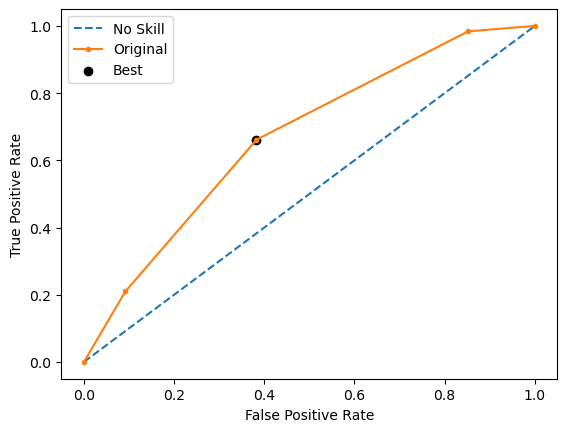

Run 4 - Random State: 3
Test G-mean: 0.5849494838167749
Best Threshold=0.627750, G-Mean=0.598


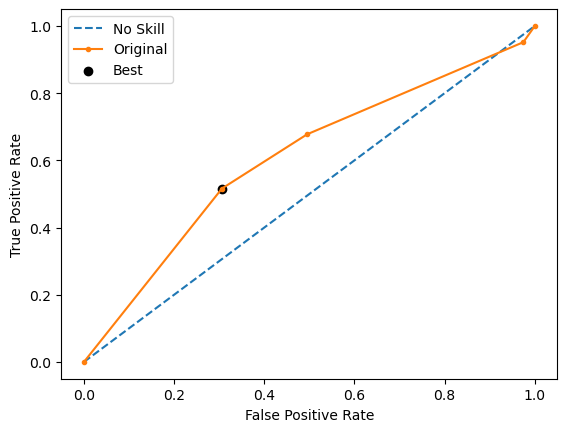

Run 5 - Random State: 4
Test G-mean: 0.5550652506880571
Best Threshold=0.665988, G-Mean=0.578


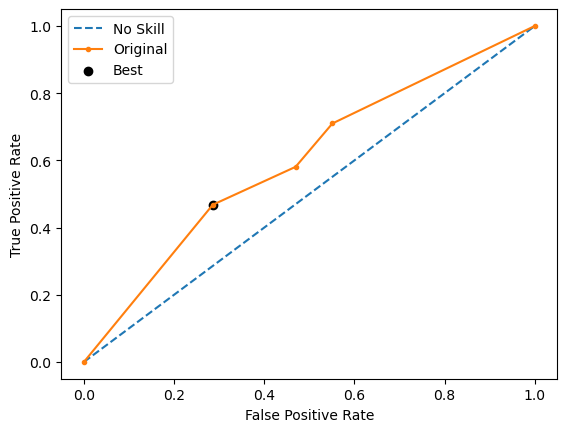

Ave Test G-mean: 0.6111602788918779
Stdev Test G-mean: 0.041101215543893344
Ave Test Specificity: 0.5897959183673469
Ave Test Recall: 0.635483870967742
Ave Test NPV: 0.835397858673986
Ave Test Accuracy: 0.6007751937984496
Ave Test Precision: 0.3320302545076174
Ave Test F1-Score: 0.435176049606957
Ave Runtime: 0.01431121826171875


In [218]:
ho_t06_dt_gs, ho_t06_dt_be, ho_t06_dt_model_info, ho_t06_dt_metrics_df = dt_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits
Best Hyperparameters: {'classifier__C': 0.0001, 'classifier__penalty': 'l2', 'classifier__solver': 'newton-cholesky', 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5511833423722067
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 LogisticRegression(C=0.0001, max_iter=1000, random_state=0,
                                    solver='newton-cholesky'))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 10.8058762550354 secs
Run 1 - Random State: 0
Test G-mean: 0.5659297639246875
Best Threshold=0.499760, G-Mean=0.608



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\linear_model\_logistic.py", line 1216, in fit
    self.coef_, self.intercept_, self.n_iter_ = _fit_liblinear(
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\

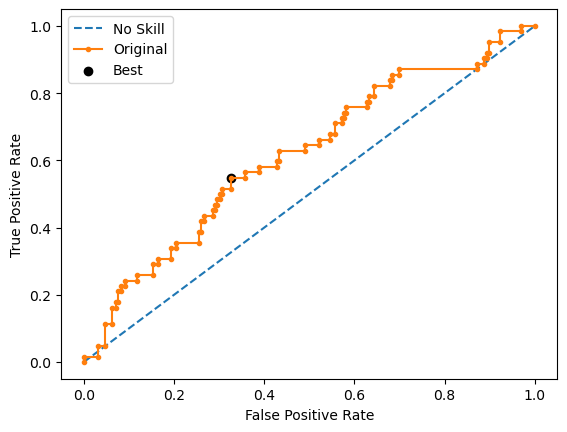

Run 2 - Random State: 1
Test G-mean: 0.5654933702621115
Best Threshold=0.499058, G-Mean=0.611


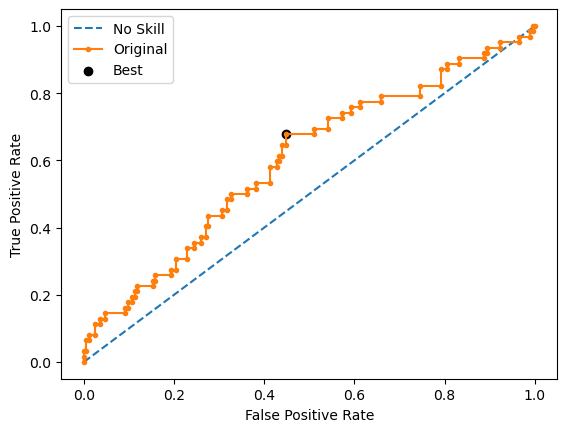

Run 3 - Random State: 2
Test G-mean: 0.5301942953139067
Best Threshold=0.499201, G-Mean=0.573


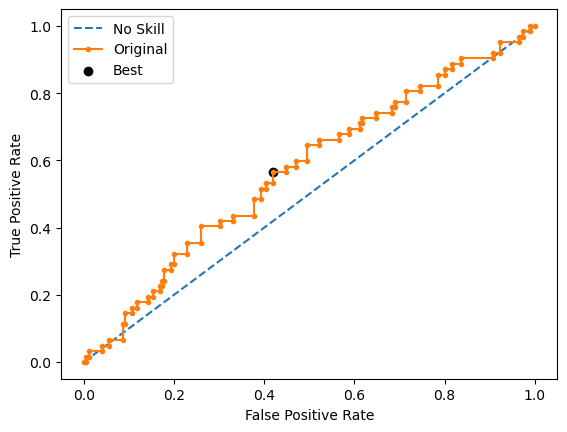

Run 4 - Random State: 3
Test G-mean: 0.5483532112057258
Best Threshold=0.498981, G-Mean=0.594


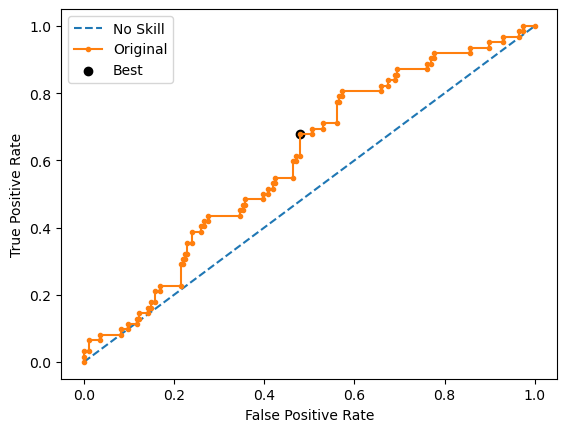

Run 5 - Random State: 4
Test G-mean: 0.5253607807660214
Best Threshold=0.498774, G-Mean=0.565


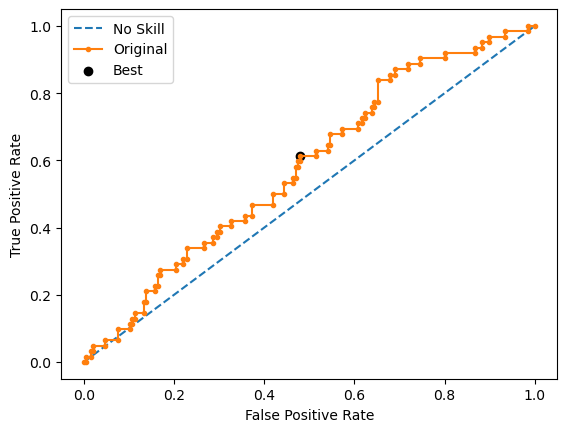

Ave Test G-mean: 0.5470662842944906
Stdev Test G-mean: 0.019058052349841127
Ave Test Specificity: 0.6632653061224489
Ave Test Recall: 0.4516129032258064
Ave Test NPV: 0.7924371423462934
Ave Test Accuracy: 0.6124031007751938
Ave Test Precision: 0.29902041454223616
Ave Test F1-Score: 0.3594466162158999
Ave Runtime: 0.02246723175048828


In [219]:
ho_t06_logreg_gs, ho_t06_logreg_be, ho_t06_logreg_model_info, ho_t06_logreg_metrics_df = logreg_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]Best Hyperparameters: {'classifier__C': 1e-06, 'classifier__kernel': 'rbf', 'classifier__probability': True, 'resampling': RandomOverSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5836024379939667
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 SVC(C=1e-06, max_iter=1000, probability=True, random_state=0,
                     verbose=True))])
Mean Train Score (G-mean) 0.5219879195852732
Std Train Score (G-mean) 0.020408923537523802
GridSearchCV Runtime: 95.23027992248535 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.585792958636764
Best Threshold=0.486451, G-Mean=0.421


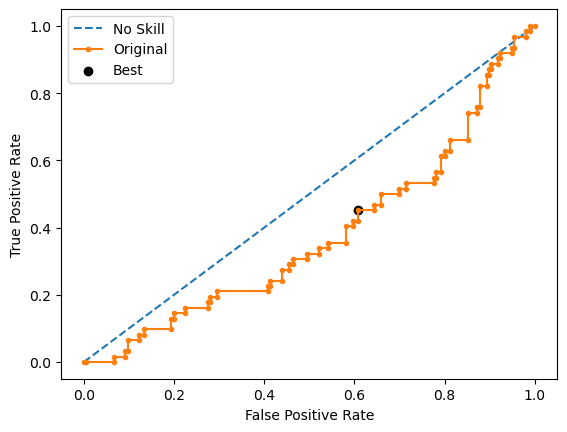

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.5745880397335743
Best Threshold=0.486451, G-Mean=0.432


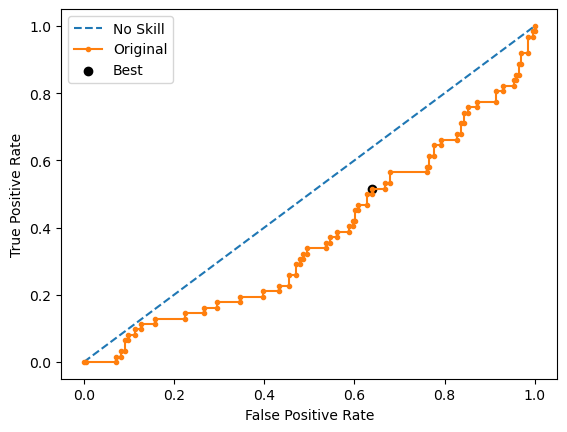

[LibSVM]Run 3 - Random State: 2
Test G-mean: 0.6000192009216492
Best Threshold=0.486451, G-Mean=0.416


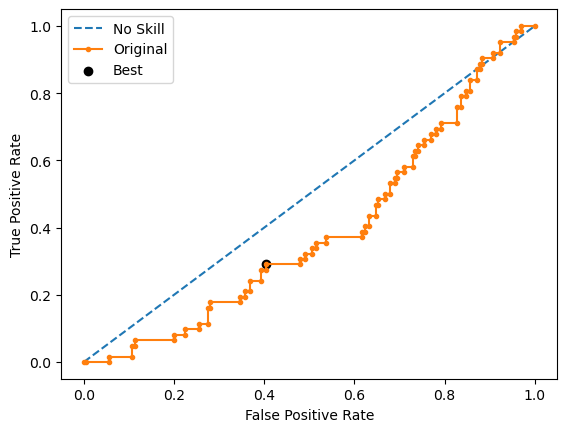

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.5868455973269637
Best Threshold=0.486451, G-Mean=0.429


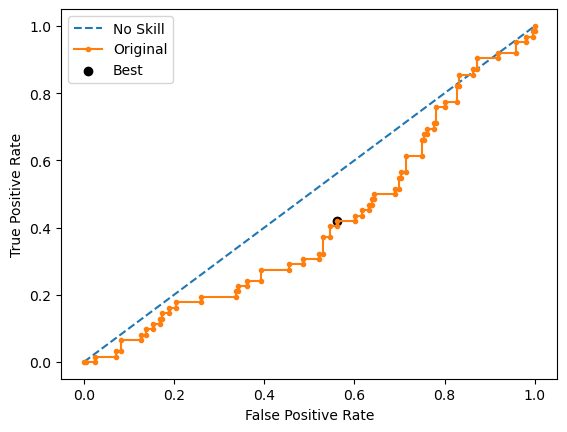

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.5479028183484553
Best Threshold=0.486451, G-Mean=0.468


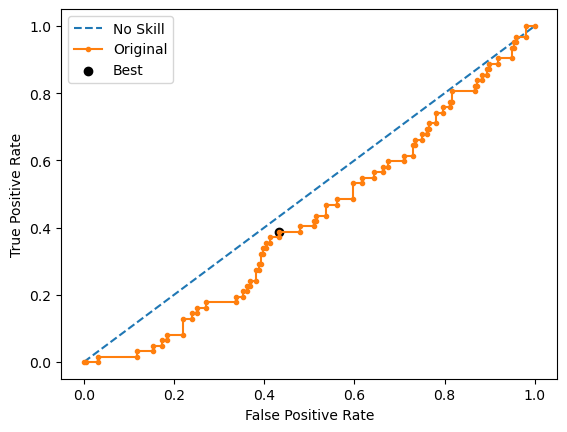

Ave Test G-mean: 0.5790297229934813
Stdev Test G-mean: 0.019595919056159893
Ave Test Specificity: 0.6438775510204081
Ave Test Recall: 0.5225806451612903
Ave Test NPV: 0.8096745549851413
Ave Test Accuracy: 0.6147286821705427
Ave Test Precision: 0.3192491940297407
Ave Test F1-Score: 0.3952779188719943
Ave Runtime: 0.5335601806640625


In [222]:
ho_t06_svm_gs, ho_t06_svm_be, ho_t06_svm_model_info, ho_t06_svm_metrics_df = svm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [223]:
ho_t06_knn_gs, ho_t06_knn_be, ho_t06_knn_model_info, ho_t06_knn_metrics_df = knn_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
Best Hyperparameters: {'classifier__metric': 'canberra', 'classifier__n_neighbors': 1, 'resampling': EditedNearestNeighbours(), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5619438248924814
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 KNeighborsClassifier(metric='canberra', n_neighbors=1))])
Mean Train Score (G-mean) 0.6926051073868732
Std Train Score (G-mean) 0.01508746870546176
GridSearchCV Runtime: 63.536158084869385 secs
Run 1 - Random State: 0
Test G-mean: 0.5439837932759934
Run 2 - Random State: 1
Test G-mean: 0.5794369699170472
Run 3 - Random State: 2
Test G-mean: 0.47657434604418136
Run 4 - Random State: 3
Test G-mean: 0.509133174976598
Run 5 - Random State: 4
Test G-mean: 0.4968631026001803
Ave Test G-mean: 0.5211982773628001
Stdev Test G-mean: 0.040743059895226606
Ave Test 

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 2, 'classifier__max_leaves': 10, 'classifier__n_estimators': 250, 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5695273785971662
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_

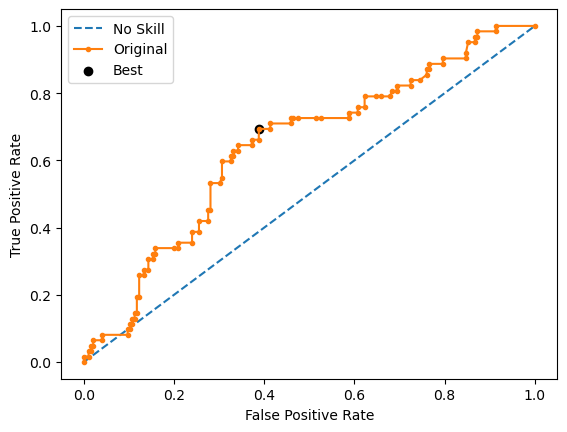

Run 2 - Random State: 1
Test G-mean: 0.6326636793264705
Best Threshold=0.493293, G-Mean=0.636


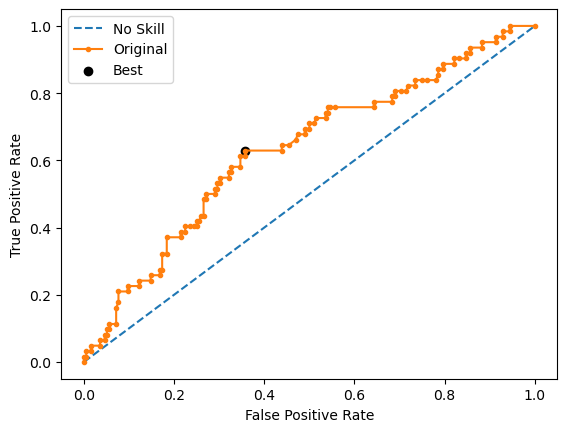

Run 3 - Random State: 2
Test G-mean: 0.5476774830239554
Best Threshold=0.458993, G-Mean=0.564


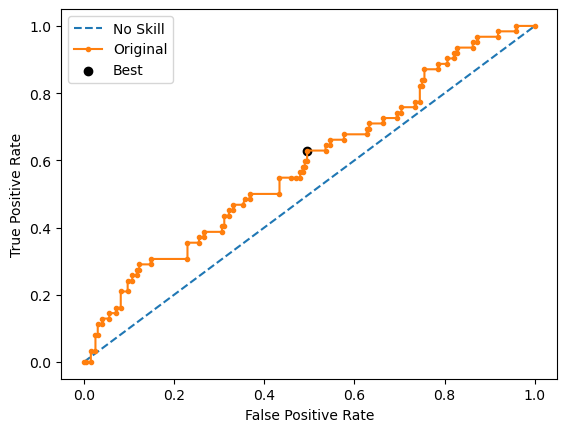

Run 4 - Random State: 3
Test G-mean: 0.6048683337050778
Best Threshold=0.481042, G-Mean=0.614


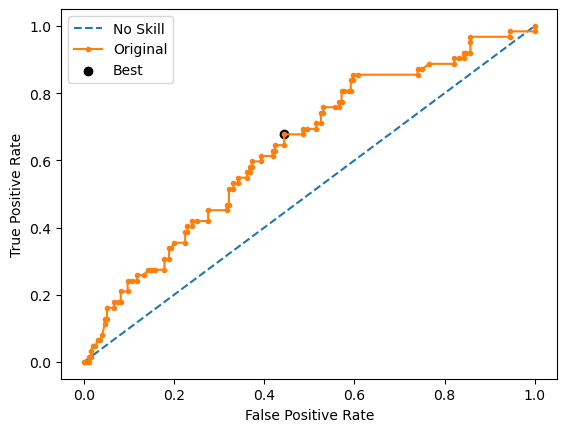

Run 5 - Random State: 4
Test G-mean: 0.5745880397335743
Best Threshold=0.543877, G-Mean=0.611


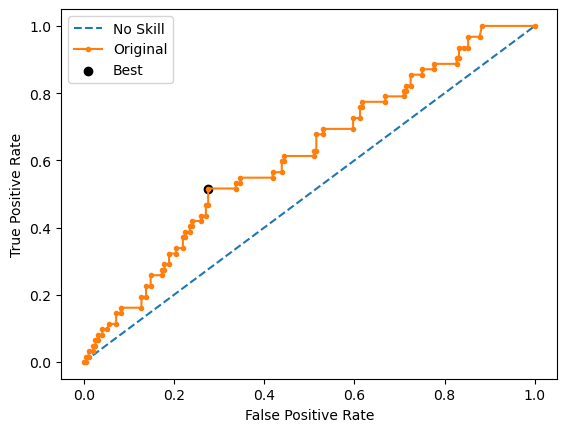

Ave Test G-mean: 0.5987521174719939
Stdev Test G-mean: 0.03748243903978868
Ave Test Specificity: 0.6428571428571429
Ave Test Recall: 0.5612903225806452
Ave Test NPV: 0.8229987307103309
Ave Test Accuracy: 0.6232558139534884
Ave Test Precision: 0.3320006269754075
Ave Test F1-Score: 0.4163508571460087
Ave Runtime: 0.19665169715881348


In [224]:
ho_t06_xgb_gs, ho_t06_xgb_be, ho_t06_xgb_model_info, ho_t06_xgb_metrics_df = xgb_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
Best Hyperparameters: {'classifier__boosting_type': 'goss', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 3, 'classifier__n_estimators': 300, 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.577998778688951
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 LGBMClassifier(boosting_type='goss', learning_rate=0.01,
                                max_depth=3, n_estimators=300,
                                random_state=0))])
Mean Train Score (G-mean) 0.7598671718538652
Std Train Score (G-mean) 0.016532797612759057
GridSearchCV Runtime: 35.78956937789917 secs
Run 1 - Random State: 0
Test G-mean: 0.6109598099719176
Best Threshold=0.489740, G-Mean=0.626


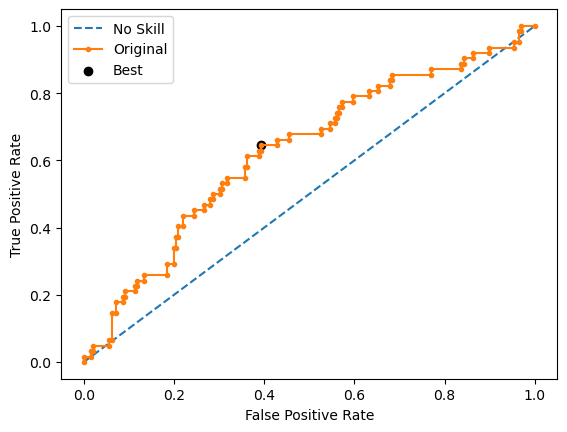

Run 2 - Random State: 1
Test G-mean: 0.6036426620632479
Best Threshold=0.542979, G-Mean=0.621


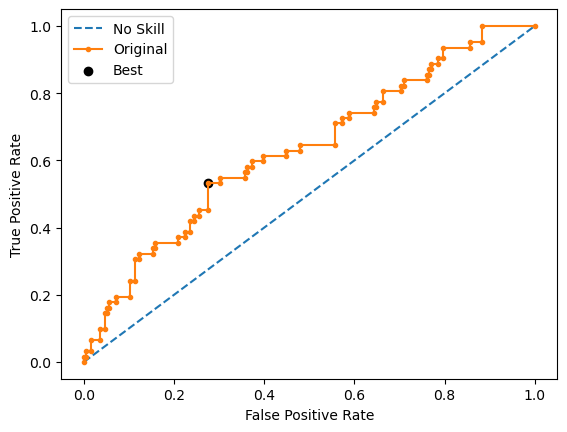

Run 3 - Random State: 2
Test G-mean: 0.6085305366932837
Best Threshold=0.503764, G-Mean=0.618


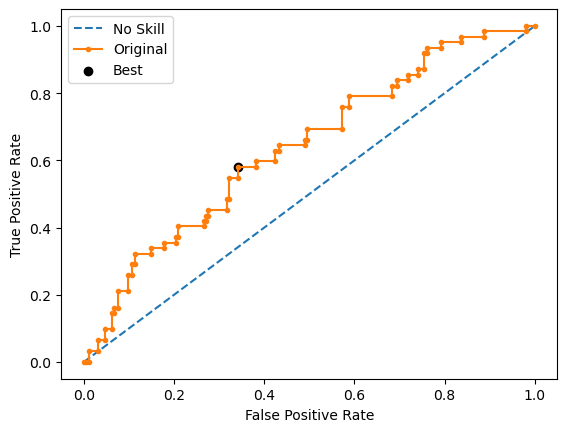

Run 4 - Random State: 3
Test G-mean: 0.5730104831718916
Best Threshold=0.472611, G-Mean=0.591


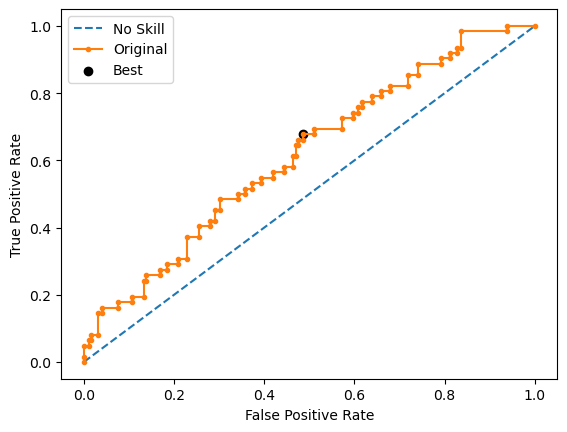

Run 5 - Random State: 4
Test G-mean: 0.5572846327942754
Best Threshold=0.554358, G-Mean=0.588


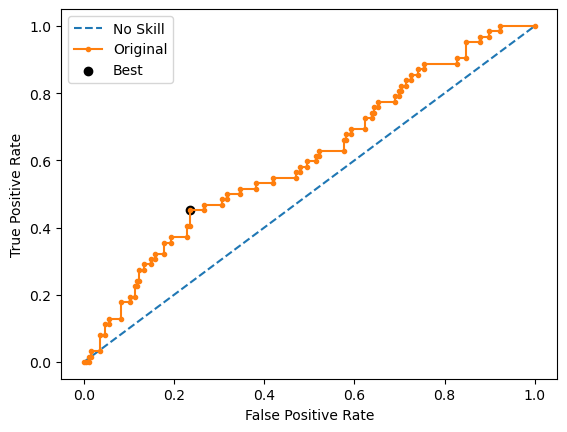

Ave Test G-mean: 0.5906856249389232
Stdev Test G-mean: 0.02411122756127123
Ave Test Specificity: 0.6112244897959184
Ave Test Recall: 0.5709677419354839
Ave Test NPV: 0.8178674166078368
Ave Test Accuracy: 0.6015503875968993
Ave Test Precision: 0.3182412107715316
Ave Test F1-Score: 0.40848232467154577
Ave Runtime: 0.3433506011962891


In [225]:
ho_t06_lgbm_gs, ho_t06_lgbm_be, ho_t06_lgbm_model_info, ho_t06_lgbm_metrics_df = lgbm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits
Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5708017601192481
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.9476864629106763
Std Train Score (G-mean) 0.0038326194544914087
GridSearchCV Runtime: 10.719450235366821 secs
Run 1 - Random State: 0
Test G-mean: 0.5937462102716796
Best Threshold=0.731059, G-Mean=0.594


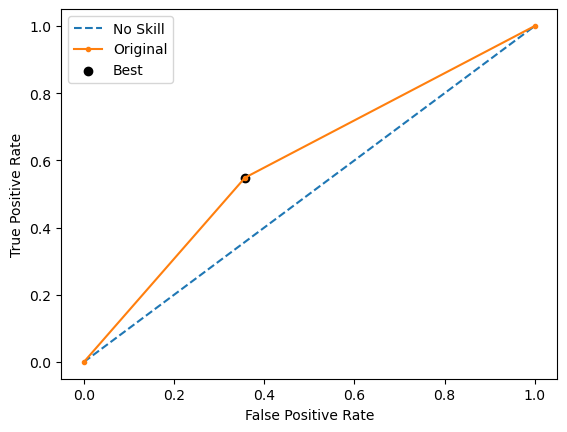

Run 2 - Random State: 1
Test G-mean: 0.5514956622112163
Best Threshold=0.731059, G-Mean=0.551


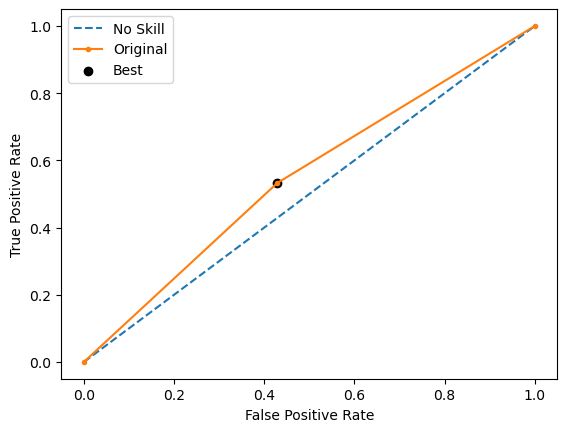

Run 3 - Random State: 2
Test G-mean: 0.5514956622112163
Best Threshold=0.731059, G-Mean=0.551


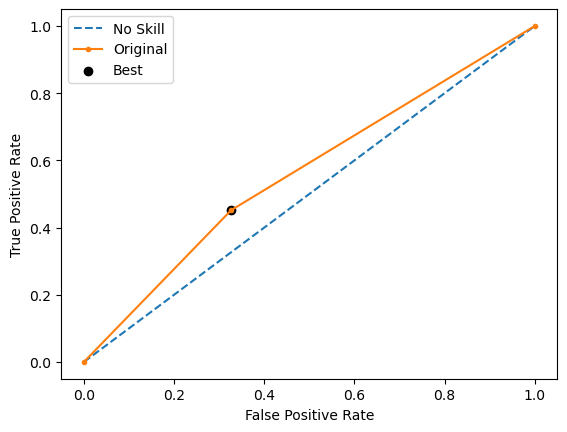

Run 4 - Random State: 3
Test G-mean: 0.6017310994101656
Best Threshold=0.731059, G-Mean=0.602


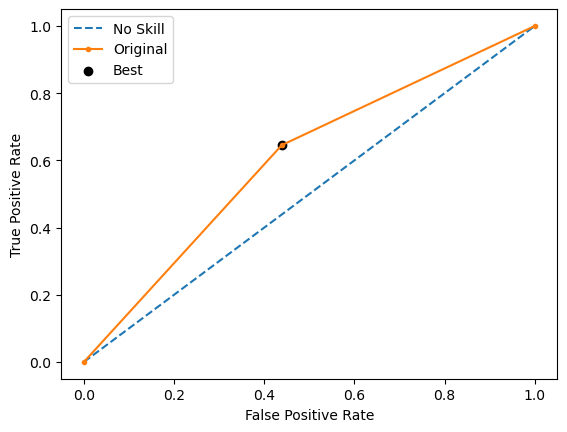

Run 5 - Random State: 4
Test G-mean: 0.5514956622112163
Best Threshold=0.731059, G-Mean=0.551


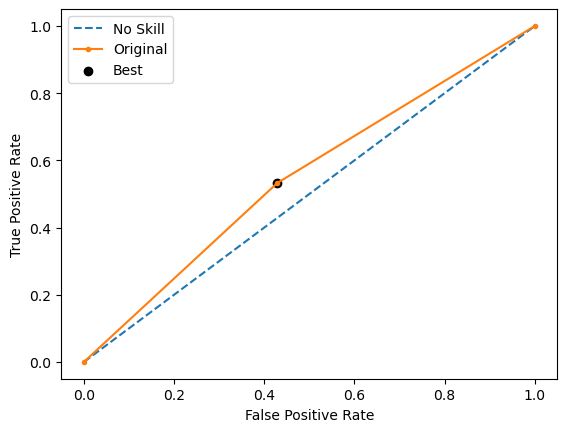

Ave Test G-mean: 0.5699928592630987
Stdev Test G-mean: 0.025485174455446857
Ave Test Specificity: 0.6040816326530611
Ave Test Recall: 0.5419354838709677
Ave Test NPV: 0.8070696713352443
Ave Test Accuracy: 0.5891472868217054
Ave Test Precision: 0.302566756914583
Ave Test F1-Score: 0.38724740006892266
Ave Runtime: 0.2264254570007324


In [226]:
ho_t06_adaboost_gs, ho_t06_adaboost_be, ho_t06_adaboost_model_info, ho_t06_adaboost_metrics_df = adaboost_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits
Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5680904738623496
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 GradientBoostingClassifier(min_samples_leaf=2,
                                            n_estimators=200,
                                            random_state=0))])
Mean Train Score (G-mean) 0.8771095131586388
Std Train Score (G-mean) 0.010527366294144738
GridSearchCV Runtime: 88.82423067092896 secs
Run 1 - Random State: 0
Test G-mean: 0.5597892954492245
Best Threshold=0.555999, G-Mean=0.580


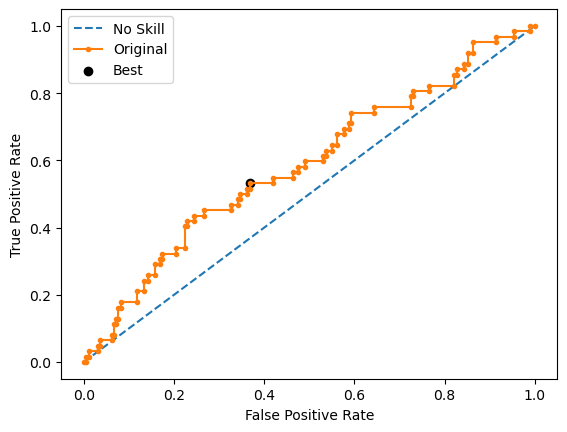

Run 2 - Random State: 1
Test G-mean: 0.5968564788564029
Best Threshold=0.521194, G-Mean=0.613


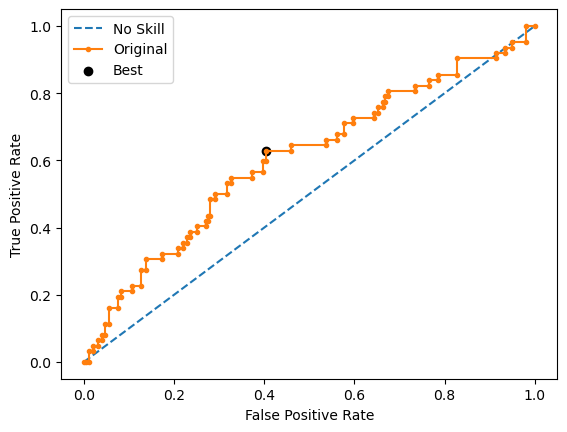

Run 3 - Random State: 2
Test G-mean: 0.48300613958372834
Best Threshold=0.295774, G-Mean=0.528


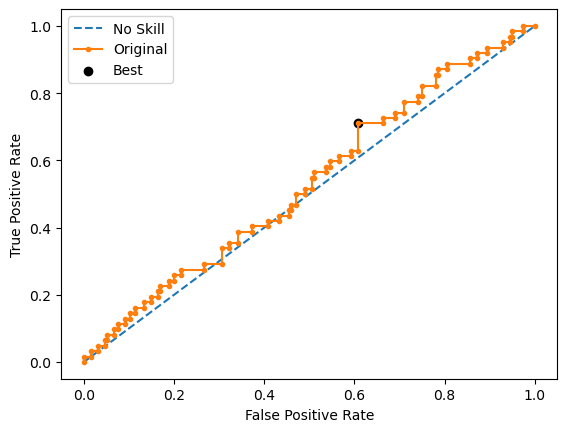

Run 4 - Random State: 3
Test G-mean: 0.5365201312326561
Best Threshold=0.446577, G-Mean=0.552


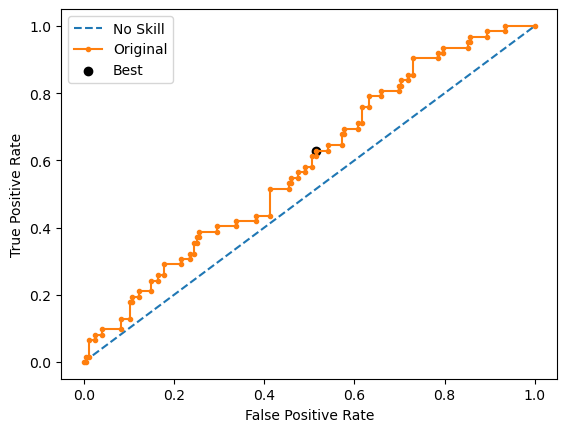

Run 5 - Random State: 4
Test G-mean: 0.568251536808238
Best Threshold=0.634908, G-Mean=0.582


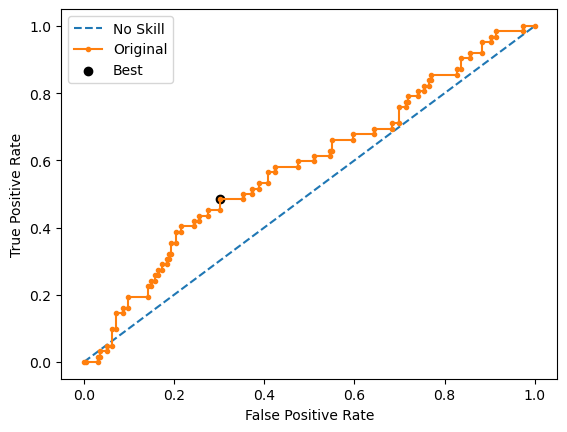

Ave Test G-mean: 0.54888471638605
Stdev Test G-mean: 0.04268531193466081
Ave Test Specificity: 0.5846938775510204
Ave Test Recall: 0.5258064516129031
Ave Test NPV: 0.7975992512186542
Ave Test Accuracy: 0.5705426356589147
Ave Test Precision: 0.2839449785968609
Ave Test F1-Score: 0.36694904582001353
Ave Runtime: 0.39573121070861816


In [228]:
ho_t06_gbm_gs, ho_t06_gbm_be, ho_t06_gbm_model_info, ho_t06_gbm_metrics_df = gbm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits
Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5767544617781283
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 RandomForestClassifier(criterion='entropy', max_depth=3,
                                        min_samples_leaf=3, n_estimators=300,
                                        oob_score=True, random_state=0))])
Mean Train Score (G-mean) 0.619682586626071
Std Train Score (G-mean) 0.02081374722807044
GridSearchCV Runtime: 357.49217915534973 secs
Run 1 - Random State: 0
Test G-mean: 0.6347413981520182
Best 

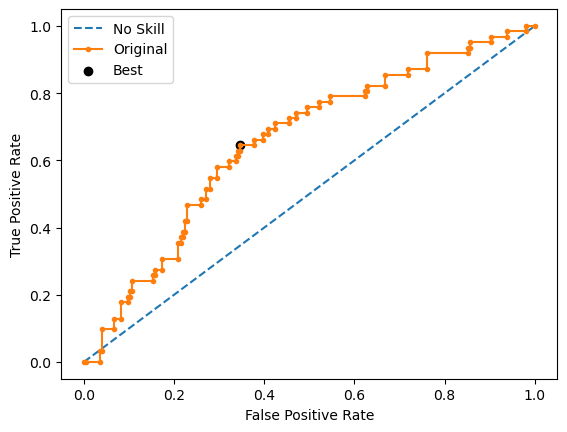

Run 2 - Random State: 1
Test G-mean: 0.6242836579493493
Best Threshold=0.500755, G-Mean=0.624


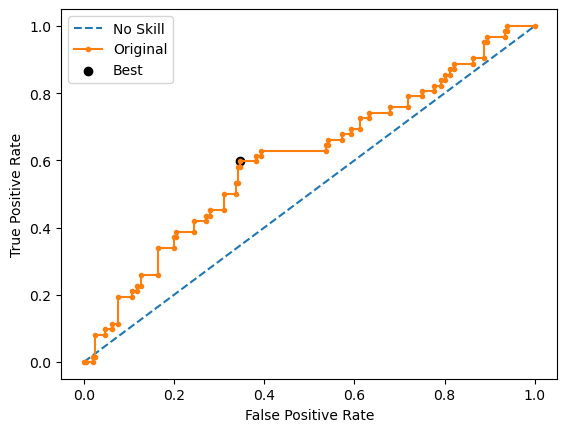

Run 3 - Random State: 2
Test G-mean: 0.5555098364627279
Best Threshold=0.483924, G-Mean=0.589


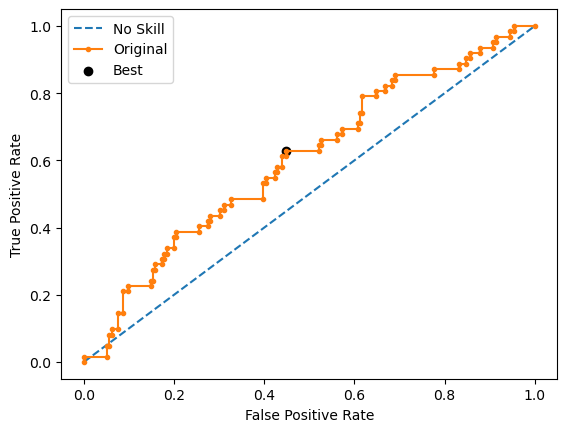

Run 4 - Random State: 3
Test G-mean: 0.591246215124694
Best Threshold=0.465005, G-Mean=0.621


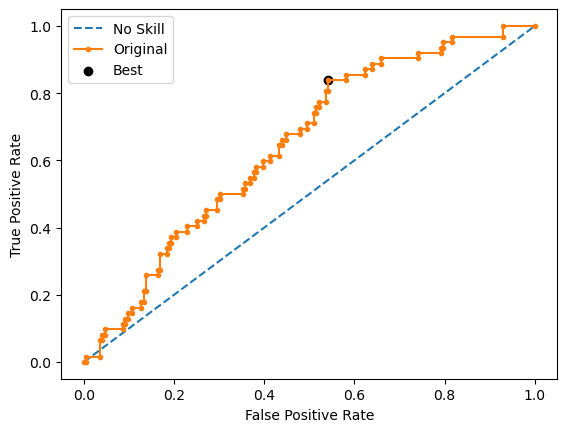

Run 5 - Random State: 4
Test G-mean: 0.6019362000578568
Best Threshold=0.509206, G-Mean=0.623


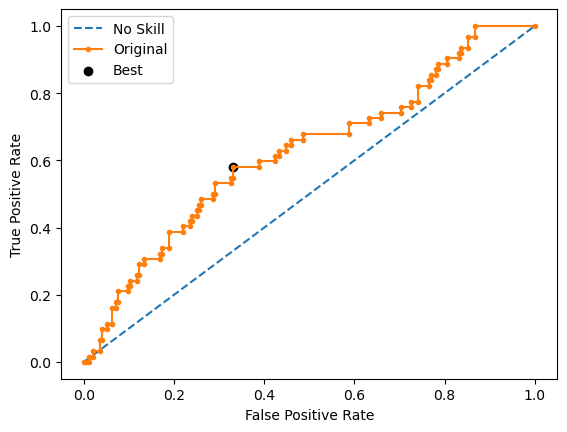

Ave Test G-mean: 0.6015434615493291
Stdev Test G-mean: 0.031002022889914615
Ave Test Specificity: 0.6387755102040816
Ave Test Recall: 0.567741935483871
Ave Test NPV: 0.8236238314622852
Ave Test Accuracy: 0.6217054263565892
Ave Test Precision: 0.33295230650884633
Ave Test F1-Score: 0.4192907178082785
Ave Runtime: 0.5530432224273681


In [227]:
ho_t06_rf_gs, ho_t06_rf_be, ho_t06_rf_model_info, ho_t06_rf_metrics_df = rf_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
Learning rate set to 0.006754
0:	learn: 0.6918734	total: 2.08ms	remaining: 2.08s
1:	learn: 0.6904773	total: 4.3ms	remaining: 2.15s
2:	learn: 0.6892748	total: 6.39ms	remaining: 2.13s
3:	learn: 0.6883518	total: 9.02ms	remaining: 2.25s
4:	learn: 0.6874894	total: 11.3ms	remaining: 2.25s
5:	learn: 0.6864793	total: 13.7ms	remaining: 2.26s
6:	learn: 0.6849713	total: 15.7ms	remaining: 2.23s
7:	learn: 0.6835259	total: 17.8ms	remaining: 2.2s
8:	learn: 0.6820508	total: 19.8ms	remaining: 2.19s
9:	learn: 0.6808529	total: 21.9ms	remaining: 2.17s
10:	learn: 0.6794658	total: 23.9ms	remaining: 2.15s
11:	learn: 0.6782565	total: 26.2ms	remaining: 2.15s
12:	learn: 0.6770542	total: 28.4ms	remaining: 2.15s
13:	learn: 0.6758270	total: 30.5ms	remaining: 2.15s
14:	learn: 0.6747007	total: 32.6ms	remaining: 2.14s
15:	learn: 0.6735646	total: 34.5ms	remaining: 2.12s
16:	learn: 0.6724274	total: 36.5ms	remaining: 2.11s
17:	learn: 0.6714028	total: 38.5ms	re

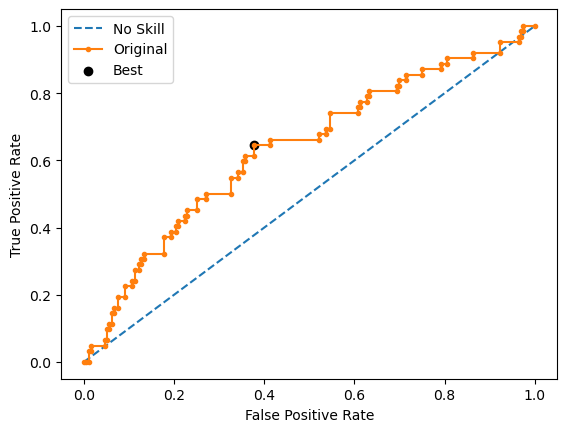

Learning rate set to 0.006754
0:	learn: 0.6909056	total: 4.65ms	remaining: 4.64s
1:	learn: 0.6892966	total: 6.37ms	remaining: 3.18s
2:	learn: 0.6879854	total: 8.06ms	remaining: 2.68s
3:	learn: 0.6869652	total: 10ms	remaining: 2.49s
4:	learn: 0.6857235	total: 12.1ms	remaining: 2.4s
5:	learn: 0.6845124	total: 13.8ms	remaining: 2.29s
6:	learn: 0.6829168	total: 15.5ms	remaining: 2.21s
7:	learn: 0.6809996	total: 17.3ms	remaining: 2.15s
8:	learn: 0.6789838	total: 19.2ms	remaining: 2.12s
9:	learn: 0.6771489	total: 20.9ms	remaining: 2.07s
10:	learn: 0.6755326	total: 22.7ms	remaining: 2.04s
11:	learn: 0.6742410	total: 24.4ms	remaining: 2.01s
12:	learn: 0.6725502	total: 26.4ms	remaining: 2.01s
13:	learn: 0.6705914	total: 28.2ms	remaining: 1.99s
14:	learn: 0.6692993	total: 30.3ms	remaining: 1.99s
15:	learn: 0.6680835	total: 32.1ms	remaining: 1.97s
16:	learn: 0.6669018	total: 33.8ms	remaining: 1.95s
17:	learn: 0.6658209	total: 35.8ms	remaining: 1.95s
18:	learn: 0.6646626	total: 37.4ms	remaining: 1

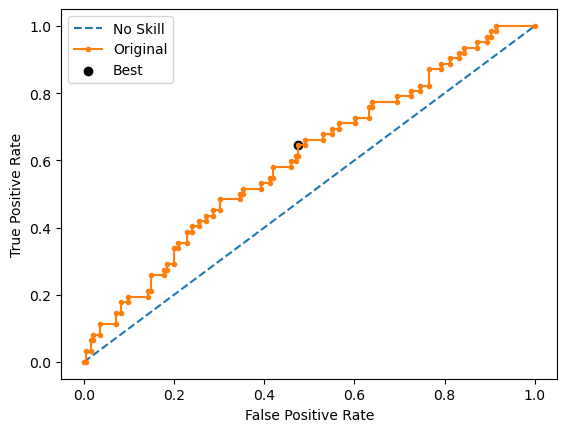

Learning rate set to 0.006754
0:	learn: 0.6912841	total: 3.81ms	remaining: 3.81s
1:	learn: 0.6900261	total: 7.11ms	remaining: 3.55s
2:	learn: 0.6889845	total: 10.3ms	remaining: 3.41s
3:	learn: 0.6882180	total: 13.2ms	remaining: 3.29s
4:	learn: 0.6870207	total: 15.7ms	remaining: 3.12s
5:	learn: 0.6858179	total: 18.8ms	remaining: 3.12s
6:	learn: 0.6851150	total: 21.4ms	remaining: 3.04s
7:	learn: 0.6832779	total: 23.8ms	remaining: 2.95s
8:	learn: 0.6823443	total: 25.8ms	remaining: 2.84s
9:	learn: 0.6812690	total: 27.5ms	remaining: 2.72s
10:	learn: 0.6800280	total: 29.5ms	remaining: 2.65s
11:	learn: 0.6792044	total: 31.4ms	remaining: 2.59s
12:	learn: 0.6783522	total: 33.3ms	remaining: 2.52s
13:	learn: 0.6772651	total: 35.5ms	remaining: 2.5s
14:	learn: 0.6763484	total: 37.2ms	remaining: 2.44s
15:	learn: 0.6753359	total: 39ms	remaining: 2.4s
16:	learn: 0.6745798	total: 41ms	remaining: 2.37s
17:	learn: 0.6740406	total: 42.8ms	remaining: 2.34s
18:	learn: 0.6730462	total: 44.7ms	remaining: 2.31

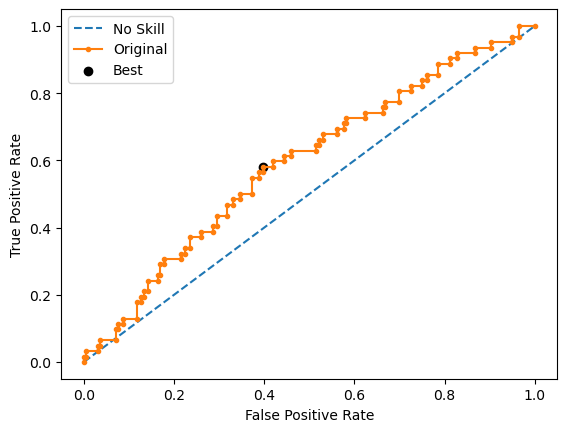

Learning rate set to 0.006754
0:	learn: 0.6916853	total: 4.3ms	remaining: 4.29s
1:	learn: 0.6903289	total: 9.16ms	remaining: 4.57s
2:	learn: 0.6890073	total: 11.5ms	remaining: 3.84s
3:	learn: 0.6876582	total: 14.8ms	remaining: 3.69s
4:	learn: 0.6870475	total: 17.5ms	remaining: 3.49s
5:	learn: 0.6853816	total: 19.5ms	remaining: 3.23s
6:	learn: 0.6842847	total: 21.4ms	remaining: 3.03s
7:	learn: 0.6824566	total: 24.3ms	remaining: 3.02s
8:	learn: 0.6813194	total: 27.5ms	remaining: 3.03s
9:	learn: 0.6800294	total: 30.8ms	remaining: 3.04s
10:	learn: 0.6789221	total: 32.9ms	remaining: 2.95s
11:	learn: 0.6774388	total: 34.8ms	remaining: 2.87s
12:	learn: 0.6757157	total: 36.6ms	remaining: 2.77s
13:	learn: 0.6746996	total: 38.4ms	remaining: 2.7s
14:	learn: 0.6730859	total: 40.6ms	remaining: 2.66s
15:	learn: 0.6718456	total: 42.6ms	remaining: 2.62s
16:	learn: 0.6709146	total: 44.5ms	remaining: 2.57s
17:	learn: 0.6697991	total: 46.6ms	remaining: 2.54s
18:	learn: 0.6687022	total: 48.2ms	remaining: 

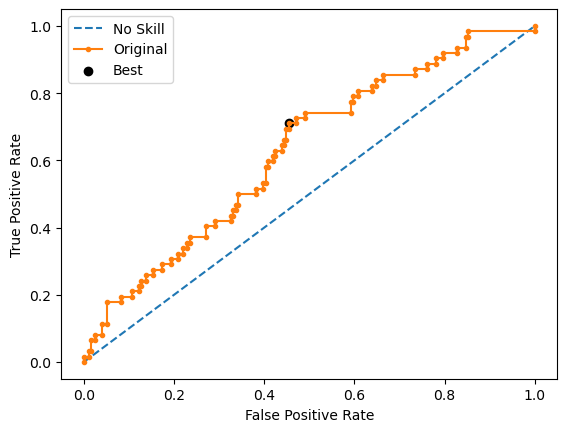

Learning rate set to 0.006754
0:	learn: 0.6921356	total: 7.1ms	remaining: 7.09s
1:	learn: 0.6914337	total: 12.6ms	remaining: 6.31s
2:	learn: 0.6905395	total: 18.7ms	remaining: 6.22s
3:	learn: 0.6893376	total: 24.1ms	remaining: 5.99s
4:	learn: 0.6886264	total: 29.6ms	remaining: 5.89s
5:	learn: 0.6873547	total: 36.1ms	remaining: 5.99s
6:	learn: 0.6865741	total: 41.9ms	remaining: 5.94s
7:	learn: 0.6851301	total: 48.2ms	remaining: 5.98s
8:	learn: 0.6836135	total: 54.3ms	remaining: 5.98s
9:	learn: 0.6819828	total: 59.6ms	remaining: 5.9s
10:	learn: 0.6807787	total: 65.1ms	remaining: 5.86s
11:	learn: 0.6794977	total: 70.6ms	remaining: 5.82s
12:	learn: 0.6787670	total: 75.5ms	remaining: 5.73s
13:	learn: 0.6780396	total: 78.3ms	remaining: 5.51s
14:	learn: 0.6766027	total: 82.7ms	remaining: 5.43s
15:	learn: 0.6753885	total: 85.8ms	remaining: 5.28s
16:	learn: 0.6744288	total: 88.7ms	remaining: 5.13s
17:	learn: 0.6732602	total: 91.9ms	remaining: 5.01s
18:	learn: 0.6727781	total: 93.8ms	remaining: 

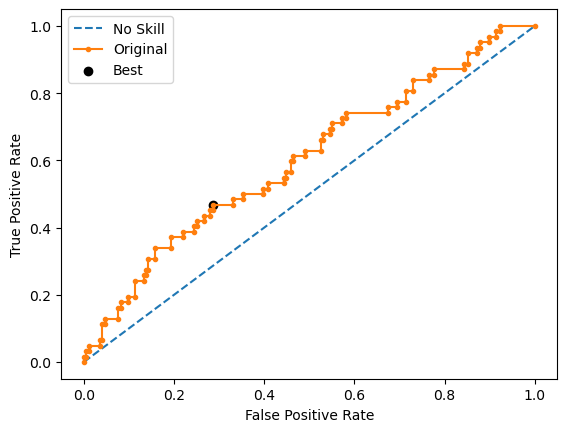

Ave Test G-mean: 0.5780613563062795
Stdev Test G-mean: 0.021632265673870815
Ave Test Specificity: 0.6091836734693878
Ave Test Recall: 0.5516129032258064
Ave Test NPV: 0.8112190842702608
Ave Test Accuracy: 0.5953488372093023
Ave Test Precision: 0.30989017763489235
Ave Test F1-Score: 0.3958123097316304
Ave Runtime: 2.033609962463379


In [250]:
ho_t06_catboost_gs, ho_t06_catboost_be, ho_t06_catboost_model_info, ho_t06_catboost_metrics_df = catboost_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [249]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t06_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t06_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t06_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall
3,Decision Tree,0.611160,0.041101,0.586133,0.504563,0.589796,0.635484
4,Random Forest,0.601543,0.031002,0.576754,0.619683,0.638776,0.567742
7,Extreme Gradient Boosting (XGBoost),0.598752,0.037482,0.569527,0.864548,0.642857,0.561290
6,LightGBM,0.590686,0.024111,0.577999,0.759867,0.611224,0.570968
1,SVM Classifier,0.579030,0.019596,0.583602,0.521988,0.643878,0.522581
8,AdaBoost,0.569993,0.025485,0.570802,0.947686,0.604082,0.541935
5,Gradient Boosting Machine (GBM),0.548885,0.042685,0.568090,0.877110,0.584694,0.525806
2,Logistic Regression,0.547066,0.019058,0.551183,NaN,0.663265,0.451613
0,k-Nearest Neighbors,0.521198,0.040743,0.561944,0.692605,0.601020,0.454839


# HO-T07 Runs: RobustScaler

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits
Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 2, 'classifier__max_features': None, 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.594305156716838
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(max_depth=2, random_state=0))])
Mean Train Score (G-mean) 0.5046837575262252
Std Train Score (G-mean) 0.06523744177119856
GridSearchCV Runtime: 109.23559808731079 secs
Run 1 - Random State: 0
Test G-mean: 0.6469481077995503
Best Threshold=0.571125, G-Mean=0.647


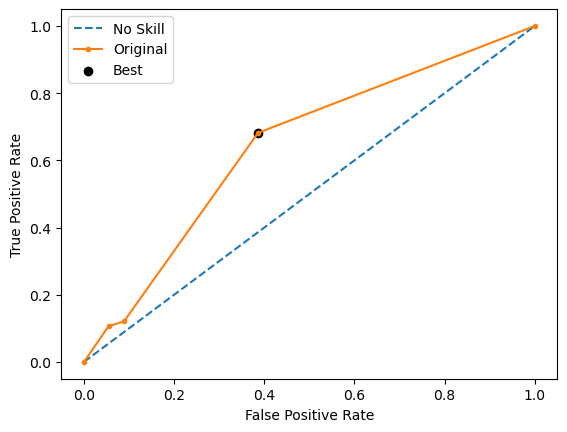

Run 2 - Random State: 1
Test G-mean: 0.6221243475949056
Best Threshold=0.549689, G-Mean=0.622


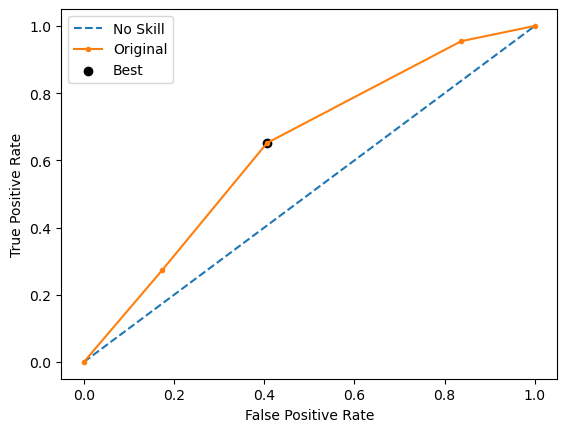

Run 3 - Random State: 2
Test G-mean: 0.5872686680292462
Best Threshold=0.575309, G-Mean=0.587


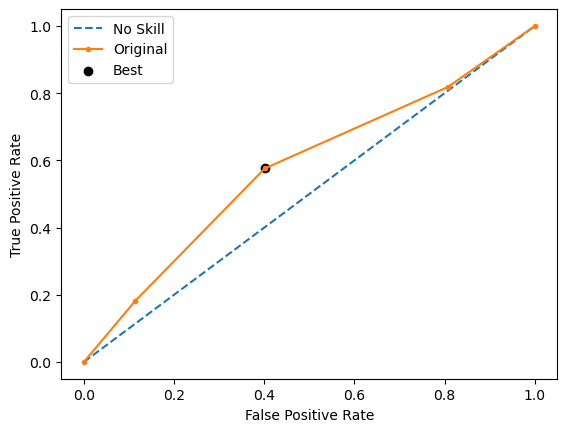

Run 4 - Random State: 3
Test G-mean: 0.6474117037800746
Best Threshold=0.567033, G-Mean=0.647


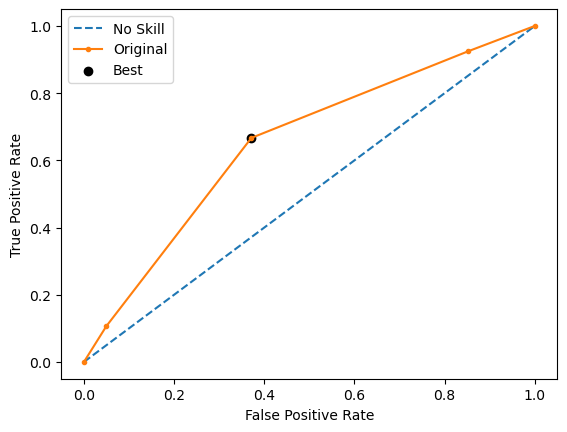

Run 5 - Random State: 4
Test G-mean: 0.6180114835659464
Best Threshold=0.556373, G-Mean=0.618


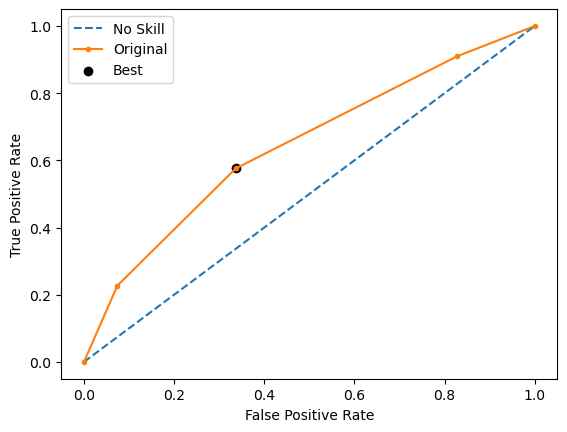

Ave Test G-mean: 0.6243528621539446
Stdev Test G-mean: 0.024812658646035383
Ave Test Specificity: 0.6198019801980198
Ave Test Recall: 0.6303030303030303
Ave Test NPV: 0.837184655396489
Ave Test Accuracy: 0.6223880597014926
Ave Test Precision: 0.3514839709652844
Ave Test F1-Score: 0.45095984157959074
Ave Runtime: 0.044297981262207034


In [253]:
ho_t07_dt_gs, ho_t07_dt_be, ho_t07_dt_model_info, ho_t07_dt_metrics_df = dt_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\linear_model\_logistic.py", line 1216, in fit
    self.coef_, self.intercept_, self.n_iter_ = _fit_liblinear(
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\

Best Hyperparameters: {'classifier__C': 1.0, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs', 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.6028860756941616
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 LogisticRegression(max_iter=1000, random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 103.42858576774597 secs
Run 1 - Random State: 0
Test G-mean: 0.6052574936862545
Best Threshold=0.516985, G-Mean=0.613


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


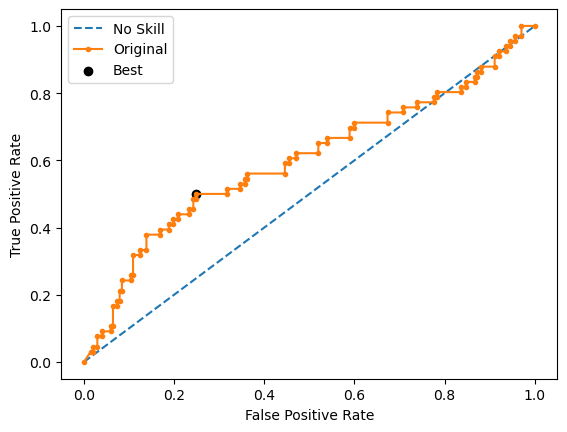

Run 2 - Random State: 1
Test G-mean: 0.5818795909686458
Best Threshold=0.494786, G-Mean=0.585


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


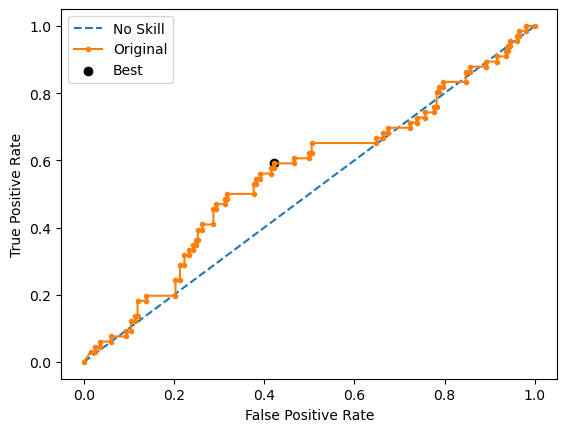

Run 3 - Random State: 2
Test G-mean: 0.6000300022501874
Best Threshold=0.507981, G-Mean=0.610


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


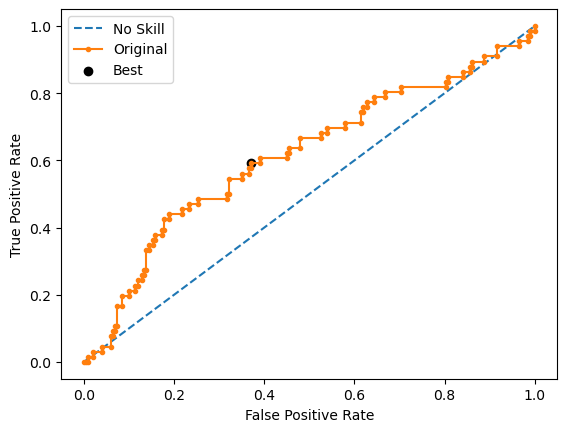

Run 4 - Random State: 3
Test G-mean: 0.5794899316278807
Best Threshold=0.517572, G-Mean=0.582


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


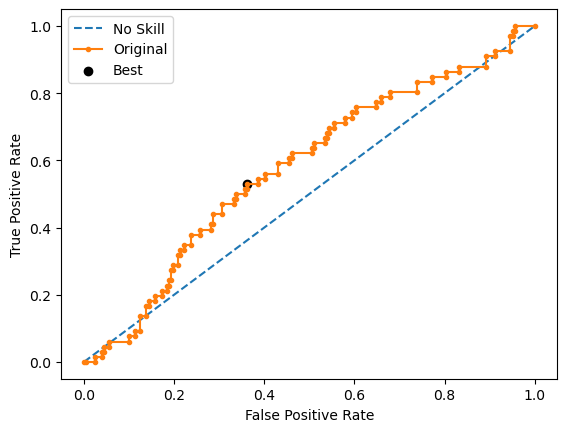

Run 5 - Random State: 4
Test G-mean: 0.5498001709919726
Best Threshold=0.455935, G-Mean=0.567


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


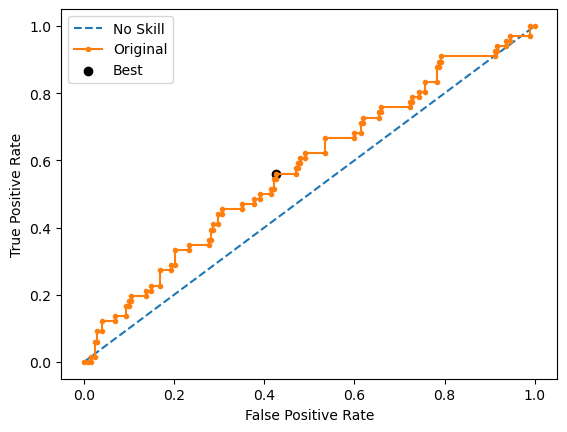

Ave Test G-mean: 0.5832914379049882
Stdev Test G-mean: 0.02179906456771411
Ave Test Specificity: 0.6346534653465347
Ave Test Recall: 0.5393939393939393
Ave Test NPV: 0.8084179681286464
Ave Test Accuracy: 0.6111940298507463
Ave Test Precision: 0.327589741869245
Ave Test F1-Score: 0.4060627733963201
Ave Runtime: 0.6266489505767823


In [254]:
ho_t07_logreg_gs, ho_t07_logreg_be, ho_t07_logreg_model_info, ho_t07_logreg_metrics_df = logreg_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Best Hyperparameters: {'classifier__C': 1000000.0, 'classifier__kernel': 'sigmoid', 'classifier__probability': True, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.525756832540497
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 SVC(C=1000000.0, kernel='sigmoid', max_iter=1000,
                     probability=True, random_state=0, verbose=True))])
Mean Train Score (G-mean) 0.252068334547509
Std Train Score (G-mean) 0.05114472320145939
GridSearchCV Runtime: 182.0276017189026 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.5222329678670935
Best Threshold=0.505154, G-Mean=0.297


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


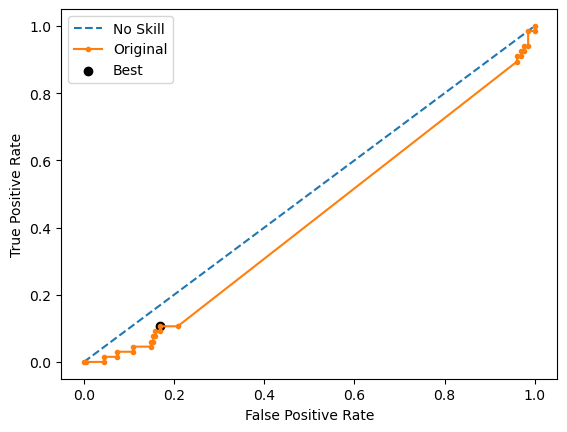

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.5620779244547112
Best Threshold=0.500000, G-Mean=0.236


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


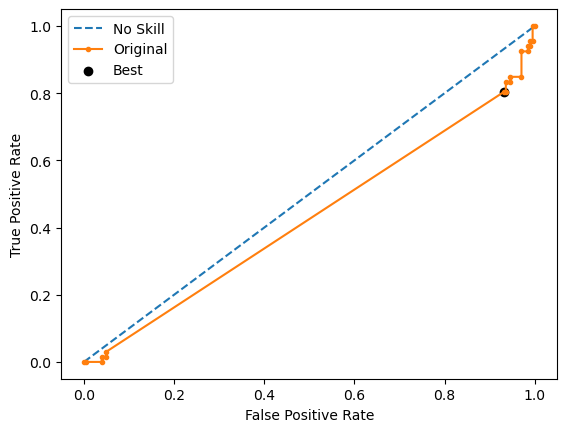

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 3 - Random State: 2
Test G-mean: 0.5035130112869513
Best Threshold=0.494625, G-Mean=0.373


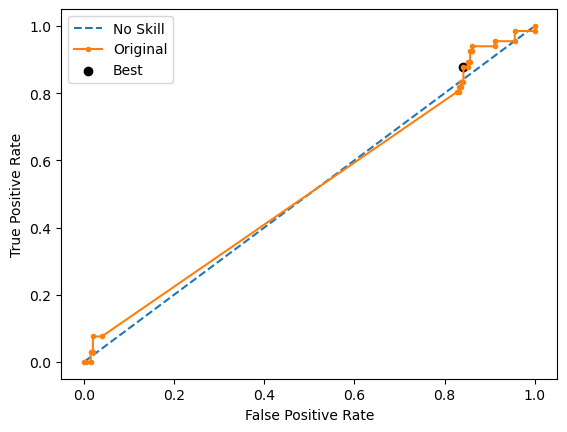

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.49358318694647985
Best Threshold=0.506519, G-Mean=0.359


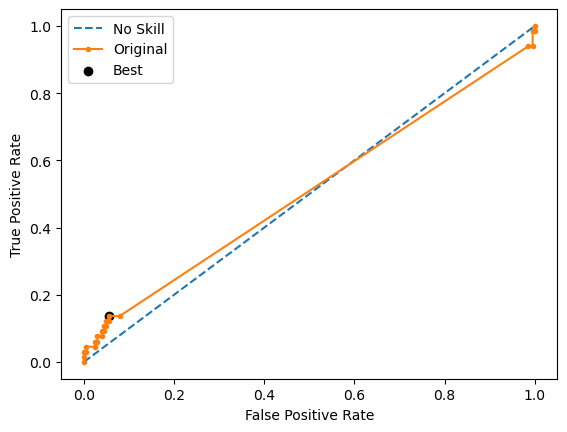

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.5260253513539311
Best Threshold=0.505944, G-Mean=0.475


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


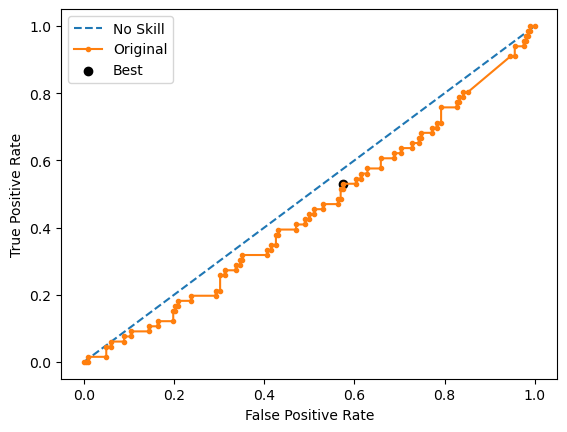

Ave Test G-mean: 0.5214864883818333
Stdev Test G-mean: 0.026317595354782956
Ave Test Specificity: 0.5643564356435644
Ave Test Recall: 0.4878787878787879
Ave Test NPV: 0.7720206747682841
Ave Test Accuracy: 0.5455223880597014
Ave Test Precision: 0.2673880462672968
Ave Test F1-Score: 0.344334146128061
Ave Runtime: 0.3679812431335449


In [255]:
ho_t07_svm_gs, ho_t07_svm_be, ho_t07_svm_model_info, ho_t07_svm_metrics_df = svm_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [256]:
ho_t07_knn_gs, ho_t07_knn_be, ho_t07_knn_model_info, ho_t07_knn_metrics_df = knn_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
Best Hyperparameters: {'classifier__metric': 'canberra', 'classifier__n_neighbors': 14, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5616302635069764
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='canberra', n_neighbors=14))])
Mean Train Score (G-mean) 0.6886934920016934
Std Train Score (G-mean) 0.014052201123921772
GridSearchCV Runtime: 117.2994921207428 secs
Run 1 - Random State: 0
Test G-mean: 0.5545545537413857
Run 2 - Random State: 1
Test G-mean: 0.5148558124861417
Run 3 - Random State: 2
Test G-mean: 0.5405129188294597
Run 4 - Random State: 3
Test G-mean: 0.5664645515906718
Run 5 - Random State: 4
Test G-mean: 0.495251983794861
Ave Test G-mean: 0.534327964088504
Stdev Test G-mean: 0.02909564303445095
Ave Test Specificity: 

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
Best Hyperparameters: {'classifier__boosting_type': 'dart', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 2, 'classifier__n_estimators': 200, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5923832184748289
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 LGBMClassifier(boosting_type='dart', learning_rate=0.01,
                                max_depth=2, n_estimators=200,
                                random_state=0))])
Mean Train Score (G-mean) 0.7420279935572658
Std Train Score (G-mean) 0.02116929085852266
GridSearchCV Runtime: 45.67667579650879 secs
Run 1 - Random State: 0
Test G-mean: 0.6469481077995503
Best Threshold=0.527040, G-Mean=0.690


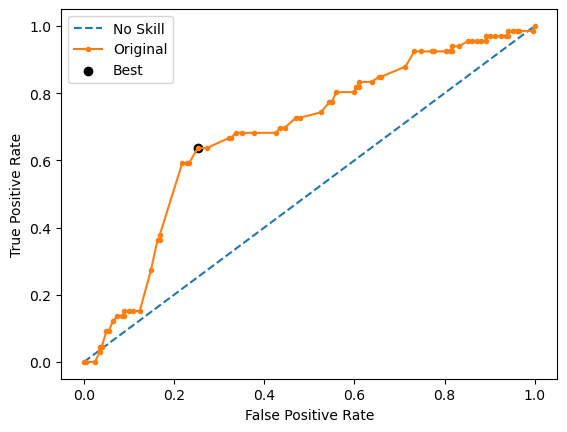

Run 2 - Random State: 1
Test G-mean: 0.6224859427126748
Best Threshold=0.515278, G-Mean=0.642


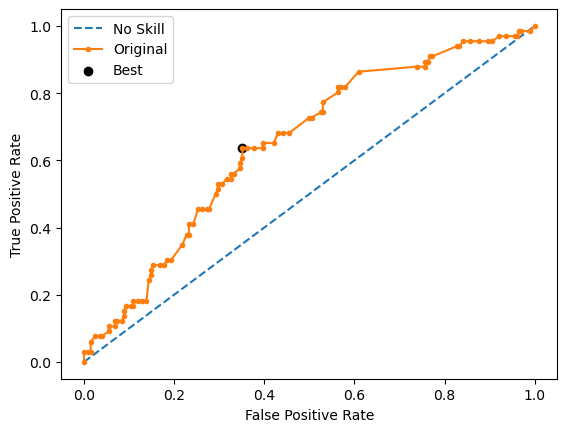

Run 3 - Random State: 2
Test G-mean: 0.5872686680292462
Best Threshold=0.534545, G-Mean=0.587


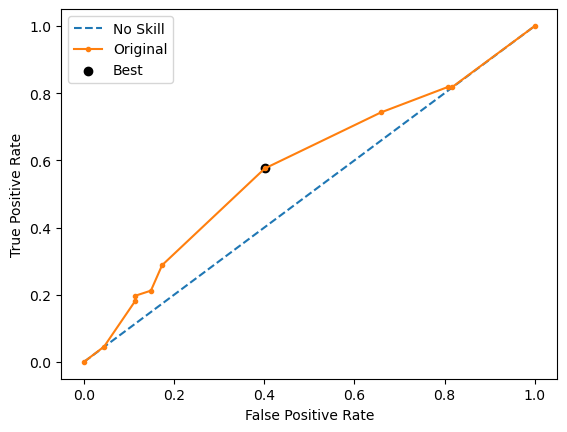

Run 4 - Random State: 3
Test G-mean: 0.6374877560109734
Best Threshold=0.527584, G-Mean=0.665


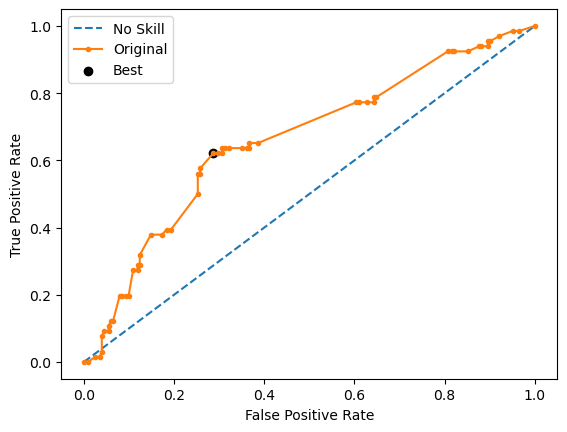

Run 5 - Random State: 4
Test G-mean: 0.6124030566141673
Best Threshold=0.500422, G-Mean=0.616


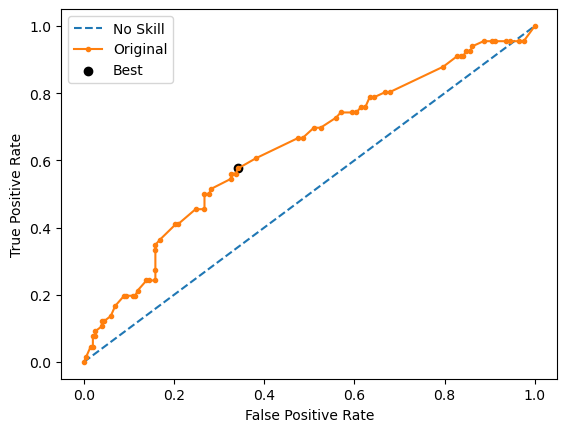

Ave Test G-mean: 0.6213187062333223
Stdev Test G-mean: 0.023230156834298615
Ave Test Specificity: 0.6158415841584158
Ave Test Recall: 0.6272727272727272
Ave Test NPV: 0.8349878938043582
Ave Test Accuracy: 0.6186567164179103
Ave Test Precision: 0.3478773121660482
Ave Test F1-Score: 0.4474892031398528
Ave Runtime: 0.3838043689727783


In [258]:
ho_t07_lgbm_gs, ho_t07_lgbm_be, ho_t07_lgbm_model_info, ho_t07_lgbm_metrics_df = lgbm_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits
Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.6020912873576488
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.9436587297011378
Std Train Score (G-mean) 0.004484499732313889
GridSearchCV Runtime: 12.505472421646118 secs
Run 1 - Random State: 0
Test G-mean: 0.596896664895069
Best Threshold=0.731059, G-Mean=0.597


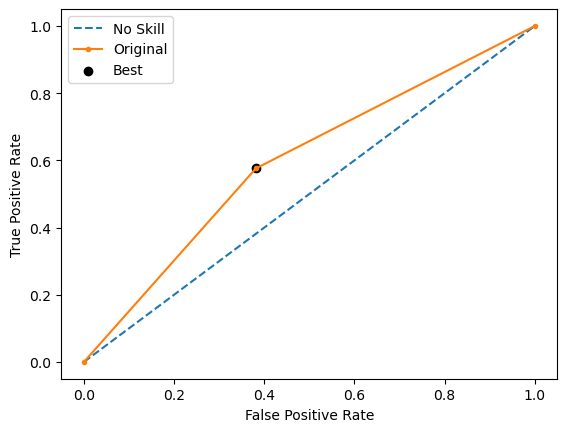

Run 2 - Random State: 1
Test G-mean: 0.5757891569970136
Best Threshold=0.731059, G-Mean=0.576


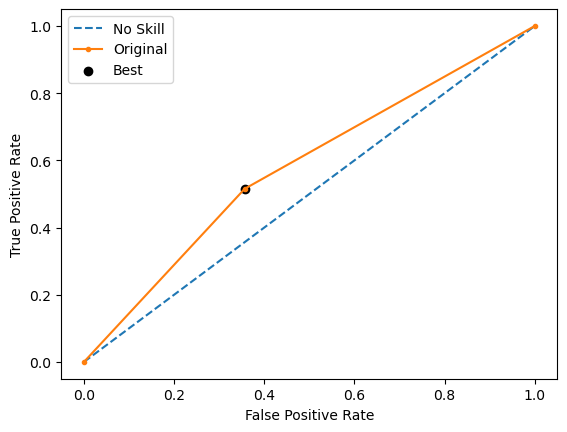

Run 3 - Random State: 2
Test G-mean: 0.5518427792816578
Best Threshold=0.731059, G-Mean=0.552


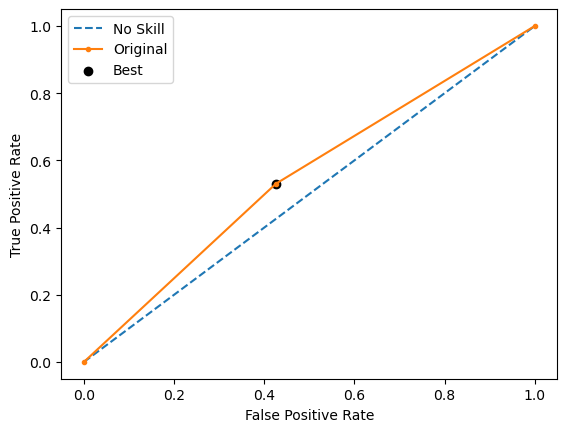

Run 4 - Random State: 3
Test G-mean: 0.5682493209226676
Best Threshold=0.731059, G-Mean=0.568


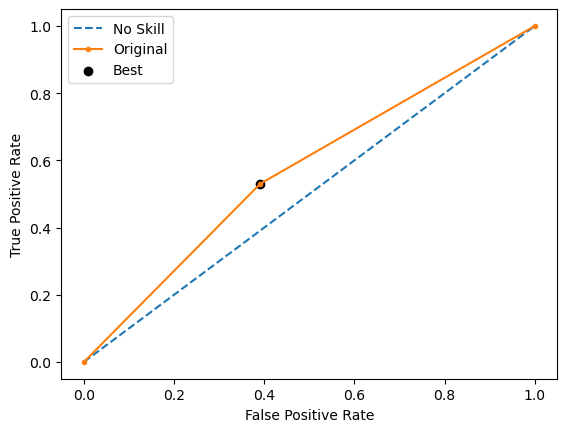

Run 5 - Random State: 4
Test G-mean: 0.58458033957476
Best Threshold=0.731059, G-Mean=0.585


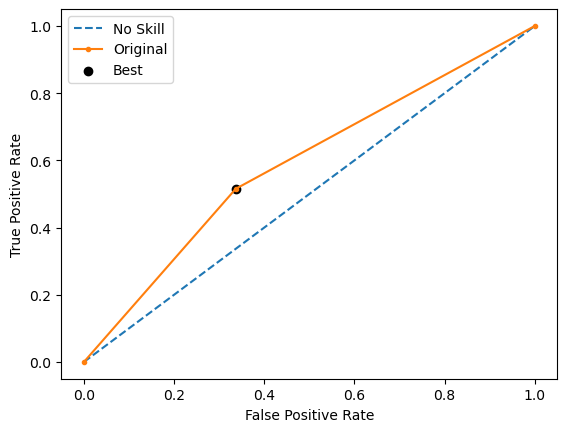

Ave Test G-mean: 0.5754716523342337
Stdev Test G-mean: 0.016974877528584738
Ave Test Specificity: 0.6217821782178218
Ave Test Recall: 0.5333333333333333
Ave Test NPV: 0.8029016920954419
Ave Test Accuracy: 0.6
Ave Test Precision: 0.3161593150259835
Ave Test F1-Score: 0.3966441368849332
Ave Runtime: 0.26468625068664553


In [259]:
ho_t07_adaboost_gs, ho_t07_adaboost_be, ho_t07_adaboost_model_info, ho_t07_adaboost_metrics_df = adaboost_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits
Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 250, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.5820526945931113
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 GradientBoostingClassifier(max_depth=2, min_samples_leaf=2,
                                            n_estimators=250,
                                            random_state=0))])
Mean Train Score (G-mean) 0.8829407400855935
Std Train Score (G-mean) 0.010635227990922288
GridSearchCV Runtime: 147.33878827095032 secs
Run 1 - Random State: 0
Test G-mean: 0.5650725003865162
Best Threshold=0.373778, G-Mean=0.622


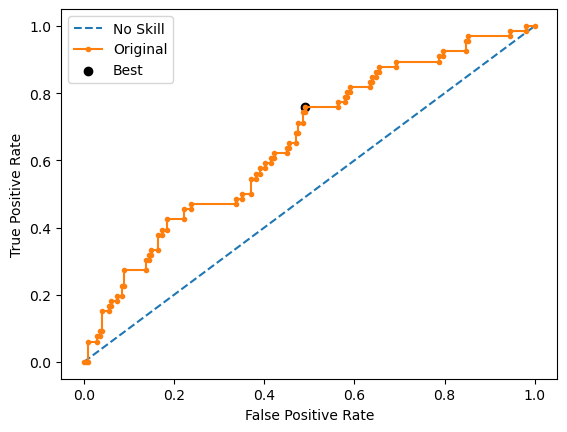

Run 2 - Random State: 1
Test G-mean: 0.5347930444200224
Best Threshold=0.434090, G-Mean=0.562


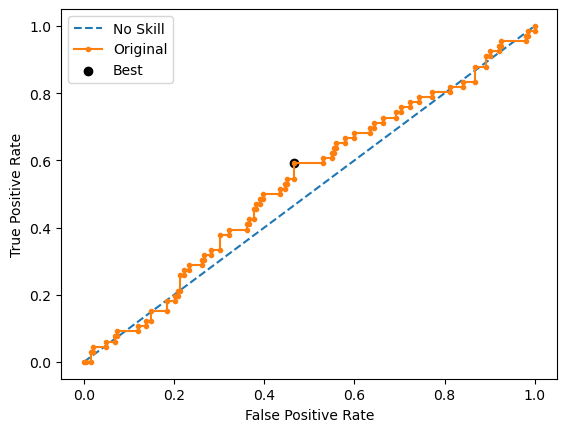

Run 3 - Random State: 2
Test G-mean: 0.6082244599647156
Best Threshold=0.514068, G-Mean=0.608


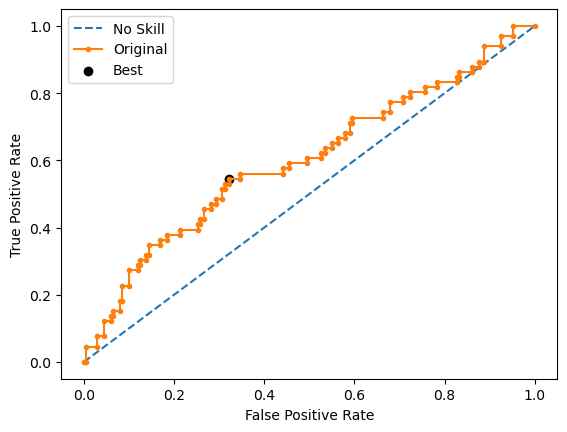

Run 4 - Random State: 3
Test G-mean: 0.541898851665644
Best Threshold=0.355166, G-Mean=0.584


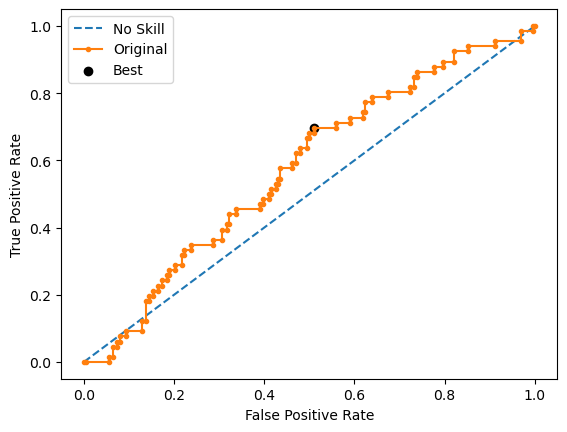

Run 5 - Random State: 4
Test G-mean: 0.5324738048348328
Best Threshold=0.431802, G-Mean=0.600


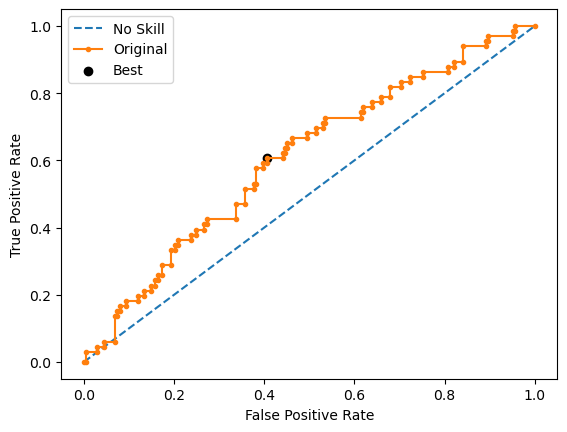

Ave Test G-mean: 0.5564925322543463
Stdev Test G-mean: 0.031664454637771115
Ave Test Specificity: 0.6524752475247525
Ave Test Recall: 0.47575757575757577
Ave Test NPV: 0.7920734264262264
Ave Test Accuracy: 0.608955223880597
Ave Test Precision: 0.30927895110762316
Ave Test F1-Score: 0.374596432074146
Ave Runtime: 0.6857966423034668


In [260]:
ho_t07_gbm_gs, ho_t07_gbm_be, ho_t07_gbm_model_info, ho_t07_gbm_metrics_df = gbm_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 1, 'classifier__max_depth': None, 'classifier__max_leaves': 10, 'classifier__n_estimators': 250, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.594776223443463
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importance_type=None,
       

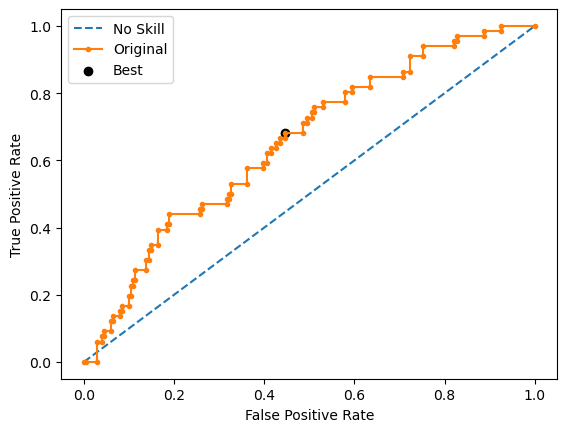

Run 2 - Random State: 1
Test G-mean: 0.5455545462887259
Best Threshold=0.390412, G-Mean=0.577


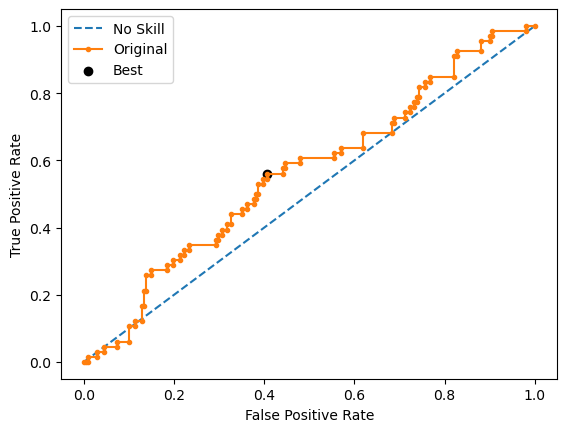

Run 3 - Random State: 2
Test G-mean: 0.60296049301394
Best Threshold=0.345868, G-Mean=0.610


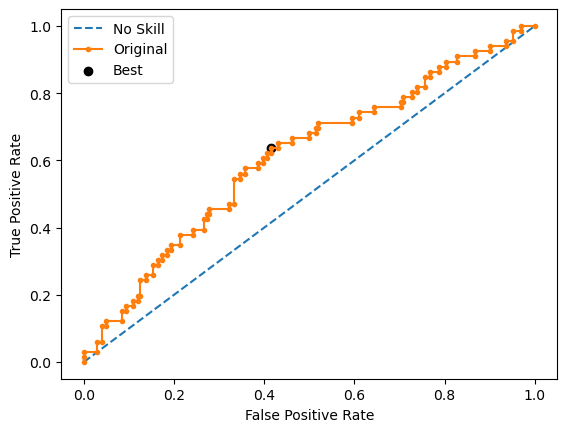

Run 4 - Random State: 3
Test G-mean: 0.5776100443520124
Best Threshold=0.746747, G-Mean=0.614


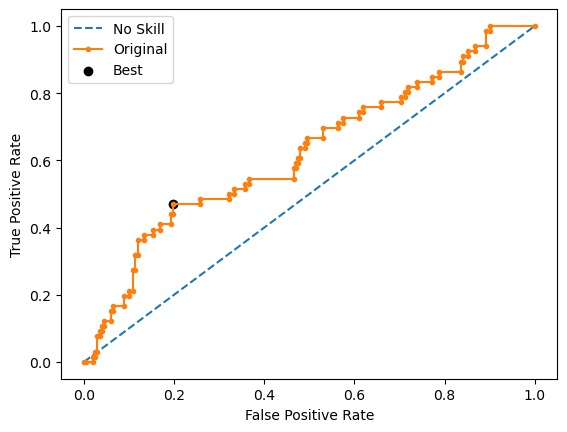

Run 5 - Random State: 4
Test G-mean: 0.5228788963364495
Best Threshold=0.370161, G-Mean=0.577


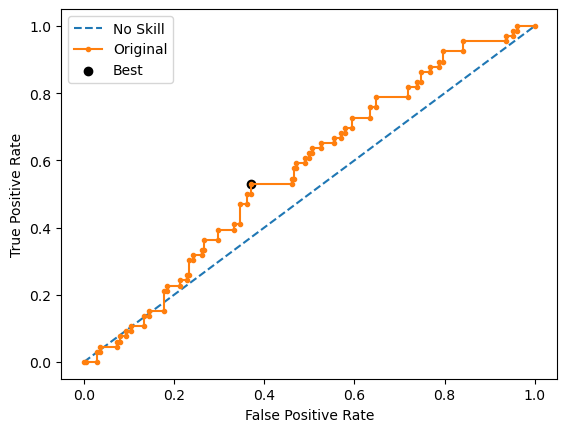

Ave Test G-mean: 0.5671267374504626
Stdev Test G-mean: 0.032394268272267525
Ave Test Specificity: 0.6742574257425742
Ave Test Recall: 0.4787878787878788
Ave Test NPV: 0.7984199040153084
Ave Test Accuracy: 0.6261194029850746
Ave Test Precision: 0.3253225435999957
Ave Test F1-Score: 0.38669440203548416
Ave Runtime: 0.3103505611419678


In [261]:
ho_t07_xgb_gs, ho_t07_xgb_be, ho_t07_xgb_model_info, ho_t07_xgb_metrics_df = xgb_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits
Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.6016644629517163
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 RandomForestClassifier(max_depth=3, min_samples_leaf=2,
                                        n_estimators=300, oob_score=True,
                                        random_state=0))])
Mean Train Score (G-mean) 0.6227262963253994
Std Train Score (G-mean) 0.022477704456260326
GridSearchCV Runtime: 392.5867874622345 secs
Run 1 - Random State: 0
Test G-mean: 0.6467161851866847
Best Threshold=0.504757, G-Mean=0.653


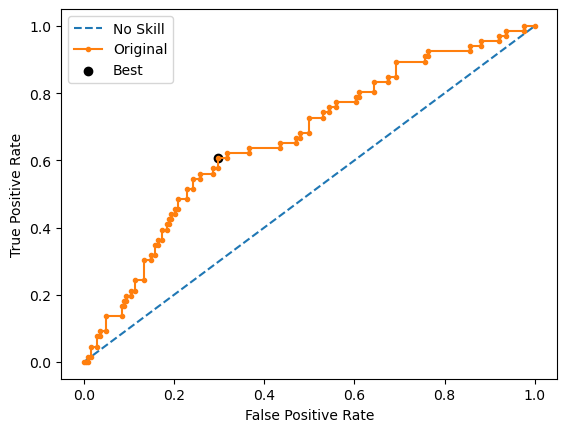

Run 2 - Random State: 1
Test G-mean: 0.563610473355994
Best Threshold=0.477636, G-Mean=0.573


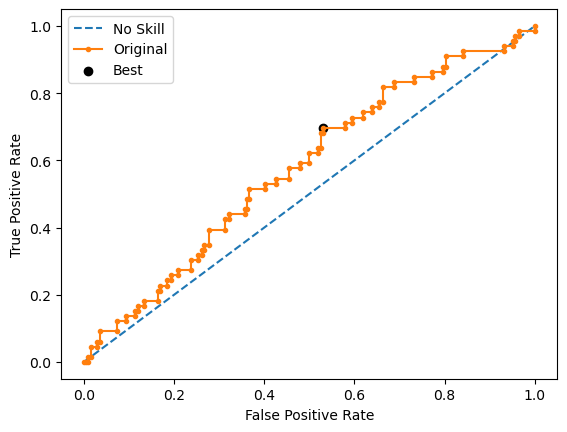

Run 3 - Random State: 2
Test G-mean: 0.6074840769027358
Best Threshold=0.503476, G-Mean=0.619


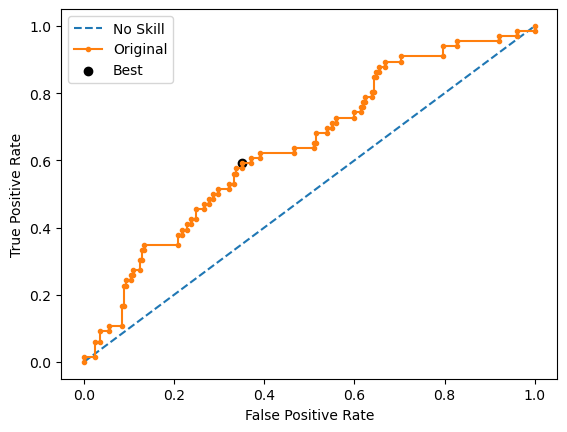

Run 4 - Random State: 3
Test G-mean: 0.6500132704223603
Best Threshold=0.508920, G-Mean=0.665


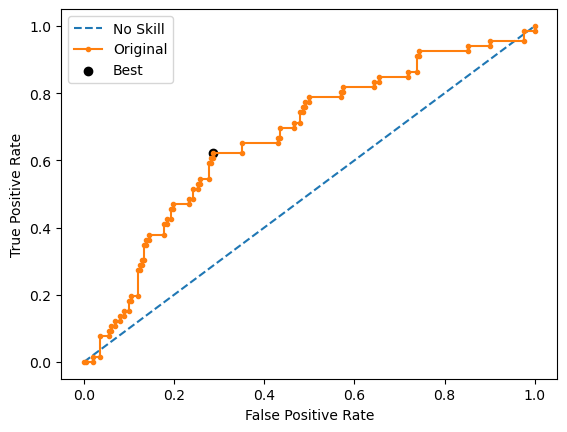

Run 5 - Random State: 4
Test G-mean: 0.584452015494721
Best Threshold=0.476340, G-Mean=0.612


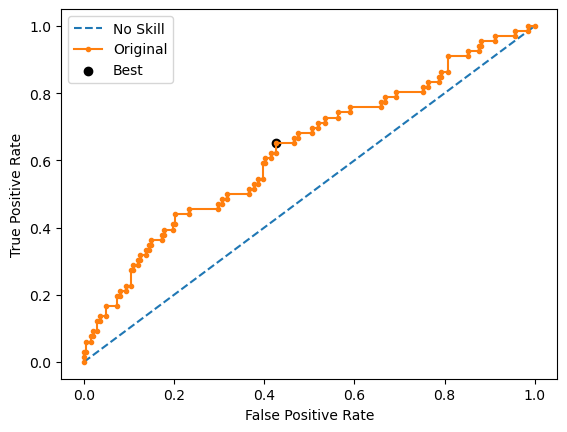

Ave Test G-mean: 0.6104552042724991
Stdev Test G-mean: 0.037944438240259996
Ave Test Specificity: 0.6425742574257426
Ave Test Recall: 0.5818181818181818
Ave Test NPV: 0.8247886757374111
Ave Test Accuracy: 0.6276119402985074
Ave Test Precision: 0.3476870659658312
Ave Test F1-Score: 0.43474440191841524
Ave Runtime: 0.5993012905120849


In [262]:
ho_t07_rf_gs, ho_t07_rf_be, ho_t07_rf_model_info, ho_t07_rf_metrics_df = rf_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
Learning rate set to 0.006922
0:	learn: 0.6925932	total: 3.02ms	remaining: 3.01s
1:	learn: 0.6915944	total: 5.72ms	remaining: 2.85s
2:	learn: 0.6907981	total: 8.29ms	remaining: 2.75s
3:	learn: 0.6899970	total: 11ms	remaining: 2.73s
4:	learn: 0.6889704	total: 13.6ms	remaining: 2.7s
5:	learn: 0.6878691	total: 16.1ms	remaining: 2.67s
6:	learn: 0.6866138	total: 18.7ms	remaining: 2.65s
7:	learn: 0.6859139	total: 21ms	remaining: 2.6s
8:	learn: 0.6848884	total: 23.4ms	remaining: 2.58s
9:	learn: 0.6836013	total: 25.9ms	remaining: 2.57s
10:	learn: 0.6821693	total: 28.7ms	remaining: 2.58s
11:	learn: 0.6817355	total: 31.1ms	remaining: 2.56s
12:	learn: 0.6805076	total: 33.5ms	remaining: 2.54s
13:	learn: 0.6794318	total: 36.1ms	remaining: 2.54s
14:	learn: 0.6788873	total: 38.7ms	remaining: 2.54s
15:	learn: 0.6779862	total: 41.2ms	remaining: 2.53s
16:	learn: 0.6769858	total: 44.1ms	remaining: 2.55s
17:	learn: 0.6760934	total: 46.8ms	remain

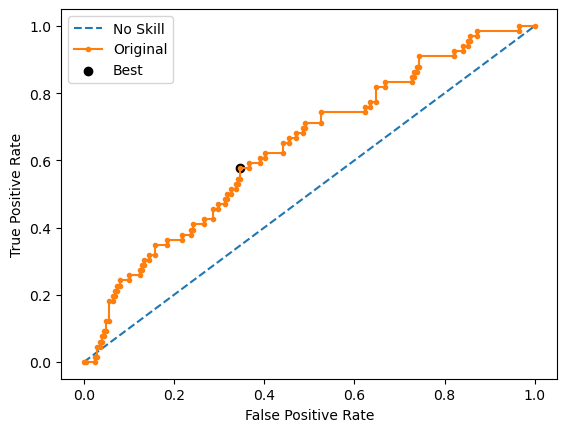

Learning rate set to 0.006922
0:	learn: 0.6917757	total: 3.66ms	remaining: 3.66s
1:	learn: 0.6907574	total: 6.14ms	remaining: 3.07s
2:	learn: 0.6899608	total: 8.73ms	remaining: 2.9s
3:	learn: 0.6885274	total: 11.5ms	remaining: 2.85s
4:	learn: 0.6877070	total: 14ms	remaining: 2.78s
5:	learn: 0.6868436	total: 16.6ms	remaining: 2.75s
6:	learn: 0.6854144	total: 19.1ms	remaining: 2.71s
7:	learn: 0.6841373	total: 21.5ms	remaining: 2.67s
8:	learn: 0.6827903	total: 24.1ms	remaining: 2.65s
9:	learn: 0.6816773	total: 26.5ms	remaining: 2.63s
10:	learn: 0.6802913	total: 28.8ms	remaining: 2.59s
11:	learn: 0.6790553	total: 31.4ms	remaining: 2.58s
12:	learn: 0.6782002	total: 33.9ms	remaining: 2.58s
13:	learn: 0.6771877	total: 36.5ms	remaining: 2.57s
14:	learn: 0.6758085	total: 38.8ms	remaining: 2.55s
15:	learn: 0.6743024	total: 41.4ms	remaining: 2.55s
16:	learn: 0.6727772	total: 44ms	remaining: 2.54s
17:	learn: 0.6723835	total: 46.3ms	remaining: 2.53s
18:	learn: 0.6711152	total: 48.9ms	remaining: 2.5

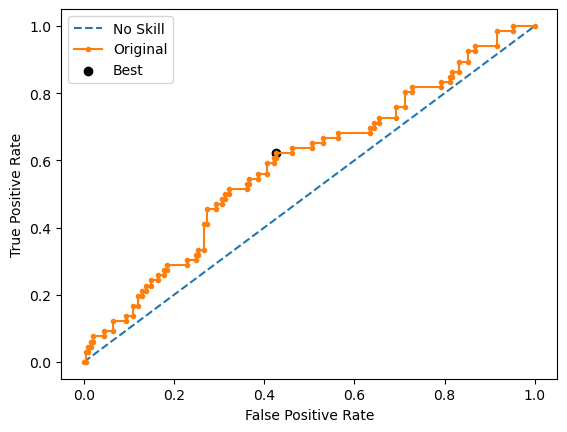

Learning rate set to 0.006922
0:	learn: 0.6915608	total: 2.64ms	remaining: 2.63s
1:	learn: 0.6891043	total: 5.35ms	remaining: 2.67s
2:	learn: 0.6877437	total: 7.9ms	remaining: 2.63s
3:	learn: 0.6859936	total: 10.4ms	remaining: 2.6s
4:	learn: 0.6848356	total: 13ms	remaining: 2.6s
5:	learn: 0.6837831	total: 15.4ms	remaining: 2.55s
6:	learn: 0.6822884	total: 17.7ms	remaining: 2.51s
7:	learn: 0.6811639	total: 20.1ms	remaining: 2.49s
8:	learn: 0.6797561	total: 22.7ms	remaining: 2.5s
9:	learn: 0.6786867	total: 25.2ms	remaining: 2.49s
10:	learn: 0.6777130	total: 27.7ms	remaining: 2.49s
11:	learn: 0.6771724	total: 30.3ms	remaining: 2.5s
12:	learn: 0.6759269	total: 32.8ms	remaining: 2.49s
13:	learn: 0.6743493	total: 35.2ms	remaining: 2.48s
14:	learn: 0.6731938	total: 37.8ms	remaining: 2.48s
15:	learn: 0.6728976	total: 40.4ms	remaining: 2.48s
16:	learn: 0.6712511	total: 43ms	remaining: 2.48s
17:	learn: 0.6699981	total: 45.4ms	remaining: 2.48s
18:	learn: 0.6688468	total: 47.8ms	remaining: 2.47s
1

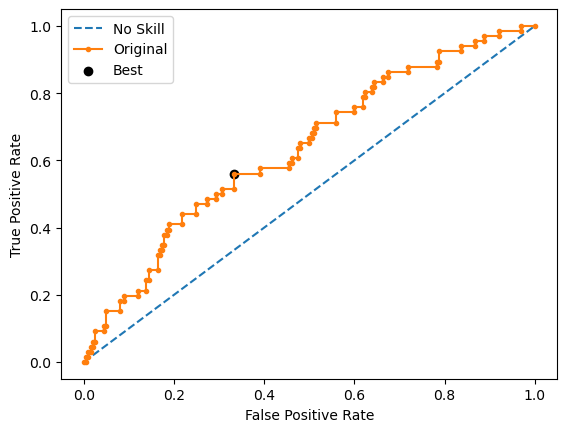

Learning rate set to 0.006922
0:	learn: 0.6922818	total: 2.8ms	remaining: 2.8s
1:	learn: 0.6910777	total: 5.41ms	remaining: 2.7s
2:	learn: 0.6898807	total: 7.77ms	remaining: 2.58s
3:	learn: 0.6889244	total: 10.2ms	remaining: 2.53s
4:	learn: 0.6879907	total: 12.7ms	remaining: 2.52s
5:	learn: 0.6867908	total: 15ms	remaining: 2.49s
6:	learn: 0.6857551	total: 17.5ms	remaining: 2.49s
7:	learn: 0.6846771	total: 19.9ms	remaining: 2.47s
8:	learn: 0.6838094	total: 22.2ms	remaining: 2.44s
9:	learn: 0.6831921	total: 24.7ms	remaining: 2.44s
10:	learn: 0.6820158	total: 27.1ms	remaining: 2.43s
11:	learn: 0.6807095	total: 29.7ms	remaining: 2.44s
12:	learn: 0.6797208	total: 32.3ms	remaining: 2.45s
13:	learn: 0.6781180	total: 34.9ms	remaining: 2.45s
14:	learn: 0.6774925	total: 37.1ms	remaining: 2.44s
15:	learn: 0.6767942	total: 39.8ms	remaining: 2.44s
16:	learn: 0.6758322	total: 42.1ms	remaining: 2.43s
17:	learn: 0.6749166	total: 44.5ms	remaining: 2.43s
18:	learn: 0.6740625	total: 46.8ms	remaining: 2.4

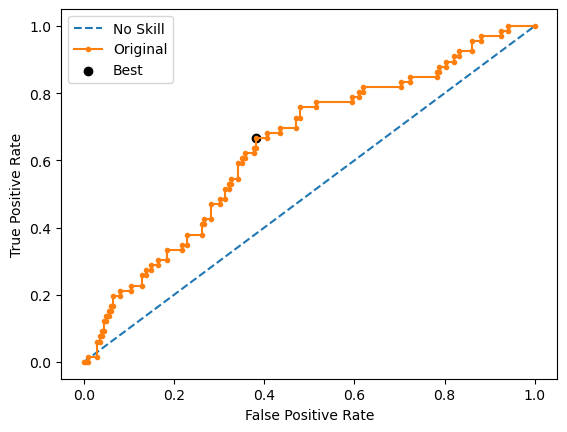

Learning rate set to 0.006922
0:	learn: 0.6918770	total: 3.03ms	remaining: 3.03s
1:	learn: 0.6908344	total: 5.73ms	remaining: 2.86s
2:	learn: 0.6898347	total: 8.16ms	remaining: 2.71s
3:	learn: 0.6889398	total: 10.7ms	remaining: 2.66s
4:	learn: 0.6877485	total: 13.2ms	remaining: 2.62s
5:	learn: 0.6863435	total: 15.8ms	remaining: 2.61s
6:	learn: 0.6851576	total: 18.2ms	remaining: 2.59s
7:	learn: 0.6840617	total: 20.7ms	remaining: 2.56s
8:	learn: 0.6824181	total: 22.9ms	remaining: 2.53s
9:	learn: 0.6812613	total: 25.4ms	remaining: 2.51s
10:	learn: 0.6794770	total: 27.7ms	remaining: 2.49s
11:	learn: 0.6782449	total: 30.3ms	remaining: 2.49s
12:	learn: 0.6774971	total: 32.9ms	remaining: 2.5s
13:	learn: 0.6764224	total: 35.4ms	remaining: 2.49s
14:	learn: 0.6747983	total: 37.8ms	remaining: 2.48s
15:	learn: 0.6737534	total: 40.2ms	remaining: 2.47s
16:	learn: 0.6723031	total: 42.6ms	remaining: 2.46s
17:	learn: 0.6708492	total: 45.2ms	remaining: 2.47s
18:	learn: 0.6697755	total: 47.7ms	remaining:

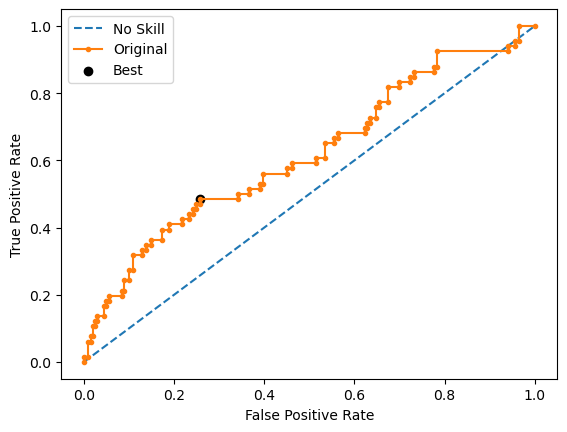

Ave Test G-mean: 0.5978506203204994
Stdev Test G-mean: 0.026702887539368426
Ave Test Specificity: 0.6227722772277228
Ave Test Recall: 0.5757575757575757
Ave Test NPV: 0.8185451642933618
Ave Test Accuracy: 0.6111940298507463
Ave Test Precision: 0.33207704455584613
Ave Test F1-Score: 0.4209373515085228
Ave Runtime: 2.6942410469055176


In [263]:
ho_t07_catboost_gs, ho_t07_catboost_be, ho_t07_catboost_model_info, ho_t07_catboost_metrics_df = catboost_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [264]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t07_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t07_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t07_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall
3,Decision Tree,0.624353,0.024813,0.594305,0.504684,0.619802,0.630303
6,LightGBM,0.621319,0.023230,0.592383,0.742028,0.615842,0.627273
4,Random Forest,0.610455,0.037944,0.601664,0.622726,0.642574,0.581818
2,Logistic Regression,0.583291,0.021799,0.602886,NaN,0.634653,0.539394
8,AdaBoost,0.575472,0.016975,0.602091,0.943659,0.621782,0.533333
7,Extreme Gradient Boosting (XGBoost),0.567127,0.032394,0.594776,0.850648,0.674257,0.478788
5,Gradient Boosting Machine (GBM),0.556493,0.031664,0.582053,0.882941,0.652475,0.475758
0,k-Nearest Neighbors,0.534328,0.029096,0.561630,0.688693,0.550495,0.527273
1,SVM Classifier,0.521486,0.026318,0.525757,0.252068,0.564356,0.487879


# HO-T08 Runs: RobustScaler

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits
Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 3, 'classifier__max_features': 'log2', 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5966131815002639
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(criterion='entropy', max_depth=3,
                                        max_features='log2', random_state=0))])
Mean Train Score (G-mean) 0.5520784197104317
Std Train Score (G-mean) 0.049809375846590453
GridSearchCV Runtime: 66.08575892448425 secs
Run 1 - Random State: 0
Test G-mean: 0.6547273224684294
Best Threshold=0.582692, G-Mean=0.663


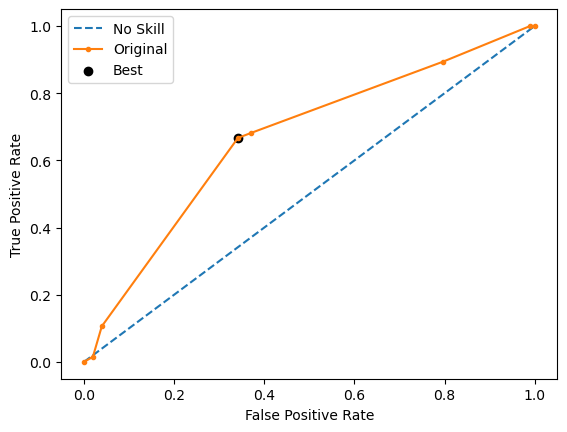

Run 2 - Random State: 1
Test G-mean: 0.596016378594041
Best Threshold=0.655556, G-Mean=0.596


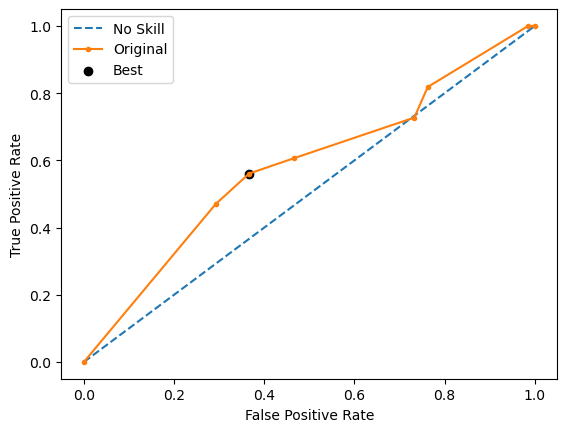

Run 3 - Random State: 2
Test G-mean: 0.5872686680292462
Best Threshold=0.612648, G-Mean=0.587


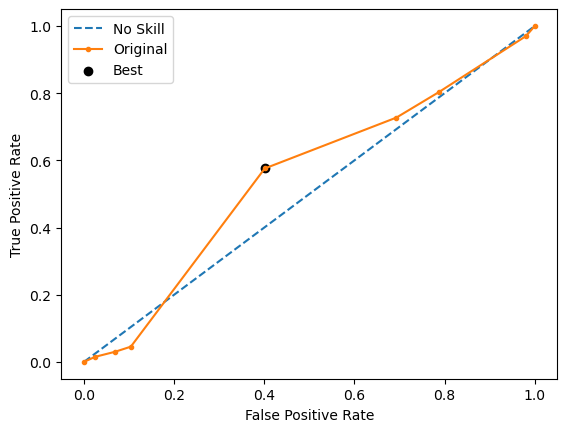

Run 4 - Random State: 3
Test G-mean: 0.6371346749780661
Best Threshold=0.592937, G-Mean=0.637


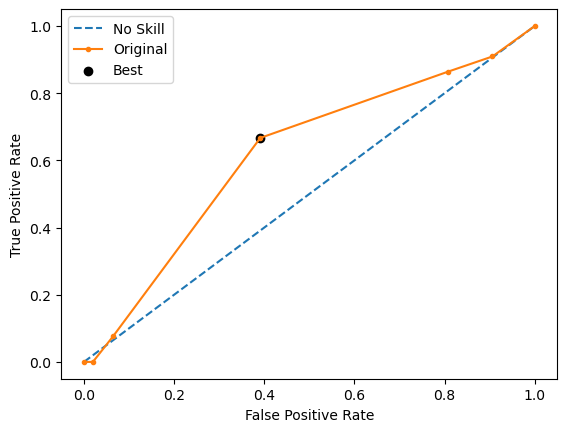

Run 5 - Random State: 4
Test G-mean: 0.5996548662321182
Best Threshold=0.564576, G-Mean=0.600


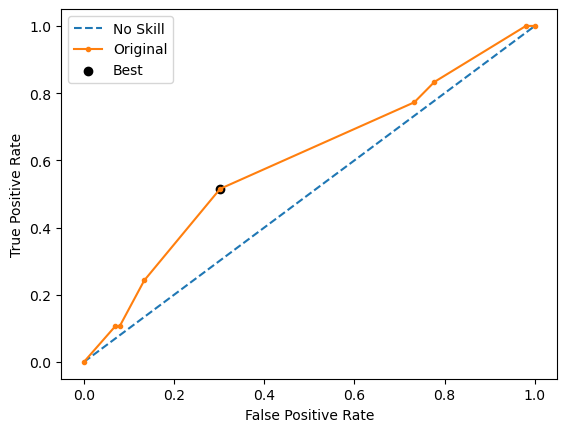

Ave Test G-mean: 0.6149603820603801
Stdev Test G-mean: 0.029296219567977642
Ave Test Specificity: 0.6336633663366337
Ave Test Recall: 0.5999999999999999
Ave Test NPV: 0.8297560066055503
Ave Test Accuracy: 0.6253731343283582
Ave Test Precision: 0.34865587570072953
Ave Test F1-Score: 0.4401459177307229
Ave Runtime: 0.025896835327148437


In [281]:
ho_t08_dt_gs, ho_t08_dt_be, ho_t08_dt_model_info, ho_t08_dt_metrics_df = dt_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\linear_model\_logistic.py", line 1216, in fit
    self.coef_, self.intercept_, self.n_iter_ = _fit_liblinear(
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\

Best Hyperparameters: {'classifier__C': 100.0, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs', 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.6078975550078626
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 LogisticRegression(C=100.0, max_iter=1000, random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 52.069857358932495 secs
Run 1 - Random State: 0
Test G-mean: 0.6188604841399094
Best Threshold=0.512718, G-Mean=0.634


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


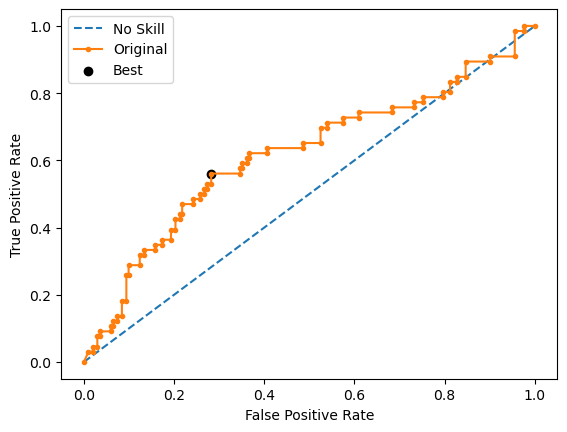

Run 2 - Random State: 1
Test G-mean: 0.5763099975892594
Best Threshold=0.494359, G-Mean=0.580


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


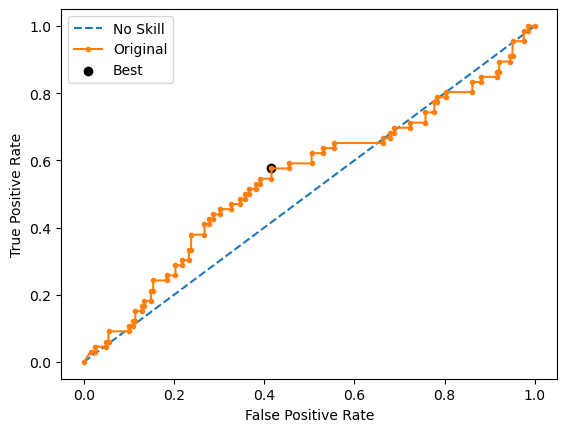

Run 3 - Random State: 2
Test G-mean: 0.6150307523064422
Best Threshold=0.499350, G-Mean=0.620


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


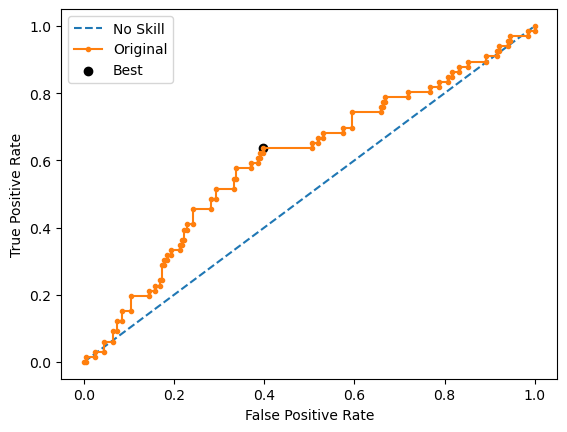

Run 4 - Random State: 3
Test G-mean: 0.5624781223868323
Best Threshold=0.497402, G-Mean=0.592


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


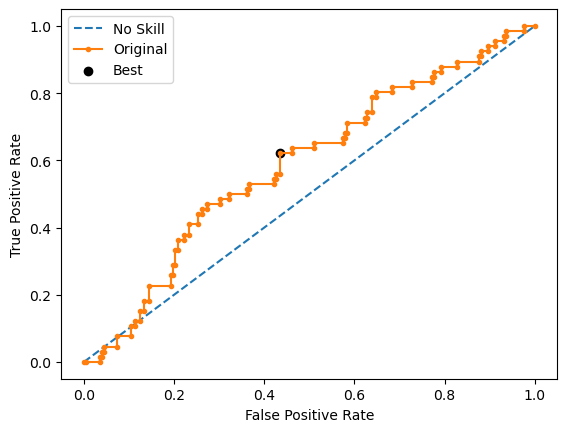

Run 5 - Random State: 4
Test G-mean: 0.560273496284684
Best Threshold=0.486683, G-Mean=0.580


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


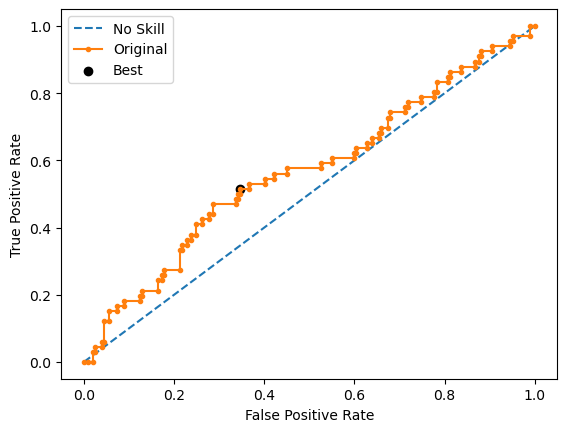

Ave Test G-mean: 0.5865905705414255
Stdev Test G-mean: 0.028416016593412613
Ave Test Specificity: 0.6267326732673267
Ave Test Recall: 0.5515151515151515
Ave Test NPV: 0.8105340798718748
Ave Test Accuracy: 0.6082089552238805
Ave Test Precision: 0.3266746618406295
Ave Test F1-Score: 0.4094494756438197
Ave Runtime: 0.369551420211792


In [282]:
ho_t08_logreg_gs, ho_t08_logreg_be, ho_t08_logreg_model_info, ho_t08_logreg_metrics_df = logreg_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]Best Hyperparameters: {'classifier__C': 1000000.0, 'classifier__kernel': 'sigmoid', 'classifier__probability': True, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5271837717242484
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 SVC(C=1000000.0, kernel='sigmoid', max_iter=1000,
                     probability=True, random_state=0, verbose=True))])
Mean Train Score (G-mean) 0.25173061573833866
Std Train Score (G-mean) 0.05385039016863185
GridSearchCV Runtime: 118.15375328063965 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.5470648297896689
Best Threshold=0.494878, G-Mean=0.567


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


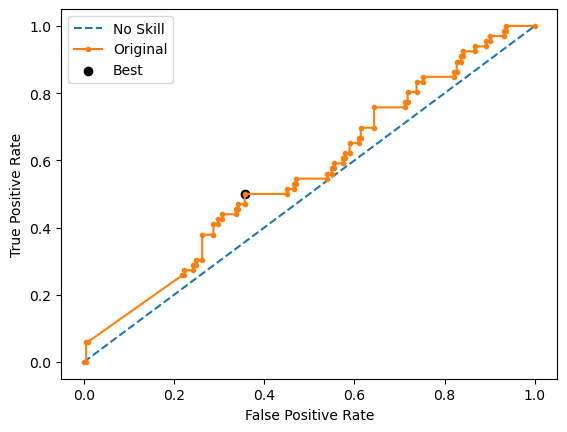

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.50714960324544
Best Threshold=0.521705, G-Mean=0.293


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


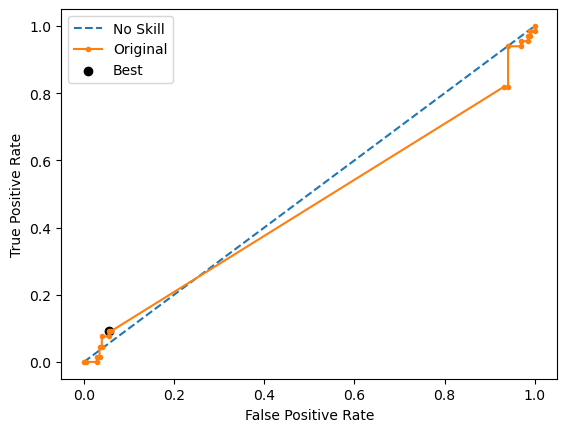

[LibSVM]Run 3 - Random State: 2
Test G-mean: 0.5199298344039033
Best Threshold=0.519037, G-Mean=0.401


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


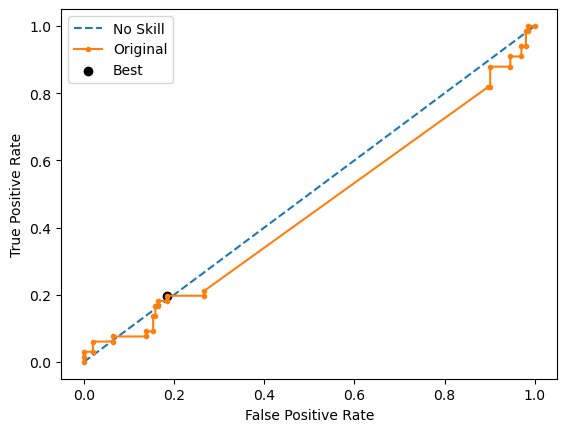

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.4756286600513327
Best Threshold=0.500000, G-Mean=0.118


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


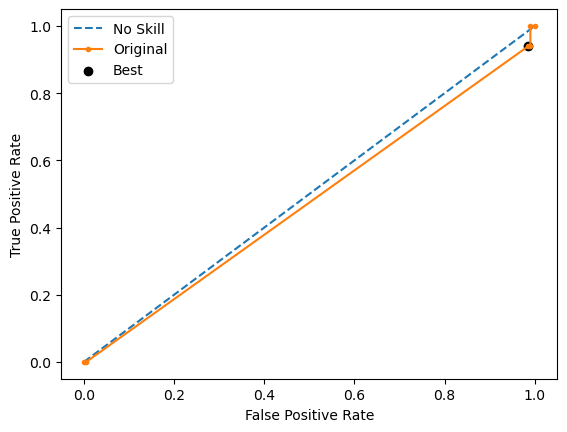

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.5391929829915173
Best Threshold=0.493064, G-Mean=0.287


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


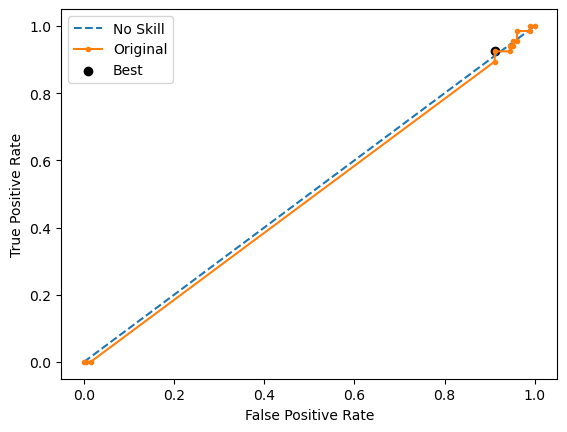

Ave Test G-mean: 0.5177931820963725
Stdev Test G-mean: 0.02833054363296901
Ave Test Specificity: 0.5900990099009901
Ave Test Recall: 0.45757575757575764
Ave Test NPV: 0.7689140185823027
Ave Test Accuracy: 0.5574626865671642
Ave Test Precision: 0.2680212057309454
Ave Test F1-Score: 0.3371681339390776
Ave Runtime: 0.060284757614135744


In [283]:
ho_t08_svm_gs, ho_t08_svm_be, ho_t08_svm_model_info, ho_t08_svm_metrics_df = svm_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [284]:
ho_t08_knn_gs, ho_t08_knn_be, ho_t08_knn_model_info, ho_t08_knn_metrics_df = knn_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
Best Hyperparameters: {'classifier__metric': 'cosine', 'classifier__n_neighbors': 3, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5594153075270116
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='cosine', n_neighbors=3))])
Mean Train Score (G-mean) 0.686828076239181
Std Train Score (G-mean) 0.01544186972704155
GridSearchCV Runtime: 77.13261294364929 secs
Run 1 - Random State: 0
Test G-mean: 0.5682493209226677
Run 2 - Random State: 1
Test G-mean: 0.487004843273388
Run 3 - Random State: 2
Test G-mean: 0.5098048549190267
Run 4 - Random State: 3
Test G-mean: 0.4846116845975599
Run 5 - Random State: 4
Test G-mean: 0.5447289903863175
Ave Test G-mean: 0.5188799388197919
Stdev Test G-mean: 0.036668111034816334
Ave Test Specificity: 0.4851

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
Best Hyperparameters: {'classifier__boosting_type': 'dart', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 2, 'classifier__n_estimators': 200, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5965566786253891
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 LGBMClassifier(boosting_type='dart', learning_rate=0.01,
                                max_depth=2, n_estimators=200,
                                random_state=0))])
Mean Train Score (G-mean) 0.7460883092264341
Std Train Score (G-mean) 0.01766791496110193
GridSearchCV Runtime: 38.253618001937866 secs
Run 1 - Random State: 0
Test G-mean: 0.6575281243592797
Best Threshold=0.526146, G-Mean=0.684


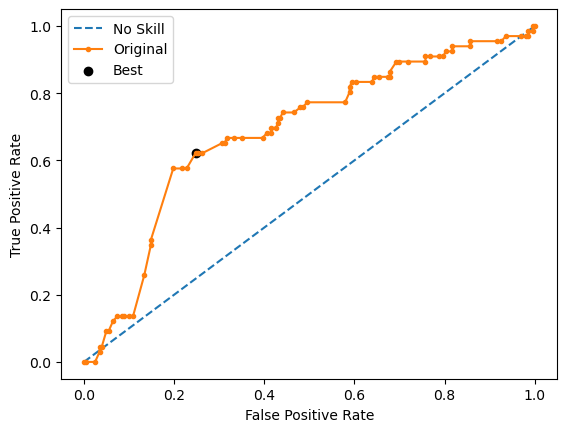

Run 2 - Random State: 1
Test G-mean: 0.6247111543766769
Best Threshold=0.507078, G-Mean=0.632


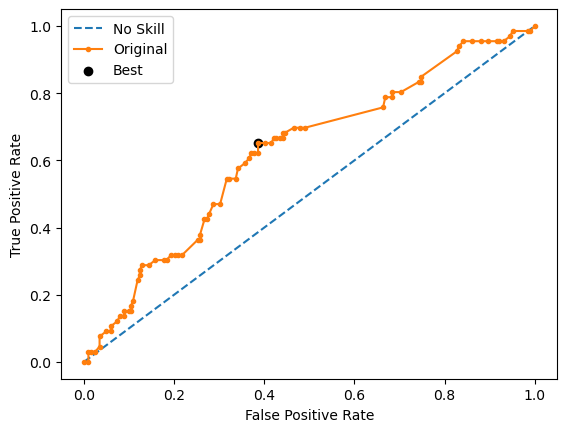

Run 3 - Random State: 2
Test G-mean: 0.5872686680292462
Best Threshold=0.533153, G-Mean=0.587


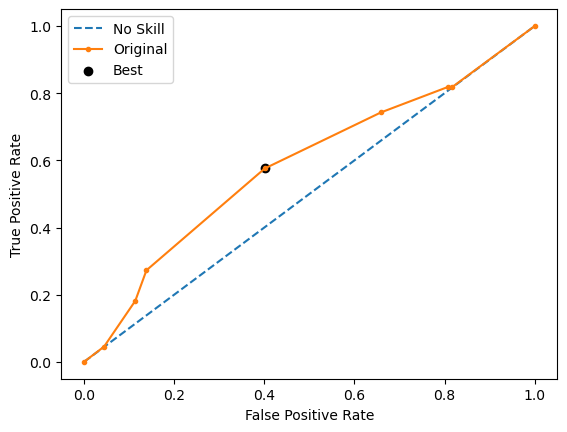

Run 4 - Random State: 3
Test G-mean: 0.6474117037800746
Best Threshold=0.503032, G-Mean=0.663


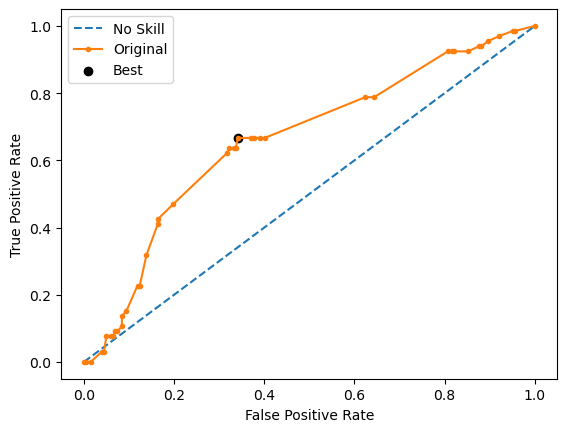

Run 5 - Random State: 4
Test G-mean: 0.6124030566141673
Best Threshold=0.500422, G-Mean=0.616


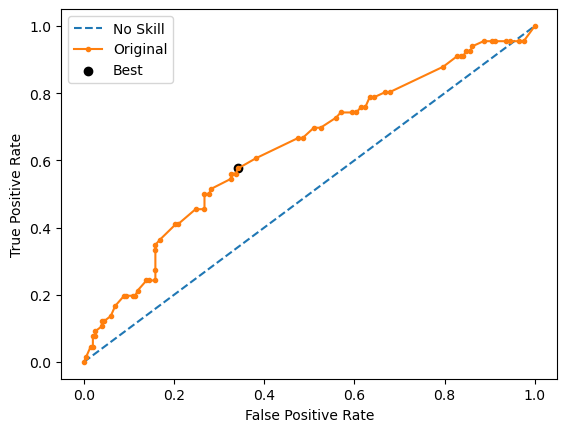

Ave Test G-mean: 0.6258645414318889
Stdev Test G-mean: 0.02801359494945503
Ave Test Specificity: 0.6188118811881188
Ave Test Recall: 0.6333333333333333
Ave Test NPV: 0.8377462055684683
Ave Test Accuracy: 0.6223880597014925
Ave Test Precision: 0.3520677722666008
Ave Test F1-Score: 0.4524928761366155
Ave Runtime: 0.36489238739013674


In [285]:
ho_t08_lgbm_gs, ho_t08_lgbm_be, ho_t08_lgbm_model_info, ho_t08_lgbm_metrics_df = lgbm_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits
Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5684631509057696
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.9439618467435441
Std Train Score (G-mean) 0.004924049647730128
GridSearchCV Runtime: 10.690007209777832 secs
Run 1 - Random State: 0
Test G-mean: 0.6150307523064422
Best Threshold=0.731059, G-Mean=0.615


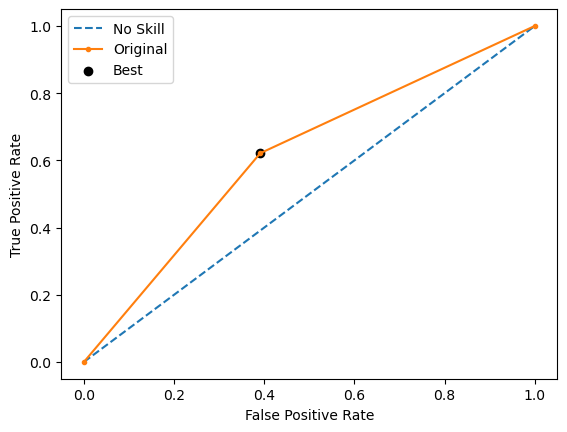

Run 2 - Random State: 1
Test G-mean: 0.5866297072611855
Best Threshold=0.731059, G-Mean=0.587


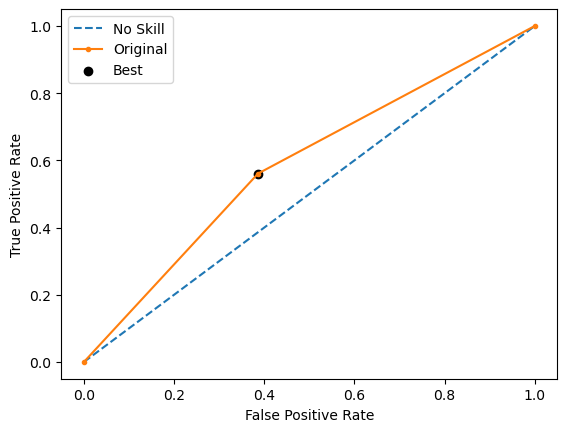

Run 3 - Random State: 2
Test G-mean: 0.5705546014671388
Best Threshold=0.731059, G-Mean=0.571


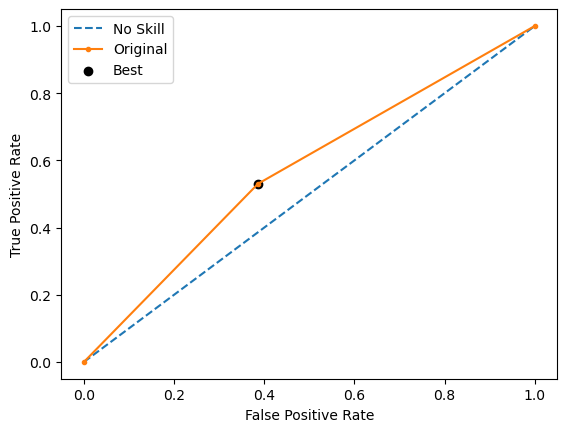

Run 4 - Random State: 3
Test G-mean: 0.5945042838654349
Best Threshold=0.731059, G-Mean=0.595


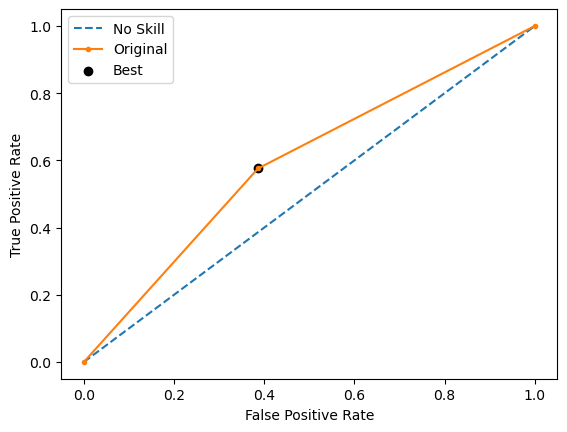

Run 5 - Random State: 4
Test G-mean: 0.5841952827718153
Best Threshold=0.731059, G-Mean=0.584


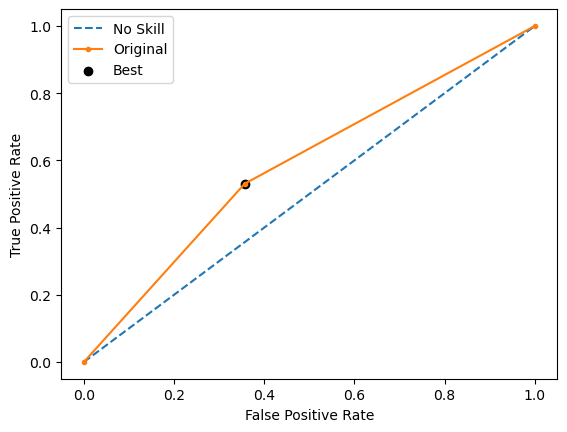

Ave Test G-mean: 0.5901829255344033
Stdev Test G-mean: 0.01635418115312937
Ave Test Specificity: 0.6188118811881188
Ave Test Recall: 0.5636363636363636
Ave Test NPV: 0.812956297450846
Ave Test Accuracy: 0.6052238805970149
Ave Test Precision: 0.325565864202131
Ave Test F1-Score: 0.41259362832246393
Ave Runtime: 0.24993081092834474


In [286]:
ho_t08_adaboost_gs, ho_t08_adaboost_be, ho_t08_adaboost_model_info, ho_t08_adaboost_metrics_df = adaboost_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits
Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 250, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.5554183683577887
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 GradientBoostingClassifier(max_depth=2, min_samples_leaf=3,
                                            n_estimators=250,
                                            random_state=0))])
Mean Train Score (G-mean) 0.8739859712005135
Std Train Score (G-mean) 0.010264201605379183
GridSearchCV Runtime: 95.3643696308136 secs
Run 1 - Random State: 0
Test G-mean: 0.5705546014671388
Best Threshold=0.317432, G-Mean=0.606


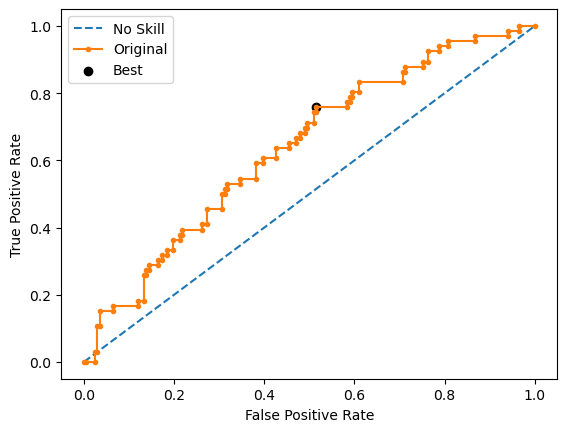

Run 2 - Random State: 1
Test G-mean: 0.5412756210377417
Best Threshold=0.352152, G-Mean=0.557


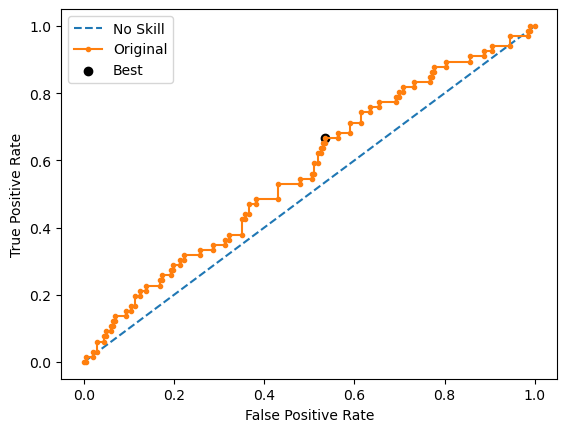

Run 3 - Random State: 2
Test G-mean: 0.5997174051973226
Best Threshold=0.461918, G-Mean=0.606


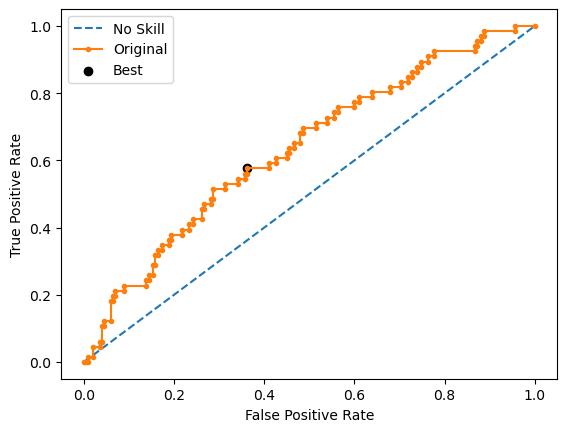

Run 4 - Random State: 3
Test G-mean: 0.5285148368714726
Best Threshold=0.386964, G-Mean=0.562


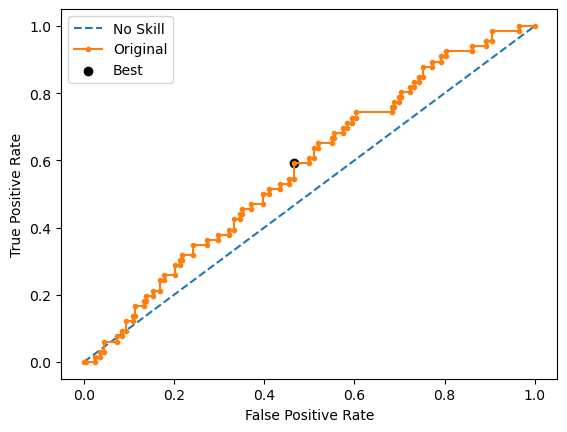

Run 5 - Random State: 4
Test G-mean: 0.5632776652529525
Best Threshold=0.553565, G-Mean=0.575


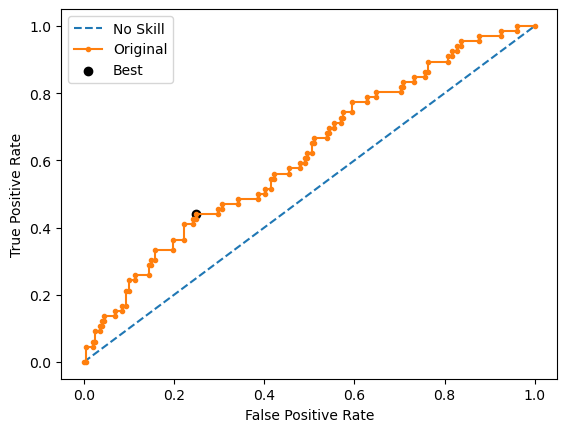

Ave Test G-mean: 0.5606680259653257
Stdev Test G-mean: 0.02756493038513496
Ave Test Specificity: 0.6702970297029702
Ave Test Recall: 0.4696969696969697
Ave Test NPV: 0.7944945666795336
Ave Test Accuracy: 0.6208955223880597
Ave Test Precision: 0.31827661659726403
Ave Test F1-Score: 0.37914584882009894
Ave Runtime: 0.4677495002746582


In [287]:
ho_t08_gbm_gs, ho_t08_gbm_be, ho_t08_gbm_model_info, ho_t08_gbm_metrics_df = gbm_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 2, 'classifier__max_leaves': 10, 'classifier__n_estimators': 200, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5948596762089723
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importance_t

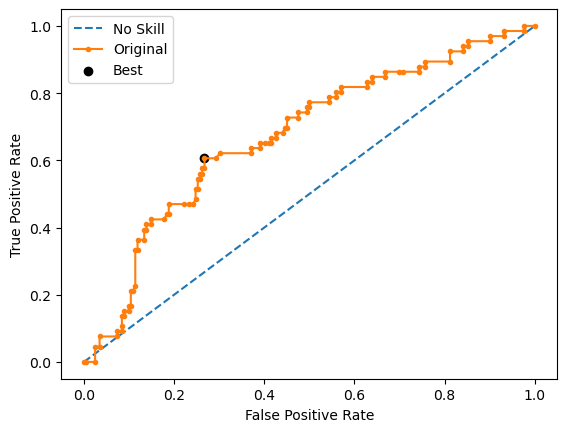

Run 2 - Random State: 1
Test G-mean: 0.5841952827718153
Best Threshold=0.457776, G-Mean=0.616


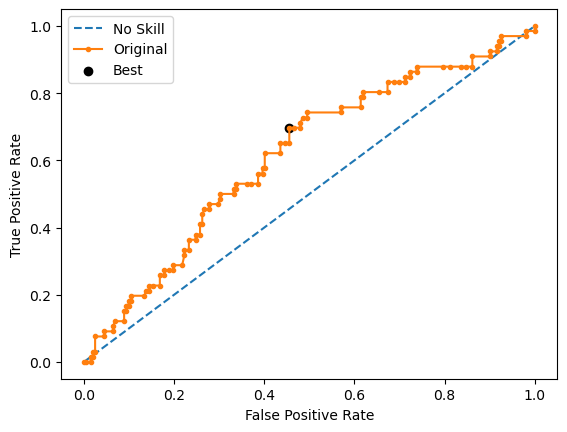

Run 3 - Random State: 2
Test G-mean: 0.6063718072905993
Best Threshold=0.508422, G-Mean=0.616


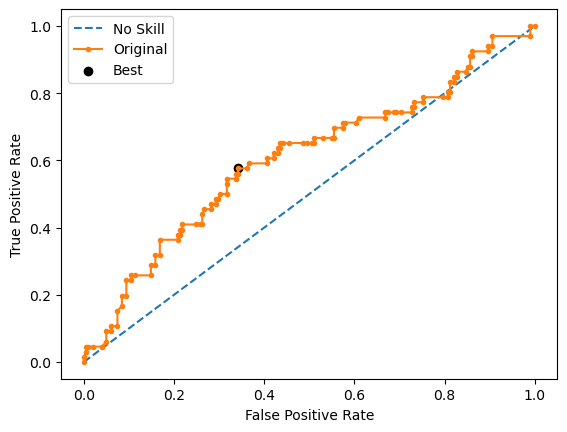

Run 4 - Random State: 3
Test G-mean: 0.644334165361162
Best Threshold=0.497775, G-Mean=0.648


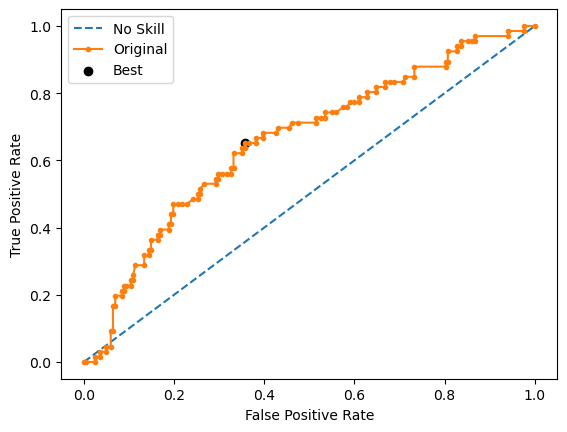

Run 5 - Random State: 4
Test G-mean: 0.6275263970048541
Best Threshold=0.484426, G-Mean=0.635


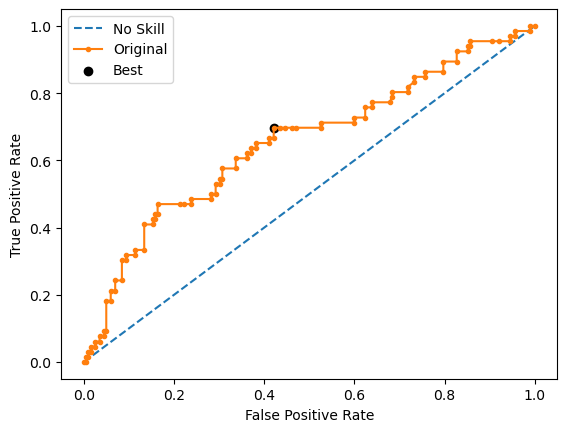

Ave Test G-mean: 0.6218287675230231
Stdev Test G-mean: 0.02652138884785633
Ave Test Specificity: 0.6485148514851485
Ave Test Recall: 0.5969696969696969
Ave Test NPV: 0.8313012276991074
Ave Test Accuracy: 0.6358208955223881
Ave Test Precision: 0.3570387044548672
Ave Test F1-Score: 0.4466619339413196
Ave Runtime: 0.19590449333190918


In [288]:
ho_t08_xgb_gs, ho_t08_xgb_be, ho_t08_xgb_model_info, ho_t08_xgb_metrics_df = xgb_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
Learning rate set to 0.006922
0:	learn: 0.6919902	total: 1.94ms	remaining: 1.93s
1:	learn: 0.6910596	total: 3.72ms	remaining: 1.85s
2:	learn: 0.6904154	total: 5.02ms	remaining: 1.67s
3:	learn: 0.6893298	total: 6.74ms	remaining: 1.68s
4:	learn: 0.6880167	total: 8.41ms	remaining: 1.67s
5:	learn: 0.6868941	total: 10.1ms	remaining: 1.67s
6:	learn: 0.6859046	total: 11.8ms	remaining: 1.67s
7:	learn: 0.6851172	total: 13.5ms	remaining: 1.67s
8:	learn: 0.6846377	total: 15.1ms	remaining: 1.66s
9:	learn: 0.6838396	total: 16.9ms	remaining: 1.67s
10:	learn: 0.6830388	total: 18.6ms	remaining: 1.67s
11:	learn: 0.6817997	total: 20.5ms	remaining: 1.68s
12:	learn: 0.6811250	total: 22.1ms	remaining: 1.68s
13:	learn: 0.6803405	total: 23.6ms	remaining: 1.66s
14:	learn: 0.6795190	total: 25.3ms	remaining: 1.66s
15:	learn: 0.6786109	total: 27ms	remaining: 1.66s
16:	learn: 0.6777963	total: 28.6ms	remaining: 1.66s
17:	learn: 0.6776718	total: 29.4ms	re

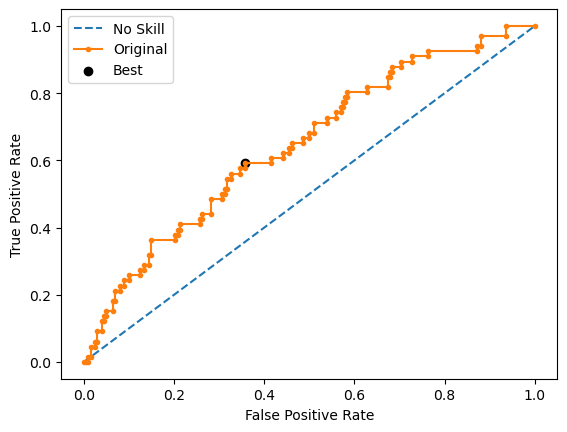

Learning rate set to 0.006922
0:	learn: 0.6914947	total: 2.43ms	remaining: 2.43s
1:	learn: 0.6902797	total: 5.23ms	remaining: 2.61s
2:	learn: 0.6895612	total: 8.84ms	remaining: 2.94s
3:	learn: 0.6881041	total: 12.1ms	remaining: 3s
4:	learn: 0.6871697	total: 15.5ms	remaining: 3.09s
5:	learn: 0.6860296	total: 18.7ms	remaining: 3.09s
6:	learn: 0.6848762	total: 22.1ms	remaining: 3.13s
7:	learn: 0.6838265	total: 24.8ms	remaining: 3.07s
8:	learn: 0.6823009	total: 27.5ms	remaining: 3.02s
9:	learn: 0.6812723	total: 30ms	remaining: 2.97s
10:	learn: 0.6799702	total: 32.4ms	remaining: 2.92s
11:	learn: 0.6782471	total: 35.1ms	remaining: 2.89s
12:	learn: 0.6767136	total: 37.2ms	remaining: 2.82s
13:	learn: 0.6753772	total: 39.3ms	remaining: 2.77s
14:	learn: 0.6740560	total: 41.1ms	remaining: 2.7s
15:	learn: 0.6733935	total: 43ms	remaining: 2.65s
16:	learn: 0.6724746	total: 44.9ms	remaining: 2.6s
17:	learn: 0.6715246	total: 46.9ms	remaining: 2.56s
18:	learn: 0.6703512	total: 48.7ms	remaining: 2.52s
1

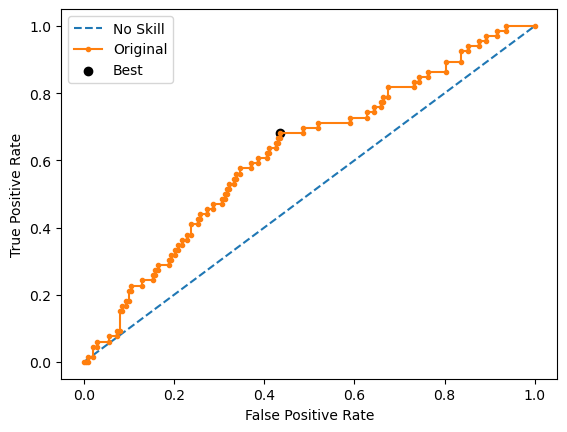

Learning rate set to 0.006922
0:	learn: 0.6916007	total: 2.8ms	remaining: 2.79s
1:	learn: 0.6906099	total: 4.75ms	remaining: 2.37s
2:	learn: 0.6896611	total: 6.39ms	remaining: 2.12s
3:	learn: 0.6885565	total: 8.21ms	remaining: 2.04s
4:	learn: 0.6874643	total: 9.97ms	remaining: 1.98s
5:	learn: 0.6855903	total: 11.6ms	remaining: 1.92s
6:	learn: 0.6845379	total: 14.1ms	remaining: 2s
7:	learn: 0.6830962	total: 16ms	remaining: 1.99s
8:	learn: 0.6819924	total: 17.8ms	remaining: 1.96s
9:	learn: 0.6802917	total: 19.7ms	remaining: 1.95s
10:	learn: 0.6793248	total: 21.3ms	remaining: 1.91s
11:	learn: 0.6779212	total: 23ms	remaining: 1.9s
12:	learn: 0.6760875	total: 24.7ms	remaining: 1.87s
13:	learn: 0.6749760	total: 26.3ms	remaining: 1.85s
14:	learn: 0.6737902	total: 27.8ms	remaining: 1.83s
15:	learn: 0.6727685	total: 29.6ms	remaining: 1.82s
16:	learn: 0.6716598	total: 31.3ms	remaining: 1.81s
17:	learn: 0.6705489	total: 32.8ms	remaining: 1.79s
18:	learn: 0.6692961	total: 34.5ms	remaining: 1.78s
1

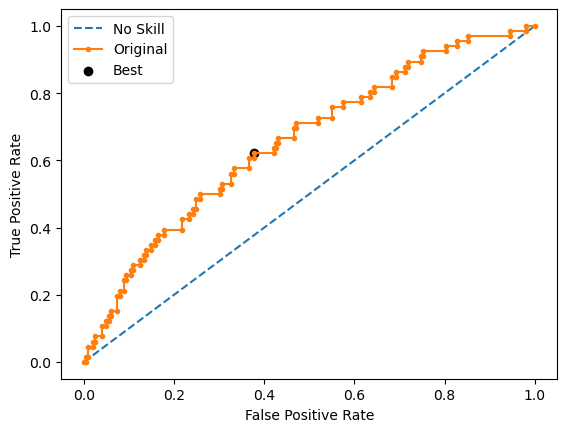

Learning rate set to 0.006922
0:	learn: 0.6921436	total: 2.39ms	remaining: 2.39s
1:	learn: 0.6907547	total: 4.16ms	remaining: 2.07s
2:	learn: 0.6900516	total: 6ms	remaining: 2s
3:	learn: 0.6892551	total: 7.88ms	remaining: 1.96s
4:	learn: 0.6882943	total: 9.63ms	remaining: 1.92s
5:	learn: 0.6872237	total: 11.4ms	remaining: 1.9s
6:	learn: 0.6865761	total: 13ms	remaining: 1.84s
7:	learn: 0.6848859	total: 14.6ms	remaining: 1.81s
8:	learn: 0.6838586	total: 16.3ms	remaining: 1.79s
9:	learn: 0.6831848	total: 17.9ms	remaining: 1.77s
10:	learn: 0.6820082	total: 19.5ms	remaining: 1.76s
11:	learn: 0.6806971	total: 21.2ms	remaining: 1.74s
12:	learn: 0.6795370	total: 22.8ms	remaining: 1.73s
13:	learn: 0.6787919	total: 24.5ms	remaining: 1.73s
14:	learn: 0.6776370	total: 26.1ms	remaining: 1.71s
15:	learn: 0.6763227	total: 27.8ms	remaining: 1.71s
16:	learn: 0.6756414	total: 29.4ms	remaining: 1.7s
17:	learn: 0.6746330	total: 31.1ms	remaining: 1.7s
18:	learn: 0.6734429	total: 32.9ms	remaining: 1.7s
19:	

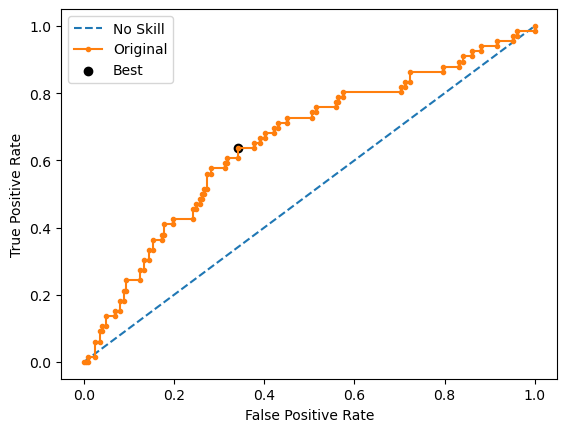

Learning rate set to 0.006922
0:	learn: 0.6914900	total: 2.05ms	remaining: 2.05s
1:	learn: 0.6902983	total: 4.27ms	remaining: 2.13s
2:	learn: 0.6895627	total: 5.91ms	remaining: 1.96s
3:	learn: 0.6890878	total: 7.64ms	remaining: 1.9s
4:	learn: 0.6880513	total: 9.66ms	remaining: 1.92s
5:	learn: 0.6862832	total: 11.2ms	remaining: 1.85s
6:	learn: 0.6854552	total: 12.8ms	remaining: 1.82s
7:	learn: 0.6838742	total: 14.6ms	remaining: 1.81s
8:	learn: 0.6822738	total: 16.2ms	remaining: 1.78s
9:	learn: 0.6812647	total: 17.7ms	remaining: 1.75s
10:	learn: 0.6803056	total: 19.3ms	remaining: 1.74s
11:	learn: 0.6787749	total: 20.9ms	remaining: 1.72s
12:	learn: 0.6771524	total: 22.5ms	remaining: 1.71s
13:	learn: 0.6759314	total: 24.1ms	remaining: 1.7s
14:	learn: 0.6745352	total: 25.7ms	remaining: 1.69s
15:	learn: 0.6733417	total: 27.3ms	remaining: 1.68s
16:	learn: 0.6725769	total: 29.2ms	remaining: 1.69s
17:	learn: 0.6714911	total: 30.8ms	remaining: 1.68s
18:	learn: 0.6702564	total: 32.6ms	remaining: 

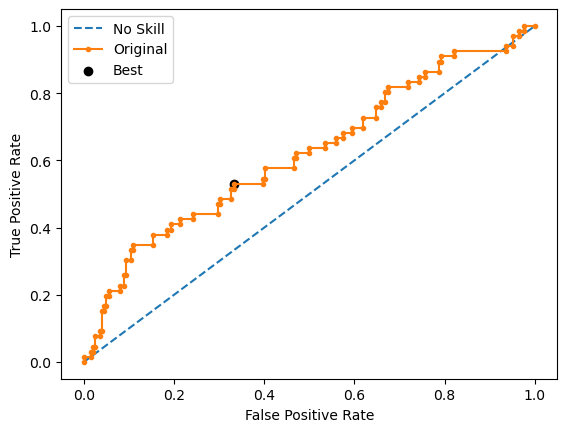

Ave Test G-mean: 0.6129672258498672
Stdev Test G-mean: 0.014948695302344868
Ave Test Specificity: 0.6336633663366337
Ave Test Recall: 0.593939393939394
Ave Test NPV: 0.8271293923959459
Ave Test Accuracy: 0.6238805970149255
Ave Test Precision: 0.3461636342354292
Ave Test F1-Score: 0.43716737663412797
Ave Runtime: 1.8529942512512207


In [289]:
ho_t08_catboost_gs, ho_t08_catboost_be, ho_t08_catboost_model_info, ho_t08_catboost_metrics_df = catboost_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits
Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.6002747134052935
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 RandomForestClassifier(max_depth=3, min_samples_leaf=3,
                                        n_estimators=300, oob_score=True,
                                        random_state=0))])
Mean Train Score (G-mean) 0.6277561829255867
Std Train Score (G-mean) 0.01965083989099662
GridSearchCV Runtime: 363.1061005592346 secs
Run 1 - Random State: 0
Test G-mean: 0.6350120660526092
Best Threshold=0.515332, G-Mean=0.652


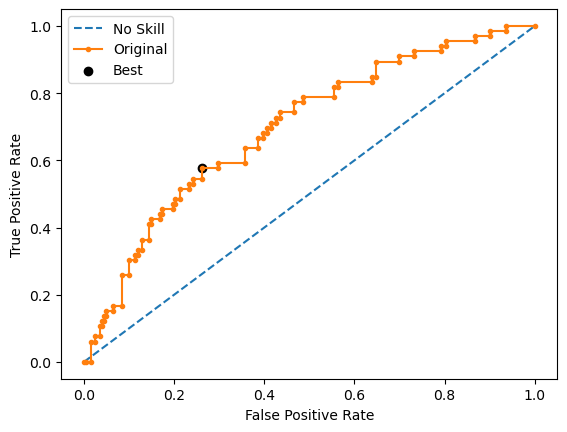

Run 2 - Random State: 1
Test G-mean: 0.5896904047696111
Best Threshold=0.498371, G-Mean=0.603


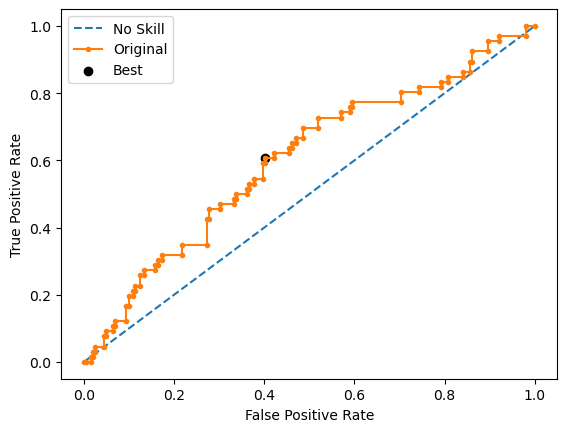

Run 3 - Random State: 2
Test G-mean: 0.5823949848615106
Best Threshold=0.523332, G-Mean=0.628


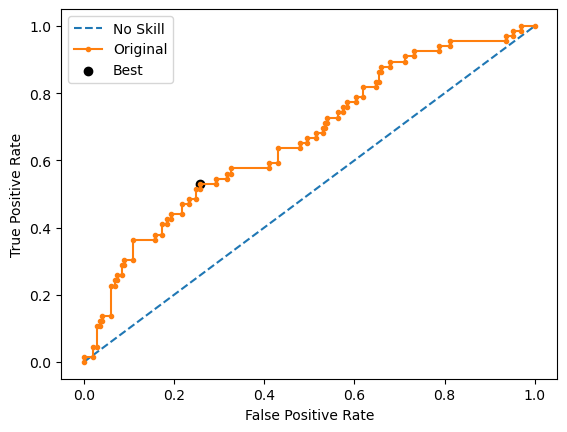

Run 4 - Random State: 3
Test G-mean: 0.659350797639189
Best Threshold=0.495704, G-Mean=0.668


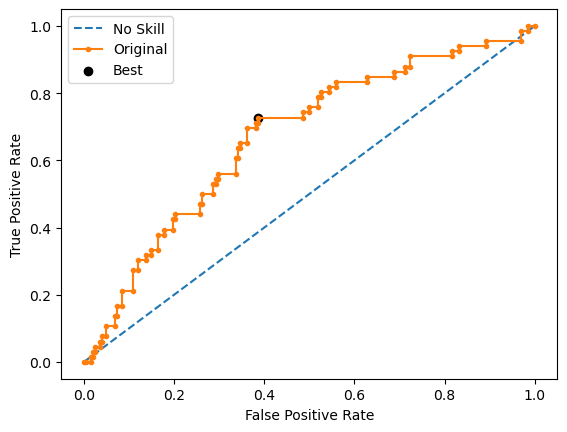

Run 5 - Random State: 4
Test G-mean: 0.5823305855706784
Best Threshold=0.536047, G-Mean=0.611


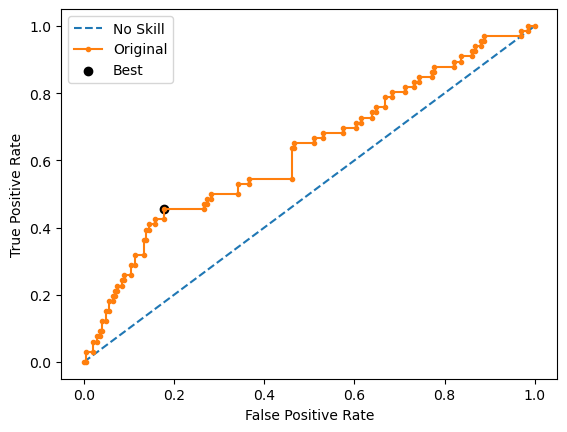

Ave Test G-mean: 0.6097557677787196
Stdev Test G-mean: 0.03535858963192227
Ave Test Specificity: 0.6257425742574257
Ave Test Recall: 0.596969696969697
Ave Test NPV: 0.8267716915172703
Ave Test Accuracy: 0.6186567164179105
Ave Test Precision: 0.3423872649609211
Ave Test F1-Score: 0.43455995572334
Ave Runtime: 0.5589699268341064


In [290]:
ho_t08_rf_gs, ho_t08_rf_be, ho_t08_rf_model_info, ho_t08_rf_metrics_df = rf_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [291]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t08_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t08_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t08_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall
6,LightGBM,0.625865,0.028014,0.596557,0.746088,0.618812,0.633333
7,Extreme Gradient Boosting (XGBoost),0.621829,0.026521,0.594860,0.853936,0.648515,0.596970
3,Decision Tree,0.614960,0.029296,0.596613,0.552078,0.633663,0.600000
4,Random Forest,0.609756,0.035359,0.600275,0.627756,0.625743,0.596970
8,AdaBoost,0.590183,0.016354,0.568463,0.943962,0.618812,0.563636
2,Logistic Regression,0.586591,0.028416,0.607898,NaN,0.626733,0.551515
5,Gradient Boosting Machine (GBM),0.560668,0.027565,0.555418,0.873986,0.670297,0.469697
0,k-Nearest Neighbors,0.518880,0.036668,0.559415,0.686828,0.485149,0.557576
1,SVM Classifier,0.517793,0.028331,0.527184,0.251731,0.590099,0.457576


# HO-T07 Runs: Retain Top 30 Features

In [ ]:
model = ho_t07_logreg_be.named_steps['classifier']
coefficients = model.coef_[0]

# 3. Get Absolute Values of Coefficients
abs_coefficients = abs(coefficients)

# 4. Sort Features Based on Absolute Coefficient Values
sorted_idx = abs_coefficients.argsort()[::-1]
top_20_features = sorted_idx[:20]

# 5. Retain Only the Top 20 Features and Extract the Feature Names
feature_names = list(ho_t07_X_num.columns)  # Assuming X is a DataFrame before train-test split
top_20_feature_names = [feature_names[i] for i in top_20_features]

# Place all dropped features into a list
dropped_features = [feature for feature in feature_names if feature not in top_20_feature_names]

# 6. (Optional) Print the Top 20 Features and Dropped Features
print("Top 20 Features:", top_20_feature_names)
print("Dropped Features:", dropped_features)

sorted_indices = abs_coefficients.argsort()[::-1]
top_20_indices = sorted_indices[:20]
top_20_importances = coefficients[top_20_indices]
# Plot
plt.figure(figsize=(10, 8))
plt.barh(top_20_feature_names, top_20_importances, align='center')
plt.xlabel('Importance')
plt.title('Top 20 Feature Importances from Logistic Regression')
plt.gca().invert_yaxis()  # To display the feature with the highest importance at the top
plt.show()

ho_t08_full = ho_t07_full.copy()
ho_t08_logreg = ho_t08_full.copy().drop(columns=dropped_features).drop(['gender', 'province', 'job'], axis=1)

In [ ]:
ho_t08_logreg_gs, ho_t08_logreg_be, ho_t08_logreg_model_info, ho_t08_logreg_metrics_df = logreg_class2(ho_t08_logreg, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t06_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t06_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t06_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall'
]].sort_values(by='Average Test G-mean', ascending=False)

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits
Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 2, 'classifier__max_features': None, 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': RandomOverSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5861334092522169
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(criterion='entropy', max_depth=2,
                                        random_state=0))])
Mean Train Score (G-mean) 0.5045626356168336
Std Train Score (G-mean) 0.04940561535709203
GridSearchCV Runtime: 45.98888087272644 secs
Run 1 - Random State: 0
Test G-mean: 0.656661815518841
Best Threshold=0.534946, G-Mean=0.657


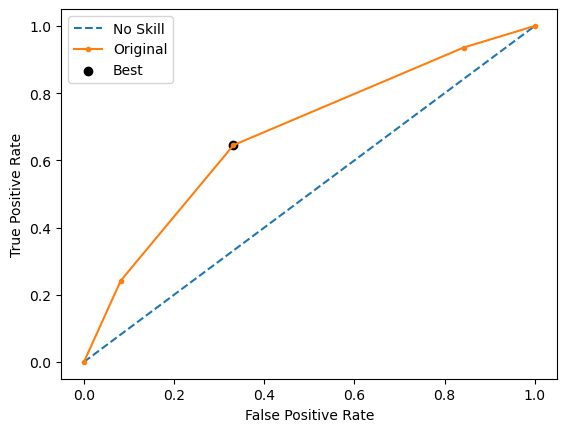

Run 2 - Random State: 1
Test G-mean: 0.6201838798020258
Best Threshold=0.544959, G-Mean=0.620


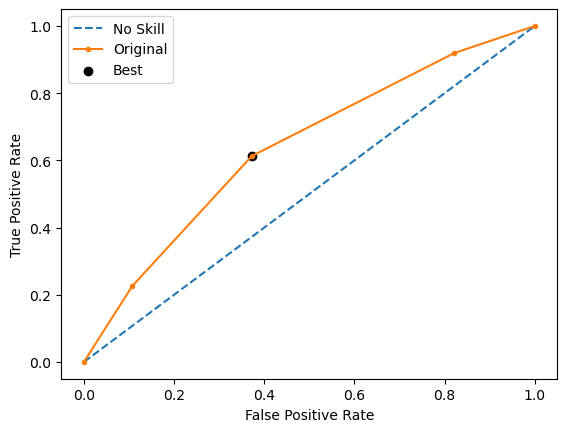

Run 3 - Random State: 2
Test G-mean: 0.6389409646336904
Best Threshold=0.544160, G-Mean=0.639


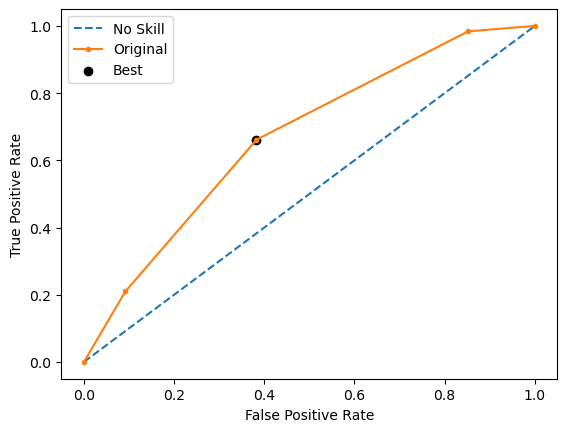

Run 4 - Random State: 3
Test G-mean: 0.5849494838167749
Best Threshold=0.627750, G-Mean=0.598


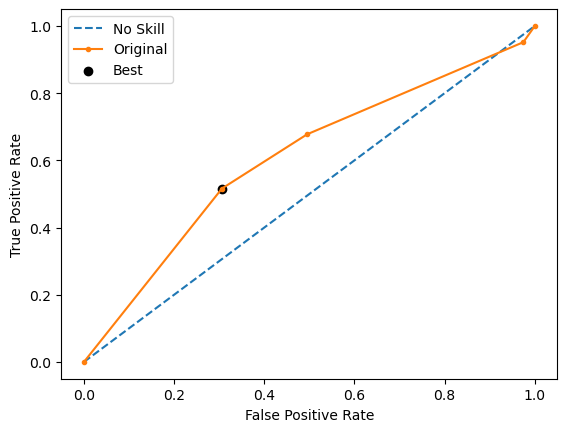

Run 5 - Random State: 4
Test G-mean: 0.5550652506880571
Best Threshold=0.665988, G-Mean=0.578


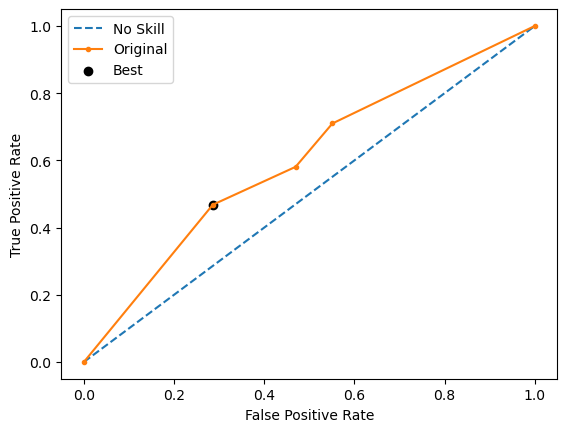

Ave Test G-mean: 0.6111602788918779
Stdev Test G-mean: 0.041101215543893344
Ave Test Specificity: 0.5897959183673469
Ave Test Recall: 0.635483870967742
Ave Test NPV: 0.835397858673986
Ave Test Accuracy: 0.6007751937984496
Ave Test Precision: 0.3320302545076174
Ave Test F1-Score: 0.435176049606957
Ave Runtime: 0.01431121826171875


In [218]:
ho_t06_dt_gs, ho_t06_dt_be, ho_t06_dt_model_info, ho_t06_dt_metrics_df = dt_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits
Best Hyperparameters: {'classifier__C': 0.0001, 'classifier__penalty': 'l2', 'classifier__solver': 'newton-cholesky', 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5511833423722067
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 LogisticRegression(C=0.0001, max_iter=1000, random_state=0,
                                    solver='newton-cholesky'))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 10.8058762550354 secs
Run 1 - Random State: 0
Test G-mean: 0.5659297639246875
Best Threshold=0.499760, G-Mean=0.608



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\linear_model\_logistic.py", line 1216, in fit
    self.coef_, self.intercept_, self.n_iter_ = _fit_liblinear(
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\

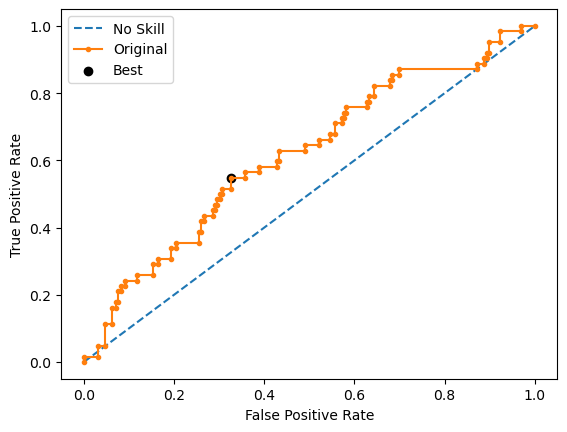

Run 2 - Random State: 1
Test G-mean: 0.5654933702621115
Best Threshold=0.499058, G-Mean=0.611


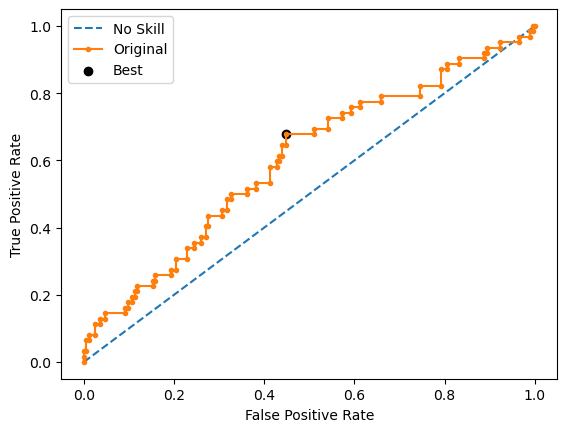

Run 3 - Random State: 2
Test G-mean: 0.5301942953139067
Best Threshold=0.499201, G-Mean=0.573


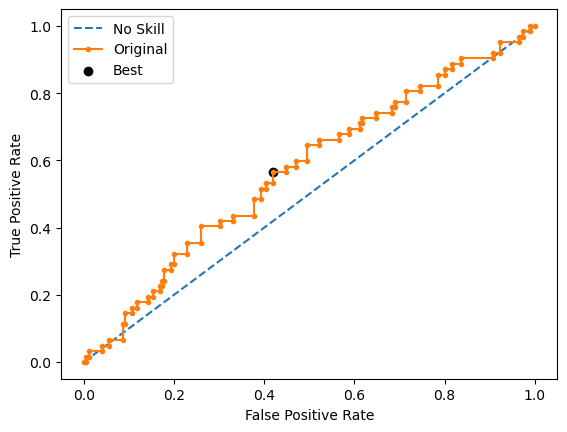

Run 4 - Random State: 3
Test G-mean: 0.5483532112057258
Best Threshold=0.498981, G-Mean=0.594


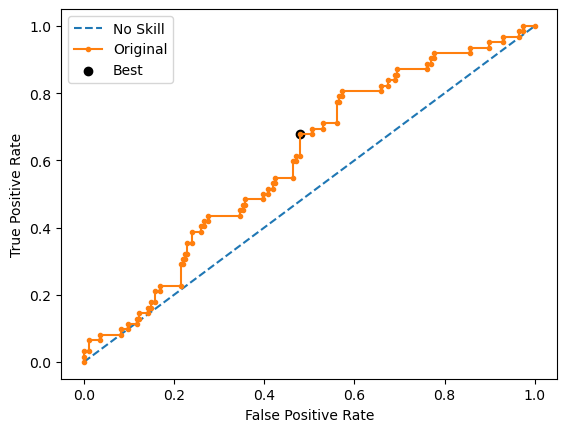

Run 5 - Random State: 4
Test G-mean: 0.5253607807660214
Best Threshold=0.498774, G-Mean=0.565


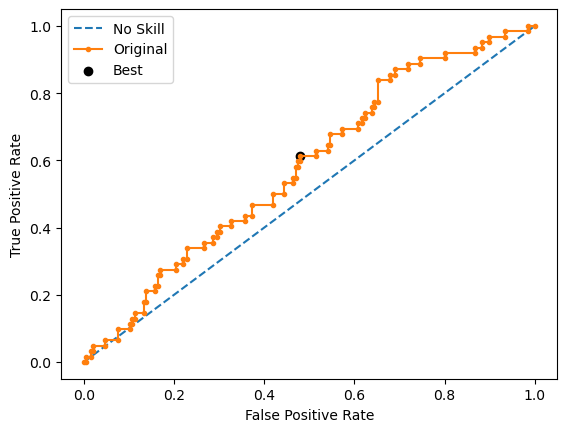

Ave Test G-mean: 0.5470662842944906
Stdev Test G-mean: 0.019058052349841127
Ave Test Specificity: 0.6632653061224489
Ave Test Recall: 0.4516129032258064
Ave Test NPV: 0.7924371423462934
Ave Test Accuracy: 0.6124031007751938
Ave Test Precision: 0.29902041454223616
Ave Test F1-Score: 0.3594466162158999
Ave Runtime: 0.02246723175048828


In [219]:
ho_t06_logreg_gs, ho_t06_logreg_be, ho_t06_logreg_model_info, ho_t06_logreg_metrics_df = logreg_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]Best Hyperparameters: {'classifier__C': 1e-06, 'classifier__kernel': 'rbf', 'classifier__probability': True, 'resampling': RandomOverSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5836024379939667
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 SVC(C=1e-06, max_iter=1000, probability=True, random_state=0,
                     verbose=True))])
Mean Train Score (G-mean) 0.5219879195852732
Std Train Score (G-mean) 0.020408923537523802
GridSearchCV Runtime: 95.23027992248535 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.585792958636764
Best Threshold=0.486451, G-Mean=0.421


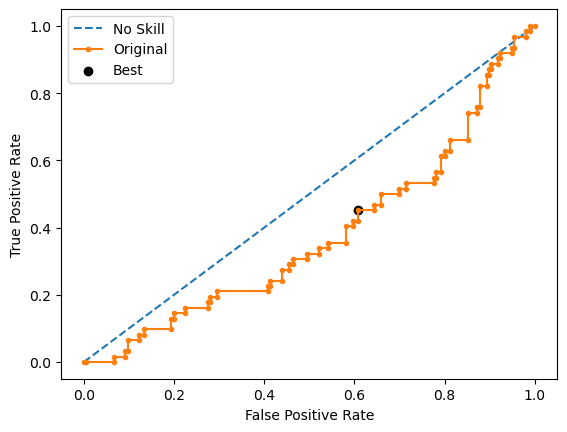

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.5745880397335743
Best Threshold=0.486451, G-Mean=0.432


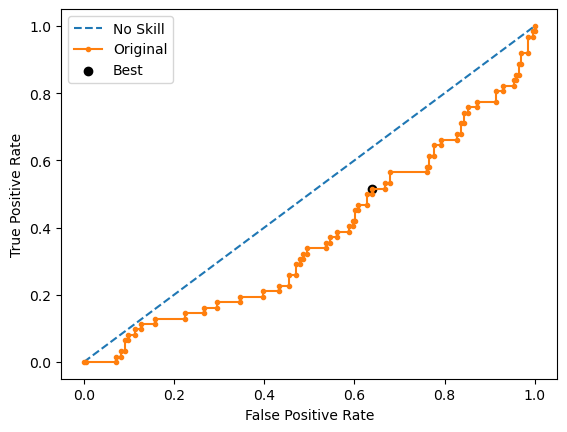

[LibSVM]Run 3 - Random State: 2
Test G-mean: 0.6000192009216492
Best Threshold=0.486451, G-Mean=0.416


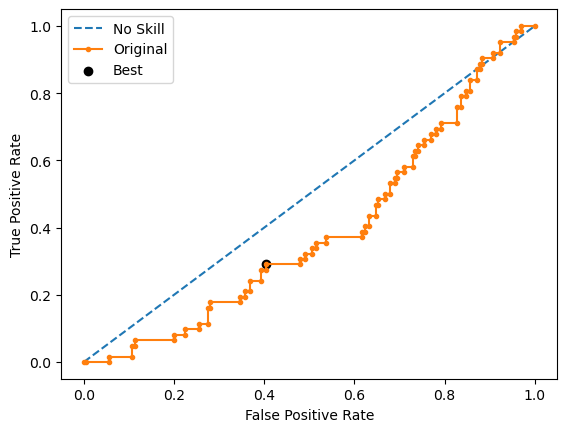

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.5868455973269637
Best Threshold=0.486451, G-Mean=0.429


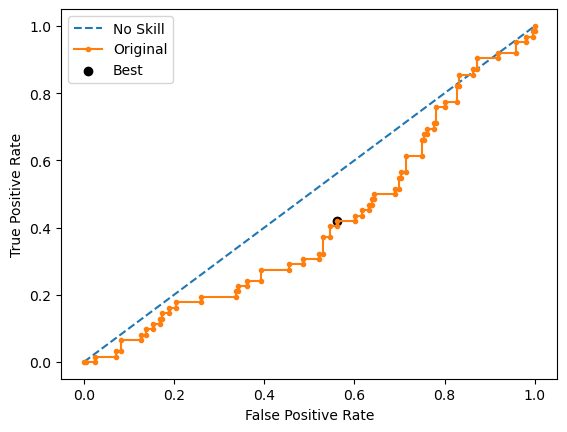

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.5479028183484553
Best Threshold=0.486451, G-Mean=0.468


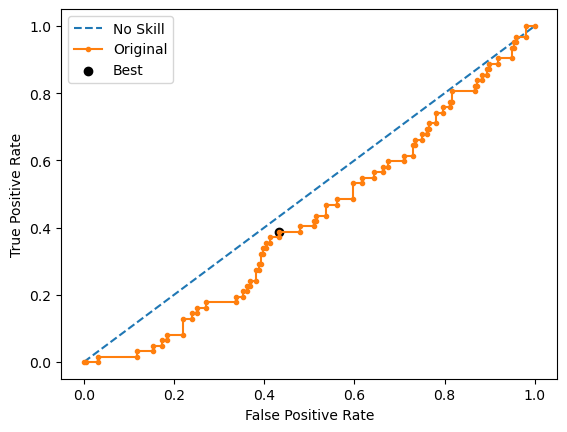

Ave Test G-mean: 0.5790297229934813
Stdev Test G-mean: 0.019595919056159893
Ave Test Specificity: 0.6438775510204081
Ave Test Recall: 0.5225806451612903
Ave Test NPV: 0.8096745549851413
Ave Test Accuracy: 0.6147286821705427
Ave Test Precision: 0.3192491940297407
Ave Test F1-Score: 0.3952779188719943
Ave Runtime: 0.5335601806640625


In [222]:
ho_t06_svm_gs, ho_t06_svm_be, ho_t06_svm_model_info, ho_t06_svm_metrics_df = svm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [223]:
ho_t06_knn_gs, ho_t06_knn_be, ho_t06_knn_model_info, ho_t06_knn_metrics_df = knn_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
Best Hyperparameters: {'classifier__metric': 'canberra', 'classifier__n_neighbors': 1, 'resampling': EditedNearestNeighbours(), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5619438248924814
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 KNeighborsClassifier(metric='canberra', n_neighbors=1))])
Mean Train Score (G-mean) 0.6926051073868732
Std Train Score (G-mean) 0.01508746870546176
GridSearchCV Runtime: 63.536158084869385 secs
Run 1 - Random State: 0
Test G-mean: 0.5439837932759934
Run 2 - Random State: 1
Test G-mean: 0.5794369699170472
Run 3 - Random State: 2
Test G-mean: 0.47657434604418136
Run 4 - Random State: 3
Test G-mean: 0.509133174976598
Run 5 - Random State: 4
Test G-mean: 0.4968631026001803
Ave Test G-mean: 0.5211982773628001
Stdev Test G-mean: 0.040743059895226606
Ave Test 

In [ ]:
ho_t06_xgb_gs, ho_t06_xgb_be, ho_t06_xgb_model_info, ho_t06_xgb_metrics_df = xgb_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 540 candidates, totalling 5400 fits


In [ ]:
ho_t06_lgbm_gs, ho_t06_lgbm_be, ho_t06_lgbm_model_info, ho_t06_lgbm_metrics_df = lgbm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t06_adaboost_gs, ho_t06_adaboost_be, ho_t06_adaboost_model_info, ho_t06_adaboost_metrics_df = adaboost_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t06_rf_gs, ho_t06_rf_be, ho_t06_rf_model_info, ho_t06_rf_metrics_df = rf_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t06_gbm_gs, ho_t06_gbm_be, ho_t06_gbm_model_info, ho_t06_gbm_metrics_df = gbm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t06_catboost_gs, ho_t06_catboost_be, ho_t06_catboost_model_info, ho_t06_catboost_metrics_df = catboost_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t06_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t06_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t06_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall'
]].sort_values(by='Average Test G-mean', ascending=False)

# HO-T07 Runs

In [ ]:
ho_t07_dt_gs, ho_t07_dt_be, ho_t07_dt_model_info, ho_t07_dt_metrics_df = dt_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_logreg_gs, ho_t07_logreg_be, ho_t07_logreg_model_info, ho_t07_logreg_metrics_df = logreg_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_svm_gs, ho_t07_svm_be, ho_t07_svm_model_info, ho_t07_svm_metrics_df = svm_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_knn_gs, ho_t07_knn_be, ho_t07_knn_model_info, ho_t07_knn_metrics_df = knn_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_xgb_gs, ho_t07_xgb_be, ho_t07_xgb_model_info, ho_t07_xgb_metrics_df = xgb_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_lgbm_gs, ho_t07_lgbm_be, ho_t07_lgbm_model_info, ho_t07_lgbm_metrics_df = lgbm_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_adaboost_gs, ho_t07_adaboost_be, ho_t07_adaboost_model_info, ho_t07_adaboost_metrics_df = adaboost_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_rf_gs, ho_t07_rf_be, ho_t07_rf_model_info, ho_t07_rf_metrics_df = rf_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_gbm_gs, ho_t07_gbm_be, ho_t07_gbm_model_info, ho_t07_gbm_metrics_df = gbm_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_catboost_gs, ho_t07_catboost_be, ho_t07_catboost_model_info, ho_t07_catboost_metrics_df = catboost_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t07_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t07_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t07_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall'
]].sort_values(by='Average Test G-mean', ascending=False)

# Best Model Explainability Methods

In [301]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt

# Access the trained Random Forest model from the dictionary
model = ho_t02_xgb_be.named_steps.classifier

# Ensure the model has been trained
if hasattr(model, "estimators_"):
    # Visualize the first tree
    plt.figure(figsize=(20, 10))
    plot_tree(model.estimators_[0], filled=True, feature_names=X_train.columns, class_names=True, rounded=True)
    plt.show()
else:
    print("The model hasn't been trained yet.")

The model hasn't been trained yet.


In [302]:
from sklearn.tree import _tree

def tree_rules(tree, feature_names):
    tree_ = tree.tree_
    feature_name = [
        feature_names[i] if i != _tree.TREE_UNDEFINED else "undefined!"
        for i in tree_.feature
    ]

    def recurse(node, depth):
        indent = "  " * depth
        if tree_.feature[node] != _tree.TREE_UNDEFINED:
            name = feature_name[node]
            threshold = tree_.threshold[node]
            yield f"{indent}if {name} <= {threshold:.2f}:"
            yield from recurse(tree_.children_left[node], depth + 1)
            yield f"{indent}else:  # if {name} > {threshold:.2f}"
            yield from recurse(tree_.children_right[node], depth + 1)
        else:
            yield f"{indent}return Class {tree_.value[node].argmax()}"

    return "\n".join(recurse(0, 1))

In [303]:
model = ho_t02_xgb_be.named_steps.classifier
rules = tree_rules(model.estimators_[0], X_train.columns)
print(rules)

AttributeError: 'XGBClassifier' object has no attribute 'estimators_'

In [304]:
from xgboost import plot_tree

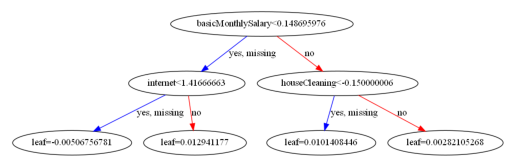

In [313]:
df = ho_t02
model = ho_t02_xgb_be
label_col = 'home_ownership_class'
X = df.drop(['userId', 'lastFirstName', label_col], axis=1)

model.named_steps['classifier'].get_booster().feature_names = X.columns.to_list()

plot_tree(model.named_steps['classifier'],
          rank_dir='LR'); plt.show()

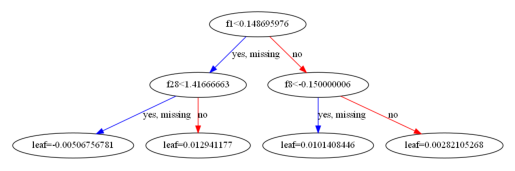

In [118]:
# model.named_steps['classifier'].feature_importances_

Permutation explainer: 269it [00:13,  4.83it/s]                         


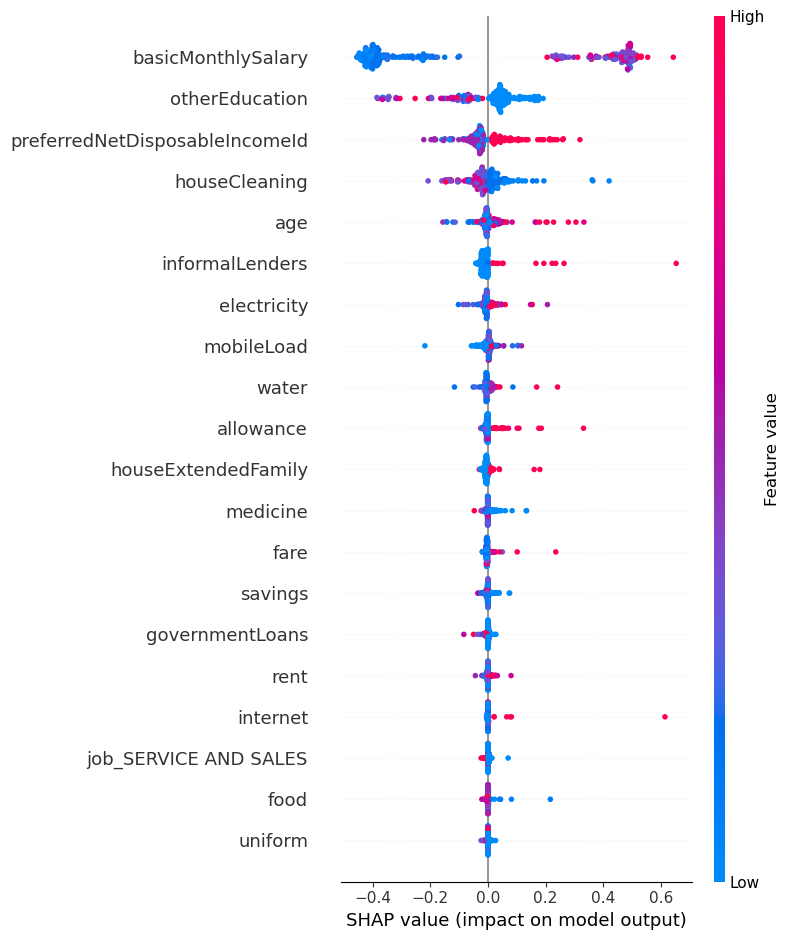

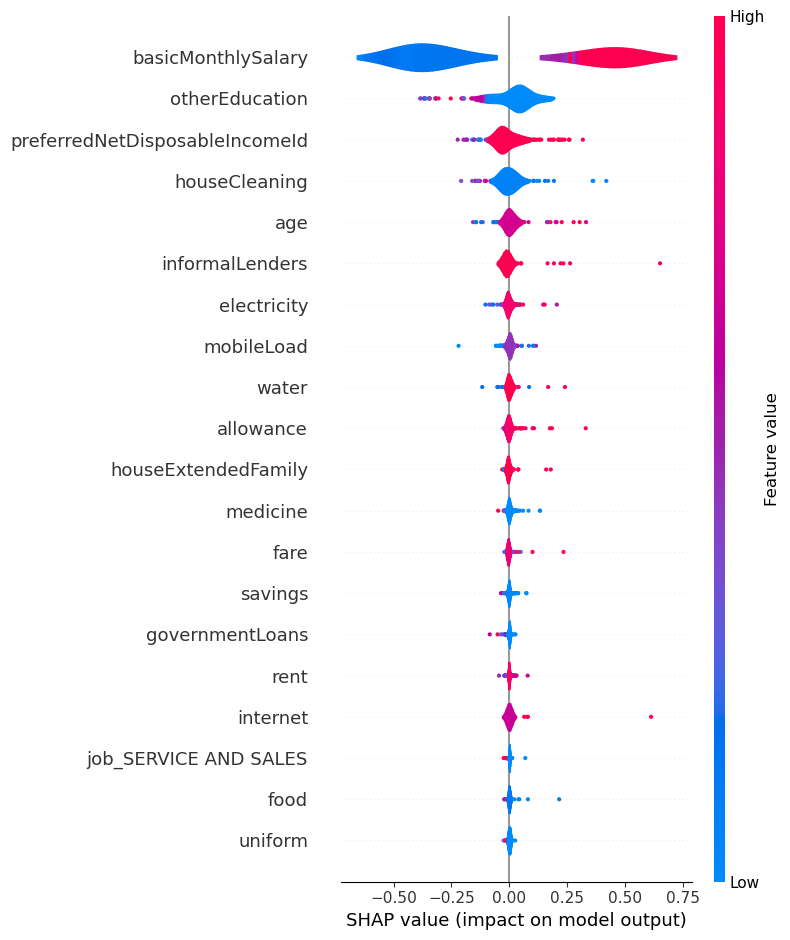

In [325]:
df = ho_t02
# model = ho_t02_xgb_be.named_steps['classifier']
model = ho_t02_xgb_be
label_col = 'home_ownership_class'
X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
y = df.loc[:, label_col]
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.25,
                                                    stratify=y,
                                                    random_state=0)

# input = ho_t12_adaboost_c0.drop(['user_id', 'lastFirstName', 'home_ownership_class'], axis=1)
# Fits the explainer
explainer = shap.Explainer(model.predict, X_test)
# explainer = shap.TreeExplainer(model=model,
#                                data=X_test,
#                                model_output='raw',
# #                                feature_perturbation='tree_path_dependent'
#                               )

# Calculates the SHAP values - It takes some time
shap_values = explainer(X_test)
# shap_values = explainer.shap_values(X_test)


feature_names = X.columns

shap.summary_plot(shap_values, feature_names=feature_names, plot_type='dot')
shap.summary_plot(shap_values, feature_names=feature_names, plot_type='violin')

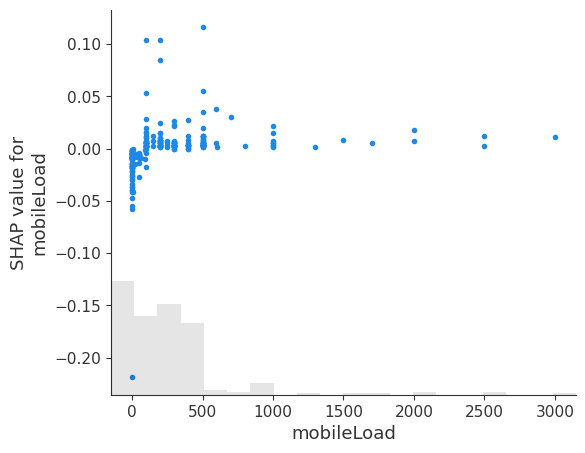

In [354]:
feature_name = 'mobileLoad' # Replace with the name of the feature you're interested in

shap.plots.scatter(shap_values[:, feature_name])
plt.show()

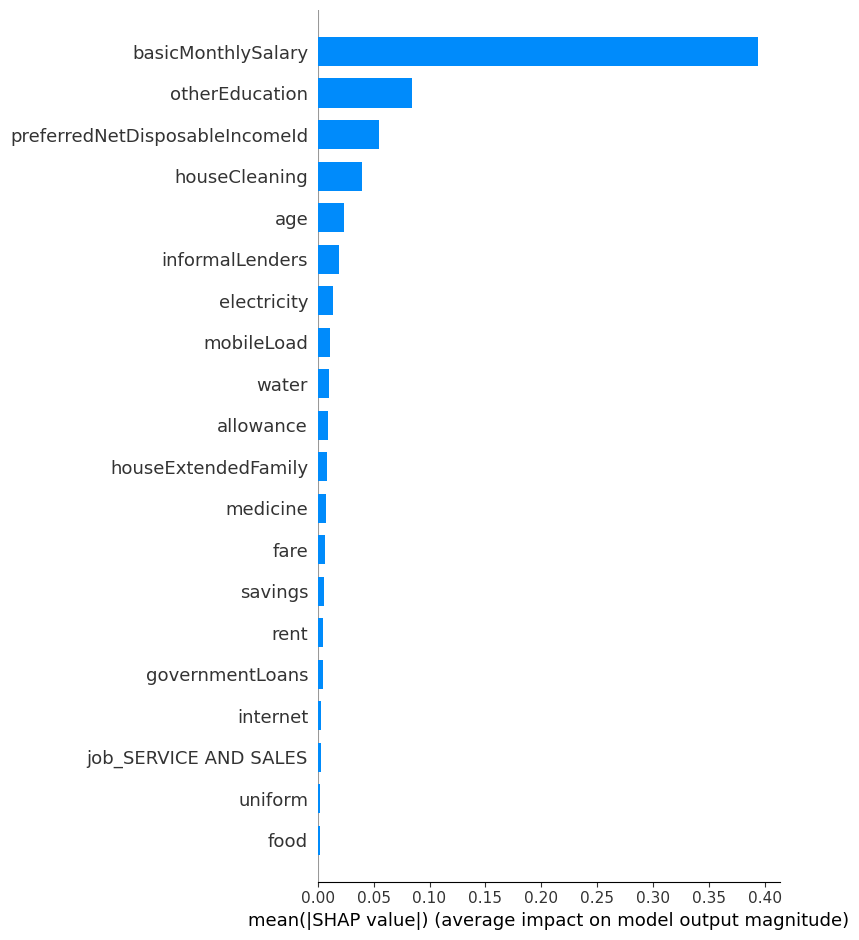

In [315]:
shap.summary_plot(shap_values, feature_names=feature_names,
                  plot_type='bar')

Permutation explainer: 269it [00:13,  4.92it/s]                         


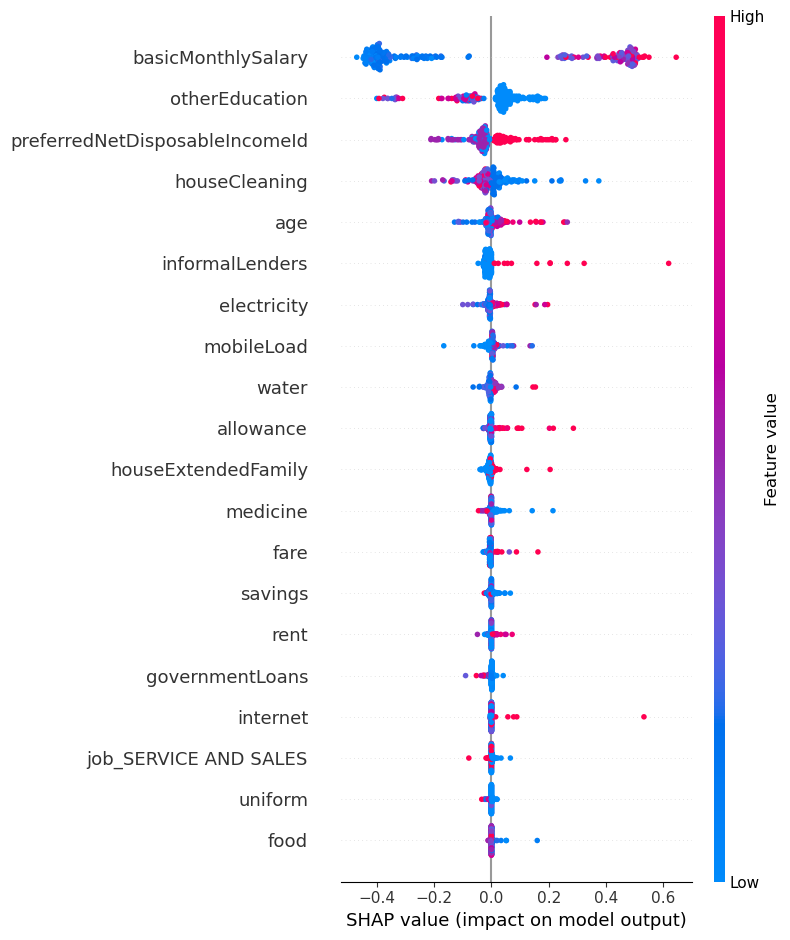

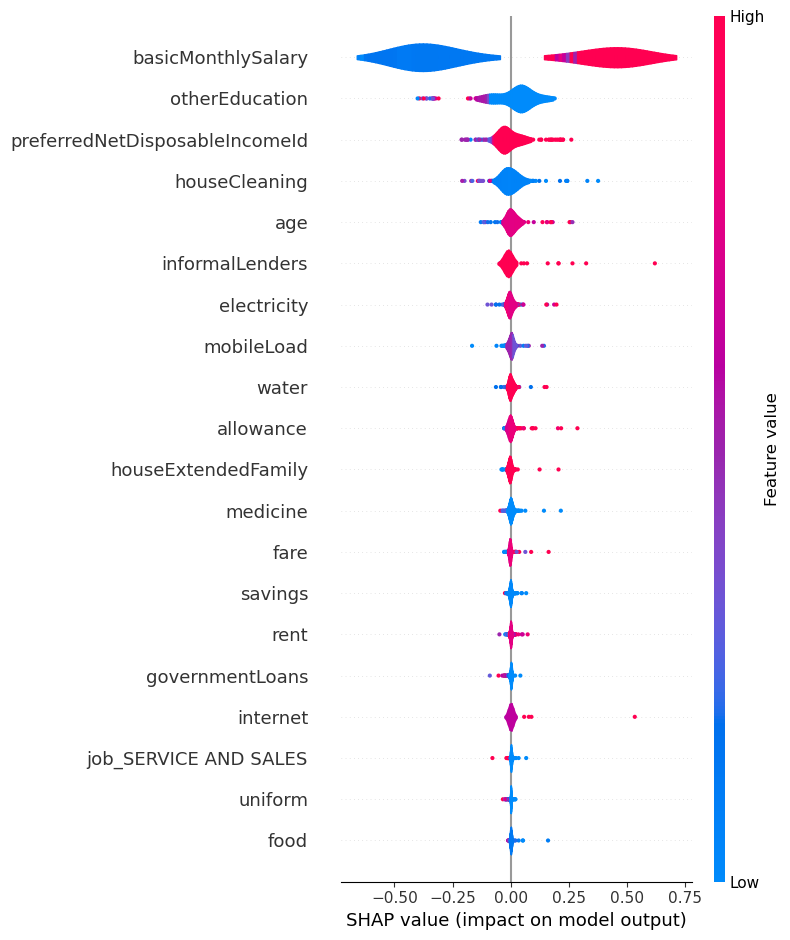

In [296]:
df = ho_t02
model = ho_t02_xgb_be
label_col = 'home_ownership_class'
X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
y = df.loc[:, label_col]
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.25,
                                                    stratify=y,
                                                    random_state=0)

# input = ho_t12_adaboost_c0.drop(['user_id', 'lastFirstName', 'home_ownership_class'], axis=1)
# Fits the explainer
explainer = shap.Explainer(model.predict, X_test)

# Calculates the SHAP values - It takes some time
shap_values = explainer(X_test)

feature_names = X.columns

shap.summary_plot(shap_values, feature_names=feature_names, plot_type='dot')
shap.summary_plot(shap_values, feature_names=feature_names, plot_type='violin')

In [47]:
def adjust_data_types(df):
    for col in df.columns:
        unique_vals = df[col].unique()
        if df[col].dtypes == 'object':
            None
#         elif (set(unique_vals) == {0, 1}) or col == 'userId':
#             df[col] = df[col].astype('int64')
#         else:
#             df[col] = df[col].astype('float64')
        elif (set(unique_vals) != {0, 1}):
            df[col] = df[col].astype('float64')
        else:
            df[col] = df[col].astype('int64')
    return df

In [355]:
ho_t02
df = ho_t02.copy()
df['userId'] = df['userId'].astype('str')
df = adjust_data_types(df)

# ho_t03_dice['gender_MALE'] = ho_t03_dice['userId'].astype('str')
# ho_t03_dice['province_CAVITE'] = ho_t03_dice['userId'].astype('str')
# ho_t03_dice['province_METRO MANILA'] = ho_t03_dice['userId'].astype('str')
# ho_t03_dice['job_ASSOCIATE PROFESSIONAL'] = ho_t03_dice['userId'].astype('str')
# ho_t03_dice['job_SERVICE AND SALES'] = ho_t03_dice['userId'].astype('str')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1070 entries, 0 to 1069
Data columns (total 55 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   userId                          1070 non-null   object 
 1   lastFirstName                   1070 non-null   object 
 2   age                             1070 non-null   float64
 3   basicMonthlySalary              1070 non-null   float64
 4   preferredNetDisposableIncomeId  1070 non-null   float64
 5   workingFamilyCount              1070 non-null   float64
 6   residentsCount                  1070 non-null   float64
 7   monthlyFamilyIncome             1070 non-null   float64
 8   food                            1070 non-null   float64
 9   hygiene                         1070 non-null   float64
 10  houseCleaning                   1070 non-null   float64
 11  fare                            1070 non-null   float64
 12  parking                         10

In [359]:
items_list = [
    'food', 'hygiene', 'houseCleaning',
    'fare', 'parking', 'gasoline', 'tuition', 'allowance',
    'uniform', 'otherEducation', 'emergency', 'medicine',
    'water', 'electricity', 'rent', 'repair', 
    'dineOut', 'leisure', 'personalCare', 'clothing',
    'mobileLoad', 'internet', 
    'smoking', 'gambling',
]

result_dict = {}
for item in items_list:
    result_dict[item] = [0, query_instance[item].values[0]]

print(result_dict)

{'food': [0, 3000.0], 'hygiene': [0, 1000.0], 'houseCleaning': [0, 1000.0], 'fare': [0, 2000.0], 'parking': [0, 0.0], 'gasoline': [0, 0.0], 'tuition': [0, 0.0], 'allowance': [0, 0.0], 'uniform': [0, 0.0], 'otherEducation': [0, 0.0], 'emergency': [0, 1000.0], 'medicine': [0, 1000.0], 'water': [0, 500.0], 'electricity': [0, 1500.0], 'rent': [0, 500.0], 'repair': [0, 0.0], 'dineOut': [0, 0.0], 'leisure': [0, 0.0], 'personalCare': [0, 0.0], 'clothing': [0, 1000.0], 'mobileLoad': [0, 2000.0], 'internet': [0, 0.0], 'smoking': [0, 0.0], 'gambling': [0, 0.0]}


In [419]:
df = df
model = ho_t02_xgb_be


X = df.drop(['userId', 'lastFirstName'], axis=1)
y = df.loc[:, label_col]
X_train, X_test, _, _ = train_test_split(X, y,
                                         test_size=0.25,
                                         stratify=y,
                                         random_state=0)

X_train
# Dataset for training an ML model
d = dice_ml.Data(dataframe=X_train,
                 continuous_features=X_train.drop(columns='home_ownership_class').columns.to_list(),
                 outcome_name='home_ownership_class')

# Pre-trained ML model
m = dice_ml.Model(model=model, backend='sklearn')
#                   backend='TF2', func="ohe-min-max")
# DiCE explanation instance
# exp = dice_ml.Dice(d, m, method='genetic')
exp = dice_ml.Dice(d, m)

In [421]:
max_limit = len(X_test[X_test['home_ownership_class'] == 0])

init = 40
for i in range(init, max_limit):
    try:
        # Generate counterfactual examples
        query_instance = X_test[X_test['home_ownership_class'] == 0].drop(columns="home_ownership_class")[i:i+1]
        dice_exp = exp.generate_counterfactuals(
            query_instance, total_CFs=1,
            desired_class="opposite", verbose=True,
           features_to_vary=[
                'food', 'hygiene', 'houseCleaning',
                'fare', 'parking', 'gasoline', 'tuition', 'allowance',
                'uniform', 'otherEducation', 'emergency', 'medicine',
                'water', 'electricity', 'rent', 'repair', 
                'dineOut', 'leisure', 'personalCare', 'clothing',
                'mobileLoad', 'internet', 
                'smoking', 'gambling', 'savings', 'payFamilySupport'
            ],
            permitted_range=result_dict
        )
        # Visualize counterfactual explanation
        dice_exp.visualize_as_dataframe(display_sparse_df=False,
                                        show_only_changes=True)
        break
    except Exception as e:
        print(f"Error at i={i}: {e}")
        continue


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


No Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 01 sec
Error at i=40: No counterfactuals found for any of the query points! Kindly check your configuration.


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


No Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 01 sec
Error at i=41: No counterfactuals found for any of the query points! Kindly check your configuration.


100%|██████████| 1/1 [00:00<00:00,  2.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Query instance (original outcome : 1)


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES,home_ownership_class
0,38.0,31000.0,2.0,1.0,4.0,31000.0,4000.0,1000.0,1000.0,2000.0,0.0,0.0,0.0,1000.0,500.0,0.0,2000.0,1000.0,1000.0,500.0,0.0,0.0,0.0,0.0,0.0,500.0,0.0,500.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,1,1,1,1,0,1,0,1,0,0,0,0,1



Diverse Counterfactual set without sparsity correction (new outcome:  0.0


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES,home_ownership_class
0,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,159.3,-,-,-,-,-,-,95.9,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,0.0


In [422]:
df = df
model = ho_t02_xgb_be
i = 42

X = df.drop(['userId', 'lastFirstName'], axis=1)
y = df.loc[:, label_col]
X_train, X_test, _, _ = train_test_split(X, y,
                                         test_size=0.25,
                                         stratify=y,
                                         random_state=0)

X_train
# Dataset for training an ML model
d = dice_ml.Data(dataframe=X_train,
                 continuous_features=X_train.drop(columns='home_ownership_class').columns.to_list(),
                 outcome_name='home_ownership_class')

# Pre-trained ML model
m = dice_ml.Model(model=model, backend='sklearn')
#                   backend='TF2', func="ohe-min-max")
# DiCE explanation instance
exp = dice_ml.Dice(d, m, method='genetic')
# exp = dice_ml.Dice(d, m)


# Generate counterfactual examples
query_instance = X_test[X_test['home_ownership_class'] == 0].drop(columns="home_ownership_class")[i:i+1]
dice_exp = exp.generate_counterfactuals(
    query_instance, total_CFs=30,
    desired_class="opposite", verbose=True,
   features_to_vary=[
        'food', 'hygiene', 'houseCleaning',
        'fare', 'parking', 'gasoline', 'tuition', 'allowance',
        'uniform', 'otherEducation', 'emergency', 'medicine',
        'water', 'electricity', 'rent', 'repair', 
        'dineOut', 'leisure', 'personalCare', 'clothing',
        'mobileLoad', 'internet', 
        'smoking', 'gambling', 'savings', 'payFamilySupport'
    ],
    permitted_range=result_dict
)

# Visualize counterfactual explanation
dice_exp.visualize_as_dataframe(display_sparse_df=False,
                                show_only_changes=True)

  0%|          | 0/1 [00:00<?, ?it/s]

Initializing initial parameters to the genetic algorithm...
Initialization complete! Generating counterfactuals...


100%|██████████| 1/1 [00:16<00:00, 16.78s/it]

Only 16 (required 30)  Diverse Counterfactuals found for the given configuation, perhaps  change the query instance or the features to vary...; total time taken: 00 min 16 sec
Query instance (original outcome : 1)


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES,home_ownership_class
0,38.0,31000.0,2.0,1.0,4.0,31000.0,4000.0,1000.0,1000.0,2000.0,0.0,0.0,0.0,1000.0,500.0,0.0,2000.0,1000.0,1000.0,500.0,0.0,0.0,0.0,0.0,0.0,500.0,0.0,500.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1



Diverse Counterfactual set without sparsity correction (new outcome:  0


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES,home_ownership_class
0,-,-,-,-,-,-,331.6,-,-,0.0,-,-,-,0.0,0.0,-,0.0,-,500.0,-,-,-,-,-,-,0.0,-,0.0,0.0,-,-,-,-,-,-,-,-,-,-,-,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,3000.0,-,-,0.0,-,-,-,0.0,0.0,-,1000.0,500.0,500.0,-,-,-,-,-,-,0.0,-,0.0,0.0,-,-,-,-,-,-,-,-,-,-,-,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,0.0,-,-,0.0,-,-,-,0.0,0.0,-,0.0,-,300.0,0.0,-,-,-,-,-,0.0,-,0.0,0.0,-,-,-,-,-,-,-,-,-,-,3000.0,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,0.0,-,-,0.0,-,-,-,0.0,0.0,-,1000.0,500.0,500.0,400.0,-,-,-,-,-,0.0,-,0.0,0.0,-,-,-,-,-,-,-,-,-,-,-,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,30.6,-,-,0.0,-,-,-,0.0,0.0,-,1000.0,-,500.0,-,-,-,-,-,-,0.0,300.0,0.0,0.0,-,-,-,-,-,-,-,-,-,-,5000.0,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,1799.1,-,-,0.0,-,-,-,0.0,0.0,-,1000.0,500.0,300.0,400.0,-,-,-,-,-,0.0,-,0.0,0.0,-,-,-,-,-,-,-,-,-,-,-,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,1282.3,-,-,-,-,-,-,0.0,0.0,-,1000.0,-,500.0,1000.0,-,-,-,-,-,0.0,500.0,0.0,0.0,-,-,-,-,-,-,-,-,-,-,5000.0,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,2450.2,-,-,-,-,-,-,0.0,0.0,-,496.0,-,300.0,750.0,-,-,-,-,-,0.0,500.0,0.0,0.0,-,-,-,-,-,-,-,-,-,-,4000.0,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,1982.1,-,-,1000.0,-,-,-,0.0,0.0,-,500.0,500.0,350.0,1000.0,-,-,-,-,-,0.0,-,50.0,0.0,-,-,-,-,-,-,-,-,-,-,5000.0,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,805.2,-,-,0.0,-,-,-,0.0,0.0,-,500.0,500.0,500.0,1000.0,-,-,-,-,-,0.0,-,0.0,0.0,-,-,-,-,-,-,-,-,-,-,4000.0,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0


In [410]:
ho_t02[
    (ho_t02['age'] == 40) &
    (ho_t02['basicMonthlySalary'] == 30000) &
    (ho_t02['monthlyFamilyIncome'] == 30000) &
    (ho_t02['residentsCount'] == 5)
]

,userId,lastFirstName,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES
69,10492,"GARCIA, FRANCO",40,30000,2,1,5,30000.0,4000,2000,1000,0,0,400,0,500,500,500,5000,2000,250,1000,4000,0,0,500,500,200,500,0,1000,0,0,0,0,374,0,0,0,0,0,1000,0,0,1,1,0,1,0,0,1,0,0,0,0


In [394]:
ho_t02[ho_t02['userId'] == 11666]

,userId,lastFirstName,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES
607,11742,"DAYAO, ANGELO",27,26000,2,3,4,35000.0,5000,5000,5000,0,0,0,0,0,0,3000,3000,0,1000,1000,5000,0,0,0,0,500,0,0,0,0,0,0,0,0,0,0,0,0,0,3000,0,0,0,1,0,1,0,0,1,0,1,0,0


In [414]:
# Saving examples to csv
dice_exp.cf_examples_list[0].final_cfs_df.to_csv('new_10492.csv')

In [ ]:
#     permitted_range={'food': [0, query_instance['food'].values[0]]}
#     features_to_vary = [
#         'monthlyVices',
#         'monthlyUtilityBills',
#         'totalMonthlyExpenses',
# #         'monthlyFamilyIncome - totalMonthlyExpenses',
# #         'basicMonthlySalary - totalMonthlyExpenses',
#         'monthlyFamilyIncome / workingFamilyCount',
# #         'monthlyFamilyIncome / residentsCount',
#         'basicMonthlySalary / monthlyFamilyIncome',
#         'totalMonthlyExpenses / basicMonthlySalary',
#         'totalMonthlyExpenses / monthlyFamilyIncome'
#     ]

#     features_to_vary=[
#         'food', 'hygiene', 'houseCleaning',
#         'fare', 'parking', 'gasoline', 'tuition', 'allowance',
#         'uniform', 'otherEducation', 'emergency', 'medicine',
#         'water', 'electricity', 'rent', 'repair', 
#         'dineOut', 'leisure', 'personalCare', 'clothing',
#         'mobileLoad', 'internet', 'vehicleLoan', 'informalLenders',
#         'companyLoan', 'privateLoans', 'governmentLoans',
#         'smoking', 'gambling', 'savings', 'loanSSS', 'payFamilySupport',
#         'houseHasPrivateEmployee', 'houseHasOFW',
#         'houseOnlyFamily', 'houseExtendedFamily'
#     ]
#     features_to_vary=[
#         'water', 'electricity', 'rent',
# #         'preferredNetDisposableIncomeId',
#         'mobileLoad', 'internet'
#     ]

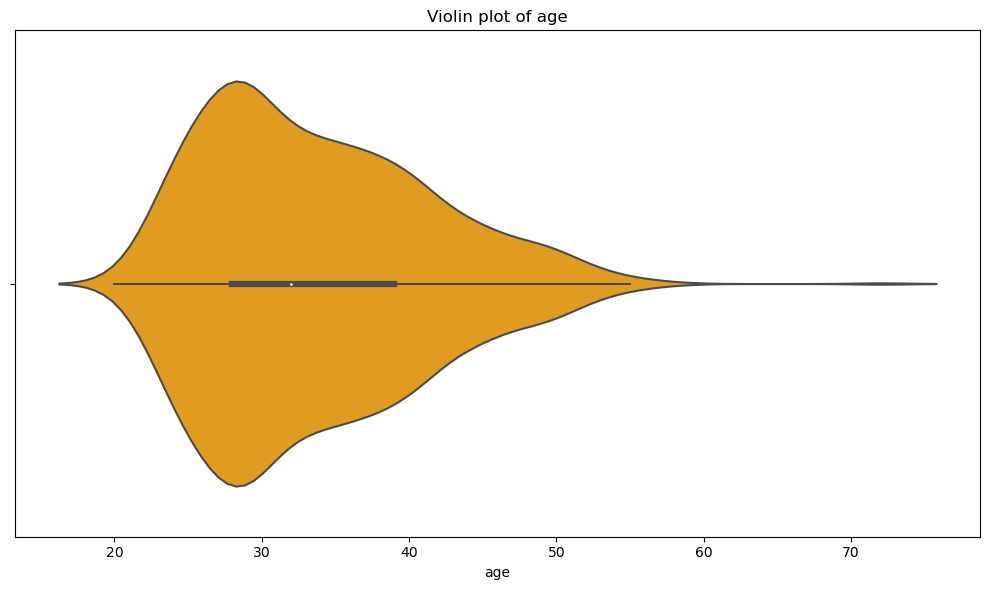

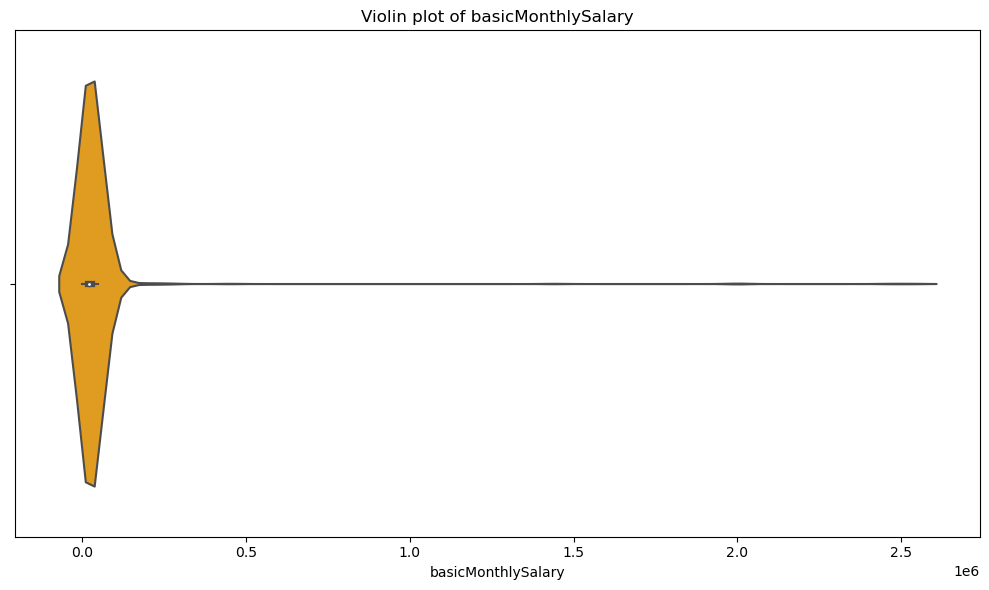

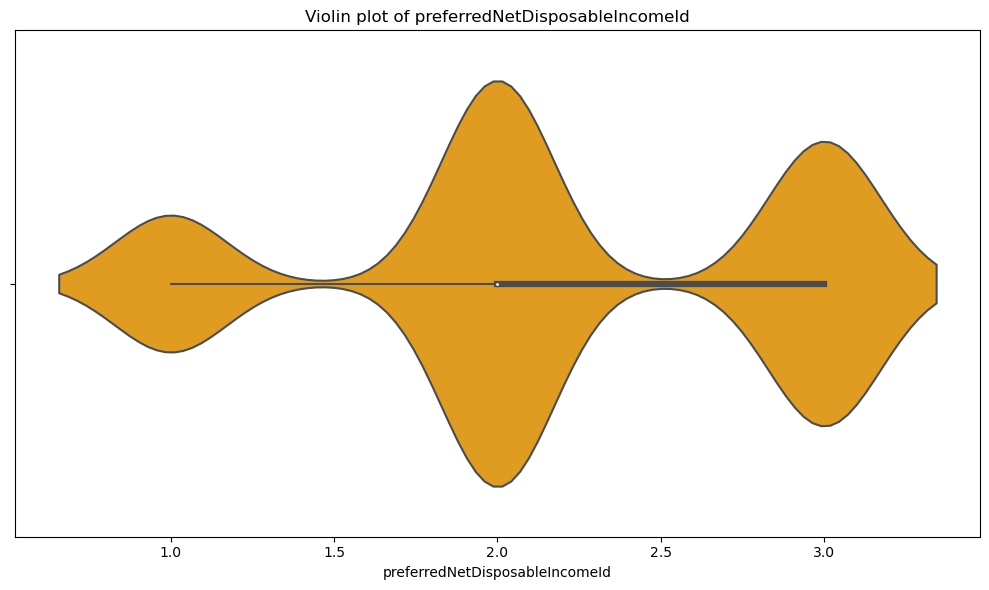

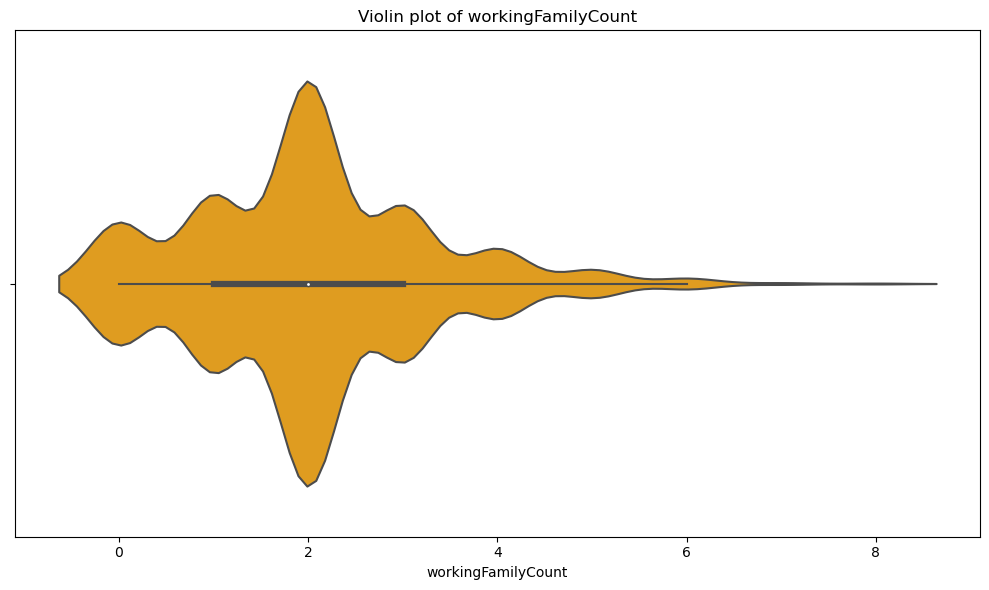

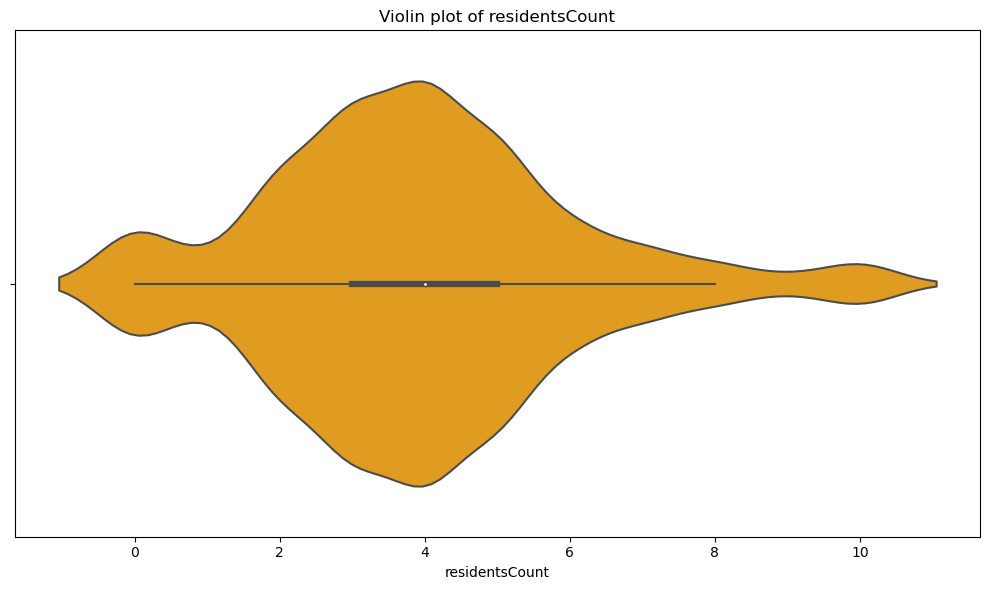

...

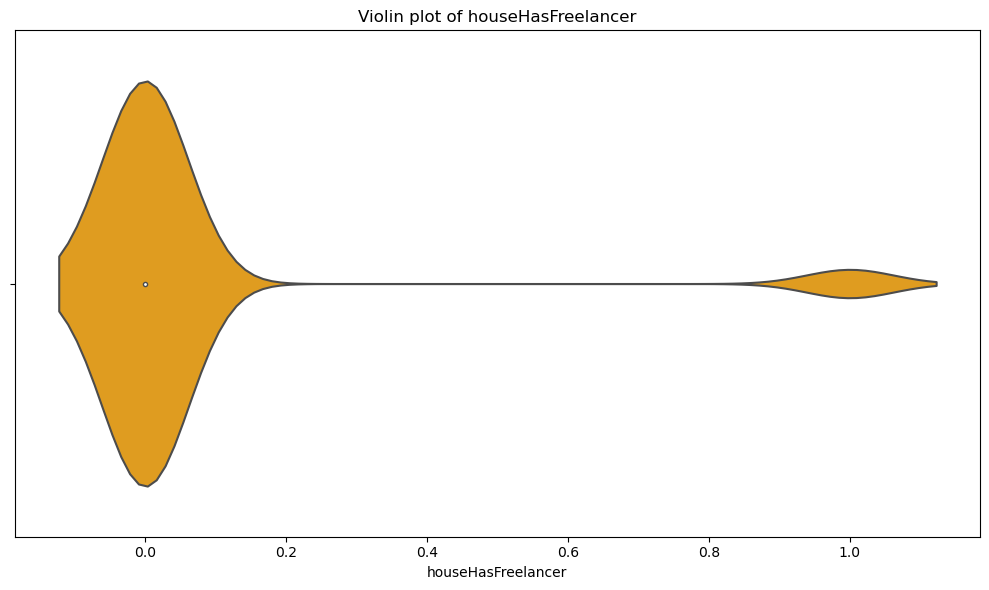

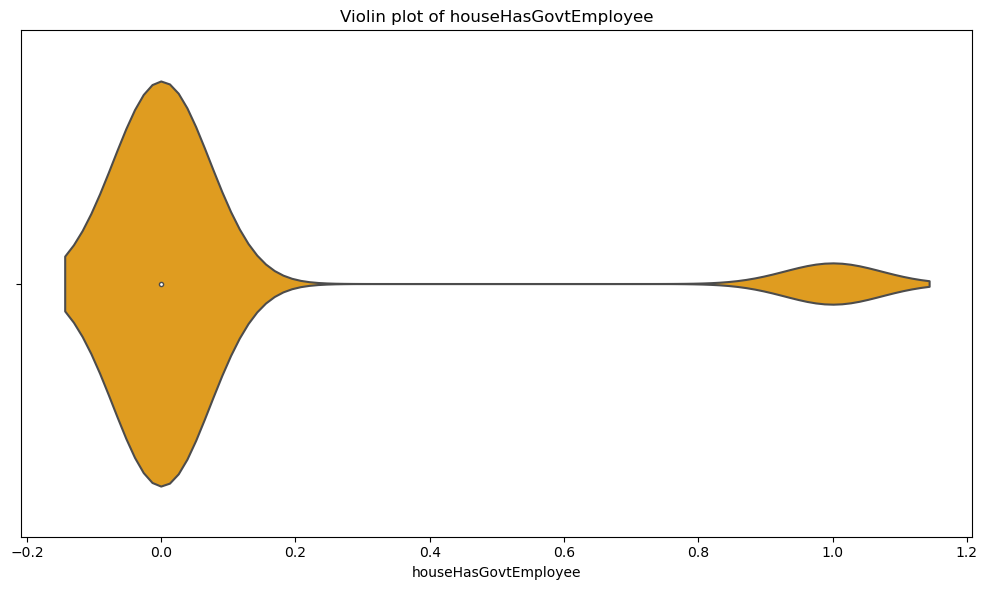

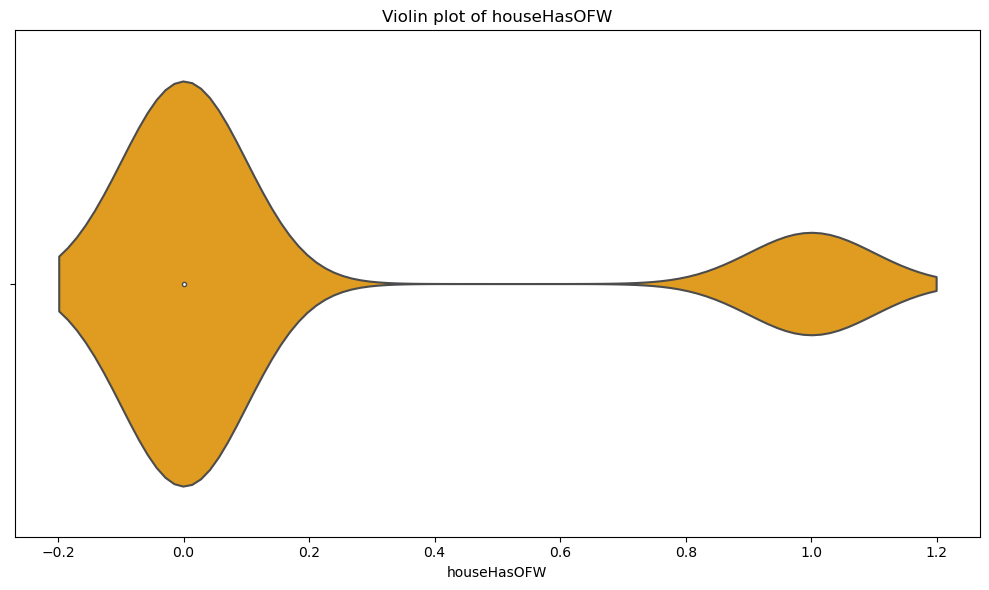

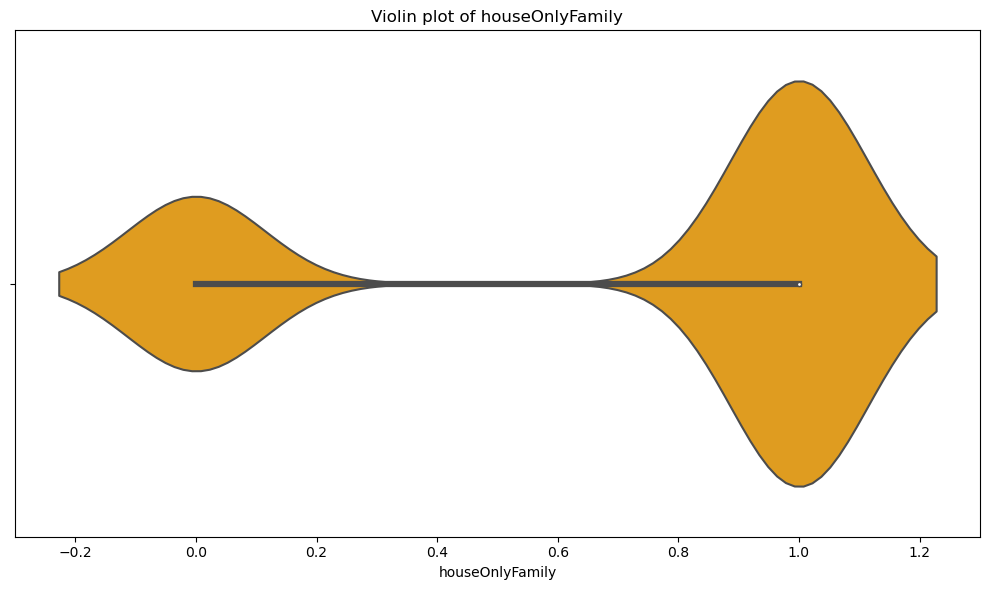

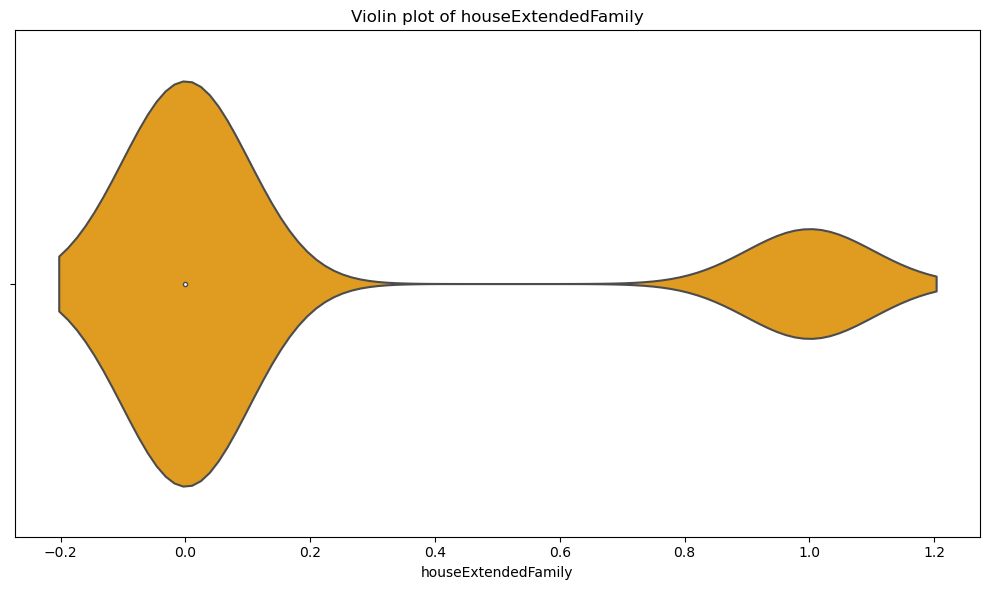

In [435]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming 'df' is your dataframe
df = ho_t01.drop(columns=['userId', 'lastFirstName', 'home_ownership_class', 'gender', 'job', 'province'])
features = df.columns

for feature in features:
    plt.figure(figsize=(10, 6))
    sns.violinplot(x=df[feature], color='orange')
    plt.title('Violin plot of {}'.format(feature))
    plt.tight_layout()
    plt.show()


In [8]:
1/(1+np.exp(-1*0.0101408446))

0.5025351894241549